In [1]:
import pandas as pd
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import numpy.random as nr
import math
from sklearn import preprocessing
import sklearn.model_selection as ms
from sklearn import linear_model
import sklearn.metrics as sklm

%matplotlib inline

In [2]:
train_values = pd.read_csv('train_values.csv')
train_values

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pop_per_primary_care_physician,pct_female,pct_below_18_years_of_age,pct_aged_65_years_and_older,pct_adults_less_than_a_high_school_diploma,pct_adults_with_high_school_diploma,pct_adults_with_some_college,pct_adults_bachelors_or_higher,birth_rate_per_1k,death_rate_per_1k
0,0,8e686a7,fb8cab1,3876.0,408.0,24.583,NaN,18.380,0.945945,0.010761,...,NaN,0.471,0.218,0.190,0.083250,0.327984,0.389168,0.199599,10.008982,9.752342
1,1,d1b5fc5,842bd12,10224.0,1166.0,28.346,3.0,26.694,0.808959,0.002284,...,1690.0,0.472,0.290,0.077,0.099099,0.202202,0.302302,0.396396,14.482893,3.013219
2,2,19a463b,2b7da97,27023.0,2927.0,21.641,9.0,31.028,0.956621,0.005141,...,1350.0,0.496,0.208,0.192,0.137725,0.387226,0.255489,0.219561,9.620346,10.873572
3,3,1711ab7,5029ed4,8735.0,1039.0,23.110,0.0,27.734,0.894835,0.000298,...,1749.0,0.503,0.193,0.215,0.077154,0.308617,0.398798,0.215431,9.383225,10.870809
4,4,1eb4681,b795815,3681.0,365.0,21.985,2.0,19.673,0.923886,0.000496,...,1249.0,0.516,0.222,0.230,0.092537,0.362189,0.346269,0.199005,9.543286,14.723926
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1557,1557,8a15c79,a952566,18983.0,1480.0,22.621,41.0,26.905,0.847652,0.064786,...,4660.0,0.510,0.243,0.144,0.153614,0.347390,0.263052,0.235944,11.369618,7.211285
1558,1558,ffaffbd,e2f94fa,18837.0,2144.0,28.649,7.0,26.515,0.925500,0.010666,...,1249.0,0.510,0.205,0.193,0.070858,0.371257,0.311377,0.246507,9.330009,12.600874
1559,1559,4268c79,a952566,77224.0,4677.0,18.928,137.0,28.827,0.883936,0.070858,...,1529.0,0.503,0.211,0.179,0.118644,0.311067,0.302094,0.268195,9.029286,8.846613
1560,1560,ff00193,4cd9667,4698.0,402.0,20.107,1.0,48.980,0.173909,0.000911,...,NaN,0.484,0.195,0.206,0.164000,0.354000,0.342000,0.140000,8.445214,9.744478


In [3]:
test_values = pd.read_csv('test_values.csv')
test_values

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pop_per_primary_care_physician,pct_female,pct_below_18_years_of_age,pct_aged_65_years_and_older,pct_adults_less_than_a_high_school_diploma,pct_adults_with_high_school_diploma,pct_adults_with_some_college,pct_adults_bachelors_or_higher,birth_rate_per_1k,death_rate_per_1k
0,0,8e7613e,9d1e27d,52842.0,5403.0,26.840,NaN,27.960,0.924234,0.025049,...,2710.0,0.512,0.215,0.177,0.174651,0.395210,0.274451,0.155689,9.828291,10.628268
1,1,694a5e8,a952566,212287.0,53502.0,57.534,6032.0,33.072,0.398318,0.484635,...,1009.0,0.522,0.192,0.113,0.168327,0.230080,0.241036,0.360558,13.285546,8.818293
2,2,b3f0726,20d32fc,81263.0,13368.0,39.994,1012.0,32.044,0.483789,0.381916,...,2459.0,0.526,0.240,0.153,0.201816,0.329970,0.287588,0.180626,11.571830,10.136089
3,3,fd922f0,1b0d913,122870.0,19359.0,41.865,NaN,30.724,0.468043,0.088393,...,1240.0,0.491,0.282,0.111,0.239563,0.277336,0.333996,0.149105,17.191860,10.089273
4,4,3bd551e,698ab34,146153.0,15766.0,30.681,644.0,30.860,0.651511,0.251317,...,2509.0,0.516,0.259,0.108,0.100100,0.289289,0.360360,0.250250,12.463880,6.432751
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1571,1571,dae1584,52acab4,44414.0,6275.0,35.026,254.0,30.569,0.726121,0.019125,...,2530.0,0.511,0.233,0.165,0.158683,0.332335,0.295409,0.213573,13.675599,11.802539
1572,1572,b95e0ba,485e9af,16160.0,1871.0,31.922,NaN,33.899,0.663196,0.303469,...,8160.0,0.495,0.227,0.176,0.210159,0.419323,0.240040,0.130478,10.286142,13.278474
1573,1573,f44348c,1dcfd4e,28688.0,4478.0,33.897,NaN,28.644,0.809853,0.011596,...,959.0,0.451,0.170,0.094,0.051793,0.173307,0.288845,0.486056,9.229493,2.385150
1574,1574,c9450a6,52acab4,29234.0,4528.0,40.479,57.0,24.803,0.707838,0.030869,...,1849.0,0.501,0.237,0.131,0.137412,0.350050,0.243731,0.268806,16.695002,9.758586


In [4]:
for col in train_values:
    train_values[col].describe()
    print(col,train_values[col].describe(),'\n')

row_id count    1562.000000
mean      780.500000
std       451.054875
min         0.000000
25%       390.250000
50%       780.500000
75%      1170.750000
max      1561.000000
Name: row_id, dtype: float64 

county_code count        1562
unique       1562
top       2d693e1
freq            1
Name: county_code, dtype: object 

state count        1562
unique         50
top       1b0d913
freq          131
Name: state, dtype: object 

population count    1.562000e+03
mean     1.083407e+05
std      3.745229e+05
min      2.690000e+02
25%      1.045275e+04
50%      2.528200e+04
75%      6.836150e+04
max      1.002029e+07
Name: population, dtype: float64 

renter_occupied_households count    1.562000e+03
mean     1.490462e+04
std      6.255947e+04
min      6.400000e+01
25%      1.078250e+03
50%      2.754000e+03
75%      7.987000e+03
max      1.760277e+06
Name: renter_occupied_households, dtype: float64 

pct_renter_occupied count    1562.000000
mean       28.525570
std         8.121601
min      

In [5]:
def count_unique(train_values, cols):
    for col in cols:
        print('\n' + 'For column ' + col)
        print(train_values[col].value_counts())

cat_cols = ['rucc','urban_influence','economic_typology']
count_unique(train_values, cat_cols)


For column rucc
Nonmetro - Urban population of 2,500 to 19,999, adjacent to a metro area                         301
Metro - Counties in metro areas of 1 million population or more                                  219
Nonmetro - Completely rural or less than 2,500 urban population, not adjacent to a metro area    215
Nonmetro - Urban population of 2,500 to 19,999, not adjacent to a metro area                     206
Metro - Counties in metro areas of 250,000 to 1 million population                               193
Metro - Counties in metro areas of fewer than 250,000 population                                 165
Nonmetro - Completely rural or less than 2,500 urban population, adjacent to a metro area        120
Nonmetro - Urban population of 20,000 or more, adjacent to a metro area                          101
Nonmetro - Urban population of 20,000 or more, not adjacent to a metro area                       42
Name: rucc, dtype: int64

For column urban_influence
Small-in a metro area

In [6]:
train_labels = pd.read_csv('train_labels.csv')
train_labels

,row_id,gross_rent
0,0,577
1,1,844
2,2,700
3,3,592
4,4,444
...,...,...
1557,1557,928
1558,1558,640
1559,1559,754
1560,1560,640


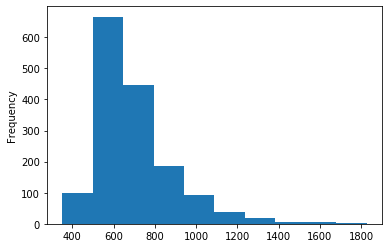

In [7]:
import matplotlib.pyplot as plt
%matplotlib inline

train_labels['gross_rent'].plot.hist()

In [8]:
train_labels['gross_rent'].describe()

count    1562.000000
mean      701.142125
std       192.883110
min       351.000000
25%       578.000000
50%       650.000000
75%       773.750000
max      1827.000000
Name: gross_rent, dtype: float64

In [9]:
train_values_labels = pd.merge(train_values, train_labels, on='row_id')
train_values_labels

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_female,pct_below_18_years_of_age,pct_aged_65_years_and_older,pct_adults_less_than_a_high_school_diploma,pct_adults_with_high_school_diploma,pct_adults_with_some_college,pct_adults_bachelors_or_higher,birth_rate_per_1k,death_rate_per_1k,gross_rent
0,0,8e686a7,fb8cab1,3876.0,408.0,24.583,NaN,18.380,0.945945,0.010761,...,0.471,0.218,0.190,0.083250,0.327984,0.389168,0.199599,10.008982,9.752342,577
1,1,d1b5fc5,842bd12,10224.0,1166.0,28.346,3.0,26.694,0.808959,0.002284,...,0.472,0.290,0.077,0.099099,0.202202,0.302302,0.396396,14.482893,3.013219,844
2,2,19a463b,2b7da97,27023.0,2927.0,21.641,9.0,31.028,0.956621,0.005141,...,0.496,0.208,0.192,0.137725,0.387226,0.255489,0.219561,9.620346,10.873572,700
3,3,1711ab7,5029ed4,8735.0,1039.0,23.110,0.0,27.734,0.894835,0.000298,...,0.503,0.193,0.215,0.077154,0.308617,0.398798,0.215431,9.383225,10.870809,592
4,4,1eb4681,b795815,3681.0,365.0,21.985,2.0,19.673,0.923886,0.000496,...,0.516,0.222,0.230,0.092537,0.362189,0.346269,0.199005,9.543286,14.723926,444
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1557,1557,8a15c79,a952566,18983.0,1480.0,22.621,41.0,26.905,0.847652,0.064786,...,0.510,0.243,0.144,0.153614,0.347390,0.263052,0.235944,11.369618,7.211285,928
1558,1558,ffaffbd,e2f94fa,18837.0,2144.0,28.649,7.0,26.515,0.925500,0.010666,...,0.510,0.205,0.193,0.070858,0.371257,0.311377,0.246507,9.330009,12.600874,640
1559,1559,4268c79,a952566,77224.0,4677.0,18.928,137.0,28.827,0.883936,0.070858,...,0.503,0.211,0.179,0.118644,0.311067,0.302094,0.268195,9.029286,8.846613,754
1560,1560,ff00193,4cd9667,4698.0,402.0,20.107,1.0,48.980,0.173909,0.000911,...,0.484,0.195,0.206,0.164000,0.354000,0.342000,0.140000,8.445214,9.744478,640


In [10]:
train_values_labels['gross_rent'].describe()

count    1562.000000
mean      701.142125
std       192.883110
min       351.000000
25%       578.000000
50%       650.000000
75%       773.750000
max      1827.000000
Name: gross_rent, dtype: float64

In [11]:
train_values_labels['gross_rent'].mean()

701.1421254801536

In [12]:
train_values_labels['gross_rent'].median()

650.0

In [13]:
train_values_labels['gross_rent'].std()

192.88310953787266

Text(0.5, 1.0, 'histogram of gross_rent')

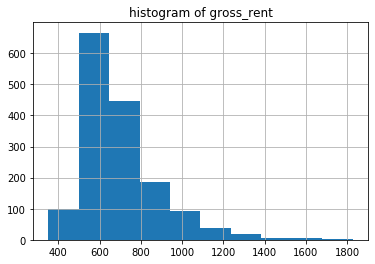

In [14]:
train_values_labels['gross_rent'].hist()
plt.title('histogram of gross_rent')

In [15]:
num_cols = ['gross_rent','population',
       'renter_occupied_households', 'pct_renter_occupied', 'evictions',
       'rent_burden', 'pct_white', 'pct_af_am', 'pct_hispanic', 'pct_am_ind',
       'pct_asian', 'pct_nh_pi', 'pct_multiple', 'pct_other', 'poverty_rate',
       'pct_civilian_labor',
       'pct_unemployment', 'pct_uninsured_adults', 'pct_uninsured_children',
       'pct_adult_obesity', 'pct_adult_smoking', 'pct_diabetes',
       'pct_low_birthweight', 'pct_excessive_drinking',
       'pct_physical_inactivity', 'air_pollution_particulate_matter_value',
       'homicides_per_100k', 'motor_vehicle_crash_deaths_per_100k',
       'heart_disease_mortality_per_100k', 'pop_per_dentist',
       'pop_per_primary_care_physician', 'pct_female',
       'pct_below_18_years_of_age', 'pct_aged_65_years_and_older',
       'pct_adults_less_than_a_high_school_diploma',
       'pct_adults_with_high_school_diploma', 'pct_adults_with_some_college',
       'pct_adults_bachelors_or_higher', 'birth_rate_per_1k',
       'death_rate_per_1k']

In [16]:
Correlations = train_values_labels[num_cols]

corr = Correlations.corr()
corr.style.background_gradient(cmap='coolwarm')

In [17]:
state_one = train_values_labels[train_values_labels['state']=='1b0d913']

In [18]:
state_two = train_values_labels[train_values_labels['state']=='a952566']

In [19]:
state_one['gross_rent'].describe()

count     131.000000
mean      691.229008
std       123.938419
min       433.000000
25%       617.500000
50%       675.000000
75%       759.500000
max      1002.000000
Name: gross_rent, dtype: float64

In [20]:
state_one['gross_rent'].mean()

691.2290076335878

In [21]:
state_two['gross_rent'].describe()

count      69.000000
mean      894.710145
std       315.577440
min       473.000000
25%       680.000000
50%       861.000000
75%      1031.000000
max      1827.000000
Name: gross_rent, dtype: float64

In [22]:
state_two['gross_rent'].mean()

894.7101449275362

In [23]:
train_values_labels['state'].unique()

array(['fb8cab1', '842bd12', '2b7da97', '5029ed4', 'b795815', '4522abc',
       '4c72956', '78e8330', '9e0007d', 'e74aca3', '1b0d913', '485e9af',
       '4cd9667', '1646cf6', '20d32fc', 'a952566', '8036085', '9dda412',
       '5086a32', 'e899d7f', '158df01', '6d287d7', '08f8fb4', '1dcfd4e',
       '9d0874a', '528ea9f', '7dd3518', 'e2f94fa', 'c479f0c', 'dc9ae72',
       '698ab34', '176f5f0', '0f8930b', '52acab4', '9d1e27d', 'c3dbf0a',
       'b44cfe6', '7572db1', 'bc77872', 'dfc21f3', '3745933', '64ffe5d',
       '09d8cd0', '105e445', 'fa605d5', '9e065a4', 'd233cec', '3337bbb',
       '375d4d3', '914c15f'], dtype=object)

In [24]:
states=['fb8cab1', '842bd12', '2b7da97', '5029ed4', 'b795815', '4522abc',
       '4c72956', '78e8330', '9e0007d', 'e74aca3', '1b0d913', '485e9af',
       '4cd9667', '1646cf6', '20d32fc', 'a952566', '8036085', '9dda412',
       '5086a32', 'e899d7f', '158df01', '6d287d7', '08f8fb4', '1dcfd4e',
       '9d0874a', '528ea9f', '7dd3518', 'e2f94fa', 'c479f0c', 'dc9ae72',
       '698ab34', '176f5f0', '0f8930b', '52acab4', '9d1e27d', 'c3dbf0a',
       'b44cfe6', '7572db1', 'bc77872', 'dfc21f3', '3745933', '64ffe5d',
       '09d8cd0', '105e445', 'fa605d5', '9e065a4', 'd233cec', '3337bbb',
       '375d4d3', '914c15f']

In [25]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['county_code','gross_rent']]
    print(county_codes_state.describe(),'\n' )
    

       gross_rent
count   30.000000
mean   577.900000
std    125.367969
min    351.000000
25%    488.750000
50%    562.500000
75%    663.500000
max    898.000000 

       gross_rent
count   26.000000
mean   663.653846
std     91.172778
min    528.000000
25%    592.250000
50%    652.000000
75%    717.750000
max    844.000000 

        gross_rent
count     6.000000
mean    856.833333
std     112.898922
min     700.000000
25%     805.750000
50%     869.000000
75%     876.750000
max    1039.000000 

       gross_rent
count    8.000000
mean   694.375000
std    100.265273
min    588.000000
25%    601.750000
50%    687.000000
75%    763.750000
max    827.000000 

       gross_rent
count   45.000000
mean   585.266667
std     79.992443
min    444.000000
25%    551.000000
50%    585.000000
75%    632.000000
max    812.000000 

        gross_rent
count    93.000000
mean    688.344086
std     171.797308
min     375.000000
25%     571.000000
50%     635.000000
75%     758.000000
max    1236.000000 

In [26]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['state','county_code','gross_rent']]
    print(county_codes_state,'\n',county_codes_state.describe(),'\n' )

        state county_code  gross_rent
0     fb8cab1     8e686a7         577
11    fb8cab1     170b0b3         406
65    fb8cab1     43b66dd         582
94    fb8cab1     555fe97         467
98    fb8cab1     118ca99         558
153   fb8cab1     3b9505f         481
277   fb8cab1     a6f2901         548
291   fb8cab1     e46e2df         650
364   fb8cab1     b301c5b         898
399   fb8cab1     b66aeb7         512
456   fb8cab1     62c7e21         515
458   fb8cab1     d27aeaf         443
531   fb8cab1     5a9c263         351
604   fb8cab1     6074b91         673
650   fb8cab1     978d233         514
787   fb8cab1     f62fc23         442
792   fb8cab1     26886b3         565
923   fb8cab1     62cb873         560
977   fb8cab1     568b173         712
980   fb8cab1     9b5d201         465
1070  fb8cab1     15a1a6d         520
1132  fb8cab1     7148511         608
1135  fb8cab1     aff8f6d         755
1192  fb8cab1     e97a66b         423
1203  fb8cab1     f61f365         668
1292  fb8cab

        state county_code  gross_rent
16    1646cf6     802a8ff         780
17    1646cf6     d5b0571         694
19    1646cf6     148eadd         609
166   1646cf6     c9bcf15         809
205   1646cf6     377ef9d         723
290   1646cf6     1a6a363         689
296   1646cf6     b2be407         922
325   1646cf6     6db604d         630
341   1646cf6     2395097         619
400   1646cf6     9d79897         957
403   1646cf6     83845e9         598
459   1646cf6     5992637         644
467   1646cf6     3db91c3        1197
615   1646cf6     3f19637        1014
735   1646cf6     80d251b         541
826   1646cf6     ff7017b         773
828   1646cf6     ed945a7         546
929   1646cf6     96d5ef5         630
996   1646cf6     6a6453b         752
1034  1646cf6     06a9047        1158
1153  1646cf6     f5f2757         734
1198  1646cf6     a97869b         608
1210  1646cf6     b7c3997         714
1244  1646cf6     eaec827         694
1445  1646cf6     e896007         826
1459  1646cf

1558  e2f94fa     ffaffbd         640 
        gross_rent
count   44.000000
mean   595.000000
std     63.309135
min    462.000000
25%    555.500000
50%    590.500000
75%    620.000000
max    772.000000 

        state county_code  gross_rent
39    c479f0c     f59fa79         479
87    c479f0c     c7bda89         577
89    c479f0c     2e024bd         830
92    c479f0c     ee004b9         523
104   c479f0c     8859193         674
123   c479f0c     e4091a7         675
135   c479f0c     9ff7679         700
141   c479f0c     984c707         604
158   c479f0c     3000627         713
187   c479f0c     d9bd209         552
192   c479f0c     3660359         814
206   c479f0c     f3eaff7         647
245   c479f0c     da6731b         778
269   c479f0c     fc9bea3         383
314   c479f0c     ac1b619         582
322   c479f0c     a3bca1d         489
374   c479f0c     8f3100d         626
385   c479f0c     9ffbb53         630
401   c479f0c     7c05d29         561
448   c479f0c     d1bca8b         56

1420  dfc21f3     fd06d9f        1298 
         gross_rent
count     6.000000
mean   1031.000000
std     204.574681
min     754.000000
25%     885.500000
50%    1090.000000
75%    1125.000000
max    1298.000000 

        state county_code  gross_rent
121   3745933     a6115c1         644
137   3745933     893df1d         990
197   3745933     5653515         925
213   3745933     75ae079         621
219   3745933     4bb5fed         765
254   3745933     b3994af         807
266   3745933     4b282af        1076
461   3745933     9d5c205         798
716   3745933     b578f05         782
1002  3745933     ca22021        1042
1121  3745933     01177c9        1204
1225  3745933     06a6619         680
1274  3745933     54a64a1         884
1302  3745933     ce3aabd         721
1335  3745933     0433c85         653
1400  3745933     363fcfb         694
1525  3745933     b2b09f1         801
1534  3745933     f136239         834
1545  3745933     e6e9351         716 
         gross_rent
count 

In [27]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['state','county_code','homicides_per_100k']]
    print(county_codes_state.describe(),'\n' )

       homicides_per_100k
count                 0.0
mean                  NaN
std                   NaN
min                   NaN
25%                   NaN
50%                   NaN
75%                   NaN
max                   NaN 

       homicides_per_100k
count            3.000000
mean             1.593333
std              0.483356
min              1.280000
25%              1.315000
50%              1.350000
75%              1.750000
max              2.150000 

       homicides_per_100k
count                1.00
mean                 2.29
std                   NaN
min                  2.29
25%                  2.29
50%                  2.29
75%                  2.29
max                  2.29 

       homicides_per_100k
count            2.000000
mean             3.365000
std              0.289914
min              3.160000
25%              3.262500
50%              3.365000
75%              3.467500
max              3.570000 

       homicides_per_100k
count                1.00
mean

max             10.120000 

       homicides_per_100k
count            6.000000
mean             5.356667
std              5.842598
min              0.610000
25%              1.002500
50%              3.510000
75%              7.450000
max             15.580000 

       homicides_per_100k
count            6.000000
mean             2.953333
std              3.071558
min              0.040000
25%              1.245000
50%              1.710000
75%              4.072500
max              8.310000 

       homicides_per_100k
count           11.000000
mean             2.772727
std              1.358905
min              0.800000
25%              2.190000
50%              2.450000
75%              3.335000
max              6.090000 

       homicides_per_100k
count            4.000000
mean             1.367500
std              1.069498
min             -0.080000
25%              0.880000
50%              1.665000
75%              2.152500
max              2.220000 

       homicides_per_100k
co

In [28]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['state','county_code','homicides_per_100k']]
    print(county_codes_state,'\n',county_codes_state.describe(),'\n' )

        state county_code  homicides_per_100k
0     fb8cab1     8e686a7                 NaN
11    fb8cab1     170b0b3                 NaN
65    fb8cab1     43b66dd                 NaN
94    fb8cab1     555fe97                 NaN
98    fb8cab1     118ca99                 NaN
153   fb8cab1     3b9505f                 NaN
277   fb8cab1     a6f2901                 NaN
291   fb8cab1     e46e2df                 NaN
364   fb8cab1     b301c5b                 NaN
399   fb8cab1     b66aeb7                 NaN
456   fb8cab1     62c7e21                 NaN
458   fb8cab1     d27aeaf                 NaN
531   fb8cab1     5a9c263                 NaN
604   fb8cab1     6074b91                 NaN
650   fb8cab1     978d233                 NaN
787   fb8cab1     f62fc23                 NaN
792   fb8cab1     26886b3                 NaN
923   fb8cab1     62cb873                 NaN
977   fb8cab1     568b173                 NaN
980   fb8cab1     9b5d201                 NaN
1070  fb8cab1     15a1a6d         

1544  78e8330     0081051                 NaN 
        homicides_per_100k
count                 0.0
mean                  NaN
std                   NaN
min                   NaN
25%                   NaN
50%                   NaN
75%                   NaN
max                   NaN 

        state county_code  homicides_per_100k
9     9e0007d     e34c58f                 NaN
38    9e0007d     9d68ed9               17.02
50    9e0007d     9a12bc7                 NaN
78    9e0007d     de0156d                 NaN
155   9e0007d     f7e78bd                9.55
174   9e0007d     c11aafb                5.32
199   9e0007d     aa3f82b                4.24
236   9e0007d     2a51c8d                 NaN
249   9e0007d     91c3edf                 NaN
351   9e0007d     fdb861d               11.07
353   9e0007d     e5b30cb                2.68
409   9e0007d     deb993f               26.16
412   9e0007d     f01358d                 NaN
446   9e0007d     fd9d109                 NaN
493   9e0007d     213fbf5 

        state county_code  homicides_per_100k
20    a952566     58d1c1f                7.66
47    a952566     426bbb1               10.35
91    a952566     527ee03                5.81
127   a952566     eb5a445                4.50
128   a952566     36eb31b                 NaN
...       ...         ...                 ...
1463  a952566     0b61b03                2.12
1467  a952566     f39ef59                 NaN
1502  a952566     2982cef                 NaN
1557  a952566     8a15c79                 NaN
1559  a952566     4268c79                 NaN

[69 rows x 3 columns] 
        homicides_per_100k
count           29.000000
mean             5.517241
std              3.287659
min              0.180000
25%              3.370000
50%              4.730000
75%              7.420000
max             15.610000 

        state county_code  homicides_per_100k
21    8036085     802cc0d                 NaN
27    8036085     9e8fcd3                 NaN
32    8036085     49e4d3b                 NaN
132

        state county_code  homicides_per_100k
26    6d287d7     6b29733                4.47
268   6d287d7     e36fd91                4.03
767   6d287d7     6b1bd3d                 NaN
1213  6d287d7     e126f4d                6.37 
        homicides_per_100k
count            3.000000
mean             4.956667
std              1.243597
min              4.030000
25%              4.250000
50%              4.470000
75%              5.420000
max              6.370000 

        state county_code  homicides_per_100k
29    08f8fb4     a0b1eb5                 NaN
83    08f8fb4     38fb2ef                 NaN
86    08f8fb4     190cee9                3.74
109   08f8fb4     16ed851                2.63
112   08f8fb4     baa4ebd                3.18
125   08f8fb4     3eb3e7d                 NaN
126   08f8fb4     a1ac313                 NaN
186   08f8fb4     2f31ea7                 NaN
240   08f8fb4     6526e9f               13.25
274   08f8fb4     641f8ad                 NaN
279   08f8fb4     519c92f 

1554  528ea9f     47d466b                 NaN 
        homicides_per_100k
count           16.000000
mean             3.921250
std              1.436514
min              1.920000
25%              2.837500
50%              3.565000
75%              5.005000
max              6.130000 

        state county_code  homicides_per_100k
35    7dd3518     bc192e7                 NaN
182   7dd3518     e0370f9                 NaN
190   7dd3518     072036b                 NaN
231   7dd3518     34d700b                 NaN
243   7dd3518     e840e47                 NaN
331   7dd3518     8282823                3.92
372   7dd3518     a48f4a1                 NaN
481   7dd3518     f2607e5                 NaN
825   7dd3518     2d693e1                 NaN
849   7dd3518     6afba47                 NaN
891   7dd3518     78296f7                 NaN
897   7dd3518     d465f03                 NaN
1009  7dd3518     3900385                 NaN
1196  7dd3518     3fa9943                 NaN
1266  7dd3518     76ff4a9 

max               6.28000 

        state county_code  homicides_per_100k
52    698ab34     2203777               14.73
115   698ab34     e6610e7                5.74
151   698ab34     aa5fa21               15.50
217   698ab34     eec9845                3.63
228   698ab34     2533e27               14.85
246   698ab34     10b45ed                7.97
250   698ab34     09a2291               11.34
307   698ab34     4c6161b                9.56
722   698ab34     e9349f3                5.33
760   698ab34     888d3ad                3.64
790   698ab34     62dc2dd               11.68
905   698ab34     b2281b7                6.36
983   698ab34     baeffbb                 NaN
997   698ab34     e84fbfd               10.40
1001  698ab34     00bed13                5.59
1021  698ab34     afa46b1                7.19
1110  698ab34     5b64c77                7.35
1179  698ab34     4c6282f                4.39
1286  698ab34     a593577               13.55
1342  698ab34     0dc7c91                9.72
1440  

1545  3745933     e6e9351                 NaN 
        homicides_per_100k
count           11.000000
mean             2.772727
std              1.358905
min              0.800000
25%              2.190000
50%              2.450000
75%              3.335000
max              6.090000 

        state county_code  homicides_per_100k
131   64ffe5d     5fcbae1                 NaN
391   64ffe5d     125432f                 NaN
434   64ffe5d     61492bf                 NaN
548   64ffe5d     1628d17                 NaN
577   64ffe5d     15db2f5                1.20
617   64ffe5d     6e57109                2.13
713   64ffe5d     da2e0ef               -0.08
755   64ffe5d     0581cf5                 NaN
763   64ffe5d     966d12f                 NaN
852   64ffe5d     dfbef9b                2.22
934   64ffe5d     c8c0697                 NaN
935   64ffe5d     5186e87                 NaN
1039  64ffe5d     83fdd3b                 NaN
1313  64ffe5d     55e65a3                 NaN
1515  64ffe5d     c2d8ae5 

In [29]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['state','county_code','pct_excessive_drinking']]
    print(county_codes_state,'\n',county_codes_state.describe(),'\n' )

        state county_code  pct_excessive_drinking
0     fb8cab1     8e686a7                   0.262
11    fb8cab1     170b0b3                   0.179
65    fb8cab1     43b66dd                   0.205
94    fb8cab1     555fe97                   0.233
98    fb8cab1     118ca99                   0.202
153   fb8cab1     3b9505f                   0.167
277   fb8cab1     a6f2901                   0.265
291   fb8cab1     e46e2df                   0.238
364   fb8cab1     b301c5b                   0.272
399   fb8cab1     b66aeb7                   0.264
456   fb8cab1     62c7e21                   0.235
458   fb8cab1     d27aeaf                   0.237
531   fb8cab1     5a9c263                   0.282
604   fb8cab1     6074b91                   0.191
650   fb8cab1     978d233                   0.232
787   fb8cab1     f62fc23                   0.361
792   fb8cab1     26886b3                   0.152
923   fb8cab1     62cb873                   0.160
977   fb8cab1     568b173                   0.212


max                  0.299000 

        state county_code  pct_excessive_drinking
7     4c72956     83adc69                   0.169
75    4c72956     df7642f                   0.185
111   4c72956     3c627a3                   0.163
211   4c72956     f6b5d25                   0.209
235   4c72956     98863bb                   0.265
281   4c72956     6df35c1                   0.171
287   4c72956     cc4ffcd                   0.172
398   4c72956     3f05bfb                   0.173
453   4c72956     93354e5                     NaN
626   4c72956     e968c93                   0.216
649   4c72956     75ec207                   0.176
676   4c72956     15f4c37                   0.159
704   4c72956     8421669                   0.239
782   4c72956     94b250f                   0.176
816   4c72956     59e2a09                   0.142
823   4c72956     4af0369                   0.182
882   4c72956     ba1e30d                   0.171
953   4c72956     454aabf                   0.153
955   4c72956     

        state county_code  pct_excessive_drinking
14    4cd9667     5c62775                   0.114
106   4cd9667     9deea09                   0.128
149   4cd9667     2f44273                   0.146
159   4cd9667     b6cdc1f                   0.147
356   4cd9667     0317131                   0.125
367   4cd9667     95fa82b                   0.082
468   4cd9667     8313a3f                   0.144
532   4cd9667     8b9c655                   0.133
605   4cd9667     2e90505                   0.125
657   4cd9667     7d45733                   0.149
669   4cd9667     62c16b7                   0.127
686   4cd9667     998a9ab                     NaN
791   4cd9667     faa5339                   0.119
971   4cd9667     a92ea8f                   0.137
1019  4cd9667     73f8b53                   0.143
1091  4cd9667     7942367                   0.188
1293  4cd9667     c1e7003                   0.127
1383  4cd9667     69f7dd1                     NaN
1556  4cd9667     ac3ba27                   0.130


1542  8036085     24045b9                   0.160 
        pct_excessive_drinking
count               32.000000
mean                 0.187812
std                  0.032535
min                  0.114000
25%                  0.163500
50%                  0.183000
75%                  0.210750
max                  0.249000 

        state county_code  pct_excessive_drinking
22    9dda412     93660a5                   0.245
58    9dda412     470a82d                     NaN
76    9dda412     bee3ae7                   0.094
164   9dda412     6a6aefd                   0.253
232   9dda412     eaa7825                   0.163
270   9dda412     29c7891                   0.202
308   9dda412     6a5e027                   0.181
313   9dda412     0602f87                   0.192
316   9dda412     d281769                     NaN
345   9dda412     87d898f                   0.223
359   9dda412     bc1fb7b                   0.263
397   9dda412     8d952b1                   0.278
439   9dda412     6220fe5 

1561  1dcfd4e     38ccdfd                   0.149 
        pct_excessive_drinking
count               32.000000
mean                 0.174187
std                  0.048865
min                  0.085000
25%                  0.147500
50%                  0.161500
75%                  0.194250
max                  0.277000 

        state county_code  pct_excessive_drinking
33    9d0874a     678b4b5                   0.119
73    9d0874a     614c4fb                   0.060
74    9d0874a     a835cc9                   0.080
93    9d0874a     3224ac3                   0.131
146   9d0874a     fa3f06d                   0.136
198   9d0874a     5b36baf                     NaN
230   9d0874a     5ed625b                     NaN
257   9d0874a     cd8dcbf                   0.135
265   9d0874a     a0be9e3                     NaN
283   9d0874a     93b2137                   0.091
328   9d0874a     f7e9a2d                     NaN
449   9d0874a     998be37                   0.153
537   9d0874a     2f5ee35 

        state county_code  pct_excessive_drinking
39    c479f0c     f59fa79                     NaN
87    c479f0c     c7bda89                     NaN
89    c479f0c     2e024bd                   0.275
92    c479f0c     ee004b9                     NaN
104   c479f0c     8859193                   0.205
123   c479f0c     e4091a7                   0.211
135   c479f0c     9ff7679                   0.240
141   c479f0c     984c707                     NaN
158   c479f0c     3000627                   0.207
187   c479f0c     d9bd209                     NaN
192   c479f0c     3660359                   0.182
206   c479f0c     f3eaff7                     NaN
245   c479f0c     da6731b                   0.225
269   c479f0c     fc9bea3                     NaN
314   c479f0c     ac1b619                     NaN
322   c479f0c     a3bca1d                     NaN
374   c479f0c     8f3100d                   0.136
385   c479f0c     9ffbb53                     NaN
401   c479f0c     7c05d29                     NaN


max                   0.14000 

        state county_code  pct_excessive_drinking
81    c3dbf0a     53f2105                   0.059
105   c3dbf0a     ece7e97                   0.060
124   c3dbf0a     01bb85d                     NaN
130   c3dbf0a     b77d307                     NaN
167   c3dbf0a     059cccb                   0.145
223   c3dbf0a     11f57c5                   0.107
327   c3dbf0a     3b35803                   0.135
349   c3dbf0a     ce32b8b                   0.074
432   c3dbf0a     6cae293                   0.146
573   c3dbf0a     03cc769                   0.099
576   c3dbf0a     1fd3d77                     NaN
610   c3dbf0a     310274f                     NaN
671   c3dbf0a     2500bb9                   0.149
705   c3dbf0a     3782e53                   0.089
715   c3dbf0a     31c0feb                   0.143
737   c3dbf0a     61765f5                   0.135
805   c3dbf0a     14aba39                   0.208
877   c3dbf0a     1fb67b5                   0.088
899   c3dbf0a     

1553  09d8cd0     88faf13                   0.157 
        pct_excessive_drinking
count               41.000000
mean                 0.158537
std                  0.040828
min                  0.077000
25%                  0.135000
50%                  0.150000
75%                  0.190000
max                  0.242000 

        state county_code  pct_excessive_drinking
335   105e445     09b6d8f                   0.209
817   105e445     adc87ab                   0.171
986   105e445     12105a1                   0.223
1276  105e445     684ddc5                   0.205 
        pct_excessive_drinking
count                4.000000
mean                 0.202000
std                  0.022061
min                  0.171000
25%                  0.196500
50%                  0.207000
75%                  0.212500
max                  0.223000 

        state county_code  pct_excessive_drinking
475   fa605d5     76a7cd7                   0.166
764   fa605d5     867cd57                   0.200
83

In [30]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['state','county_code','pct_adult_smoking']]
    print(county_codes_state,'\n',county_codes_state.describe(),'\n' )

        state county_code  pct_adult_smoking
0     fb8cab1     8e686a7              0.166
11    fb8cab1     170b0b3              0.157
65    fb8cab1     43b66dd              0.110
94    fb8cab1     555fe97              0.177
98    fb8cab1     118ca99              0.185
153   fb8cab1     3b9505f              0.112
277   fb8cab1     a6f2901              0.166
291   fb8cab1     e46e2df              0.246
364   fb8cab1     b301c5b              0.300
399   fb8cab1     b66aeb7              0.189
456   fb8cab1     62c7e21              0.175
458   fb8cab1     d27aeaf              0.153
531   fb8cab1     5a9c263              0.361
604   fb8cab1     6074b91              0.238
650   fb8cab1     978d233              0.155
787   fb8cab1     f62fc23                NaN
792   fb8cab1     26886b3              0.083
923   fb8cab1     62cb873              0.133
977   fb8cab1     568b173              0.161
980   fb8cab1     9b5d201              0.151
1070  fb8cab1     15a1a6d              0.186
1132  fb8c

        state county_code  pct_adult_smoking
9     9e0007d     e34c58f              0.163
38    9e0007d     9d68ed9                NaN
50    9e0007d     9a12bc7              0.205
78    9e0007d     de0156d              0.312
155   9e0007d     f7e78bd              0.218
174   9e0007d     c11aafb              0.252
199   9e0007d     aa3f82b              0.205
236   9e0007d     2a51c8d              0.389
249   9e0007d     91c3edf              0.200
351   9e0007d     fdb861d              0.161
353   9e0007d     e5b30cb              0.174
409   9e0007d     deb993f              0.183
412   9e0007d     f01358d              0.241
446   9e0007d     fd9d109              0.351
493   9e0007d     213fbf5              0.291
714   9e0007d     4e5ef39              0.301
759   9e0007d     0f5d32b              0.321
822   9e0007d     9915611              0.302
829   9e0007d     28622ff              0.193
850   9e0007d     f68fe0f              0.119
884   9e0007d     9dba1bf              0.279
937   9e00

        state county_code  pct_adult_smoking
18    20d32fc     51afca9              0.225
28    20d32fc     f34b543              0.347
45    20d32fc     2a20ac7              0.222
49    20d32fc     f730f25              0.181
63    20d32fc     a0711c9              0.253
69    20d32fc     c522285              0.205
147   20d32fc     68f62a1              0.202
154   20d32fc     b6874f1              0.194
169   20d32fc     1337061              0.222
176   20d32fc     b1614ed              0.256
208   20d32fc     e60433f              0.261
248   20d32fc     e2a65ed              0.249
286   20d32fc     3be223d              0.160
299   20d32fc     aa126c7              0.198
303   20d32fc     c818403              0.255
324   20d32fc     f22a56d              0.207
369   20d32fc     d530467              0.138
452   20d32fc     3578dc9              0.203
460   20d32fc     73b526d              0.118
477   20d32fc     2448271              0.200
490   20d32fc     9122633              0.268
525   20d3

        state county_code  pct_adult_smoking
26    6d287d7     6b29733              0.163
268   6d287d7     e36fd91              0.216
767   6d287d7     6b1bd3d              0.198
1213  6d287d7     e126f4d              0.151 
        pct_adult_smoking
count           4.000000
mean            0.182000
std             0.030188
min             0.151000
25%             0.160000
50%             0.180500
75%             0.202500
max             0.216000 

        state county_code  pct_adult_smoking
29    08f8fb4     a0b1eb5                NaN
83    08f8fb4     38fb2ef              0.242
86    08f8fb4     190cee9              0.343
109   08f8fb4     16ed851              0.299
112   08f8fb4     baa4ebd              0.164
125   08f8fb4     3eb3e7d              0.198
126   08f8fb4     a1ac313              0.234
186   08f8fb4     2f31ea7              0.234
240   08f8fb4     6526e9f              0.241
274   08f8fb4     641f8ad              0.268
279   08f8fb4     519c92f              0.339
293   

1478  7dd3518     ece4b49                NaN 
        pct_adult_smoking
count          15.000000
mean            0.291667
std             0.106062
min             0.142000
25%             0.214500
50%             0.262000
75%             0.391500
max             0.482000 

        state county_code  pct_adult_smoking
37    e2f94fa     cef221b                NaN
56    e2f94fa     9eda843              0.129
60    e2f94fa     e339fd1              0.206
72    e2f94fa     2effc01              0.171
95    e2f94fa     ddb7969              0.205
139   e2f94fa     1d9f383              0.204
156   e2f94fa     1175e27              0.149
171   e2f94fa     ae92275              0.222
178   e2f94fa     bc3f21f              0.226
200   e2f94fa     c49fe65              0.201
218   e2f94fa     9f54aed              0.104
280   e2f94fa     7e09f61              0.140
282   e2f94fa     39f7847                NaN
337   e2f94fa     b711ffb              0.170
392   e2f94fa     2f14093              0.106
419   

1440  698ab34     d9b2e21              0.205 
        pct_adult_smoking
count          21.000000
mean            0.215667
std             0.026744
min             0.172000
25%             0.201000
50%             0.212000
75%             0.235000
max             0.261000 

        state county_code  pct_adult_smoking
57    176f5f0     d45e68b              0.235
107   176f5f0     1dda82f              0.181
261   176f5f0     aaf8bf7              0.213
276   176f5f0     254d35b              0.259
425   176f5f0     3d578bf              0.182
444   176f5f0     277edf9              0.135
513   176f5f0     2a64fc5              0.124
595   176f5f0     db260ff              0.205
706   176f5f0     5dde11f              0.242
874   176f5f0     c38a51d              0.256
973   176f5f0     944dad3              0.135
1059  176f5f0     dd00e55                NaN
1102  176f5f0     2100b1b              0.133
1148  176f5f0     8ea3391              0.167
1241  176f5f0     8527a0d              0.217
1375  

        state county_code  pct_adult_smoking
110   7572db1     3726a45              0.180
152   7572db1     2cf1ad7              0.299
189   7572db1     cd6a3ff              0.260
202   7572db1     6c94fe1              0.222
242   7572db1     a563981              0.223
271   7572db1     7d11d67              0.169
273   7572db1     50e5e83              0.133
306   7572db1     0805949              0.196
321   7572db1     73186ad              0.210
377   7572db1     c6d61bf              0.181
469   7572db1     6c575d3              0.199
478   7572db1     abf4919              0.199
486   7572db1     04d21c1              0.199
568   7572db1     8c2f513              0.313
627   7572db1     2350ed3              0.172
633   7572db1     8771a15              0.196
659   7572db1     0d710f1              0.223
661   7572db1     b62af83              0.273
738   7572db1     5840fdd              0.225
744   7572db1     6aebc23              0.130
784   7572db1     5577faf              0.161
806   7572

max                0.199 

        state county_code  pct_adult_smoking
535   d233cec     5eed289              0.145
580   d233cec     289119d              0.212
690   d233cec     dab4715              0.264
757   d233cec     3bb2dbd              0.199
869   d233cec     761c543              0.182
1013  d233cec     ee54d27                NaN
1165  d233cec     f068f81                NaN
1245  d233cec     d30a493              0.218
1337  d233cec     d85fd81              0.179
1399  d233cec     3551f73              0.263 
        pct_adult_smoking
count           8.000000
mean            0.207750
std             0.041133
min             0.145000
25%             0.181250
50%             0.205500
75%             0.229250
max             0.264000 

        state county_code  pct_adult_smoking
730   3337bbb     83ec44b              0.161
734   3337bbb     96964e7              0.176
739   3337bbb     750bda7              0.137
1122  3337bbb     0bf4cad              0.173
1218  3337bbb     965e86

In [31]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['state','county_code','pct_adult_obesity']]
    print(county_codes_state,'\n',county_codes_state.describe(),'\n' )

        state county_code  pct_adult_obesity
0     fb8cab1     8e686a7              0.310
11    fb8cab1     170b0b3              0.303
65    fb8cab1     43b66dd              0.317
94    fb8cab1     555fe97              0.306
98    fb8cab1     118ca99              0.303
153   fb8cab1     3b9505f              0.329
277   fb8cab1     a6f2901              0.298
291   fb8cab1     e46e2df              0.304
364   fb8cab1     b301c5b              0.306
399   fb8cab1     b66aeb7              0.304
456   fb8cab1     62c7e21              0.329
458   fb8cab1     d27aeaf              0.288
531   fb8cab1     5a9c263              0.403
604   fb8cab1     6074b91              0.354
650   fb8cab1     978d233              0.331
787   fb8cab1     f62fc23              0.359
792   fb8cab1     26886b3              0.264
923   fb8cab1     62cb873              0.355
977   fb8cab1     568b173              0.271
980   fb8cab1     9b5d201              0.332
1070  fb8cab1     15a1a6d              0.334
1132  fb8c

max             0.315000 

        state county_code  pct_adult_obesity
8     78e8330     f11285d              0.421
108   78e8330     7f05605              0.291
221   78e8330     5f04f53              0.306
304   78e8330     af08711              0.336
305   78e8330     e257015              0.325
330   78e8330     a876629              0.337
375   78e8330     51e1905              0.244
424   78e8330     f187c0f              0.318
561   78e8330     797c44d              0.292
562   78e8330     65b4c4d              0.322
563   78e8330     83d39d7              0.293
641   78e8330     df439c3              0.317
656   78e8330     678ba39              0.297
663   78e8330     28e0627              0.450
681   78e8330     f7883ad              0.372
697   78e8330     f40333f              0.305
820   78e8330     1a808e9              0.342
844   78e8330     94bfe97              0.282
858   78e8330     9db9d6f              0.309
961   78e8330     d4ed69b              0.344
1032  78e8330     ccf860d   

1548  1646cf6     31d2cdb              0.329 
        pct_adult_obesity
count          27.000000
mean            0.301222
std             0.027009
min             0.221000
25%             0.285500
50%             0.308000
75%             0.320000
max             0.336000 

        state county_code  pct_adult_obesity
18    20d32fc     51afca9              0.282
28    20d32fc     f34b543              0.325
45    20d32fc     2a20ac7              0.336
49    20d32fc     f730f25              0.257
63    20d32fc     a0711c9              0.294
69    20d32fc     c522285              0.255
147   20d32fc     68f62a1              0.364
154   20d32fc     b6874f1              0.307
169   20d32fc     1337061              0.330
176   20d32fc     b1614ed              0.334
208   20d32fc     e60433f              0.261
248   20d32fc     e2a65ed              0.365
286   20d32fc     3be223d              0.345
299   20d32fc     aa126c7              0.346
303   20d32fc     c818403              0.408
324   

1526  e899d7f     ca1b6f3              0.313 
        pct_adult_obesity
count          31.000000
mean            0.356548
std             0.034175
min             0.296000
25%             0.338500
50%             0.356000
75%             0.380500
max             0.418000 

        state county_code  pct_adult_obesity
25    158df01     3566a99              0.291
102   158df01     bb6bc67              0.358
144   158df01     fc12e7d              0.338
209   158df01     a9d7821              0.331
244   158df01     8417d01              0.313
260   158df01     942f61d              0.364
309   158df01     7115cb5              0.318
370   158df01     afcad1d              0.293
371   158df01     a6c8add              0.314
418   158df01     c15b6a5              0.292
485   158df01     88e70b5              0.310
591   158df01     c6a8951              0.306
593   158df01     ecb697f              0.304
599   158df01     e887345              0.299
718   158df01     bf29927              0.290
727   

max             0.403000 

        state county_code  pct_adult_obesity
35    7dd3518     bc192e7              0.322
182   7dd3518     e0370f9              0.304
190   7dd3518     072036b              0.297
231   7dd3518     34d700b                NaN
243   7dd3518     e840e47              0.314
331   7dd3518     8282823              0.290
372   7dd3518     a48f4a1              0.293
481   7dd3518     f2607e5              0.298
825   7dd3518     2d693e1              0.283
849   7dd3518     6afba47              0.358
891   7dd3518     78296f7              0.320
897   7dd3518     d465f03              0.282
1009  7dd3518     3900385              0.289
1196  7dd3518     3fa9943              0.359
1266  7dd3518     76ff4a9              0.298
1389  7dd3518     9b53095              0.316
1470  7dd3518     86fe9c7              0.318
1478  7dd3518     ece4b49                NaN 
        pct_adult_obesity
count          16.000000
mean            0.308812
std             0.023350
min             

1440  698ab34     d9b2e21              0.286 
        pct_adult_obesity
count          21.000000
mean            0.345810
std             0.045443
min             0.275000
25%             0.309000
50%             0.350000
75%             0.372000
max             0.425000 

        state county_code  pct_adult_obesity
57    176f5f0     d45e68b              0.258
107   176f5f0     1dda82f              0.274
261   176f5f0     aaf8bf7              0.294
276   176f5f0     254d35b              0.291
425   176f5f0     3d578bf              0.259
444   176f5f0     277edf9              0.223
513   176f5f0     2a64fc5              0.210
595   176f5f0     db260ff              0.268
706   176f5f0     5dde11f              0.327
874   176f5f0     c38a51d              0.244
973   176f5f0     944dad3              0.330
1059  176f5f0     dd00e55              0.284
1102  176f5f0     2100b1b              0.306
1148  176f5f0     8ea3391              0.306
1241  176f5f0     8527a0d              0.337
1375  

        state county_code  pct_adult_obesity
110   7572db1     3726a45              0.349
152   7572db1     2cf1ad7              0.363
189   7572db1     cd6a3ff              0.287
202   7572db1     6c94fe1              0.254
242   7572db1     a563981              0.283
271   7572db1     7d11d67              0.347
273   7572db1     50e5e83              0.359
306   7572db1     0805949              0.324
321   7572db1     73186ad              0.314
377   7572db1     c6d61bf              0.251
469   7572db1     6c575d3              0.319
478   7572db1     abf4919              0.238
486   7572db1     04d21c1              0.338
568   7572db1     8c2f513              0.354
627   7572db1     2350ed3              0.252
633   7572db1     8771a15              0.258
659   7572db1     0d710f1              0.189
661   7572db1     b62af83              0.339
738   7572db1     5840fdd              0.288
744   7572db1     6aebc23              0.279
784   7572db1     5577faf              0.341
806   7572

In [32]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['state','county_code','evictions']]
    print(county_codes_state,'\n',county_codes_state.describe(),'\n' )

        state county_code  evictions
0     fb8cab1     8e686a7        NaN
11    fb8cab1     170b0b3        NaN
65    fb8cab1     43b66dd        NaN
94    fb8cab1     555fe97        NaN
98    fb8cab1     118ca99        NaN
153   fb8cab1     3b9505f        NaN
277   fb8cab1     a6f2901        NaN
291   fb8cab1     e46e2df        NaN
364   fb8cab1     b301c5b        NaN
399   fb8cab1     b66aeb7        NaN
456   fb8cab1     62c7e21        NaN
458   fb8cab1     d27aeaf        NaN
531   fb8cab1     5a9c263        NaN
604   fb8cab1     6074b91        NaN
650   fb8cab1     978d233        NaN
787   fb8cab1     f62fc23        NaN
792   fb8cab1     26886b3        NaN
923   fb8cab1     62cb873        NaN
977   fb8cab1     568b173        NaN
980   fb8cab1     9b5d201        NaN
1070  fb8cab1     15a1a6d        NaN
1132  fb8cab1     7148511        NaN
1135  fb8cab1     aff8f6d        NaN
1192  fb8cab1     e97a66b        NaN
1203  fb8cab1     f61f365        NaN
1292  fb8cab1     17125a7        NaN
1

        state county_code  evictions
14    4cd9667     5c62775        NaN
106   4cd9667     9deea09        NaN
149   4cd9667     2f44273       -1.0
159   4cd9667     b6cdc1f        NaN
356   4cd9667     0317131        0.0
367   4cd9667     95fa82b       28.0
468   4cd9667     8313a3f      114.0
532   4cd9667     8b9c655       31.0
605   4cd9667     2e90505        NaN
657   4cd9667     7d45733      145.0
669   4cd9667     62c16b7        NaN
686   4cd9667     998a9ab        3.0
791   4cd9667     faa5339        NaN
971   4cd9667     a92ea8f        NaN
1019  4cd9667     73f8b53        NaN
1091  4cd9667     7942367       77.0
1293  4cd9667     c1e7003       27.0
1383  4cd9667     69f7dd1        0.0
1556  4cd9667     ac3ba27     4928.0
1560  4cd9667     ff00193        1.0 
          evictions
count    12.000000
mean    446.083333
std    1412.275241
min      -1.000000
25%       0.750000
50%      27.500000
75%      86.250000
max    4928.000000 

        state county_code  evictions
16    1646c

1555  9d0874a     6e49271       -1.0 
          evictions
count    36.000000
mean    272.722222
std     717.256504
min      -1.000000
25%       4.000000
50%      27.500000
75%     148.250000
max    3448.000000 

        state county_code  evictions
34    528ea9f     a310b65        NaN
36    528ea9f     5e544b9      151.0
48    528ea9f     b9b919f        6.0
66    528ea9f     b77da0f        0.0
96    528ea9f     2ac3561        NaN
201   528ea9f     90dea49       12.0
288   528ea9f     03c898b       -1.0
294   528ea9f     38a0241       10.0
297   528ea9f     7305607       17.0
302   528ea9f     7e569d5       25.0
312   528ea9f     0e90d4d        1.0
361   528ea9f     3281fa1        2.0
430   528ea9f     be519b1      130.0
435   528ea9f     55d1721        NaN
443   528ea9f     174b8a5       -1.0
491   528ea9f     2cc09f9        NaN
552   528ea9f     dc36d9f      250.0
570   528ea9f     aee9b93       23.0
622   528ea9f     c9c71e7       32.0
647   528ea9f     534c8b7      751.0
678   528ea

        state county_code  evictions
52    698ab34     2203777      297.0
115   698ab34     e6610e7       93.0
151   698ab34     aa5fa21      168.0
217   698ab34     eec9845     1015.0
228   698ab34     2533e27        NaN
246   698ab34     10b45ed     1997.0
250   698ab34     09a2291       61.0
307   698ab34     4c6161b      101.0
722   698ab34     e9349f3      219.0
760   698ab34     888d3ad        2.0
790   698ab34     62dc2dd       19.0
905   698ab34     b2281b7      114.0
983   698ab34     baeffbb       11.0
997   698ab34     e84fbfd        2.0
1001  698ab34     00bed13     1121.0
1021  698ab34     afa46b1     2047.0
1110  698ab34     5b64c77      420.0
1179  698ab34     4c6282f      142.0
1286  698ab34     a593577       26.0
1342  698ab34     0dc7c91        4.0
1440  698ab34     d9b2e21      579.0 
          evictions
count    20.000000
mean    421.900000
std     634.036351
min       2.000000
25%      24.250000
50%     128.000000
75%     459.750000
max    2047.000000 

        sta

        state county_code  evictions
82    b44cfe6     e46f879        NaN
163   b44cfe6     59bc6f3        NaN
357   b44cfe6     1135567        NaN
728   b44cfe6     722d405        NaN
1171  b44cfe6     70ef98f        NaN
1201  b44cfe6     38fd625        NaN 
        evictions
count        0.0
mean         NaN
std          NaN
min          NaN
25%          NaN
50%          NaN
75%          NaN
max          NaN 

        state county_code  evictions
110   7572db1     3726a45        2.0
152   7572db1     2cf1ad7        0.0
189   7572db1     cd6a3ff     1496.0
202   7572db1     6c94fe1      276.0
242   7572db1     a563981        NaN
271   7572db1     7d11d67        1.0
273   7572db1     50e5e83       74.0
306   7572db1     0805949     1472.0
321   7572db1     73186ad      501.0
377   7572db1     c6d61bf     1451.0
469   7572db1     6c575d3        NaN
478   7572db1     abf4919     4701.0
486   7572db1     04d21c1        2.0
568   7572db1     8c2f513        3.0
627   7572db1     2350ed3    

        state county_code  evictions
1256  375d4d3     1c5eff9       99.0
1322  375d4d3     2c57887       83.0 
        evictions
count   2.000000
mean   91.000000
std    11.313708
min    83.000000
25%    87.000000
50%    91.000000
75%    95.000000
max    99.000000 

        state county_code  evictions
1443  914c15f     94edb57      735.0 
        evictions
count        1.0
mean       735.0
std          NaN
min        735.0
25%        735.0
50%        735.0
75%        735.0
max        735.0 



In [33]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['state','county_code','pct_low_birthweight']]
    print(county_codes_state,'\n',county_codes_state.describe(),'\n' )

        state county_code  pct_low_birthweight
0     fb8cab1     8e686a7                  NaN
11    fb8cab1     170b0b3                  NaN
65    fb8cab1     43b66dd                  NaN
94    fb8cab1     555fe97                  NaN
98    fb8cab1     118ca99                  NaN
153   fb8cab1     3b9505f                  NaN
277   fb8cab1     a6f2901                0.050
291   fb8cab1     e46e2df                  NaN
364   fb8cab1     b301c5b                0.060
399   fb8cab1     b66aeb7                  NaN
456   fb8cab1     62c7e21                0.079
458   fb8cab1     d27aeaf                  NaN
531   fb8cab1     5a9c263                0.091
604   fb8cab1     6074b91                0.081
650   fb8cab1     978d233                0.060
787   fb8cab1     f62fc23                  NaN
792   fb8cab1     26886b3                  NaN
923   fb8cab1     62cb873                0.050
977   fb8cab1     568b173                0.071
980   fb8cab1     9b5d201                  NaN
1070  fb8cab1

1549  e74aca3     3a3a857                0.060 
        pct_low_birthweight
count            36.000000
mean              0.064056
std               0.009196
min               0.050000
25%               0.059750
50%               0.060000
75%               0.070000
max               0.091000 

        state county_code  pct_low_birthweight
12    1b0d913     0921795                0.080
41    1b0d913     e043b4f                0.070
61    1b0d913     dafe063                0.091
70    1b0d913     6c5ae9d                0.091
71    1b0d913     4336613                0.079
...       ...         ...                  ...
1527  1b0d913     7531825                0.081
1531  1b0d913     1e5f28d                0.080
1533  1b0d913     94cd779                0.080
1535  1b0d913     c604e53                0.080
1536  1b0d913     718b409                0.070

[131 rows x 3 columns] 
        pct_low_birthweight
count           118.000000
mean              0.085720
std               0.012797
min     

[69 rows x 3 columns] 
        pct_low_birthweight
count            68.000000
mean              0.084956
std               0.016678
min               0.060000
25%               0.070000
50%               0.080000
75%               0.100000
max               0.121000 

        state county_code  pct_low_birthweight
21    8036085     802cc0d                  NaN
27    8036085     9e8fcd3                  NaN
32    8036085     49e4d3b                  NaN
132   8036085     25f858f                0.081
148   8036085     4c12777                0.061
181   8036085     6905b37                0.070
215   8036085     d9e30bb                0.060
220   8036085     5c89c79                  NaN
262   8036085     983a6cf                0.071
278   8036085     d0f9f3b                0.110
284   8036085     6ea94cf                0.060
317   8036085     cdcc58d                  NaN
376   8036085     6190dfd                0.070
381   8036085     45e4b91                0.100
417   8036085     af11a3f 

1213  6d287d7     e126f4d                0.080 
        pct_low_birthweight
count             4.000000
mean              0.077000
std               0.005354
min               0.069000
25%               0.076500
50%               0.079500
75%               0.080000
max               0.080000 

        state county_code  pct_low_birthweight
29    08f8fb4     a0b1eb5                0.070
83    08f8fb4     38fb2ef                0.090
86    08f8fb4     190cee9                0.099
109   08f8fb4     16ed851                0.090
112   08f8fb4     baa4ebd                0.069
125   08f8fb4     3eb3e7d                0.070
126   08f8fb4     a1ac313                0.059
186   08f8fb4     2f31ea7                0.069
240   08f8fb4     6526e9f                0.120
274   08f8fb4     641f8ad                0.070
279   08f8fb4     519c92f                0.070
293   08f8fb4     6a72569                0.090
319   08f8fb4     22b02e3                0.071
366   08f8fb4     e0f1b57                0.070
3

1554  528ea9f     47d466b                0.090 
        pct_low_birthweight
count            56.000000
mean              0.093554
std               0.016991
min               0.060000
25%               0.080000
50%               0.090000
75%               0.100250
max               0.151000 

        state county_code  pct_low_birthweight
35    7dd3518     bc192e7                  NaN
182   7dd3518     e0370f9                0.060
190   7dd3518     072036b                  NaN
231   7dd3518     34d700b                  NaN
243   7dd3518     e840e47                  NaN
331   7dd3518     8282823                0.060
372   7dd3518     a48f4a1                0.050
481   7dd3518     f2607e5                  NaN
825   7dd3518     2d693e1                0.040
849   7dd3518     6afba47                0.070
891   7dd3518     78296f7                0.060
897   7dd3518     d465f03                0.050
1009  7dd3518     3900385                0.050
1196  7dd3518     3fa9943                0.071
1

1547  52acab4     e1f74dd                0.090 
        pct_low_birthweight
count            28.000000
mean              0.082571
std               0.009271
min               0.060000
25%               0.080000
50%               0.080000
75%               0.090000
max               0.100000 

        state county_code  pct_low_birthweight
79    9d1e27d     4b22ff9                0.090
88    9d1e27d     50d2e85                0.090
117   9d1e27d     dd505b9                0.080
170   9d1e27d     fb80a2d                0.120
173   9d1e27d     7008abb                0.091
177   9d1e27d     db98445                0.109
255   9d1e27d     4df9659                0.130
323   9d1e27d     c90c6cd                0.079
342   9d1e27d     3b11789                0.090
350   9d1e27d     b3b6231                0.091
352   9d1e27d     fc3bf3d                0.110
358   9d1e27d     d31aea9                0.070
373   9d1e27d     bf5c02d                0.120
416   9d1e27d     2c1c37d                0.090
4

1420  dfc21f3     fd06d9f                0.090 
        pct_low_birthweight
count             6.000000
mean              0.081667
std               0.007815
min               0.070000
25%               0.079250
50%               0.080000
75%               0.087500
max               0.091000 

        state county_code  pct_low_birthweight
121   3745933     a6115c1                0.060
137   3745933     893df1d                0.060
197   3745933     5653515                0.050
213   3745933     75ae079                0.080
219   3745933     4bb5fed                0.070
254   3745933     b3994af                0.070
266   3745933     4b282af                0.050
461   3745933     9d5c205                0.050
716   3745933     b578f05                0.070
1002  3745933     ca22021                0.060
1121  3745933     01177c9                0.070
1225  3745933     06a6619                0.060
1274  3745933     54a64a1                0.060
1302  3745933     ce3aabd                  NaN
1

In [34]:
null_value_one = train_values_labels[train_values_labels['row_id']==231]
null_value_one

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_female,pct_below_18_years_of_age,pct_aged_65_years_and_older,pct_adults_less_than_a_high_school_diploma,pct_adults_with_high_school_diploma,pct_adults_with_some_college,pct_adults_bachelors_or_higher,birth_rate_per_1k,death_rate_per_1k,gross_rent
231,231,34d700b,7dd3518,6360.0,693.0,28.388,NaN,23.09,0.460225,0.001898,...,NaN,NaN,NaN,0.094188,0.40982,0.339679,0.156313,10.94862,8.446078,811


In [35]:
null_value_two = train_values_labels[train_values_labels['row_id']==1478]
null_value_two

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_female,pct_below_18_years_of_age,pct_aged_65_years_and_older,pct_adults_less_than_a_high_school_diploma,pct_adults_with_high_school_diploma,pct_adults_with_some_college,pct_adults_bachelors_or_higher,birth_rate_per_1k,death_rate_per_1k,gross_rent
1478,1478,ece4b49,7dd3518,2118.0,299.0,33.943,NaN,22.104,0.495419,0.022014,...,NaN,NaN,NaN,0.095618,0.312749,0.324701,0.266932,12.829651,5.226895,725


In [36]:
state_median = train_values_labels[train_values_labels['state']=='7dd3518']
state_median

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_female,pct_below_18_years_of_age,pct_aged_65_years_and_older,pct_adults_less_than_a_high_school_diploma,pct_adults_with_high_school_diploma,pct_adults_with_some_college,pct_adults_bachelors_or_higher,birth_rate_per_1k,death_rate_per_1k,gross_rent
35,35,bc192e7,7dd3518,3302.0,276.0,46.884,NaN,22.064,0.149208,0.091357,...,0.324,0.102,0.063,0.185000,0.391000,0.284000,0.140000,5.456199,2.728099,930
182,182,e0370f9,7dd3518,14005.0,2104.0,40.190,NaN,29.683,0.516275,0.004407,...,0.470,0.270,0.073,0.095427,0.271372,0.385686,0.247515,17.059852,4.354188,981
190,190,072036b,7dd3518,5694.0,840.0,68.336,NaN,19.237,0.278452,0.045660,...,0.328,0.136,0.045,0.161000,0.368000,0.323000,0.148000,6.611570,2.609830,1270
231,231,34d700b,7dd3518,6360.0,693.0,28.388,NaN,23.090,0.460225,0.001898,...,NaN,NaN,NaN,0.094188,0.409820,0.339679,0.156313,10.948620,8.446078,811
243,243,e840e47,7dd3518,961.0,207.0,45.837,NaN,21.259,0.532234,0.005138,...,0.459,0.230,0.094,0.080321,0.309237,0.410643,0.199799,5.274262,8.438819,1063
331,331,8282823,7dd3518,100623.0,16090.0,42.227,NaN,30.838,0.719742,0.041379,...,0.470,0.249,0.071,0.055000,0.235000,0.392000,0.318000,16.975232,4.366201,1216
372,372,a48f4a1,7dd3518,13709.0,2327.0,41.394,NaN,28.484,0.649735,0.004165,...,0.488,0.231,0.109,0.079920,0.329670,0.353646,0.236763,12.905107,6.853560,1033
481,481,f2607e5,7dd3518,2566.0,336.0,30.712,NaN,23.033,0.793519,0.000402,...,0.488,0.190,0.152,0.046046,0.277277,0.323323,0.353353,7.075472,8.254717,868
825,825,2d693e1,7dd3518,9689.0,1372.0,29.342,NaN,19.720,0.701697,0.000000,...,0.470,0.242,0.090,0.075453,0.270624,0.367203,0.286720,12.384868,6.452620,974
849,849,6afba47,7dd3518,9811.0,1338.0,43.685,NaN,25.904,0.164267,0.007323,...,0.466,0.344,0.069,0.153234,0.414925,0.290547,0.141294,20.880847,6.791344,1188


In [37]:
#train_values_labels.drop(null_value_one.index, inplace = True) 

In [38]:
#train_values_labels.drop(null_value_two.index, inplace = True) 

In [39]:
train_values_labels.columns

Index(['row_id', 'county_code', 'state', 'population',
       'renter_occupied_households', 'pct_renter_occupied', 'evictions',
       'rent_burden', 'pct_white', 'pct_af_am', 'pct_hispanic', 'pct_am_ind',
       'pct_asian', 'pct_nh_pi', 'pct_multiple', 'pct_other', 'poverty_rate',
       'rucc', 'urban_influence', 'economic_typology', 'pct_civilian_labor',
       'pct_unemployment', 'pct_uninsured_adults', 'pct_uninsured_children',
       'pct_adult_obesity', 'pct_adult_smoking', 'pct_diabetes',
       'pct_low_birthweight', 'pct_excessive_drinking',
       'pct_physical_inactivity', 'air_pollution_particulate_matter_value',
       'homicides_per_100k', 'motor_vehicle_crash_deaths_per_100k',
       'heart_disease_mortality_per_100k', 'pop_per_dentist',
       'pop_per_primary_care_physician', 'pct_female',
       'pct_below_18_years_of_age', 'pct_aged_65_years_and_older',
       'pct_adults_less_than_a_high_school_diploma',
       'pct_adults_with_high_school_diploma', 'pct_adults_wi

In [40]:
test_values.columns

Index(['row_id', 'county_code', 'state', 'population',
       'renter_occupied_households', 'pct_renter_occupied', 'evictions',
       'rent_burden', 'pct_white', 'pct_af_am', 'pct_hispanic', 'pct_am_ind',
       'pct_asian', 'pct_nh_pi', 'pct_multiple', 'pct_other', 'poverty_rate',
       'rucc', 'urban_influence', 'economic_typology', 'pct_civilian_labor',
       'pct_unemployment', 'pct_uninsured_adults', 'pct_uninsured_children',
       'pct_adult_obesity', 'pct_adult_smoking', 'pct_diabetes',
       'pct_low_birthweight', 'pct_excessive_drinking',
       'pct_physical_inactivity', 'air_pollution_particulate_matter_value',
       'homicides_per_100k', 'motor_vehicle_crash_deaths_per_100k',
       'heart_disease_mortality_per_100k', 'pop_per_dentist',
       'pop_per_primary_care_physician', 'pct_female',
       'pct_below_18_years_of_age', 'pct_aged_65_years_and_older',
       'pct_adults_less_than_a_high_school_diploma',
       'pct_adults_with_high_school_diploma', 'pct_adults_wi

In [41]:
train_values_labels.isnull().any()

row_id                                        False
county_code                                   False
state                                         False
population                                    False
renter_occupied_households                    False
pct_renter_occupied                           False
evictions                                      True
rent_burden                                   False
pct_white                                     False
pct_af_am                                     False
pct_hispanic                                  False
pct_am_ind                                    False
pct_asian                                     False
pct_nh_pi                                     False
pct_multiple                                  False
pct_other                                     False
poverty_rate                                  False
rucc                                          False
urban_influence                               False
economic_typ

In [42]:
test_values.isnull().any()

row_id                                        False
county_code                                   False
state                                         False
population                                    False
renter_occupied_households                    False
pct_renter_occupied                           False
evictions                                      True
rent_burden                                   False
pct_white                                     False
pct_af_am                                     False
pct_hispanic                                  False
pct_am_ind                                    False
pct_asian                                     False
pct_nh_pi                                     False
pct_multiple                                  False
pct_other                                     False
poverty_rate                                  False
rucc                                          False
urban_influence                               False
economic_typ

In [43]:
train_values_labels.homicides_per_100k.fillna(0, inplace=True)
train_values_labels.motor_vehicle_crash_deaths_per_100k.fillna(0, inplace=True)
train_values_labels[['homicides_per_100k','motor_vehicle_crash_deaths_per_100k']]

,homicides_per_100k,motor_vehicle_crash_deaths_per_100k
0,0.0,0.00
1,0.0,18.26
2,0.0,19.94
3,0.0,30.31
4,0.0,0.00
...,...,...
1557,0.0,28.94
1558,0.0,18.02
1559,0.0,13.78
1560,0.0,0.00


In [44]:
test_values.homicides_per_100k.fillna(0, inplace=True)
test_values.motor_vehicle_crash_deaths_per_100k.fillna(0, inplace=True)
test_values[['homicides_per_100k','motor_vehicle_crash_deaths_per_100k']]

,homicides_per_100k,motor_vehicle_crash_deaths_per_100k
0,3.31,19.83
1,26.93,10.83
2,10.26,23.25
3,8.25,21.27
4,5.30,16.52
...,...,...
1571,5.67,25.89
1572,0.00,30.34
1573,0.00,10.74
1574,0.00,18.86


In [45]:
test_values.homicides_per_100k.fillna(0, inplace=True)
test_values.motor_vehicle_crash_deaths_per_100k.fillna(0, inplace=True)
test_values[['homicides_per_100k','motor_vehicle_crash_deaths_per_100k']]

,homicides_per_100k,motor_vehicle_crash_deaths_per_100k
0,3.31,19.83
1,26.93,10.83
2,10.26,23.25
3,8.25,21.27
4,5.30,16.52
...,...,...
1571,5.67,25.89
1572,0.00,30.34
1573,0.00,10.74
1574,0.00,18.86


In [46]:
test_values.homicides_per_100k.fillna(0, inplace=True)
test_values.motor_vehicle_crash_deaths_per_100k.fillna(0, inplace=True)
test_values[['homicides_per_100k','motor_vehicle_crash_deaths_per_100k']]

,homicides_per_100k,motor_vehicle_crash_deaths_per_100k
0,3.31,19.83
1,26.93,10.83
2,10.26,23.25
3,8.25,21.27
4,5.30,16.52
...,...,...
1571,5.67,25.89
1572,0.00,30.34
1573,0.00,10.74
1574,0.00,18.86


In [47]:
train_values_labels.columns

Index(['row_id', 'county_code', 'state', 'population',
       'renter_occupied_households', 'pct_renter_occupied', 'evictions',
       'rent_burden', 'pct_white', 'pct_af_am', 'pct_hispanic', 'pct_am_ind',
       'pct_asian', 'pct_nh_pi', 'pct_multiple', 'pct_other', 'poverty_rate',
       'rucc', 'urban_influence', 'economic_typology', 'pct_civilian_labor',
       'pct_unemployment', 'pct_uninsured_adults', 'pct_uninsured_children',
       'pct_adult_obesity', 'pct_adult_smoking', 'pct_diabetes',
       'pct_low_birthweight', 'pct_excessive_drinking',
       'pct_physical_inactivity', 'air_pollution_particulate_matter_value',
       'homicides_per_100k', 'motor_vehicle_crash_deaths_per_100k',
       'heart_disease_mortality_per_100k', 'pop_per_dentist',
       'pop_per_primary_care_physician', 'pct_female',
       'pct_below_18_years_of_age', 'pct_aged_65_years_and_older',
       'pct_adults_less_than_a_high_school_diploma',
       'pct_adults_with_high_school_diploma', 'pct_adults_wi

In [48]:
train_values_labels.pct_adult_smoking.fillna(0, inplace=True)
train_values_labels.pct_adult_smoking.fillna(0, inplace=True)
train_values_labels['pct_adult_smoking']

0       0.166
1       0.102
2       0.215
3       0.182
4       0.118
        ...  
1557    0.000
1558    0.169
1559    0.193
1560    0.171
1561    0.178
Name: pct_adult_smoking, Length: 1562, dtype: float64

In [49]:
test_values.pct_adult_smoking.fillna(0, inplace=True)
test_values.pct_adult_smoking.fillna(0, inplace=True)
test_values['pct_adult_smoking']

0       0.257
1       0.187
2       0.121
3       0.226
4       0.191
        ...  
1571    0.259
1572    0.195
1573    0.096
1574    0.161
1575    0.130
Name: pct_adult_smoking, Length: 1576, dtype: float64

In [50]:
train_values_labels.pct_excessive_drinking.fillna(0, inplace=True)
train_values_labels.pct_excessive_drinking.fillna(0, inplace=True)
train_values_labels['pct_excessive_drinking']

0       0.262
1       0.200
2       0.187
3       0.169
4       0.178
        ...  
1557    0.000
1558    0.166
1559    0.168
1560    0.131
1561    0.149
Name: pct_excessive_drinking, Length: 1562, dtype: float64

In [51]:
test_values.pct_excessive_drinking.fillna(0, inplace=True)
test_values.pct_excessive_drinking.fillna(0, inplace=True)
test_values['pct_excessive_drinking']

0       0.048
1       0.164
2       0.000
3       0.150
4       0.153
        ...  
1571    0.091
1572    0.000
1573    0.331
1574    0.107
1575    0.202
Name: pct_excessive_drinking, Length: 1576, dtype: float64

In [52]:
train_values_labels.air_pollution_particulate_matter_value.fillna(0, inplace=True)
train_values_labels.air_pollution_particulate_matter_value.fillna(0, inplace=True)
train_values_labels['air_pollution_particulate_matter_value']

0       11.022908
1        9.904099
2       11.011502
3       12.845770
4       11.565750
          ...    
1557    12.942281
1558    10.669456
1559    12.962100
1560    10.244994
1561    13.099012
Name: air_pollution_particulate_matter_value, Length: 1562, dtype: float64

In [53]:
test_values.air_pollution_particulate_matter_value.fillna(0, inplace=True)
test_values.air_pollution_particulate_matter_value.fillna(0, inplace=True)
test_values['air_pollution_particulate_matter_value']

0       13.194028
1       12.419433
2       11.877446
3        9.826327
4       12.530045
          ...    
1571    10.200021
1572    10.897362
1573    12.726635
1574     9.967003
1575     9.667330
Name: air_pollution_particulate_matter_value, Length: 1576, dtype: float64

In [54]:
#train_values_labels.evictions.fillna(-1, inplace=True)
#train_values_labels.evictions.fillna(-1, inplace=True)
#train_values_labels['evictions']

In [55]:
#test_values.evictions.fillna(-1, inplace=True)
#test_values.evictions.fillna(-1, inplace=True)
#test_values['evictions']

In [56]:
#train_values_labels.pct_adult_obesity.fillna(0, inplace=True)
#train_values_labels.pct_adult_obesity.fillna(0, inplace=True)
#train_values_labels['pct_adult_obesity']

In [57]:
#test_values.pct_adult_obesity.fillna(0, inplace=True)
#test_values.pct_adult_obesity.fillna(0, inplace=True)
#test_values['pct_adult_obesity']

In [58]:
#train_values_labels.pct_diabetes.fillna(0, inplace=True)
#train_values_labels.pct_diabetes.fillna(0, inplace=True)
#train_values_labels['pct_diabetes']

In [59]:
#test_values.pct_diabetes.fillna(0, inplace=True)
#test_values.pct_diabetes.fillna(0, inplace=True)
#test_values['pct_diabetes']

In [60]:
#train_values_labels.pct_physical_inactivity.fillna(0, inplace=True)
#train_values_labels.pct_physical_inactivity.fillna(0, inplace=True)
#train_values_labels['pct_physical_inactivity']

In [61]:
#test_values.pct_physical_inactivity.fillna(0, inplace=True)
#test_values.pct_physical_inactivity.fillna(0, inplace=True)
#test_values['pct_physical_inactivity']

In [62]:
#train_values_labels.pct_low_birthweight.fillna(0, inplace=True)
#train_values_labels.pct_low_birthweight.fillna(0, inplace=True)
#train_values_labels['pct_low_birthweight']

In [63]:
#test_values.pct_low_birthweight.fillna(0, inplace=True)
#test_values.pct_low_birthweight.fillna(0, inplace=True)
#test_values['pct_low_birthweight']

In [64]:
#train_values_labels.pop_per_dentist.fillna(0, inplace=True)
#train_values_labels.pop_per_dentist.fillna(0, inplace=True)
#train_values_labels['pop_per_dentist']

In [65]:
#test_values.pop_per_dentist.fillna(0, inplace=True)
#test_values.pop_per_dentist.fillna(0, inplace=True)
#test_values['pop_per_dentist']

In [66]:
#train_values_labels.pop_per_primary_care_physician.fillna(0, inplace=True)
#train_values_labels.pop_per_primary_care_physician.fillna(0, inplace=True)
#train_values_labels['pop_per_primary_care_physician']

In [67]:
#test_values.pop_per_primary_care_physician.fillna(0, inplace=True)
#test_values.pop_per_primary_care_physician.fillna(0, inplace=True)
#test_values['pop_per_primary_care_physician']

In [68]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['state','county_code','homicides_per_100k']]
    print(county_codes_state.describe(),'\n' )

       homicides_per_100k
count                30.0
mean                  0.0
std                   0.0
min                   0.0
25%                   0.0
50%                   0.0
75%                   0.0
max                   0.0 

       homicides_per_100k
count           26.000000
mean             0.183846
std              0.536828
min              0.000000
25%              0.000000
50%              0.000000
75%              0.000000
max              2.150000 

       homicides_per_100k
count            6.000000
mean             0.381667
std              0.934889
min              0.000000
25%              0.000000
50%              0.000000
75%              0.000000
max              2.290000 

       homicides_per_100k
count            8.000000
mean             0.841250
std              1.561542
min              0.000000
25%              0.000000
50%              0.000000
75%              0.790000
max              3.570000 

       homicides_per_100k
count           45.000000
mean

max             10.120000 

       homicides_per_100k
count            7.000000
mean             4.591429
std              5.704888
min              0.000000
25%              0.760000
50%              1.280000
75%              6.880000
max             15.580000 

       homicides_per_100k
count            6.000000
mean             2.953333
std              3.071558
min              0.040000
25%              1.245000
50%              1.710000
75%              4.072500
max              8.310000 

       homicides_per_100k
count           19.000000
mean             1.605263
std              1.733235
min              0.000000
25%              0.000000
50%              1.610000
75%              2.595000
max              6.090000 

       homicides_per_100k
count           15.000000
mean             0.364667
std              0.798077
min             -0.080000
25%              0.000000
50%              0.000000
75%              0.000000
max              2.220000 

       homicides_per_100k
co

In [69]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['state','county_code','homicides_per_100k']]
    print(county_codes_state,'\n',county_codes_state.describe(),'\n' )

        state county_code  homicides_per_100k
0     fb8cab1     8e686a7                 0.0
11    fb8cab1     170b0b3                 0.0
65    fb8cab1     43b66dd                 0.0
94    fb8cab1     555fe97                 0.0
98    fb8cab1     118ca99                 0.0
153   fb8cab1     3b9505f                 0.0
277   fb8cab1     a6f2901                 0.0
291   fb8cab1     e46e2df                 0.0
364   fb8cab1     b301c5b                 0.0
399   fb8cab1     b66aeb7                 0.0
456   fb8cab1     62c7e21                 0.0
458   fb8cab1     d27aeaf                 0.0
531   fb8cab1     5a9c263                 0.0
604   fb8cab1     6074b91                 0.0
650   fb8cab1     978d233                 0.0
787   fb8cab1     f62fc23                 0.0
792   fb8cab1     26886b3                 0.0
923   fb8cab1     62cb873                 0.0
977   fb8cab1     568b173                 0.0
980   fb8cab1     9b5d201                 0.0
1070  fb8cab1     15a1a6d         

        state county_code  homicides_per_100k
20    a952566     58d1c1f                7.66
47    a952566     426bbb1               10.35
91    a952566     527ee03                5.81
127   a952566     eb5a445                4.50
128   a952566     36eb31b                0.00
...       ...         ...                 ...
1463  a952566     0b61b03                2.12
1467  a952566     f39ef59                0.00
1502  a952566     2982cef                0.00
1557  a952566     8a15c79                0.00
1559  a952566     4268c79                0.00

[69 rows x 3 columns] 
        homicides_per_100k
count           69.000000
mean             2.318841
std              3.460678
min              0.000000
25%              0.000000
50%              0.000000
75%              4.360000
max             15.610000 

        state county_code  homicides_per_100k
21    8036085     802cc0d                0.00
27    8036085     9e8fcd3                0.00
32    8036085     49e4d3b                0.00
132

max              1.820000 

        state county_code  homicides_per_100k
39    c479f0c     f59fa79                0.00
87    c479f0c     c7bda89                0.00
89    c479f0c     2e024bd                0.00
92    c479f0c     ee004b9                0.00
104   c479f0c     8859193                0.00
123   c479f0c     e4091a7                0.00
135   c479f0c     9ff7679                0.26
141   c479f0c     984c707                0.00
158   c479f0c     3000627                8.06
187   c479f0c     d9bd209                0.00
192   c479f0c     3660359                2.78
206   c479f0c     f3eaff7                0.00
245   c479f0c     da6731b                4.76
269   c479f0c     fc9bea3                0.00
314   c479f0c     ac1b619                0.00
322   c479f0c     a3bca1d                0.00
374   c479f0c     8f3100d                1.67
385   c479f0c     9ffbb53                0.00
401   c479f0c     7c05d29                0.00
448   c479f0c     d1bca8b                0.00
455   

1515  64ffe5d     c2d8ae5                0.00 
        homicides_per_100k
count           15.000000
mean             0.364667
std              0.798077
min             -0.080000
25%              0.000000
50%              0.000000
75%              0.000000
max              2.220000 

        state county_code  homicides_per_100k
134   09d8cd0     de0a42d                2.92
138   09d8cd0     b8ec983                1.08
183   09d8cd0     84009ff                0.00
185   09d8cd0     03bab09                0.00
237   09d8cd0     6c4cc35                0.00
263   09d8cd0     81d0c11                0.00
410   09d8cd0     3b069a1                0.00
440   09d8cd0     19b9991                2.33
464   09d8cd0     561ea23                4.59
465   09d8cd0     f7b7a89                0.00
472   09d8cd0     237959f                1.67
496   09d8cd0     99941b5                3.14
499   09d8cd0     20382e3                0.00
507   09d8cd0     109af49                0.00
594   09d8cd0     ee90ebd 

In [70]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['state','county_code','pct_excessive_drinking']]
    print(county_codes_state,'\n',county_codes_state.describe(),'\n' )

        state county_code  pct_excessive_drinking
0     fb8cab1     8e686a7                   0.262
11    fb8cab1     170b0b3                   0.179
65    fb8cab1     43b66dd                   0.205
94    fb8cab1     555fe97                   0.233
98    fb8cab1     118ca99                   0.202
153   fb8cab1     3b9505f                   0.167
277   fb8cab1     a6f2901                   0.265
291   fb8cab1     e46e2df                   0.238
364   fb8cab1     b301c5b                   0.272
399   fb8cab1     b66aeb7                   0.264
456   fb8cab1     62c7e21                   0.235
458   fb8cab1     d27aeaf                   0.237
531   fb8cab1     5a9c263                   0.282
604   fb8cab1     6074b91                   0.191
650   fb8cab1     978d233                   0.232
787   fb8cab1     f62fc23                   0.361
792   fb8cab1     26886b3                   0.152
923   fb8cab1     62cb873                   0.160
977   fb8cab1     568b173                   0.212


        state county_code  pct_excessive_drinking
7     4c72956     83adc69                   0.169
75    4c72956     df7642f                   0.185
111   4c72956     3c627a3                   0.163
211   4c72956     f6b5d25                   0.209
235   4c72956     98863bb                   0.265
281   4c72956     6df35c1                   0.171
287   4c72956     cc4ffcd                   0.172
398   4c72956     3f05bfb                   0.173
453   4c72956     93354e5                   0.000
626   4c72956     e968c93                   0.216
649   4c72956     75ec207                   0.176
676   4c72956     15f4c37                   0.159
704   4c72956     8421669                   0.239
782   4c72956     94b250f                   0.176
816   4c72956     59e2a09                   0.142
823   4c72956     4af0369                   0.182
882   4c72956     ba1e30d                   0.171
953   4c72956     454aabf                   0.153
955   4c72956     2d1c773                   0.219


max                  0.188000 

        state county_code  pct_excessive_drinking
16    1646cf6     802a8ff                   0.191
17    1646cf6     d5b0571                   0.157
19    1646cf6     148eadd                   0.181
166   1646cf6     c9bcf15                   0.112
205   1646cf6     377ef9d                   0.168
290   1646cf6     1a6a363                   0.193
296   1646cf6     b2be407                   0.172
325   1646cf6     6db604d                   0.083
341   1646cf6     2395097                   0.109
400   1646cf6     9d79897                   0.172
403   1646cf6     83845e9                   0.174
459   1646cf6     5992637                   0.243
467   1646cf6     3db91c3                   0.187
615   1646cf6     3f19637                   0.243
735   1646cf6     80d251b                   0.000
826   1646cf6     ff7017b                   0.174
828   1646cf6     ed945a7                   0.239
929   1646cf6     96d5ef5                   0.111
996   1646cf6     

        state county_code  pct_excessive_drinking
25    158df01     3566a99                   0.182
102   158df01     bb6bc67                   0.193
144   158df01     fc12e7d                   0.205
209   158df01     a9d7821                   0.170
244   158df01     8417d01                   0.126
260   158df01     942f61d                   0.165
309   158df01     7115cb5                   0.137
370   158df01     afcad1d                   0.305
371   158df01     a6c8add                   0.000
418   158df01     c15b6a5                   0.000
485   158df01     88e70b5                   0.229
591   158df01     c6a8951                   0.097
593   158df01     ecb697f                   0.203
599   158df01     e887345                   0.000
718   158df01     bf29927                   0.000
727   158df01     fbccff5                   0.175
731   158df01     f57c0c7                   0.000
871   158df01     40f68a3                   0.199
880   158df01     0c26221                   0.170


1554  528ea9f     47d466b                   0.000 
        pct_excessive_drinking
count               57.000000
mean                 0.059246
std                  0.060799
min                  0.000000
25%                  0.000000
50%                  0.069000
75%                  0.108000
max                  0.197000 

        state county_code  pct_excessive_drinking
35    7dd3518     bc192e7                   0.396
182   7dd3518     e0370f9                   0.268
190   7dd3518     072036b                   0.267
231   7dd3518     34d700b                   0.000
243   7dd3518     e840e47                   0.290
331   7dd3518     8282823                   0.200
372   7dd3518     a48f4a1                   0.212
481   7dd3518     f2607e5                   0.161
825   7dd3518     2d693e1                   0.217
849   7dd3518     6afba47                   0.190
891   7dd3518     78296f7                   0.144
897   7dd3518     d465f03                   0.247
1009  7dd3518     3900385 

        state county_code  pct_excessive_drinking
52    698ab34     2203777                   0.105
115   698ab34     e6610e7                   0.122
151   698ab34     aa5fa21                   0.192
217   698ab34     eec9845                   0.146
228   698ab34     2533e27                   0.110
246   698ab34     10b45ed                   0.094
250   698ab34     09a2291                   0.088
307   698ab34     4c6161b                   0.127
722   698ab34     e9349f3                   0.135
760   698ab34     888d3ad                   0.191
790   698ab34     62dc2dd                   0.096
905   698ab34     b2281b7                   0.177
983   698ab34     baeffbb                   0.120
997   698ab34     e84fbfd                   0.074
1001  698ab34     00bed13                   0.161
1021  698ab34     afa46b1                   0.168
1110  698ab34     5b64c77                   0.117
1179  698ab34     4c6282f                   0.107
1286  698ab34     a593577                   0.174


1420  dfc21f3     fd06d9f                   0.189 
        pct_excessive_drinking
count                6.000000
mean                 0.197000
std                  0.013342
min                  0.179000
25%                  0.190000
50%                  0.194500
75%                  0.207250
max                  0.214000 

        state county_code  pct_excessive_drinking
121   3745933     a6115c1                   0.156
137   3745933     893df1d                   0.160
197   3745933     5653515                   0.175
213   3745933     75ae079                   0.150
219   3745933     4bb5fed                   0.188
254   3745933     b3994af                   0.145
266   3745933     4b282af                   0.159
461   3745933     9d5c205                   0.172
716   3745933     b578f05                   0.175
1002  3745933     ca22021                   0.172
1121  3745933     01177c9                   0.184
1225  3745933     06a6619                   0.117
1274  3745933     54a64a1 

In [71]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['state','county_code','pct_adult_smoking']]
    print(county_codes_state,'\n',county_codes_state.describe(),'\n' )

        state county_code  pct_adult_smoking
0     fb8cab1     8e686a7              0.166
11    fb8cab1     170b0b3              0.157
65    fb8cab1     43b66dd              0.110
94    fb8cab1     555fe97              0.177
98    fb8cab1     118ca99              0.185
153   fb8cab1     3b9505f              0.112
277   fb8cab1     a6f2901              0.166
291   fb8cab1     e46e2df              0.246
364   fb8cab1     b301c5b              0.300
399   fb8cab1     b66aeb7              0.189
456   fb8cab1     62c7e21              0.175
458   fb8cab1     d27aeaf              0.153
531   fb8cab1     5a9c263              0.361
604   fb8cab1     6074b91              0.238
650   fb8cab1     978d233              0.155
787   fb8cab1     f62fc23              0.000
792   fb8cab1     26886b3              0.083
923   fb8cab1     62cb873              0.133
977   fb8cab1     568b173              0.161
980   fb8cab1     9b5d201              0.151
1070  fb8cab1     15a1a6d              0.186
1132  fb8c

max             0.243000 

        state county_code  pct_adult_smoking
8     78e8330     f11285d              0.419
108   78e8330     7f05605              0.121
221   78e8330     5f04f53              0.221
304   78e8330     af08711              0.169
305   78e8330     e257015              0.239
330   78e8330     a876629              0.000
375   78e8330     51e1905              0.213
424   78e8330     f187c0f              0.133
561   78e8330     797c44d              0.131
562   78e8330     65b4c4d              0.206
563   78e8330     83d39d7              0.102
641   78e8330     df439c3              0.140
656   78e8330     678ba39              0.108
663   78e8330     28e0627              0.330
681   78e8330     f7883ad              0.230
697   78e8330     f40333f              0.130
820   78e8330     1a808e9              0.000
844   78e8330     94bfe97              0.127
858   78e8330     9db9d6f              0.000
961   78e8330     d4ed69b              0.128
1032  78e8330     ccf860d   

        state county_code  pct_adult_smoking
16    1646cf6     802a8ff              0.192
17    1646cf6     d5b0571              0.174
19    1646cf6     148eadd              0.179
166   1646cf6     c9bcf15              0.195
205   1646cf6     377ef9d              0.224
290   1646cf6     1a6a363              0.251
296   1646cf6     b2be407              0.231
325   1646cf6     6db604d              0.228
341   1646cf6     2395097              0.160
400   1646cf6     9d79897              0.176
403   1646cf6     83845e9              0.267
459   1646cf6     5992637              0.000
467   1646cf6     3db91c3              0.128
615   1646cf6     3f19637              0.233
735   1646cf6     80d251b              0.337
826   1646cf6     ff7017b              0.300
828   1646cf6     ed945a7              0.296
929   1646cf6     96d5ef5              0.211
996   1646cf6     6a6453b              0.177
1034  1646cf6     06a9047              0.150
1153  1646cf6     f5f2757              0.140
1198  1646

        state county_code  pct_adult_smoking
25    158df01     3566a99              0.188
102   158df01     bb6bc67              0.292
144   158df01     fc12e7d              0.245
209   158df01     a9d7821              0.190
244   158df01     8417d01              0.254
260   158df01     942f61d              0.253
309   158df01     7115cb5              0.207
370   158df01     afcad1d              0.150
371   158df01     a6c8add              0.304
418   158df01     c15b6a5              0.206
485   158df01     88e70b5              0.216
591   158df01     c6a8951              0.170
593   158df01     ecb697f              0.229
599   158df01     e887345              0.189
718   158df01     bf29927              0.000
727   158df01     fbccff5              0.216
731   158df01     f57c0c7              0.253
871   158df01     40f68a3              0.169
880   158df01     0c26221              0.276
936   158df01     83267bf              0.223
939   158df01     7b5c97b              0.362
951   158d

        state county_code  pct_adult_smoking
35    7dd3518     bc192e7              0.383
182   7dd3518     e0370f9              0.200
190   7dd3518     072036b              0.268
231   7dd3518     34d700b              0.000
243   7dd3518     e840e47              0.262
331   7dd3518     8282823              0.195
372   7dd3518     a48f4a1              0.225
481   7dd3518     f2607e5              0.142
825   7dd3518     2d693e1              0.231
849   7dd3518     6afba47              0.400
891   7dd3518     78296f7              0.215
897   7dd3518     d465f03              0.214
1009  7dd3518     3900385              0.402
1196  7dd3518     3fa9943              0.457
1266  7dd3518     76ff4a9              0.482
1389  7dd3518     9b53095              0.299
1470  7dd3518     86fe9c7              0.000
1478  7dd3518     ece4b49              0.000 
        pct_adult_smoking
count          18.000000
mean            0.243056
std             0.147561
min             0.000000
25%             0.

        state county_code  pct_adult_smoking
52    698ab34     2203777              0.242
115   698ab34     e6610e7              0.173
151   698ab34     aa5fa21              0.261
217   698ab34     eec9845              0.201
228   698ab34     2533e27              0.212
246   698ab34     10b45ed              0.206
250   698ab34     09a2291              0.172
307   698ab34     4c6161b              0.218
722   698ab34     e9349f3              0.202
760   698ab34     888d3ad              0.247
790   698ab34     62dc2dd              0.235
905   698ab34     b2281b7              0.202
983   698ab34     baeffbb              0.172
997   698ab34     e84fbfd              0.199
1001  698ab34     00bed13              0.229
1021  698ab34     afa46b1              0.245
1110  698ab34     5b64c77              0.196
1179  698ab34     4c6282f              0.257
1286  698ab34     a593577              0.222
1342  698ab34     0dc7c91              0.233
1440  698ab34     d9b2e21              0.205 
        p

max             0.249000 

        state county_code  pct_adult_smoking
131   64ffe5d     5fcbae1              0.000
391   64ffe5d     125432f              0.129
434   64ffe5d     61492bf              0.046
548   64ffe5d     1628d17              0.170
577   64ffe5d     15db2f5              0.063
617   64ffe5d     6e57109              0.109
713   64ffe5d     da2e0ef              0.054
755   64ffe5d     0581cf5              0.104
763   64ffe5d     966d12f              0.191
852   64ffe5d     dfbef9b              0.123
934   64ffe5d     c8c0697              0.000
935   64ffe5d     5186e87              0.098
1039  64ffe5d     83fdd3b              0.086
1313  64ffe5d     55e65a3              0.139
1515  64ffe5d     c2d8ae5              0.000 
        pct_adult_smoking
count          15.000000
mean            0.087467
std             0.060008
min             0.000000
25%             0.050000
50%             0.098000
75%             0.126000
max             0.191000 

        state county_cod

In [72]:
train_values_labels.fillna(train_values_labels.median(), inplace=True)
train_values_labels

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_female,pct_below_18_years_of_age,pct_aged_65_years_and_older,pct_adults_less_than_a_high_school_diploma,pct_adults_with_high_school_diploma,pct_adults_with_some_college,pct_adults_bachelors_or_higher,birth_rate_per_1k,death_rate_per_1k,gross_rent
0,0,8e686a7,fb8cab1,3876.0,408.0,24.583,27.0,18.380,0.945945,0.010761,...,0.471,0.218,0.190,0.083250,0.327984,0.389168,0.199599,10.008982,9.752342,577
1,1,d1b5fc5,842bd12,10224.0,1166.0,28.346,3.0,26.694,0.808959,0.002284,...,0.472,0.290,0.077,0.099099,0.202202,0.302302,0.396396,14.482893,3.013219,844
2,2,19a463b,2b7da97,27023.0,2927.0,21.641,9.0,31.028,0.956621,0.005141,...,0.496,0.208,0.192,0.137725,0.387226,0.255489,0.219561,9.620346,10.873572,700
3,3,1711ab7,5029ed4,8735.0,1039.0,23.110,0.0,27.734,0.894835,0.000298,...,0.503,0.193,0.215,0.077154,0.308617,0.398798,0.215431,9.383225,10.870809,592
4,4,1eb4681,b795815,3681.0,365.0,21.985,2.0,19.673,0.923886,0.000496,...,0.516,0.222,0.230,0.092537,0.362189,0.346269,0.199005,9.543286,14.723926,444
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1557,1557,8a15c79,a952566,18983.0,1480.0,22.621,41.0,26.905,0.847652,0.064786,...,0.510,0.243,0.144,0.153614,0.347390,0.263052,0.235944,11.369618,7.211285,928
1558,1558,ffaffbd,e2f94fa,18837.0,2144.0,28.649,7.0,26.515,0.925500,0.010666,...,0.510,0.205,0.193,0.070858,0.371257,0.311377,0.246507,9.330009,12.600874,640
1559,1559,4268c79,a952566,77224.0,4677.0,18.928,137.0,28.827,0.883936,0.070858,...,0.503,0.211,0.179,0.118644,0.311067,0.302094,0.268195,9.029286,8.846613,754
1560,1560,ff00193,4cd9667,4698.0,402.0,20.107,1.0,48.980,0.173909,0.000911,...,0.484,0.195,0.206,0.164000,0.354000,0.342000,0.140000,8.445214,9.744478,640


In [73]:
test_values.fillna(train_values_labels.median(), inplace=True)
test_values

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pop_per_primary_care_physician,pct_female,pct_below_18_years_of_age,pct_aged_65_years_and_older,pct_adults_less_than_a_high_school_diploma,pct_adults_with_high_school_diploma,pct_adults_with_some_college,pct_adults_bachelors_or_higher,birth_rate_per_1k,death_rate_per_1k
0,0,8e7613e,9d1e27d,52842.0,5403.0,26.840,27.0,27.960,0.924234,0.025049,...,2710.0,0.512,0.215,0.177,0.174651,0.395210,0.274451,0.155689,9.828291,10.628268
1,1,694a5e8,a952566,212287.0,53502.0,57.534,6032.0,33.072,0.398318,0.484635,...,1009.0,0.522,0.192,0.113,0.168327,0.230080,0.241036,0.360558,13.285546,8.818293
2,2,b3f0726,20d32fc,81263.0,13368.0,39.994,1012.0,32.044,0.483789,0.381916,...,2459.0,0.526,0.240,0.153,0.201816,0.329970,0.287588,0.180626,11.571830,10.136089
3,3,fd922f0,1b0d913,122870.0,19359.0,41.865,27.0,30.724,0.468043,0.088393,...,1240.0,0.491,0.282,0.111,0.239563,0.277336,0.333996,0.149105,17.191860,10.089273
4,4,3bd551e,698ab34,146153.0,15766.0,30.681,644.0,30.860,0.651511,0.251317,...,2509.0,0.516,0.259,0.108,0.100100,0.289289,0.360360,0.250250,12.463880,6.432751
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1571,1571,dae1584,52acab4,44414.0,6275.0,35.026,254.0,30.569,0.726121,0.019125,...,2530.0,0.511,0.233,0.165,0.158683,0.332335,0.295409,0.213573,13.675599,11.802539
1572,1572,b95e0ba,485e9af,16160.0,1871.0,31.922,27.0,33.899,0.663196,0.303469,...,8160.0,0.495,0.227,0.176,0.210159,0.419323,0.240040,0.130478,10.286142,13.278474
1573,1573,f44348c,1dcfd4e,28688.0,4478.0,33.897,27.0,28.644,0.809853,0.011596,...,959.0,0.451,0.170,0.094,0.051793,0.173307,0.288845,0.486056,9.229493,2.385150
1574,1574,c9450a6,52acab4,29234.0,4528.0,40.479,57.0,24.803,0.707838,0.030869,...,1849.0,0.501,0.237,0.131,0.137412,0.350050,0.243731,0.268806,16.695002,9.758586


In [74]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['state','county_code','homicides_per_100k']]
    print(county_codes_state.describe(),'\n' )

       homicides_per_100k
count                30.0
mean                  0.0
std                   0.0
min                   0.0
25%                   0.0
50%                   0.0
75%                   0.0
max                   0.0 

       homicides_per_100k
count           26.000000
mean             0.183846
std              0.536828
min              0.000000
25%              0.000000
50%              0.000000
75%              0.000000
max              2.150000 

       homicides_per_100k
count            6.000000
mean             0.381667
std              0.934889
min              0.000000
25%              0.000000
50%              0.000000
75%              0.000000
max              2.290000 

       homicides_per_100k
count            8.000000
mean             0.841250
std              1.561542
min              0.000000
25%              0.000000
50%              0.000000
75%              0.790000
max              3.570000 

       homicides_per_100k
count           45.000000
mean

       homicides_per_100k
count           40.000000
mean             3.886000
std              2.714617
min              0.000000
25%              2.030000
50%              4.165000
75%              5.412500
max             10.120000 

       homicides_per_100k
count            7.000000
mean             4.591429
std              5.704888
min              0.000000
25%              0.760000
50%              1.280000
75%              6.880000
max             15.580000 

       homicides_per_100k
count            6.000000
mean             2.953333
std              3.071558
min              0.040000
25%              1.245000
50%              1.710000
75%              4.072500
max              8.310000 

       homicides_per_100k
count           19.000000
mean             1.605263
std              1.733235
min              0.000000
25%              0.000000
50%              1.610000
75%              2.595000
max              6.090000 

       homicides_per_100k
count           15.000000
mean

In [75]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['state','county_code','homicides_per_100k']]
    print(county_codes_state,'\n',county_codes_state.describe(),'\n' )

        state county_code  homicides_per_100k
0     fb8cab1     8e686a7                 0.0
11    fb8cab1     170b0b3                 0.0
65    fb8cab1     43b66dd                 0.0
94    fb8cab1     555fe97                 0.0
98    fb8cab1     118ca99                 0.0
153   fb8cab1     3b9505f                 0.0
277   fb8cab1     a6f2901                 0.0
291   fb8cab1     e46e2df                 0.0
364   fb8cab1     b301c5b                 0.0
399   fb8cab1     b66aeb7                 0.0
456   fb8cab1     62c7e21                 0.0
458   fb8cab1     d27aeaf                 0.0
531   fb8cab1     5a9c263                 0.0
604   fb8cab1     6074b91                 0.0
650   fb8cab1     978d233                 0.0
787   fb8cab1     f62fc23                 0.0
792   fb8cab1     26886b3                 0.0
923   fb8cab1     62cb873                 0.0
977   fb8cab1     568b173                 0.0
980   fb8cab1     9b5d201                 0.0
1070  fb8cab1     15a1a6d         

        state county_code  homicides_per_100k
16    1646cf6     802a8ff                6.63
17    1646cf6     d5b0571                0.00
19    1646cf6     148eadd                0.00
166   1646cf6     c9bcf15                1.89
205   1646cf6     377ef9d                1.08
290   1646cf6     1a6a363                1.46
296   1646cf6     b2be407               22.86
325   1646cf6     6db604d                0.00
341   1646cf6     2395097                0.00
400   1646cf6     9d79897                1.94
403   1646cf6     83845e9                0.00
459   1646cf6     5992637                0.00
467   1646cf6     3db91c3                1.65
615   1646cf6     3f19637                2.36
735   1646cf6     80d251b                0.00
826   1646cf6     ff7017b                1.24
828   1646cf6     ed945a7                0.00
929   1646cf6     96d5ef5                2.72
996   1646cf6     6a6453b                1.57
1034  1646cf6     06a9047                2.27
1153  1646cf6     f5f2757         

1554  528ea9f     47d466b                0.00 
        homicides_per_100k
count           57.000000
mean             1.100702
std              1.926853
min              0.000000
25%              0.000000
50%              0.000000
75%              2.310000
max              6.130000 

        state county_code  homicides_per_100k
35    7dd3518     bc192e7                0.00
182   7dd3518     e0370f9                0.00
190   7dd3518     072036b                0.00
231   7dd3518     34d700b                0.00
243   7dd3518     e840e47                0.00
331   7dd3518     8282823                3.92
372   7dd3518     a48f4a1                0.00
481   7dd3518     f2607e5                0.00
825   7dd3518     2d693e1                0.00
849   7dd3518     6afba47                0.00
891   7dd3518     78296f7                0.00
897   7dd3518     d465f03                0.00
1009  7dd3518     3900385                0.00
1196  7dd3518     3fa9943                0.00
1266  7dd3518     76ff4a9 

        state county_code  homicides_per_100k
120   dfc21f3     6f4cd71                4.83
172   dfc21f3     bb2de03                1.62
651   dfc21f3     7398975                1.80
964   dfc21f3     e293283                0.04
1363  dfc21f3     6330c05                1.12
1420  dfc21f3     fd06d9f                8.31 
        homicides_per_100k
count            6.000000
mean             2.953333
std              3.071558
min              0.040000
25%              1.245000
50%              1.710000
75%              4.072500
max              8.310000 

        state county_code  homicides_per_100k
121   3745933     a6115c1                0.00
137   3745933     893df1d                2.74
197   3745933     5653515                2.23
213   3745933     75ae079                6.09
219   3745933     4bb5fed                2.15
254   3745933     b3994af                3.21
266   3745933     4b282af                0.00
461   3745933     9d5c205                0.00
716   3745933     b578f05 

In [76]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['state','county_code','pct_excessive_drinking']]
    print(county_codes_state,'\n',county_codes_state.describe(),'\n' )

        state county_code  pct_excessive_drinking
0     fb8cab1     8e686a7                   0.262
11    fb8cab1     170b0b3                   0.179
65    fb8cab1     43b66dd                   0.205
94    fb8cab1     555fe97                   0.233
98    fb8cab1     118ca99                   0.202
153   fb8cab1     3b9505f                   0.167
277   fb8cab1     a6f2901                   0.265
291   fb8cab1     e46e2df                   0.238
364   fb8cab1     b301c5b                   0.272
399   fb8cab1     b66aeb7                   0.264
456   fb8cab1     62c7e21                   0.235
458   fb8cab1     d27aeaf                   0.237
531   fb8cab1     5a9c263                   0.282
604   fb8cab1     6074b91                   0.191
650   fb8cab1     978d233                   0.232
787   fb8cab1     f62fc23                   0.361
792   fb8cab1     26886b3                   0.152
923   fb8cab1     62cb873                   0.160
977   fb8cab1     568b173                   0.212


1548  1646cf6     31d2cdb                   0.187 
        pct_excessive_drinking
count               27.000000
mean                 0.161111
std                  0.050882
min                  0.000000
25%                  0.143000
50%                  0.172000
75%                  0.187000
max                  0.243000 

        state county_code  pct_excessive_drinking
18    20d32fc     51afca9                   0.123
28    20d32fc     f34b543                   0.152
45    20d32fc     2a20ac7                   0.113
49    20d32fc     f730f25                   0.182
63    20d32fc     a0711c9                   0.000
69    20d32fc     c522285                   0.172
147   20d32fc     68f62a1                   0.120
154   20d32fc     b6874f1                   0.141
169   20d32fc     1337061                   0.155
176   20d32fc     b1614ed                   0.129
208   20d32fc     e60433f                   0.132
248   20d32fc     e2a65ed                   0.086
286   20d32fc     3be223d 

max                  0.163000 

        state county_code  pct_excessive_drinking
34    528ea9f     a310b65                   0.000
36    528ea9f     5e544b9                   0.093
48    528ea9f     b9b919f                   0.000
66    528ea9f     b77da0f                   0.098
96    528ea9f     2ac3561                   0.197
201   528ea9f     90dea49                   0.000
288   528ea9f     03c898b                   0.000
294   528ea9f     38a0241                   0.000
297   528ea9f     7305607                   0.000
302   528ea9f     7e569d5                   0.078
312   528ea9f     0e90d4d                   0.000
361   528ea9f     3281fa1                   0.000
430   528ea9f     be519b1                   0.115
435   528ea9f     55d1721                   0.000
443   528ea9f     174b8a5                   0.000
491   528ea9f     2cc09f9                   0.175
552   528ea9f     dc36d9f                   0.090
570   528ea9f     aee9b93                   0.069
622   528ea9f     

        state county_code  pct_excessive_drinking
43    dc9ae72     e3e9623                   0.125
84    dc9ae72     2977205                   0.193
129   dc9ae72     2f146d9                   0.128
150   dc9ae72     dcade95                   0.185
224   dc9ae72     b2f85bf                   0.177
233   dc9ae72     6368bbb                   0.146
251   dc9ae72     cab547f                   0.000
252   dc9ae72     dc2bd7d                   0.000
292   dc9ae72     41cd617                   0.094
360   dc9ae72     8a64a33                   0.000
407   dc9ae72     bf39395                   0.110
413   dc9ae72     8020535                   0.149
414   dc9ae72     3b17203                   0.109
415   dc9ae72     6ef29e7                   0.141
457   dc9ae72     a8ce117                   0.000
473   dc9ae72     8492049                   0.146
518   dc9ae72     f4bf875                   0.000
524   dc9ae72     d1bb875                   0.152
543   dc9ae72     b4141d3                   0.106


        state county_code  pct_excessive_drinking
82    b44cfe6     e46f879                   0.141
163   b44cfe6     59bc6f3                   0.142
357   b44cfe6     1135567                   0.134
728   b44cfe6     722d405                   0.168
1171  b44cfe6     70ef98f                   0.104
1201  b44cfe6     38fd625                   0.152 
        pct_excessive_drinking
count                6.000000
mean                 0.140167
std                  0.021283
min                  0.104000
25%                  0.135750
50%                  0.141500
75%                  0.149500
max                  0.168000 

        state county_code  pct_excessive_drinking
110   7572db1     3726a45                   0.091
152   7572db1     2cf1ad7                   0.081
189   7572db1     cd6a3ff                   0.197
202   7572db1     6c94fe1                   0.130
242   7572db1     a563981                   0.129
271   7572db1     7d11d67                   0.076
273   7572db1     50e5e83 

max                  0.242000 

        state county_code  pct_excessive_drinking
335   105e445     09b6d8f                   0.209
817   105e445     adc87ab                   0.171
986   105e445     12105a1                   0.223
1276  105e445     684ddc5                   0.205 
        pct_excessive_drinking
count                4.000000
mean                 0.202000
std                  0.022061
min                  0.171000
25%                  0.196500
50%                  0.207000
75%                  0.212500
max                  0.223000 

        state county_code  pct_excessive_drinking
475   fa605d5     76a7cd7                   0.166
764   fa605d5     867cd57                   0.200
834   fa605d5     4b8728d                   0.161
1096  fa605d5     f13dca1                   0.168
1388  fa605d5     1ce67fb                   0.177
1436  fa605d5     055e1a9                   0.186 
        pct_excessive_drinking
count                6.000000
mean                 0.176333
st

In [77]:
nums = list(range(0, 50)) 

for i in nums:
    specific_state = train_values_labels[train_values_labels['state'] == states[i]]
    county_codes_state = specific_state[['state','county_code','pct_adult_smoking']]
    print(county_codes_state,'\n',county_codes_state.describe(),'\n' )

        state county_code  pct_adult_smoking
0     fb8cab1     8e686a7              0.166
11    fb8cab1     170b0b3              0.157
65    fb8cab1     43b66dd              0.110
94    fb8cab1     555fe97              0.177
98    fb8cab1     118ca99              0.185
153   fb8cab1     3b9505f              0.112
277   fb8cab1     a6f2901              0.166
291   fb8cab1     e46e2df              0.246
364   fb8cab1     b301c5b              0.300
399   fb8cab1     b66aeb7              0.189
456   fb8cab1     62c7e21              0.175
458   fb8cab1     d27aeaf              0.153
531   fb8cab1     5a9c263              0.361
604   fb8cab1     6074b91              0.238
650   fb8cab1     978d233              0.155
787   fb8cab1     f62fc23              0.000
792   fb8cab1     26886b3              0.083
923   fb8cab1     62cb873              0.133
977   fb8cab1     568b173              0.161
980   fb8cab1     9b5d201              0.151
1070  fb8cab1     15a1a6d              0.186
1132  fb8c

max             0.325000 

        state county_code  pct_adult_smoking
16    1646cf6     802a8ff              0.192
17    1646cf6     d5b0571              0.174
19    1646cf6     148eadd              0.179
166   1646cf6     c9bcf15              0.195
205   1646cf6     377ef9d              0.224
290   1646cf6     1a6a363              0.251
296   1646cf6     b2be407              0.231
325   1646cf6     6db604d              0.228
341   1646cf6     2395097              0.160
400   1646cf6     9d79897              0.176
403   1646cf6     83845e9              0.267
459   1646cf6     5992637              0.000
467   1646cf6     3db91c3              0.128
615   1646cf6     3f19637              0.233
735   1646cf6     80d251b              0.337
826   1646cf6     ff7017b              0.300
828   1646cf6     ed945a7              0.296
929   1646cf6     96d5ef5              0.211
996   1646cf6     6a6453b              0.177
1034  1646cf6     06a9047              0.150
1153  1646cf6     f5f2757   

1529  5086a32     0a1e7e3              0.162 
        pct_adult_smoking
count          28.000000
mean            0.192893
std             0.060434
min             0.000000
25%             0.161750
50%             0.193500
75%             0.231250
max             0.287000 

        state county_code  pct_adult_smoking
24    e899d7f     0a4702d              0.201
301   e899d7f     476e5ad              0.200
332   e899d7f     c1399f3              0.208
344   e899d7f     f02b92d              0.229
382   e899d7f     e72d3f3              0.299
411   e899d7f     816b1f7              0.216
450   e899d7f     e4ed90f              0.211
616   e899d7f     03304e1              0.230
623   e899d7f     98d1c91              0.278
675   e899d7f     77625f5              0.178
868   e899d7f     c5f74b7              0.000
938   e899d7f     8b1cb7d              0.189
957   e899d7f     3415d3f              0.277
963   e899d7f     8709c23              0.193
1022  e899d7f     b675389              0.260
1030  

        state county_code  pct_adult_smoking
34    528ea9f     a310b65              0.211
36    528ea9f     5e544b9              0.296
48    528ea9f     b9b919f              0.337
66    528ea9f     b77da0f              0.252
96    528ea9f     2ac3561              0.267
201   528ea9f     90dea49              0.200
288   528ea9f     03c898b              0.447
294   528ea9f     38a0241              0.306
297   528ea9f     7305607              0.342
302   528ea9f     7e569d5              0.308
312   528ea9f     0e90d4d              0.000
361   528ea9f     3281fa1              0.408
430   528ea9f     be519b1              0.228
435   528ea9f     55d1721              0.235
443   528ea9f     174b8a5              0.287
491   528ea9f     2cc09f9              0.178
552   528ea9f     dc36d9f              0.232
570   528ea9f     aee9b93              0.282
622   528ea9f     c9c71e7              0.272
647   528ea9f     534c8b7              0.256
678   528ea9f     2d5a253              0.271
682   528e

        state county_code  pct_adult_smoking
43    dc9ae72     e3e9623              0.141
84    dc9ae72     2977205              0.175
129   dc9ae72     2f146d9              0.125
150   dc9ae72     dcade95              0.207
224   dc9ae72     b2f85bf              0.234
233   dc9ae72     6368bbb              0.182
251   dc9ae72     cab547f              0.000
252   dc9ae72     dc2bd7d              0.276
292   dc9ae72     41cd617              0.221
360   dc9ae72     8a64a33              0.000
407   dc9ae72     bf39395              0.188
413   dc9ae72     8020535              0.165
414   dc9ae72     3b17203              0.215
415   dc9ae72     6ef29e7              0.267
457   dc9ae72     a8ce117              0.217
473   dc9ae72     8492049              0.171
518   dc9ae72     f4bf875              0.159
524   dc9ae72     d1bb875              0.178
543   dc9ae72     b4141d3              0.229
579   dc9ae72     8f25247              0.194
590   dc9ae72     2ee4cbf              0.181
614   dc9a

        state county_code  pct_adult_smoking
120   dfc21f3     6f4cd71              0.188
172   dfc21f3     bb2de03              0.171
651   dfc21f3     7398975              0.179
964   dfc21f3     e293283              0.142
1363  dfc21f3     6330c05              0.140
1420  dfc21f3     fd06d9f              0.155 
        pct_adult_smoking
count           6.000000
mean            0.162500
std             0.019887
min             0.140000
25%             0.145250
50%             0.163000
75%             0.177000
max             0.188000 

        state county_code  pct_adult_smoking
121   3745933     a6115c1              0.171
137   3745933     893df1d              0.154
197   3745933     5653515              0.138
213   3745933     75ae079              0.236
219   3745933     4bb5fed              0.232
254   3745933     b3994af              0.118
266   3745933     4b282af              0.151
461   3745933     9d5c205              0.153
716   3745933     b578f05              0.189
1002  

In [78]:
train_values_labels.columns

Index(['row_id', 'county_code', 'state', 'population',
       'renter_occupied_households', 'pct_renter_occupied', 'evictions',
       'rent_burden', 'pct_white', 'pct_af_am', 'pct_hispanic', 'pct_am_ind',
       'pct_asian', 'pct_nh_pi', 'pct_multiple', 'pct_other', 'poverty_rate',
       'rucc', 'urban_influence', 'economic_typology', 'pct_civilian_labor',
       'pct_unemployment', 'pct_uninsured_adults', 'pct_uninsured_children',
       'pct_adult_obesity', 'pct_adult_smoking', 'pct_diabetes',
       'pct_low_birthweight', 'pct_excessive_drinking',
       'pct_physical_inactivity', 'air_pollution_particulate_matter_value',
       'homicides_per_100k', 'motor_vehicle_crash_deaths_per_100k',
       'heart_disease_mortality_per_100k', 'pop_per_dentist',
       'pop_per_primary_care_physician', 'pct_female',
       'pct_below_18_years_of_age', 'pct_aged_65_years_and_older',
       'pct_adults_less_than_a_high_school_diploma',
       'pct_adults_with_high_school_diploma', 'pct_adults_wi

In [79]:
train_values_labels['rucc'].value_counts()

Nonmetro - Urban population of 2,500 to 19,999, adjacent to a metro area                         301
Metro - Counties in metro areas of 1 million population or more                                  219
Nonmetro - Completely rural or less than 2,500 urban population, not adjacent to a metro area    215
Nonmetro - Urban population of 2,500 to 19,999, not adjacent to a metro area                     206
Metro - Counties in metro areas of 250,000 to 1 million population                               193
Metro - Counties in metro areas of fewer than 250,000 population                                 165
Nonmetro - Completely rural or less than 2,500 urban population, adjacent to a metro area        120
Nonmetro - Urban population of 20,000 or more, adjacent to a metro area                          101
Nonmetro - Urban population of 20,000 or more, not adjacent to a metro area                       42
Name: rucc, dtype: int64

In [80]:
low_evictions = train_values_labels[train_values_labels['evictions'] == -1]
low_evictions

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_female,pct_below_18_years_of_age,pct_aged_65_years_and_older,pct_adults_less_than_a_high_school_diploma,pct_adults_with_high_school_diploma,pct_adults_with_some_college,pct_adults_bachelors_or_higher,birth_rate_per_1k,death_rate_per_1k,gross_rent
32,32,49e4d3b,8036085,1043.0,125.0,25.425,-1.0,17.492,0.971436,0.000000,...,0.499,0.239,0.216,0.078764,0.444666,0.328016,0.148554,5.428461,6.979449,497
39,39,f59fa79,c479f0c,21758.0,2017.0,23.901,-1.0,29.654,0.863019,0.087378,...,0.455,0.201,0.163,0.140299,0.383085,0.342289,0.134328,10.484988,11.131640,479
61,61,dafe063,1b0d913,18240.0,1793.0,29.867,-1.0,23.228,0.169795,0.039252,...,0.418,0.244,0.113,0.343284,0.338308,0.238806,0.079602,14.127199,7.144790,675
100,100,c5c7967,1b0d913,1426.0,149.0,19.095,-1.0,31.547,0.755442,0.037368,...,0.511,0.223,0.253,0.198000,0.372000,0.274000,0.156000,12.018381,18.381053,439
101,101,e24aadb,485e9af,10332.0,923.0,25.519,-1.0,24.556,0.660098,0.319392,...,0.473,0.224,0.151,0.250996,0.423307,0.202191,0.123506,12.509162,13.584168,473
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1480,1480,d968a45,1b0d913,3460.0,370.0,28.363,-1.0,16.899,0.666335,0.002874,...,0.498,0.284,0.144,0.175000,0.369000,0.270000,0.186000,13.354170,8.523938,662
1513,1513,8919d15,1b0d913,7233.0,625.0,29.491,-1.0,28.766,0.155347,0.009183,...,0.409,0.224,0.129,0.388224,0.326347,0.136727,0.148703,13.827359,7.920526,433
1546,1546,151b7a5,2b7da97,7001.0,568.0,20.640,-1.0,33.245,0.936286,0.000000,...,0.497,0.191,0.158,0.060181,0.295888,0.292879,0.351053,7.880221,8.739881,1039
1551,1551,f592e2d,842bd12,4239.0,306.0,20.508,-1.0,27.847,0.944484,0.000000,...,0.494,0.281,0.176,0.064612,0.384692,0.410537,0.140159,10.615711,9.907997,530


In [81]:
low_evictions.describe()

,row_id,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,pct_hispanic,pct_am_ind,...,pct_female,pct_below_18_years_of_age,pct_aged_65_years_and_older,pct_adults_less_than_a_high_school_diploma,pct_adults_with_high_school_diploma,pct_adults_with_some_college,pct_adults_bachelors_or_higher,birth_rate_per_1k,death_rate_per_1k,gross_rent
count,82.000000,82.000000,82.000000,82.000000,82.0,82.000000,82.000000,82.000000,82.000000,82.000000,...,82.000000,82.000000,82.000000,82.000000,82.000000,82.000000,82.000000,82.000000,82.000000,82.000000
mean,723.170732,7457.439024,780.085366,26.568659,-1.0,25.478256,0.729019,0.081178,0.151838,0.018966,...,0.485061,0.227000,0.184000,0.167478,0.361614,0.301424,0.169483,10.941526,11.180379,590.890244
std,443.764029,6561.909862,745.466201,8.292358,0.0,6.355004,0.257032,0.161151,0.226375,0.090041,...,0.038185,0.043111,0.045031,0.093442,0.058537,0.071113,0.057856,3.335260,3.177785,114.241676
min,32.000000,269.000000,64.000000,12.153000,-1.0,9.909000,0.050944,0.000000,0.000000,0.000000,...,0.349000,0.135000,0.097000,0.028913,0.242000,0.136727,0.079602,3.710575,4.322767,393.000000
25%,379.000000,2605.500000,294.250000,21.582250,-1.0,20.804250,0.560238,0.000954,0.015924,0.000325,...,0.482250,0.196000,0.151250,0.086868,0.321009,0.244544,0.118896,8.505092,9.225006,505.000000
50%,667.000000,6218.500000,575.000000,25.657500,-1.0,26.003500,0.832817,0.008335,0.033776,0.003342,...,0.497000,0.226500,0.177500,0.153048,0.365361,0.300203,0.162067,10.459797,10.664736,582.000000
75%,1042.250000,9360.500000,976.250000,30.020250,-1.0,29.774750,0.939651,0.042972,0.208727,0.009403,...,0.506000,0.249750,0.208500,0.235399,0.406399,0.352929,0.213110,13.283185,12.767639,656.000000
max,1555.000000,33342.000000,4384.000000,69.813000,-1.0,39.122000,0.995141,0.732029,0.928963,0.798014,...,0.544000,0.322000,0.294000,0.402207,0.523477,0.477341,0.351053,20.322908,24.281150,1039.000000


In [82]:
zeroevictions = train_values_labels[train_values_labels['evictions']==0]
zeroevictions

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_female,pct_below_18_years_of_age,pct_aged_65_years_and_older,pct_adults_less_than_a_high_school_diploma,pct_adults_with_high_school_diploma,pct_adults_with_some_college,pct_adults_bachelors_or_higher,birth_rate_per_1k,death_rate_per_1k,gross_rent
3,3,1711ab7,5029ed4,8735.0,1039.0,23.110,0.0,27.734,0.894835,0.000298,...,0.503,0.193,0.215,0.077154,0.308617,0.398798,0.215431,9.383225,10.870809,592
5,5,abf992b,4522abc,8540.0,751.0,22.543,0.0,34.937,0.560637,0.417547,...,0.515,0.199,0.185,0.317000,0.388000,0.198000,0.097000,10.456274,14.139734,531
27,27,9e8fcd3,8036085,4203.0,504.0,27.531,0.0,24.138,0.855246,0.000000,...,0.510,0.214,0.210,0.088088,0.374374,0.345345,0.192192,15.107914,15.107914,490
46,46,dc0571b,4522abc,7306.0,1135.0,39.341,0.0,29.593,0.334105,0.621763,...,0.535,0.220,0.197,0.269192,0.353938,0.229312,0.147557,11.195577,12.577747,592
55,55,2fa2d23,4522abc,5114.0,576.0,35.694,0.0,25.538,0.710549,0.239165,...,0.517,0.281,0.144,0.227683,0.344032,0.280843,0.147442,9.607843,6.078431,659
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1523,1523,d069cab,b795815,1954.0,202.0,24.789,0.0,18.753,0.888687,0.000000,...,0.512,0.206,0.228,0.094094,0.362362,0.368368,0.175175,9.316770,10.351967,607
1532,1532,798c659,9d0874a,22965.0,1561.0,14.438,0.0,32.590,0.878718,0.079742,...,0.496,0.262,0.137,0.198198,0.407407,0.274274,0.120120,16.162658,10.402562,742
1535,1535,c604e53,1b0d913,18504.0,2104.0,22.532,0.0,26.377,0.791739,0.011007,...,0.510,0.239,0.193,0.188435,0.360917,0.274177,0.176471,11.663714,15.260935,622
1541,1541,a1bf7f3,9d1e27d,13179.0,1331.0,20.516,0.0,27.429,0.919745,0.015714,...,0.497,0.219,0.179,0.132602,0.421735,0.304088,0.141575,10.395089,12.956198,610


In [83]:
zeroevictions.describe()

,row_id,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,pct_hispanic,pct_am_ind,...,pct_female,pct_below_18_years_of_age,pct_aged_65_years_and_older,pct_adults_less_than_a_high_school_diploma,pct_adults_with_high_school_diploma,pct_adults_with_some_college,pct_adults_bachelors_or_higher,birth_rate_per_1k,death_rate_per_1k,gross_rent
count,110.000000,110.000000,110.000000,110.000000,110.0,110.000000,110.000000,110.000000,110.000000,110.000000,...,110.000000,110.000000,110.000000,110.000000,110.000000,110.000000,110.000000,110.000000,110.000000,110.000000
mean,798.090909,8004.572727,834.809091,25.228418,0.0,26.246627,0.766992,0.075711,0.126985,0.012833,...,0.492882,0.225064,0.194918,0.165202,0.357159,0.303311,0.174328,10.886364,11.466656,598.045455
std,472.952595,7466.430563,785.523100,6.865803,0.0,5.445414,0.217541,0.150867,0.187722,0.049615,...,0.030372,0.039050,0.046363,0.086063,0.056324,0.058981,0.063964,2.952549,3.194691,111.348398
min,3.000000,710.000000,92.000000,7.279000,0.0,12.925000,0.099335,0.000000,0.000000,0.000000,...,0.314000,0.133000,0.112000,0.042000,0.186255,0.152457,0.077154,3.654080,0.961076,356.000000
25%,410.250000,3071.000000,314.500000,20.965000,0.0,23.164250,0.596758,0.001494,0.017431,0.000426,...,0.486000,0.201000,0.156000,0.090364,0.324656,0.261698,0.121514,9.400136,9.349622,525.750000
50%,769.500000,5811.000000,576.500000,25.100000,0.0,25.546500,0.875195,0.006740,0.033413,0.002549,...,0.499000,0.220000,0.194000,0.142131,0.363135,0.294266,0.172431,10.903337,11.507043,593.500000
75%,1230.250000,10380.250000,1090.250000,29.970500,0.0,29.518250,0.950102,0.053475,0.145912,0.006443,...,0.509000,0.240000,0.225000,0.227456,0.397152,0.347044,0.202544,12.624678,13.557744,659.000000
max,1552.000000,38911.000000,4565.000000,42.419000,0.0,44.096000,0.991058,0.621763,0.886123,0.467547,...,0.541000,0.339000,0.318000,0.401804,0.465327,0.412000,0.392644,17.359884,21.107628,1029.000000


In [84]:
#train_values_labels['evictions'].replace(to_replace =[0],  
#                            value =-1, inplace=True) 

In [85]:
#test_values['evictions'].replace(to_replace =[0],  
#                            value =-1, inplace=True) 

In [86]:
low_murder = train_values_labels[train_values_labels['homicides_per_100k']<0]
low_murder

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_female,pct_below_18_years_of_age,pct_aged_65_years_and_older,pct_adults_less_than_a_high_school_diploma,pct_adults_with_high_school_diploma,pct_adults_with_some_college,pct_adults_bachelors_or_higher,birth_rate_per_1k,death_rate_per_1k,gross_rent
713,713,da2e0ef,64ffe5d,547371.0,49957.0,32.959,246.0,29.96,0.833345,0.005538,...,0.5,0.348,0.067,0.066866,0.168663,0.39022,0.374251,21.238881,3.782266,900


In [87]:
low_evictions['rucc']

32      Nonmetro - Completely rural or less than 2,500...
39      Nonmetro - Urban population of 2,500 to 19,999...
61      Nonmetro - Urban population of 2,500 to 19,999...
100     Nonmetro - Completely rural or less than 2,500...
101     Nonmetro - Completely rural or less than 2,500...
                              ...                        
1480    Nonmetro - Completely rural or less than 2,500...
1513    Nonmetro - Urban population of 2,500 to 19,999...
1546    Metro - Counties in metro areas of fewer than ...
1551    Nonmetro - Completely rural or less than 2,500...
1555    Nonmetro - Completely rural or less than 2,500...
Name: rucc, Length: 82, dtype: object

In [88]:
low_murder['rucc']

713    Metro - Counties in metro areas of 250,000 to ...
Name: rucc, dtype: object

In [89]:
train_values_labels['urban_influence'].value_counts()

Small-in a metro area with fewer than 1 million residents                                             358
Large-in a metro area with at least 1 million residents or more                                       219
Noncore adjacent to a small metro with town of at least 2,500 residents                               178
Micropolitan not adjacent to a metro area                                                             131
Micropolitan adjacent to a small metro area                                                           113
Noncore adjacent to micro area and does not contain a town of at least 2,500 residents                 97
Noncore adjacent to a small metro and does not contain a town of at least 2,500 residents              88
Noncore not adjacent to a metro/micro area and does not contain a town of at least 2,500 residents     86
Noncore adjacent to micro area and contains a town of 2,500-19,999 residents                           86
Noncore adjacent to a large metro area        

In [90]:
low_evictions['urban_influence']

32      Noncore not adjacent to a metro/micro area and...
39      Noncore adjacent to a small metro with town of...
61                 Noncore adjacent to a large metro area
100     Noncore not adjacent to a metro/micro area and...
101     Noncore adjacent to micro area and does not co...
                              ...                        
1480    Noncore not adjacent to a metro/micro area and...
1513    Noncore adjacent to a small metro with town of...
1546    Small-in a metro area with fewer than 1 millio...
1551    Noncore adjacent to a small metro and does not...
1555    Noncore adjacent to a small metro and does not...
Name: urban_influence, Length: 82, dtype: object

In [91]:
low_murder['urban_influence']

713    Small-in a metro area with fewer than 1 millio...
Name: urban_influence, dtype: object

In [92]:
train_values_labels['economic_typology'].value_counts()

Nonspecialized                        631
Manufacturing-dependent               244
Farm-dependent                        217
Federal/State government-dependent    191
Recreation                            166
Mining-dependent                      113
Name: economic_typology, dtype: int64

In [93]:
low_evictions['economic_typology']

32                          Farm-dependent
39      Federal/State government-dependent
61                        Mining-dependent
100                       Mining-dependent
101                         Nonspecialized
                       ...                
1480                      Mining-dependent
1513                      Mining-dependent
1546                            Recreation
1551                        Farm-dependent
1555                        Nonspecialized
Name: economic_typology, Length: 82, dtype: object

In [94]:
zeroevictions['economic_typology']

3                           Nonspecialized
5                         Mining-dependent
27                          Farm-dependent
46                          Nonspecialized
55                 Manufacturing-dependent
                       ...                
1523                        Farm-dependent
1532                        Nonspecialized
1535                      Mining-dependent
1541    Federal/State government-dependent
1552                            Recreation
Name: economic_typology, Length: 110, dtype: object

In [95]:
low_murder['economic_typology']

713    Nonspecialized
Name: economic_typology, dtype: object

In [96]:
train_values_labels.isnull().any()

row_id                                        False
county_code                                   False
state                                         False
population                                    False
renter_occupied_households                    False
pct_renter_occupied                           False
evictions                                     False
rent_burden                                   False
pct_white                                     False
pct_af_am                                     False
pct_hispanic                                  False
pct_am_ind                                    False
pct_asian                                     False
pct_nh_pi                                     False
pct_multiple                                  False
pct_other                                     False
poverty_rate                                  False
rucc                                          False
urban_influence                               False
economic_typ

In [97]:
train_values_labels

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_female,pct_below_18_years_of_age,pct_aged_65_years_and_older,pct_adults_less_than_a_high_school_diploma,pct_adults_with_high_school_diploma,pct_adults_with_some_college,pct_adults_bachelors_or_higher,birth_rate_per_1k,death_rate_per_1k,gross_rent
0,0,8e686a7,fb8cab1,3876.0,408.0,24.583,27.0,18.380,0.945945,0.010761,...,0.471,0.218,0.190,0.083250,0.327984,0.389168,0.199599,10.008982,9.752342,577
1,1,d1b5fc5,842bd12,10224.0,1166.0,28.346,3.0,26.694,0.808959,0.002284,...,0.472,0.290,0.077,0.099099,0.202202,0.302302,0.396396,14.482893,3.013219,844
2,2,19a463b,2b7da97,27023.0,2927.0,21.641,9.0,31.028,0.956621,0.005141,...,0.496,0.208,0.192,0.137725,0.387226,0.255489,0.219561,9.620346,10.873572,700
3,3,1711ab7,5029ed4,8735.0,1039.0,23.110,0.0,27.734,0.894835,0.000298,...,0.503,0.193,0.215,0.077154,0.308617,0.398798,0.215431,9.383225,10.870809,592
4,4,1eb4681,b795815,3681.0,365.0,21.985,2.0,19.673,0.923886,0.000496,...,0.516,0.222,0.230,0.092537,0.362189,0.346269,0.199005,9.543286,14.723926,444
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1557,1557,8a15c79,a952566,18983.0,1480.0,22.621,41.0,26.905,0.847652,0.064786,...,0.510,0.243,0.144,0.153614,0.347390,0.263052,0.235944,11.369618,7.211285,928
1558,1558,ffaffbd,e2f94fa,18837.0,2144.0,28.649,7.0,26.515,0.925500,0.010666,...,0.510,0.205,0.193,0.070858,0.371257,0.311377,0.246507,9.330009,12.600874,640
1559,1559,4268c79,a952566,77224.0,4677.0,18.928,137.0,28.827,0.883936,0.070858,...,0.503,0.211,0.179,0.118644,0.311067,0.302094,0.268195,9.029286,8.846613,754
1560,1560,ff00193,4cd9667,4698.0,402.0,20.107,1.0,48.980,0.173909,0.000911,...,0.484,0.195,0.206,0.164000,0.354000,0.342000,0.140000,8.445214,9.744478,640


In [98]:
train_values_labels.to_csv(r'C:\Users\Jorge\OneDrive\DAT102x.2\train_values_labels.csv', index = None, header=True)

In [99]:
train_values_labels.columns

Index(['row_id', 'county_code', 'state', 'population',
       'renter_occupied_households', 'pct_renter_occupied', 'evictions',
       'rent_burden', 'pct_white', 'pct_af_am', 'pct_hispanic', 'pct_am_ind',
       'pct_asian', 'pct_nh_pi', 'pct_multiple', 'pct_other', 'poverty_rate',
       'rucc', 'urban_influence', 'economic_typology', 'pct_civilian_labor',
       'pct_unemployment', 'pct_uninsured_adults', 'pct_uninsured_children',
       'pct_adult_obesity', 'pct_adult_smoking', 'pct_diabetes',
       'pct_low_birthweight', 'pct_excessive_drinking',
       'pct_physical_inactivity', 'air_pollution_particulate_matter_value',
       'homicides_per_100k', 'motor_vehicle_crash_deaths_per_100k',
       'heart_disease_mortality_per_100k', 'pop_per_dentist',
       'pop_per_primary_care_physician', 'pct_female',
       'pct_below_18_years_of_age', 'pct_aged_65_years_and_older',
       'pct_adults_less_than_a_high_school_diploma',
       'pct_adults_with_high_school_diploma', 'pct_adults_wi

In [100]:
train_values_labels['state'].value_counts()

1b0d913    131
4522abc     93
a952566     69
528ea9f     57
20d32fc     56
c479f0c     56
08f8fb4     54
dc9ae72     50
9d1e27d     47
09d8cd0     47
b795815     45
0f8930b     44
e2f94fa     44
7572db1     40
9d0874a     39
9dda412     39
158df01     38
1dcfd4e     37
e74aca3     36
8036085     35
c3dbf0a     34
78e8330     33
9e0007d     33
e899d7f     31
4c72956     31
52acab4     31
fb8cab1     30
5086a32     28
1646cf6     27
842bd12     26
485e9af     25
698ab34     21
4cd9667     20
3745933     19
7dd3518     18
176f5f0     16
64ffe5d     15
d233cec     10
5029ed4      8
bc77872      7
2b7da97      6
fa605d5      6
dfc21f3      6
3337bbb      6
b44cfe6      6
105e445      4
6d287d7      4
375d4d3      2
914c15f      1
9e065a4      1
Name: state, dtype: int64

In [101]:
train_values_labels['state'].unique()

array(['fb8cab1', '842bd12', '2b7da97', '5029ed4', 'b795815', '4522abc',
       '4c72956', '78e8330', '9e0007d', 'e74aca3', '1b0d913', '485e9af',
       '4cd9667', '1646cf6', '20d32fc', 'a952566', '8036085', '9dda412',
       '5086a32', 'e899d7f', '158df01', '6d287d7', '08f8fb4', '1dcfd4e',
       '9d0874a', '528ea9f', '7dd3518', 'e2f94fa', 'c479f0c', 'dc9ae72',
       '698ab34', '176f5f0', '0f8930b', '52acab4', '9d1e27d', 'c3dbf0a',
       'b44cfe6', '7572db1', 'bc77872', 'dfc21f3', '3745933', '64ffe5d',
       '09d8cd0', '105e445', 'fa605d5', '9e065a4', 'd233cec', '3337bbb',
       '375d4d3', '914c15f'], dtype=object)

In [102]:
train_values_labels['county_code'].value_counts()

2d693e1    1
7fa2453    1
91c3edf    1
6190dfd    1
f3bc345    1
          ..
afba46f    1
98b941b    1
5fcbae1    1
1eb4681    1
03227cb    1
Name: county_code, Length: 1562, dtype: int64

In [103]:
outlier = train_values_labels[train_values_labels['gross_rent']>1800]

In [104]:
outlier['gross_rent']

564    1827
Name: gross_rent, dtype: int64

In [105]:
#train_values_labels.drop(outlier.index, inplace = True) 

In [106]:
train_values_labels['gross_rent'].describe()

count    1562.000000
mean      701.142125
std       192.883110
min       351.000000
25%       578.000000
50%       650.000000
75%       773.750000
max      1827.000000
Name: gross_rent, dtype: float64

In [107]:
#train_values_labels.drop(low_murder.index, inplace = True) 

In [108]:
num_cols = ['population',
       'renter_occupied_households', 'pct_renter_occupied', 'evictions',
       'rent_burden','poverty_rate',
       'pct_civilian_labor',
       'pct_unemployment', 'pct_uninsured_adults', 'pct_uninsured_children',
       'pct_adult_obesity', 'pct_adult_smoking', 'pct_diabetes',
       'pct_low_birthweight', 'pct_excessive_drinking',
       'pct_physical_inactivity', 'air_pollution_particulate_matter_value',
       'homicides_per_100k', 'motor_vehicle_crash_deaths_per_100k',
       'heart_disease_mortality_per_100k', 'pop_per_dentist',
       'pop_per_primary_care_physician',
       'pct_below_18_years_of_age', 'pct_aged_65_years_and_older',
       'pct_adults_less_than_a_high_school_diploma',
       'pct_adults_with_high_school_diploma', 'pct_adults_with_some_college',
       'pct_adults_bachelors_or_higher', 'birth_rate_per_1k',
       'death_rate_per_1k', 'gross_rent','pct_white', 'pct_af_am', 'pct_hispanic', 'pct_am_ind',
       'pct_asian', 'pct_nh_pi', 'pct_multiple', 'pct_other']

In [109]:
cat_cols = ['rucc', 'urban_influence', 'economic_typology']

In [110]:
Correlations = train_values_labels[num_cols]

corr = Correlations.corr()
corr.style.background_gradient(cmap='coolwarm')

In [111]:
for col in train_values_labels:
    train_values_labels[col].describe()
    print(col, train_values_labels[col].describe(),'\n')
   

row_id count    1562.000000
mean      780.500000
std       451.054875
min         0.000000
25%       390.250000
50%       780.500000
75%      1170.750000
max      1561.000000
Name: row_id, dtype: float64 

county_code count        1562
unique       1562
top       2d693e1
freq            1
Name: county_code, dtype: object 

state count        1562
unique         50
top       1b0d913
freq          131
Name: state, dtype: object 

population count    1.562000e+03
mean     1.083407e+05
std      3.745229e+05
min      2.690000e+02
25%      1.045275e+04
50%      2.528200e+04
75%      6.836150e+04
max      1.002029e+07
Name: population, dtype: float64 

renter_occupied_households count    1.562000e+03
mean     1.490462e+04
std      6.255947e+04
min      6.400000e+01
25%      1.078250e+03
50%      2.754000e+03
75%      7.987000e+03
max      1.760277e+06
Name: renter_occupied_households, dtype: float64 

pct_renter_occupied count    1562.000000
mean       28.525570
std         8.121601
min      

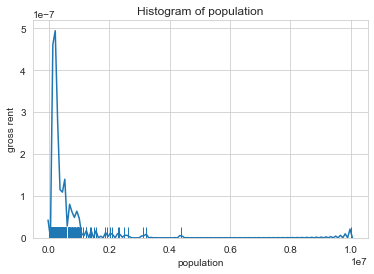

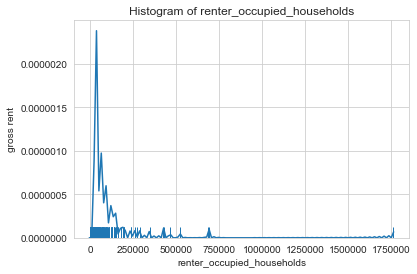

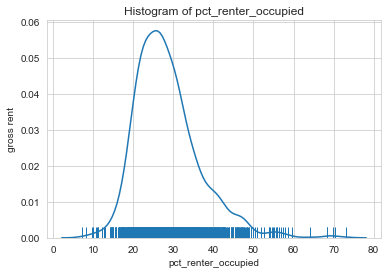

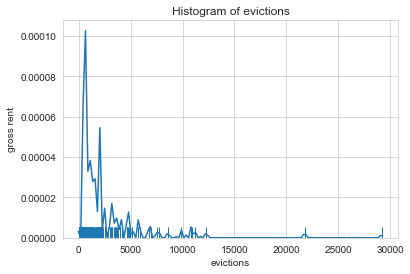

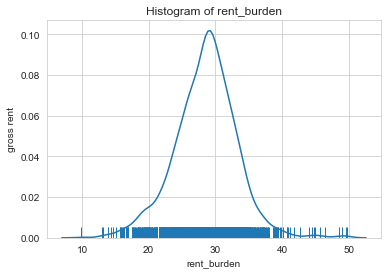

...

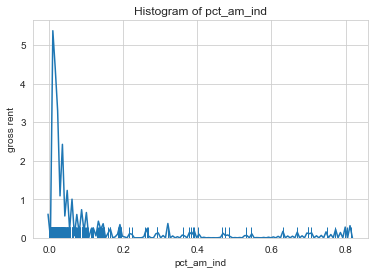

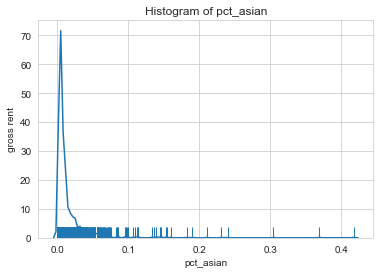

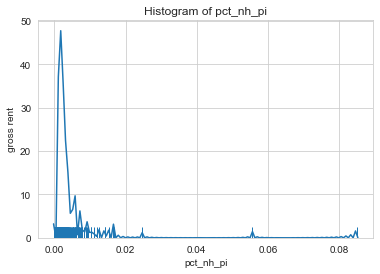

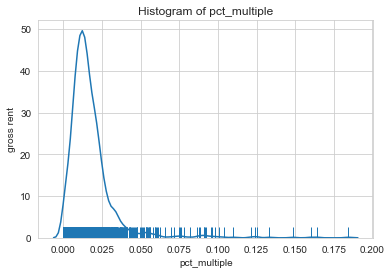

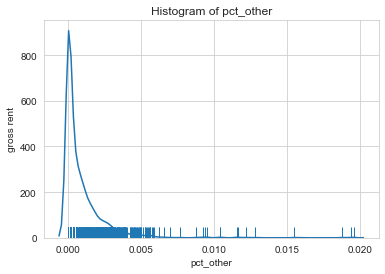

In [112]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_density_hist(gross_rent, cols, bins = 10, hist = False):
    for col in cols:
        sns.set_style("whitegrid")
        sns.distplot(train_values_labels[col], bins = bins, rug=True, hist = hist)
        plt.title('Histogram of ' + col) # Give the plot a main title
        plt.xlabel(col) # Set text for the x axis
        plt.ylabel('gross rent')# Set text for y axis
        plt.show()
        
plot_density_hist(train_values_labels, num_cols) 

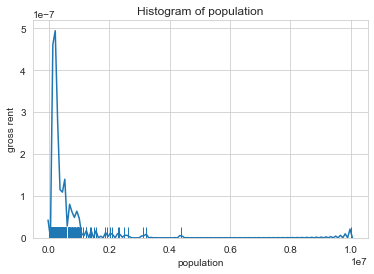

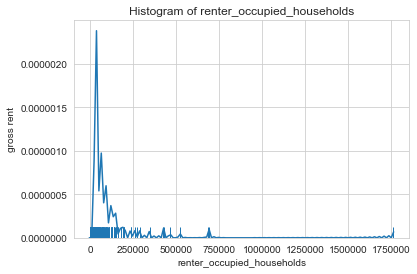

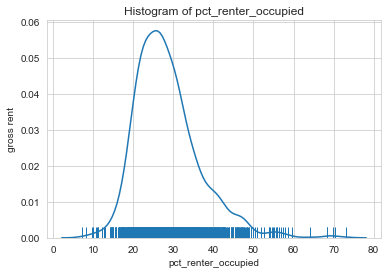

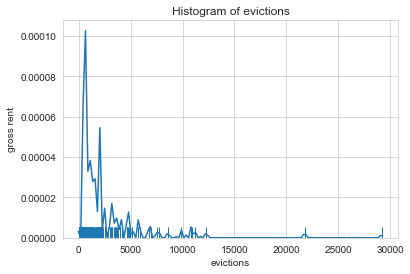

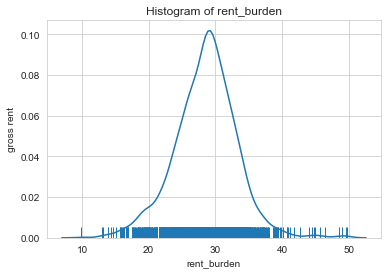

...

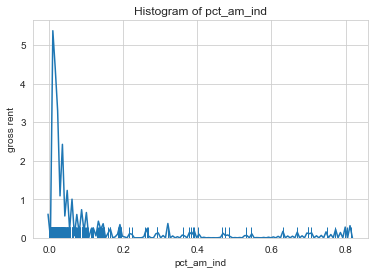

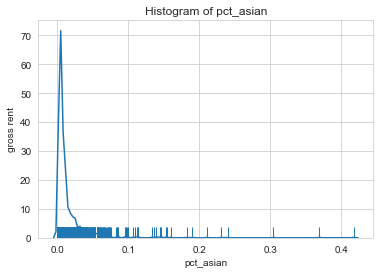

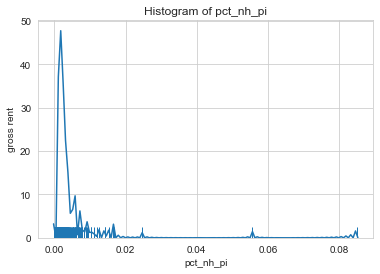

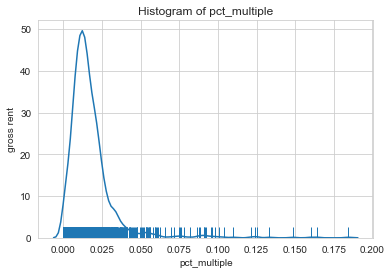

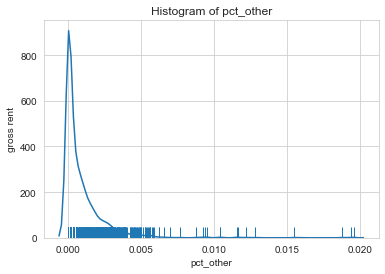

In [113]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_density_hist(gross_rent, cols, bins = 10, hist = False):
    for col in cols:
        sns.set_style("whitegrid")
        sns.distplot(train_values_labels[col], bins = bins, rug=True, hist = hist)
        plt.title('Histogram of ' + col) # Give the plot a main title
        plt.xlabel(col) # Set text for the x axis
        plt.ylabel('gross rent')# Set text for y axis
        plt.show()
        
plot_density_hist(test_values, num_cols) 

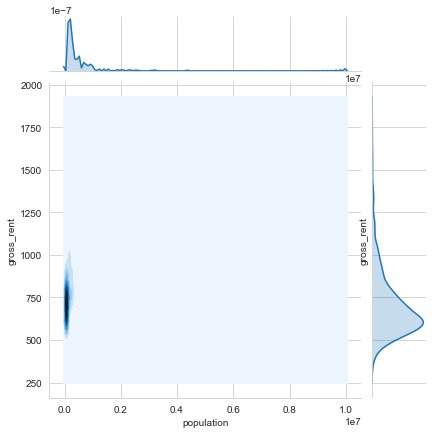

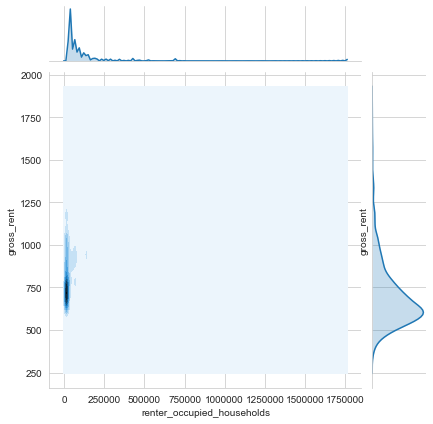

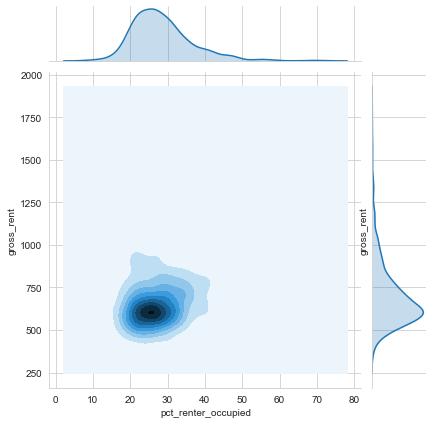

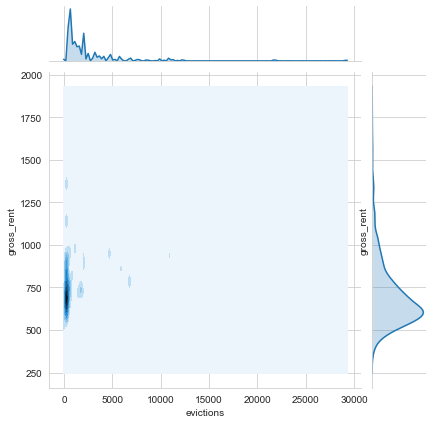

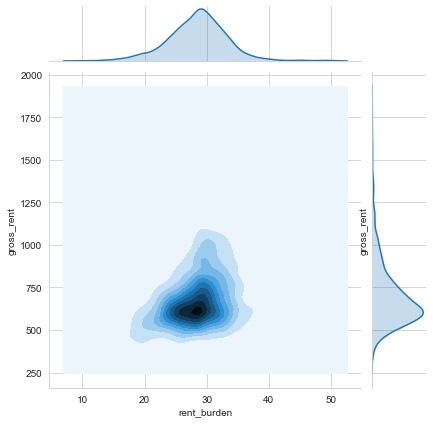

...

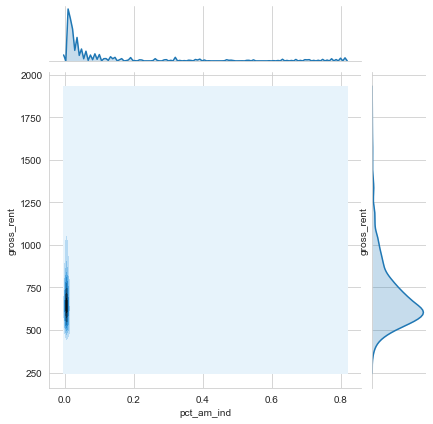

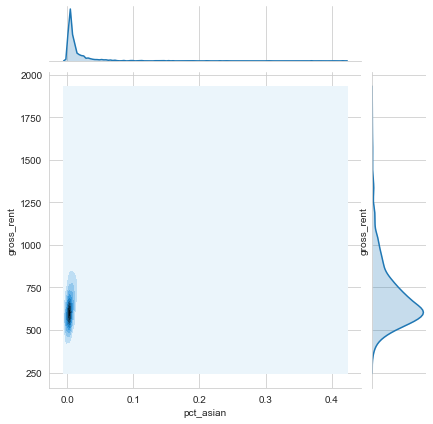

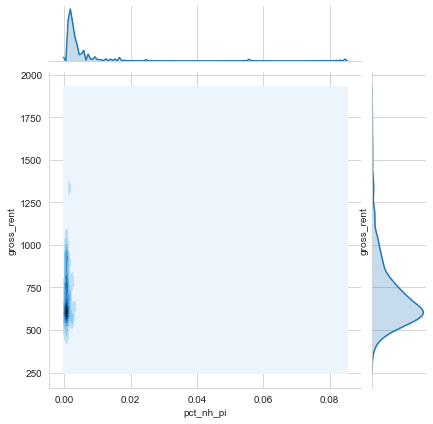

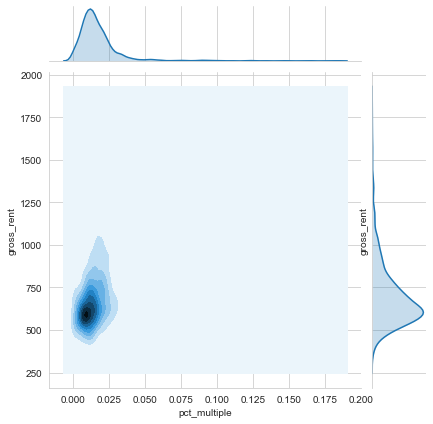

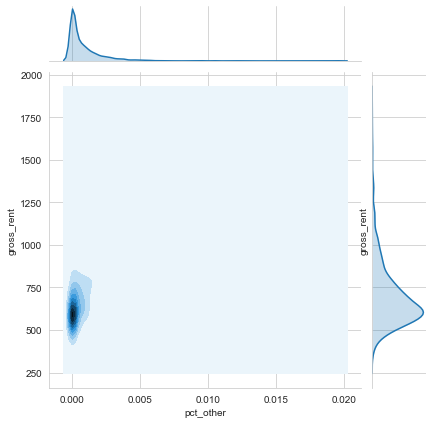

In [114]:
def plot_density_2d(auto_prices, cols, col_y = 'gross_rent', kind ='kde'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.jointplot(col, col_y, data=train_values_labels, kind=kind)
        #plt.xlabel(col) # Set text for the x axis
        plt.ylabel(col_y)# Set text for y axis
        plt.show()

plot_density_2d(train_values_labels, num_cols)    

In [115]:
train_values_labels['evictionslog'] = np.log(train_values_labels['evictions']+25)

In [116]:
test_values['evictionslog'] = np.log(test_values['evictions']+25)

In [117]:



train_values_labels['homicides_per_100klog'] = np.log(train_values_labels['homicides_per_100k']+30)

In [118]:



test_values['homicides_per_100klog'] = np.log(test_values['homicides_per_100k']+30)

In [119]:
train_values_labels['populationlog'] = np.log(train_values_labels['population'])

In [120]:
test_values['populationlog'] = np.log(test_values['population'])

In [121]:
train_values_labels['renter_occupied_householdslog'] = np.log(train_values_labels['renter_occupied_households'])

In [122]:
test_values['renter_occupied_householdslog'] = np.log(test_values['renter_occupied_households'])

In [123]:
train_values_labels['pct_renter_occupiedlog'] = np.log(train_values_labels['pct_renter_occupied'])

In [124]:
test_values['pct_renter_occupiedlog'] = np.log(test_values['pct_renter_occupied'])

In [125]:
train_values_labels['rent_burdenlog'] = np.log(train_values_labels['rent_burden'])

In [126]:
test_values['rent_burdenlog'] = np.log(test_values['rent_burden'])

In [127]:
train_values_labels['poverty_ratelog'] = np.sqrt(train_values_labels['poverty_rate'])

In [128]:
test_values['poverty_ratelog'] = np.sqrt(test_values['poverty_rate'])

In [129]:
train_values_labels['motor_vehicle_crash_deaths_per_100klog'] = np.log(train_values_labels['motor_vehicle_crash_deaths_per_100k']+2000)

In [130]:
test_values['motor_vehicle_crash_deaths_per_100klog'] = np.log(test_values['motor_vehicle_crash_deaths_per_100k']+2000)

In [131]:
train_values_labels['pop_per_dentistlog'] = np.log(train_values_labels['pop_per_dentist'])

In [132]:
test_values['pop_per_dentistlog'] = np.log(test_values['pop_per_dentist'])

In [133]:
train_values_labels['pop_per_primary_care_physicianlog'] = np.log(train_values_labels['pop_per_primary_care_physician'])

In [134]:
test_values['pop_per_primary_care_physicianlog'] = np.log(test_values['pop_per_primary_care_physician'])

In [135]:
train_values_labels['pct_adults_less_than_a_high_school_diplomalog'] = np.log(train_values_labels['pct_adults_less_than_a_high_school_diploma'])

In [136]:
test_values['pct_adults_less_than_a_high_school_diplomalog'] = np.log(test_values['pct_adults_less_than_a_high_school_diploma'])

In [137]:
train_values_labels['pct_adults_bachelors_or_higherlog'] = np.log(train_values_labels['pct_adults_bachelors_or_higher'])

In [138]:
test_values['pct_adults_bachelors_or_higherlog'] = (test_values['pct_adults_bachelors_or_higher'])**2

In [139]:
train_values_labels['gross_rentlog'] = np.log(train_values_labels['gross_rent'])

In [140]:
train_values_labels['air_pollution_particulate_matter_valuelog'] = np.log(train_values_labels['air_pollution_particulate_matter_value']+25)

In [141]:
test_values['air_pollution_particulate_matter_valuelog'] = np.log(test_values['air_pollution_particulate_matter_value']+25)

In [142]:
train_values_labels['pct_uninsured_childrenlog'] = np.log(train_values_labels['pct_uninsured_children'])

In [143]:
test_values['pct_uninsured_childrenlog'] = np.log(test_values['pct_uninsured_children'])

In [144]:
train_values_labels['pct_whitelog'] = np.log(train_values_labels['pct_white'])

In [145]:
test_values['pct_whitelog'] = np.log(test_values['pct_white'])

In [146]:
train_values_labels['pct_af_amlog'] = np.sqrt(train_values_labels['pct_af_am'])

In [147]:
test_values['pct_af_amlog'] = np.sqrt(test_values['pct_af_am'])

In [148]:
train_values_labels['pct_hispaniclog'] = np.sqrt(train_values_labels['pct_hispanic'])

In [149]:
test_values['pct_hispaniclog'] = np.sqrt(test_values['pct_hispanic'])

In [150]:
train_values_labels['pct_am_indlog'] = np.sqrt(train_values_labels['pct_am_ind'])

In [151]:
test_values['pct_am_indlog'] = np.sqrt(test_values['pct_am_ind'])

In [152]:
train_values_labels['pct_asianlog'] = np.sqrt(train_values_labels['pct_asian'])

In [153]:
test_values['pct_asianlog'] = np.sqrt(test_values['pct_asian'])

In [154]:
train_values_labels['pct_nh_pilog'] = np.sqrt(train_values_labels['pct_nh_pi'])

In [155]:
test_values['pct_nh_pilog'] = np.sqrt(test_values['pct_nh_pi'])

In [156]:
train_values_labels['pct_multiplelog'] = np.sqrt(train_values_labels['pct_multiple'])

In [157]:
test_values['pct_multiplelog'] = np.sqrt(test_values['pct_multiple'])

In [158]:
train_values_labels['pct_otherlog'] = np.sqrt(train_values_labels['pct_other'])

In [159]:
test_values['pct_otherlog'] = np.sqrt(test_values['pct_other'])

In [160]:
train_values_labels['pct_aged_65_years_and_olderlog'] = np.log(train_values_labels['pct_aged_65_years_and_older'])

In [161]:
test_values['pct_aged_65_years_and_olderlog'] = np.log(test_values['pct_aged_65_years_and_older'])

In [162]:
train_values_labels['heart_disease_mortality_per_100klog'] = np.log(train_values_labels['heart_disease_mortality_per_100k'])

In [163]:
test_values['heart_disease_mortality_per_100klog'] = np.log(test_values['heart_disease_mortality_per_100k'])

In [164]:
train_values_labels['death_rate_per_1klog'] = np.log(train_values_labels['death_rate_per_1k'])

In [165]:
test_values['death_rate_per_1klog'] = np.log(test_values['death_rate_per_1k'])

In [166]:
train_values_labels['pct_adult_obesitylog'] = np.log(train_values_labels['pct_adult_obesity'])

In [167]:
test_values['pct_adult_obesitylog'] = np.log(test_values['pct_adult_obesity'])

In [168]:
train_values_labels['pct_adult_smokinglog'] = np.log(train_values_labels['pct_adult_smoking']+25)

In [169]:
test_values['pct_adult_smokinglog'] = np.log(test_values['pct_adult_smoking']+25)

In [170]:
train_values_labels['pct_diabeteslog'] = np.log(train_values_labels['pct_diabetes'])

In [171]:
test_values['pct_diabeteslog'] = np.log(test_values['pct_diabetes'])

In [172]:
train_values_labels['pct_low_birthweightlog'] = np.log(train_values_labels['pct_low_birthweight'])

In [173]:
test_values['pct_low_birthweightlog'] = np.log(test_values['pct_low_birthweight'])

In [174]:
train_values_labels['pct_physical_inactivitylog'] = np.log(train_values_labels['pct_physical_inactivity'])

In [175]:
test_values['pct_physical_inactivitylog'] = np.log(test_values['pct_physical_inactivity'])

In [176]:
train_values_labels['pct_excessive_drinkinglog'] = np.log(train_values_labels['pct_excessive_drinking']+25)

In [177]:
test_values['pct_excessive_drinkinglog'] = np.log(test_values['pct_excessive_drinking']+25)

In [178]:
train_values_labels['pct_below_18_years_of_agelog'] = np.log(train_values_labels['pct_below_18_years_of_age']+25)

In [179]:
test_values['pct_below_18_years_of_agelog'] = np.log(test_values['pct_below_18_years_of_age'])

In [180]:
train_values_labels['pct_adults_with_high_school_diplomalog'] = np.log(train_values_labels['pct_adults_with_high_school_diploma'])

In [181]:
test_values['pct_adults_with_high_school_diplomalog'] = np.log(test_values['pct_adults_with_high_school_diploma'])

In [182]:
train_values_labels['pct_adults_with_some_collegelog'] = np.log(train_values_labels['pct_adults_with_some_college'])

In [183]:
test_values['pct_adults_with_some_collegelog'] = np.log(test_values['pct_adults_with_some_college'])

In [184]:
train_values_labels['birth_rate_per_1klog'] = np.log(train_values_labels['birth_rate_per_1k'])

In [185]:
test_values['birth_rate_per_1klog'] = np.log(test_values['birth_rate_per_1k'])

In [186]:
train_values_labels['pct_civilian_laborlog'] = np.log(train_values_labels['pct_civilian_labor'])

In [187]:
test_values['pct_civilian_laborlog'] = np.log(test_values['pct_civilian_labor'])

In [188]:
train_values_labels['pct_unemploymentlog'] = np.log(train_values_labels['pct_unemployment'])

In [189]:
test_values['pct_unemploymentlog'] = np.log(test_values['pct_unemployment'])

In [190]:
train_values_labels['pct_uninsured_adultslog'] = np.log(train_values_labels['pct_uninsured_adults']+25)

In [191]:
test_values['pct_uninsured_adultslog'] = np.log(test_values['pct_uninsured_adults']+25)

In [192]:
updated_num_cols = ['populationlog','homicides_per_100klog',
 'motor_vehicle_crash_deaths_per_100klog',  'evictionslog',
 'renter_occupied_householdslog',
 'pct_renter_occupied',
 'rent_burden',
 'poverty_ratelog',
 'pct_civilian_laborlog',
 'pct_unemploymentlog',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smokinglog',
 'pct_diabeteslog',
 'pct_low_birthweightlog',
 'pct_excessive_drinkinglog',
 'pct_physical_inactivitylog',
 'air_pollution_particulate_matter_value',
 'heart_disease_mortality_per_100klog',
 'pop_per_dentistlog',
 'pop_per_primary_care_physicianlog',
 'pct_below_18_years_of_agelog',
 'pct_aged_65_years_and_olderlog',
 'pct_adults_less_than_a_high_school_diplomalog',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k']

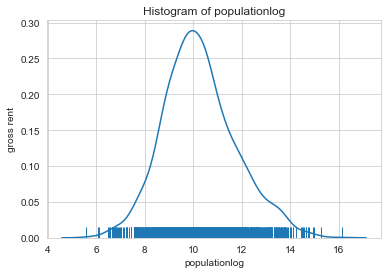

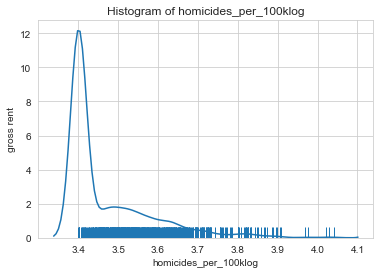

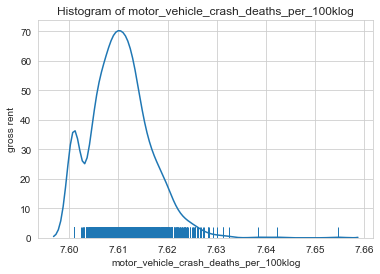

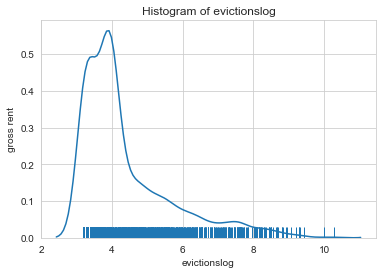

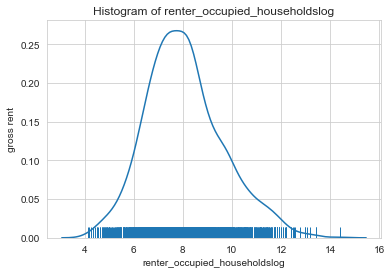

...

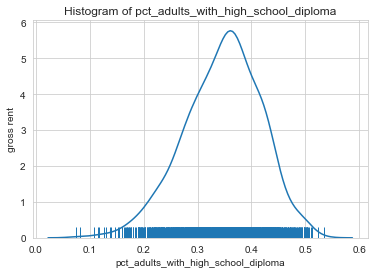

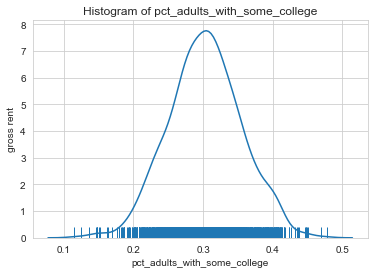

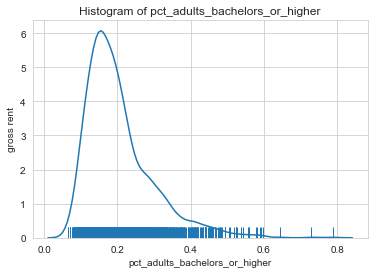

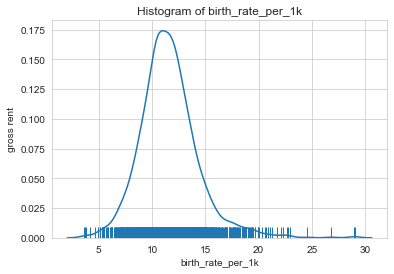

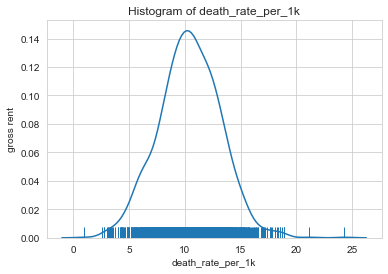

In [193]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_density_hist(gross_rent, cols, bins = 10, hist = False):
    for col in cols:
        sns.set_style("whitegrid")
        sns.distplot(train_values_labels[col], bins = bins, rug=True, hist = hist)
        plt.title('Histogram of ' + col) # Give the plot a main title
        plt.xlabel(col) # Set text for the x axis
        plt.ylabel('gross rent')# Set text for y axis
        plt.show()
        
plot_density_hist(train_values_labels, updated_num_cols)

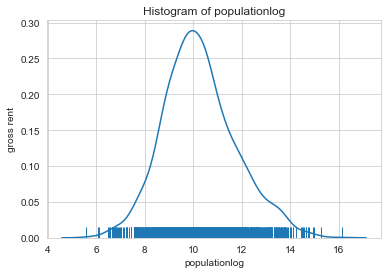

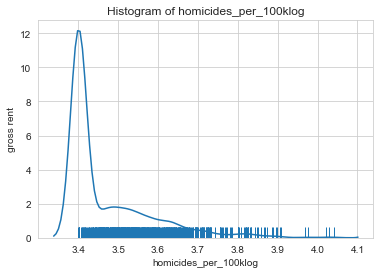

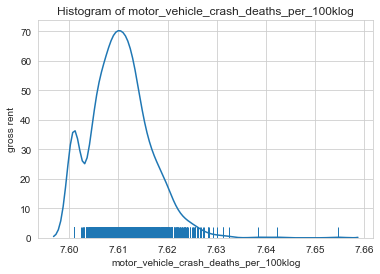

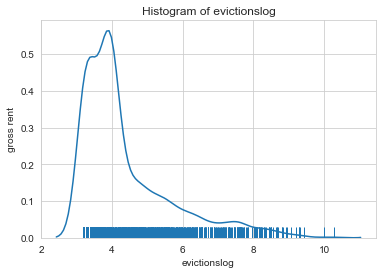

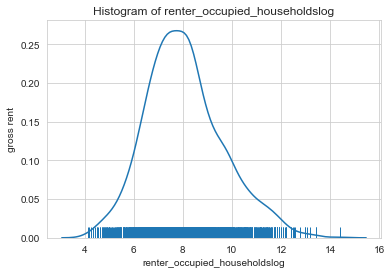

...

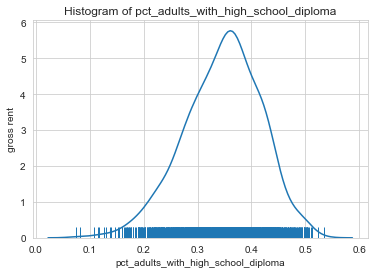

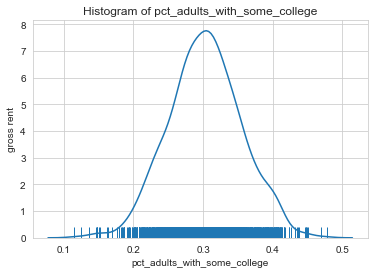

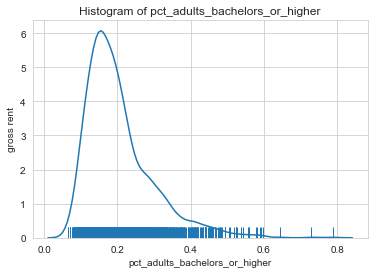

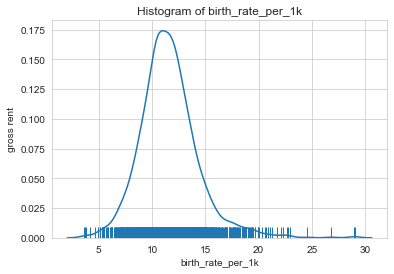

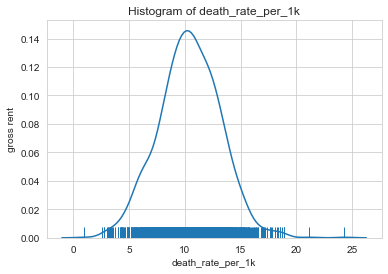

In [194]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_density_hist(gross_rent, cols, bins = 10, hist = False):
    for col in cols:
        sns.set_style("whitegrid")
        sns.distplot(train_values_labels[col], bins = bins, rug=True, hist = hist)
        plt.title('Histogram of ' + col) # Give the plot a main title
        plt.xlabel(col) # Set text for the x axis
        plt.ylabel('gross rent')# Set text for y axis
        plt.show()
        
plot_density_hist(test_values, updated_num_cols) 

In [195]:
train_values_labels.columns

Index(['row_id', 'county_code', 'state', 'population',
       'renter_occupied_households', 'pct_renter_occupied', 'evictions',
       'rent_burden', 'pct_white', 'pct_af_am', 'pct_hispanic', 'pct_am_ind',
       'pct_asian', 'pct_nh_pi', 'pct_multiple', 'pct_other', 'poverty_rate',
       'rucc', 'urban_influence', 'economic_typology', 'pct_civilian_labor',
       'pct_unemployment', 'pct_uninsured_adults', 'pct_uninsured_children',
       'pct_adult_obesity', 'pct_adult_smoking', 'pct_diabetes',
       'pct_low_birthweight', 'pct_excessive_drinking',
       'pct_physical_inactivity', 'air_pollution_particulate_matter_value',
       'homicides_per_100k', 'motor_vehicle_crash_deaths_per_100k',
       'heart_disease_mortality_per_100k', 'pop_per_dentist',
       'pop_per_primary_care_physician', 'pct_female',
       'pct_below_18_years_of_age', 'pct_aged_65_years_and_older',
       'pct_adults_less_than_a_high_school_diploma',
       'pct_adults_with_high_school_diploma', 'pct_adults_wi

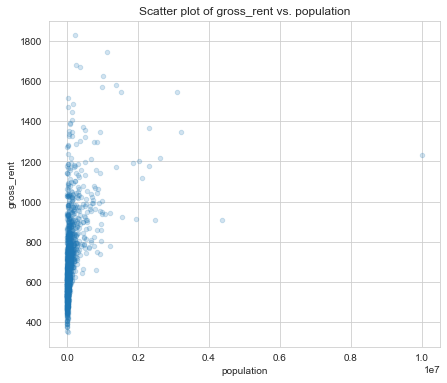

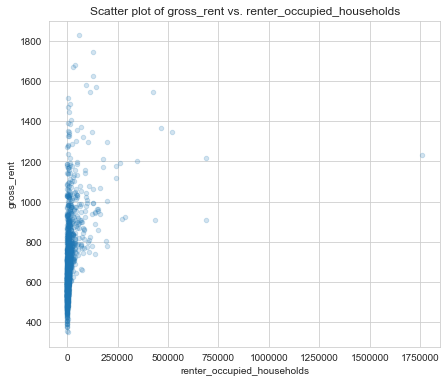

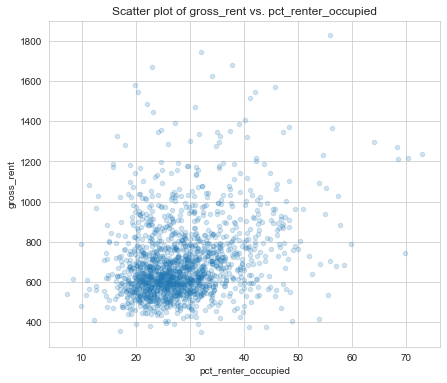

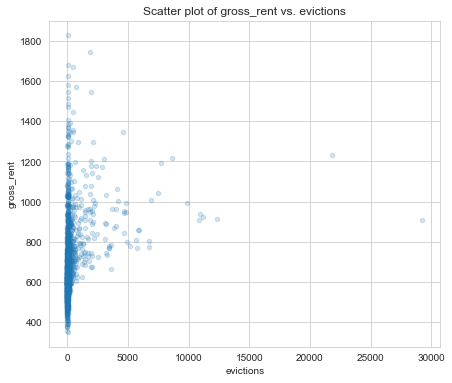

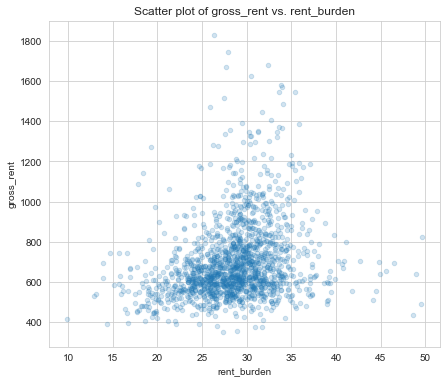

...

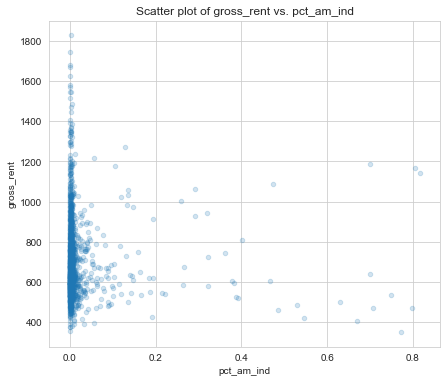

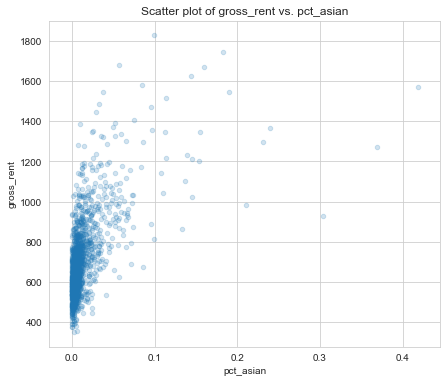

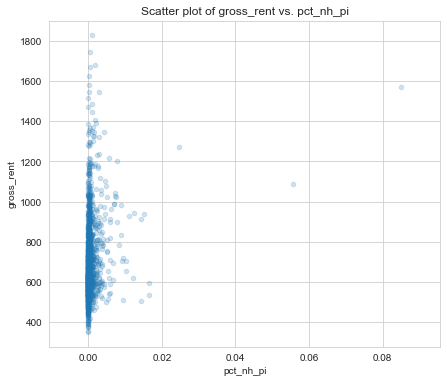

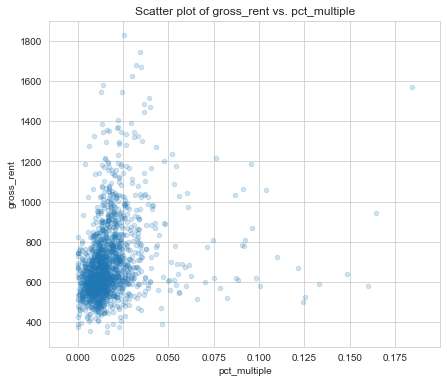

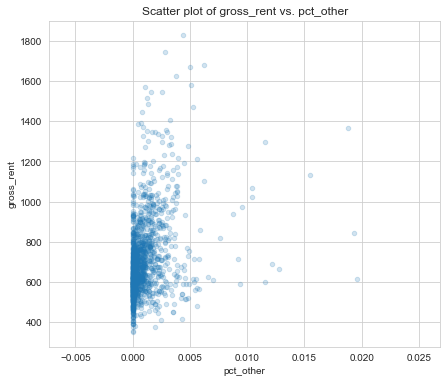

In [196]:
def plot_scatter(train_values_labels, cols, col_y = 'gross_rent', alpha = 1.0):
    for col in cols:
        fig = plt.figure(figsize=(7,6)) # define plot area
        ax = fig.gca() # define axis   
        train_values_labels.plot.scatter(x = col, y = col_y, ax = ax, alpha = alpha)
        ax.set_title('Scatter plot of ' + col_y + ' vs. ' + col) # Give the plot a main title
        ax.set_xlabel(col) # Set text for the x axis
        ax.set_ylabel(col_y
                     )# Set text for y axis
        plt.show()


plot_scatter(train_values_labels, num_cols, alpha = 0.2) 

In [197]:
train_values_labels.columns

Index(['row_id', 'county_code', 'state', 'population',
       'renter_occupied_households', 'pct_renter_occupied', 'evictions',
       'rent_burden', 'pct_white', 'pct_af_am', 'pct_hispanic', 'pct_am_ind',
       'pct_asian', 'pct_nh_pi', 'pct_multiple', 'pct_other', 'poverty_rate',
       'rucc', 'urban_influence', 'economic_typology', 'pct_civilian_labor',
       'pct_unemployment', 'pct_uninsured_adults', 'pct_uninsured_children',
       'pct_adult_obesity', 'pct_adult_smoking', 'pct_diabetes',
       'pct_low_birthweight', 'pct_excessive_drinking',
       'pct_physical_inactivity', 'air_pollution_particulate_matter_value',
       'homicides_per_100k', 'motor_vehicle_crash_deaths_per_100k',
       'heart_disease_mortality_per_100k', 'pop_per_dentist',
       'pop_per_primary_care_physician', 'pct_female',
       'pct_below_18_years_of_age', 'pct_aged_65_years_and_older',
       'pct_adults_less_than_a_high_school_diploma',
       'pct_adults_with_high_school_diploma', 'pct_adults_wi

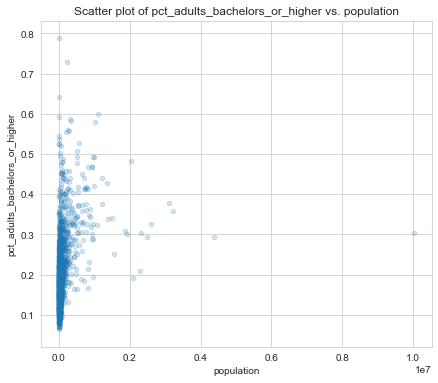

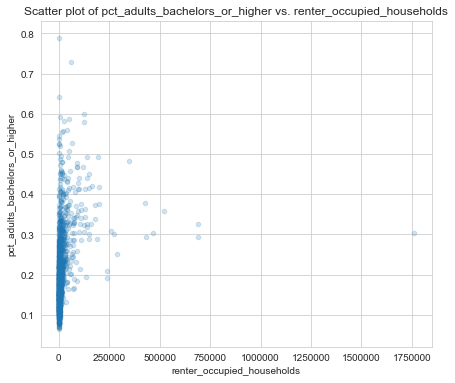

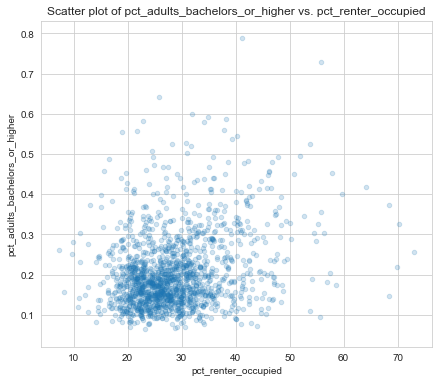

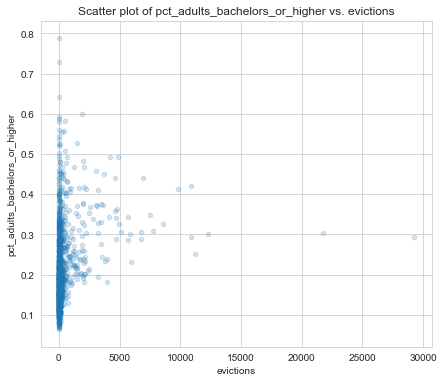

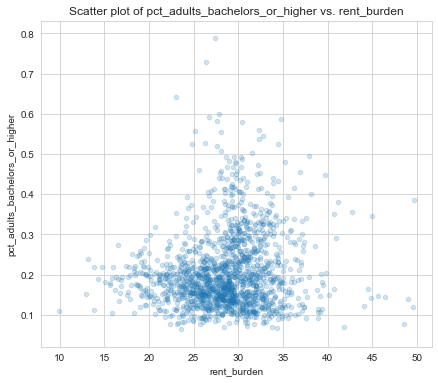

...

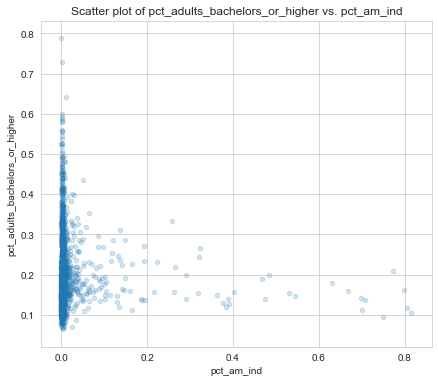

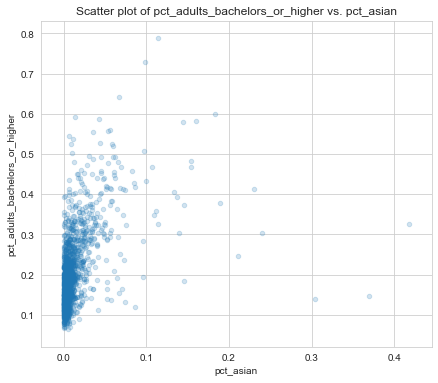

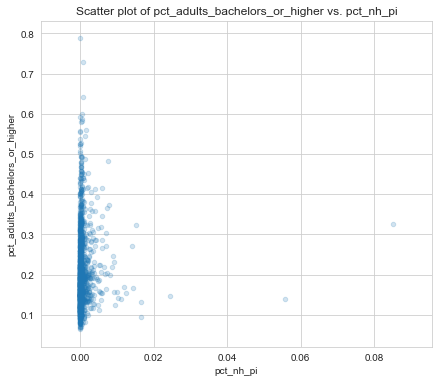

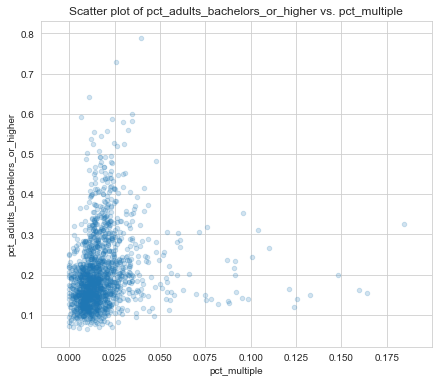

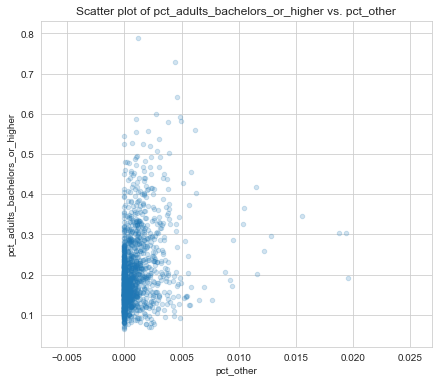

In [198]:
def plot_scatter(train_values_labels, cols, col_y = 'pct_adults_bachelors_or_higher', alpha = 1.0):
    for col in cols:
        fig = plt.figure(figsize=(7,6)) # define plot area
        ax = fig.gca() # define axis   
        train_values_labels.plot.scatter(x = col, y = col_y, ax = ax, alpha = alpha)
        ax.set_title('Scatter plot of ' + col_y + ' vs. ' + col) # Give the plot a main title
        ax.set_xlabel(col) # Set text for the x axis
        ax.set_ylabel(col_y
                     )# Set text for y axis
        plt.show()


plot_scatter(train_values_labels, num_cols, alpha = 0.2) 

In [199]:
train_values_labels.columns

Index(['row_id', 'county_code', 'state', 'population',
       'renter_occupied_households', 'pct_renter_occupied', 'evictions',
       'rent_burden', 'pct_white', 'pct_af_am', 'pct_hispanic', 'pct_am_ind',
       'pct_asian', 'pct_nh_pi', 'pct_multiple', 'pct_other', 'poverty_rate',
       'rucc', 'urban_influence', 'economic_typology', 'pct_civilian_labor',
       'pct_unemployment', 'pct_uninsured_adults', 'pct_uninsured_children',
       'pct_adult_obesity', 'pct_adult_smoking', 'pct_diabetes',
       'pct_low_birthweight', 'pct_excessive_drinking',
       'pct_physical_inactivity', 'air_pollution_particulate_matter_value',
       'homicides_per_100k', 'motor_vehicle_crash_deaths_per_100k',
       'heart_disease_mortality_per_100k', 'pop_per_dentist',
       'pop_per_primary_care_physician', 'pct_female',
       'pct_below_18_years_of_age', 'pct_aged_65_years_and_older',
       'pct_adults_less_than_a_high_school_diploma',
       'pct_adults_with_high_school_diploma', 'pct_adults_wi

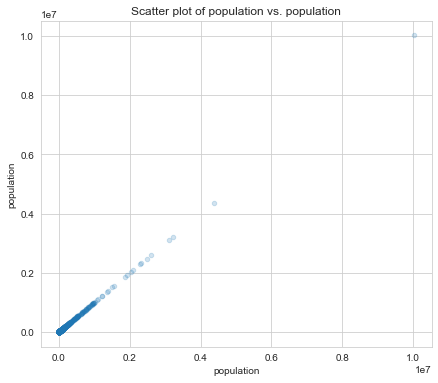

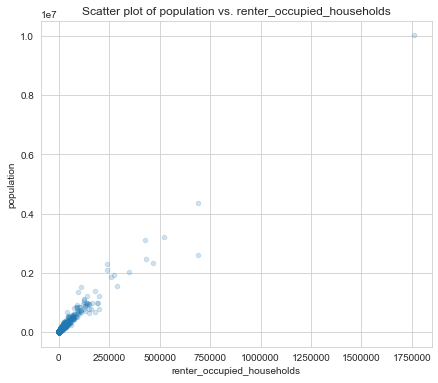

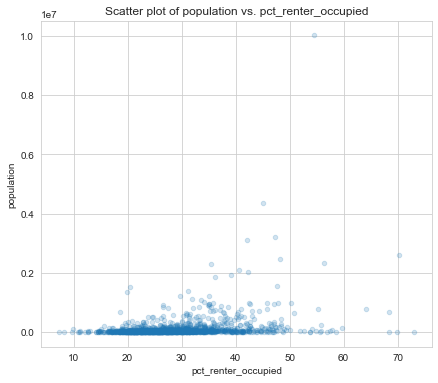

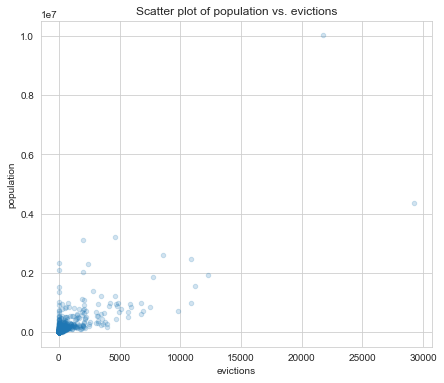

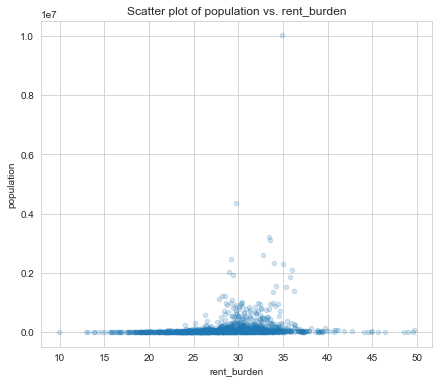

...

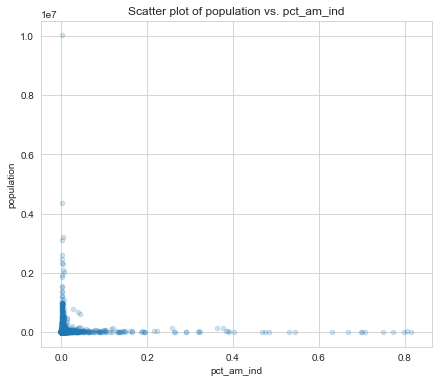

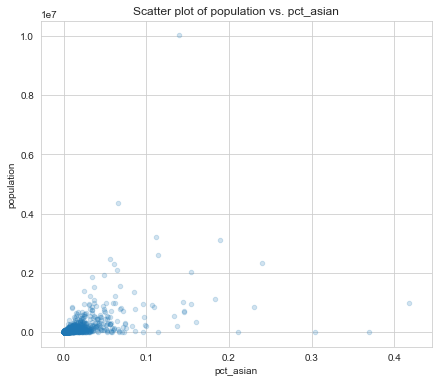

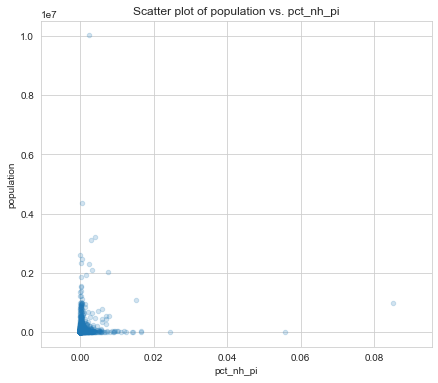

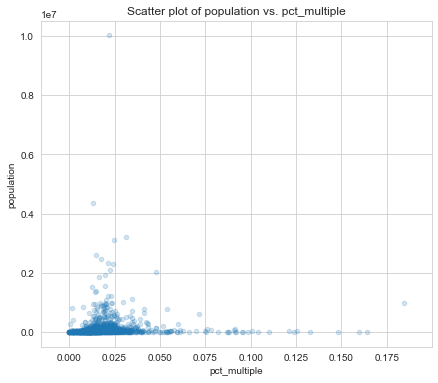

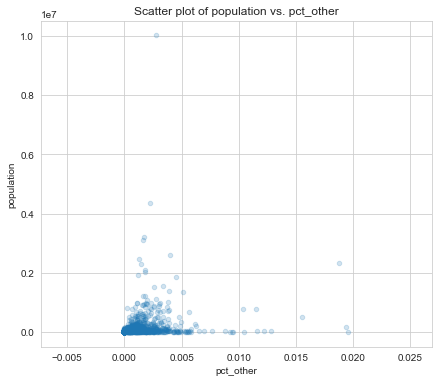

In [200]:
def plot_scatter(train_values_labels, cols, col_y = 'population', alpha = 1.0):
    for col in cols:
        fig = plt.figure(figsize=(7,6)) # define plot area
        ax = fig.gca() # define axis   
        train_values_labels.plot.scatter(x = col, y = col_y, ax = ax, alpha = alpha)
        ax.set_title('Scatter plot of ' + col_y + ' vs. ' + col) # Give the plot a main title
        ax.set_xlabel(col) # Set text for the x axis
        ax.set_ylabel(col_y
                     )# Set text for y axis
        plt.show()


plot_scatter(train_values_labels, num_cols, alpha = 0.2) 

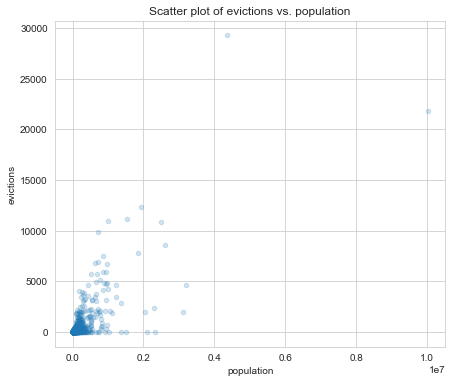

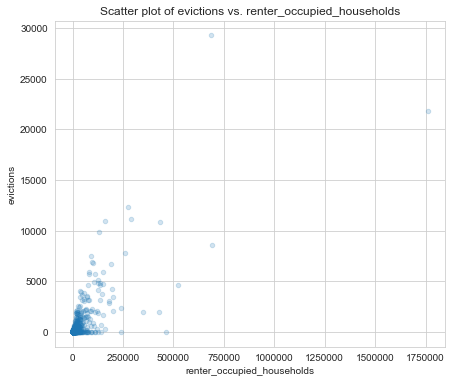

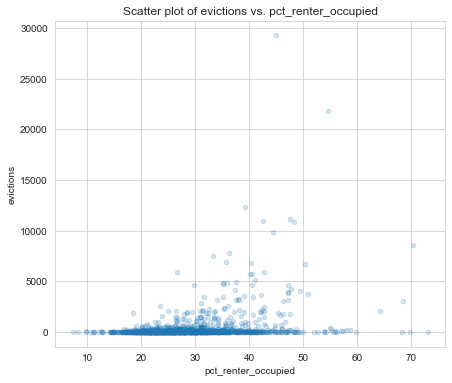

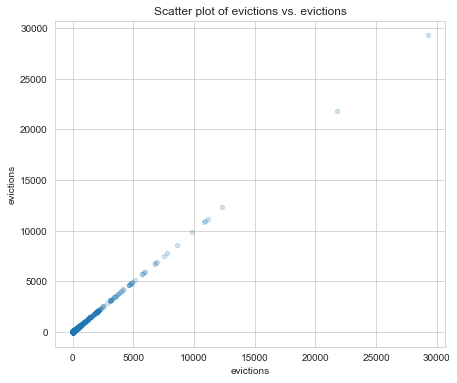

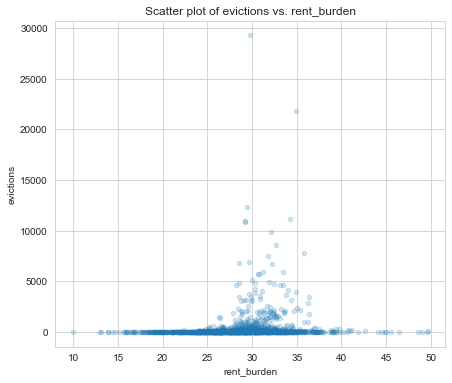

...

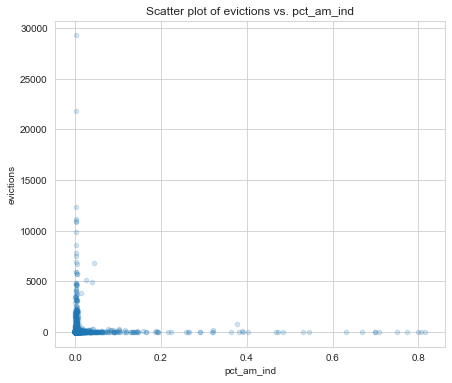

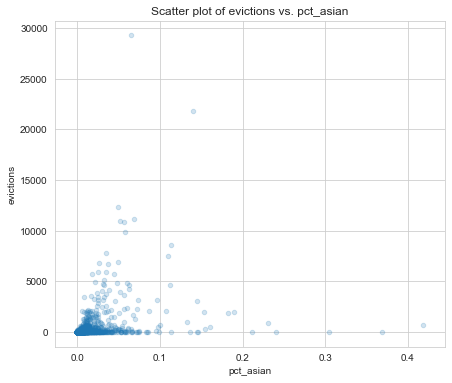

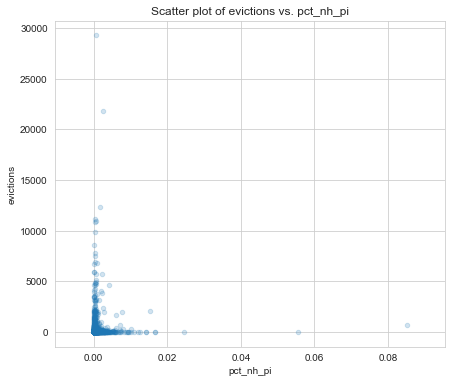

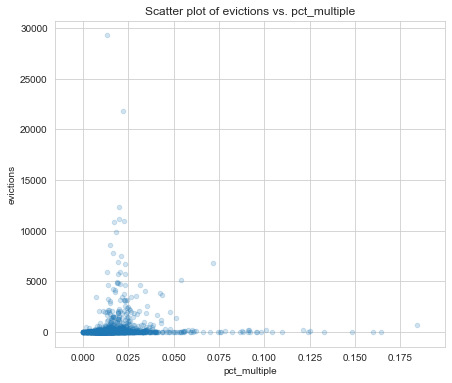

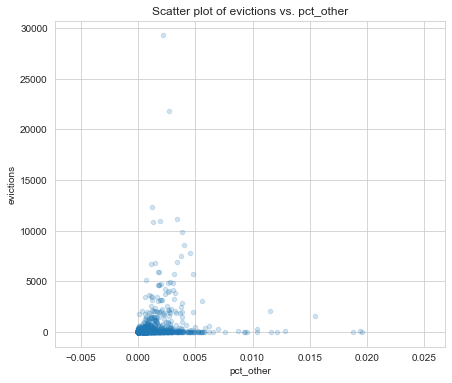

In [201]:
def plot_scatter(train_values_labels, cols, col_y = 'evictions', alpha = 1.0):
    for col in cols:
        fig = plt.figure(figsize=(7,6)) # define plot area
        ax = fig.gca() # define axis   
        train_values_labels.plot.scatter(x = col, y = col_y, ax = ax, alpha = alpha)
        ax.set_title('Scatter plot of ' + col_y + ' vs. ' + col) # Give the plot a main title
        ax.set_xlabel(col) # Set text for the x axis
        ax.set_ylabel(col_y
                     )# Set text for y axis
        plt.show()


plot_scatter(train_values_labels, num_cols, alpha = 0.2) 

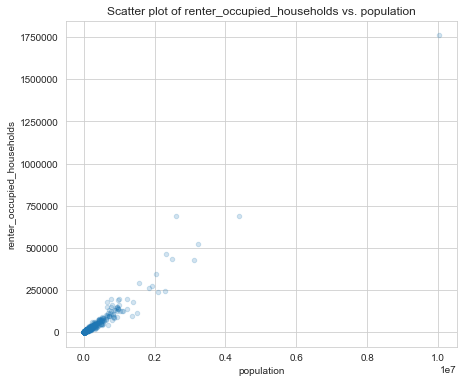

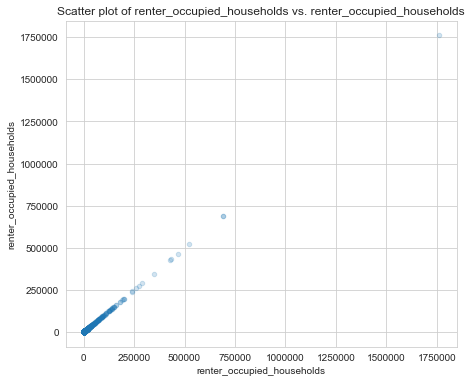

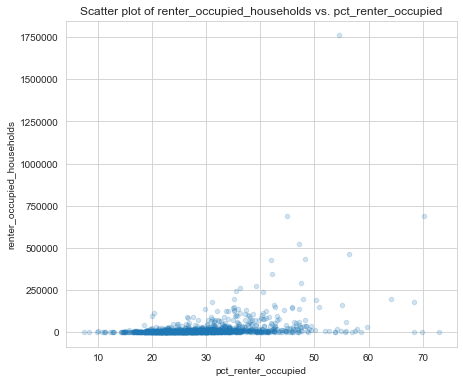

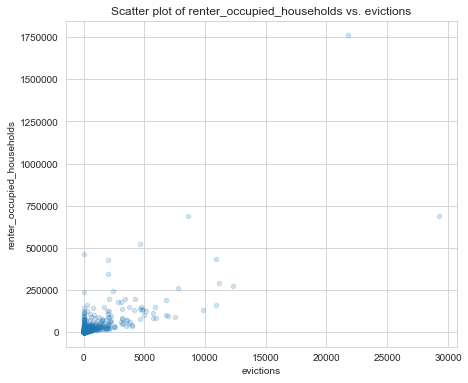

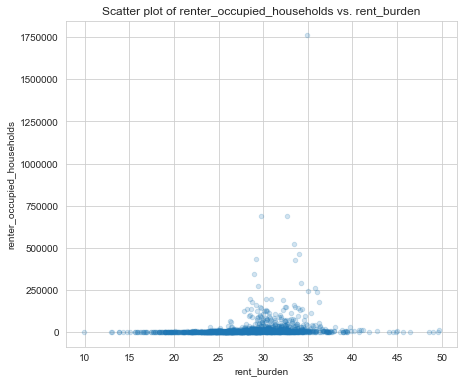

...

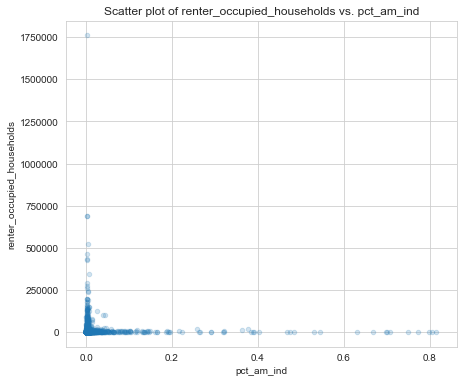

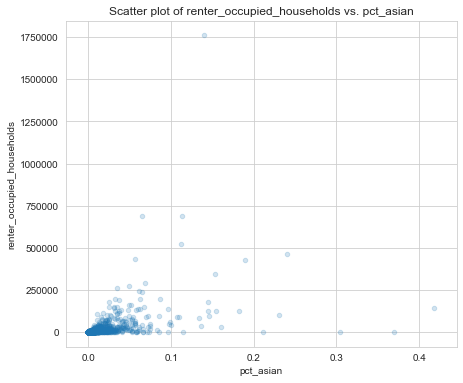

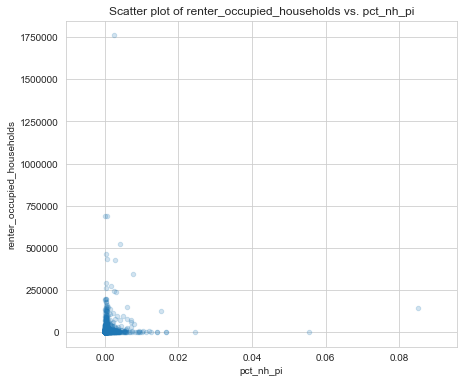

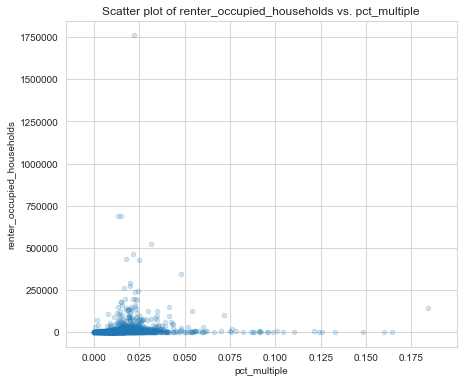

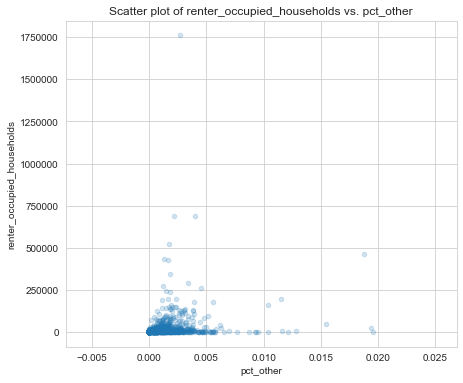

In [202]:
def plot_scatter(train_values_labels, cols, col_y = 'renter_occupied_households', alpha = 1.0):
    for col in cols:
        fig = plt.figure(figsize=(7,6)) # define plot area
        ax = fig.gca() # define axis   
        train_values_labels.plot.scatter(x = col, y = col_y, ax = ax, alpha = alpha)
        ax.set_title('Scatter plot of ' + col_y + ' vs. ' + col) # Give the plot a main title
        ax.set_xlabel(col) # Set text for the x axis
        ax.set_ylabel(col_y
                     )# Set text for y axis
        plt.show()


plot_scatter(train_values_labels, num_cols, alpha = 0.2) 

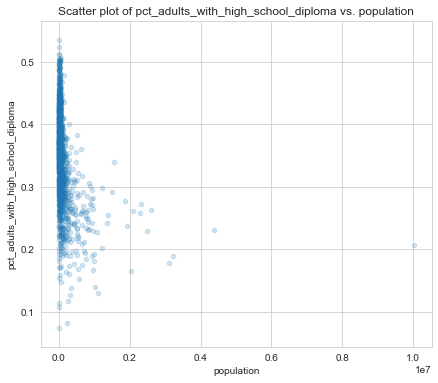

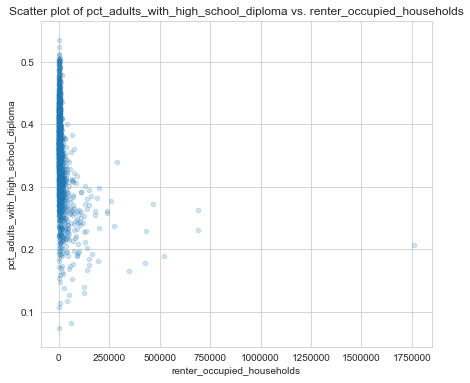

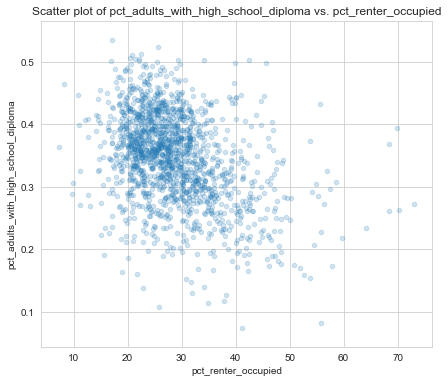

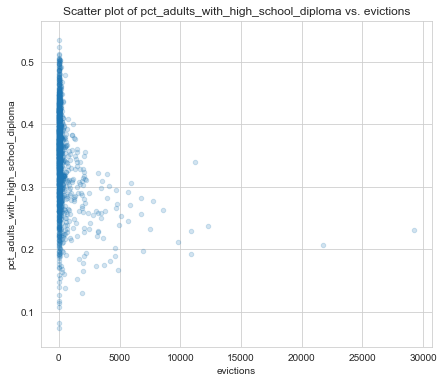

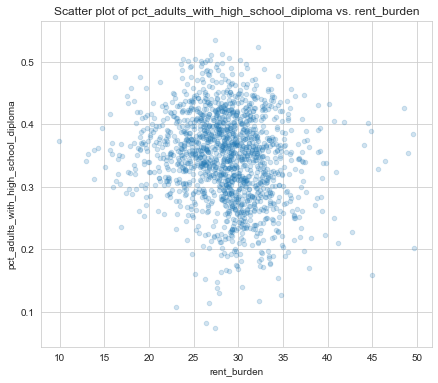

...

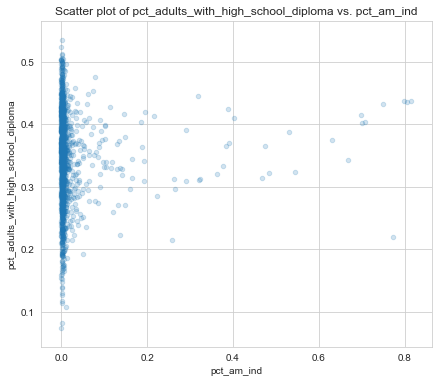

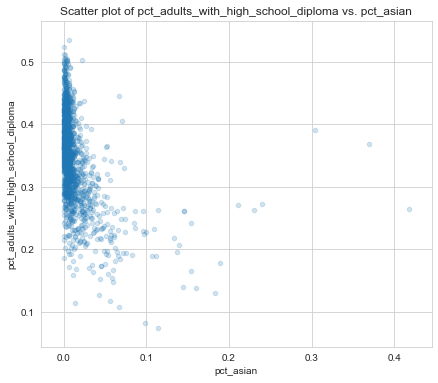

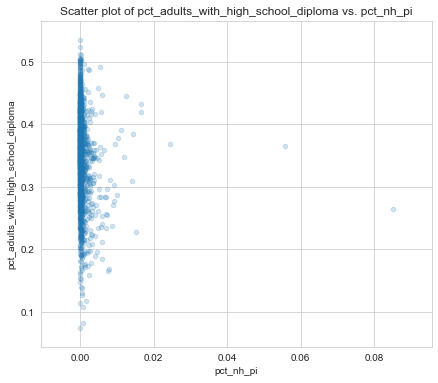

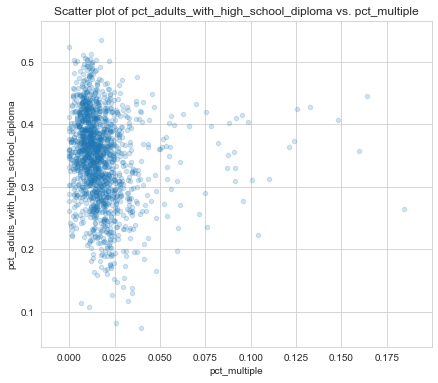

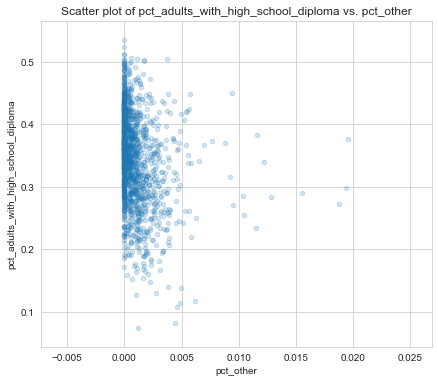

In [203]:
def plot_scatter(train_values_labels, cols, col_y = 'pct_adults_with_high_school_diploma', alpha = 1.0):
    for col in cols:
        fig = plt.figure(figsize=(7,6)) # define plot area
        ax = fig.gca() # define axis   
        train_values_labels.plot.scatter(x = col, y = col_y, ax = ax, alpha = alpha)
        ax.set_title('Scatter plot of ' + col_y + ' vs. ' + col) # Give the plot a main title
        ax.set_xlabel(col) # Set text for the x axis
        ax.set_ylabel(col_y
                     )# Set text for y axis
        plt.show()


plot_scatter(train_values_labels, num_cols, alpha = 0.2) 

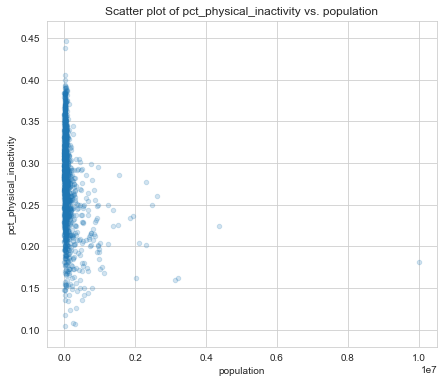

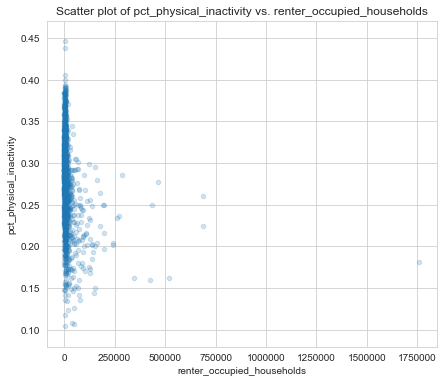

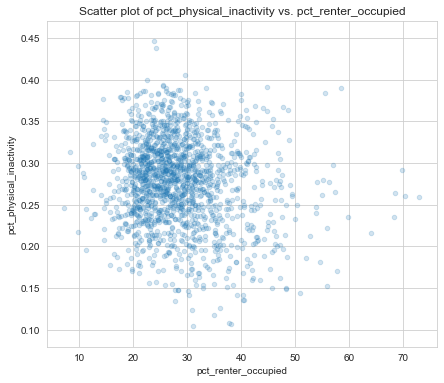

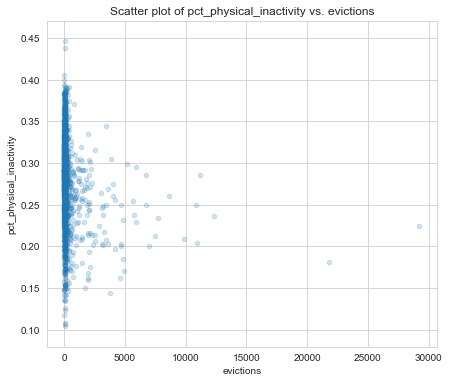

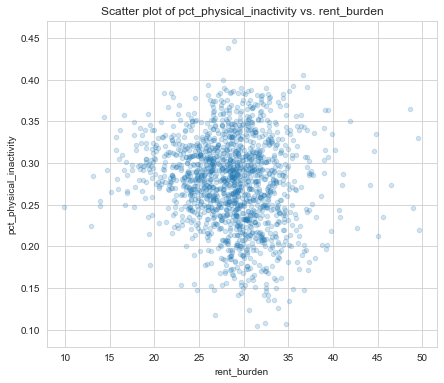

...

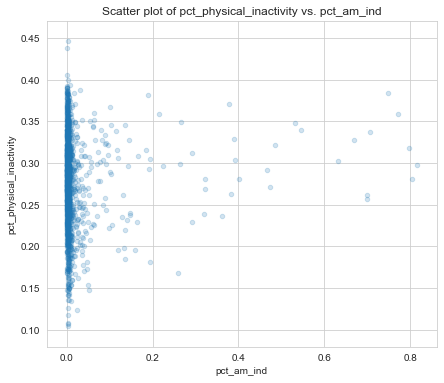

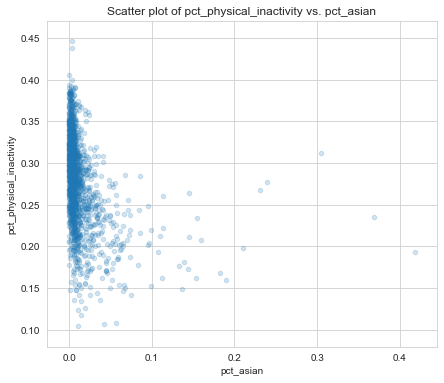

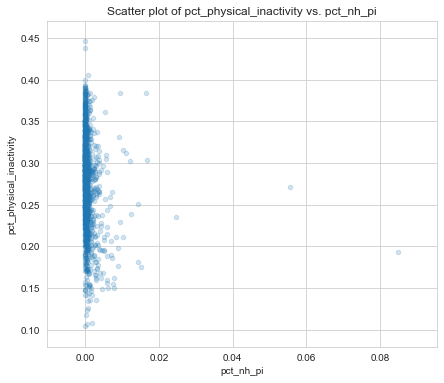

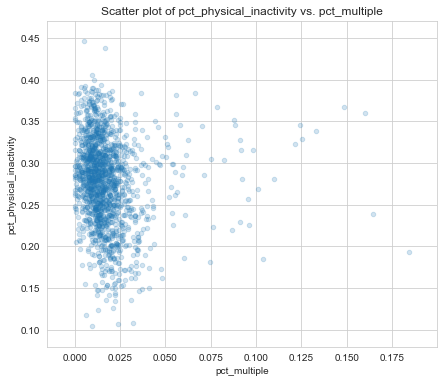

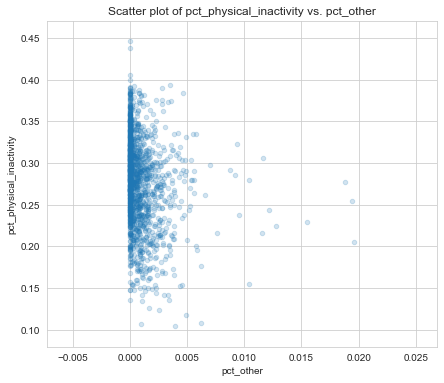

In [204]:
def plot_scatter(train_values_labels, cols, col_y = 'pct_physical_inactivity', alpha = 1.0):
    for col in cols:
        fig = plt.figure(figsize=(7,6)) # define plot area
        ax = fig.gca() # define axis   
        train_values_labels.plot.scatter(x = col, y = col_y, ax = ax, alpha = alpha)
        ax.set_title('Scatter plot of ' + col_y + ' vs. ' + col) # Give the plot a main title
        ax.set_xlabel(col) # Set text for the x axis
        ax.set_ylabel(col_y
                     )# Set text for y axis
        plt.show()


plot_scatter(train_values_labels, num_cols, alpha = 0.2) 

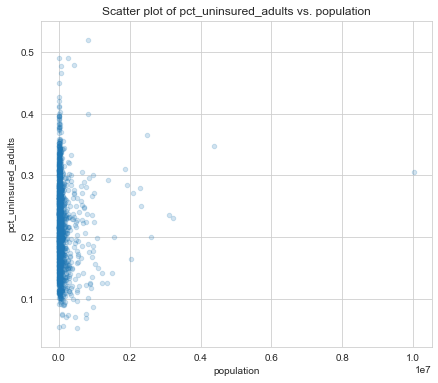

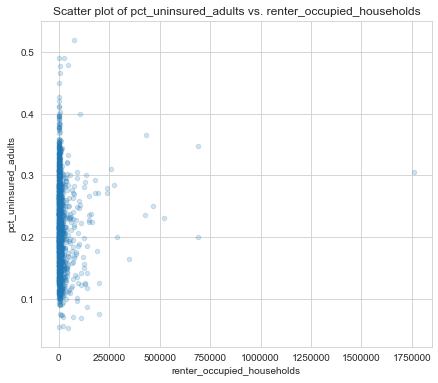

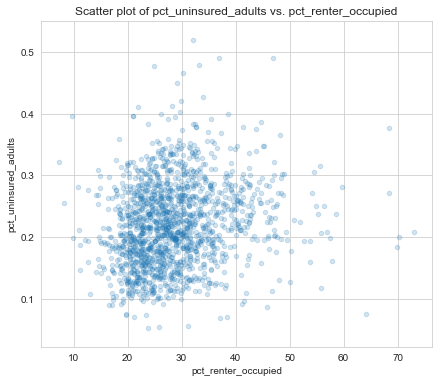

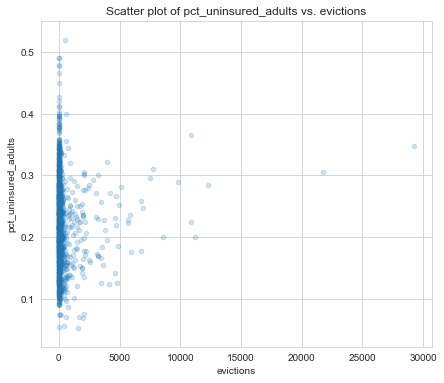

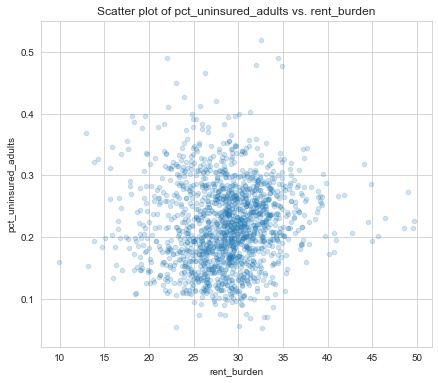

...

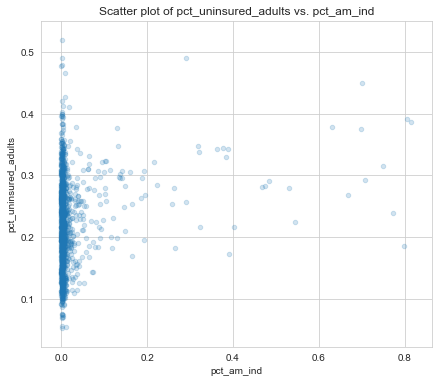

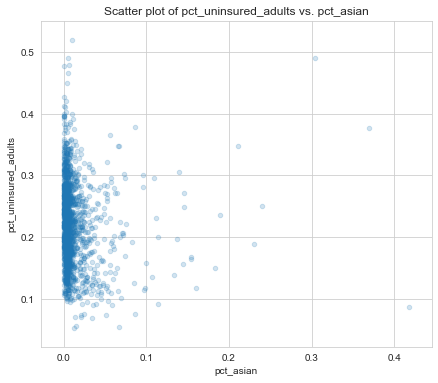

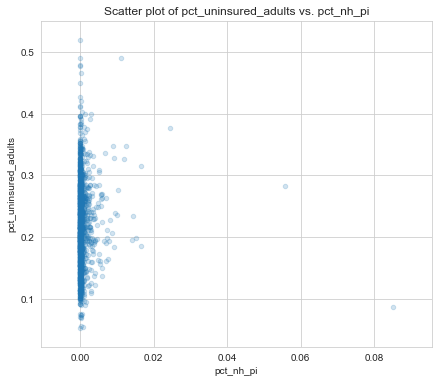

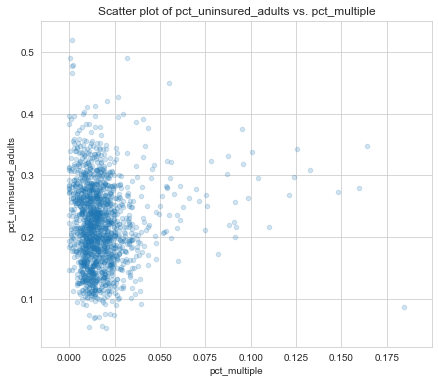

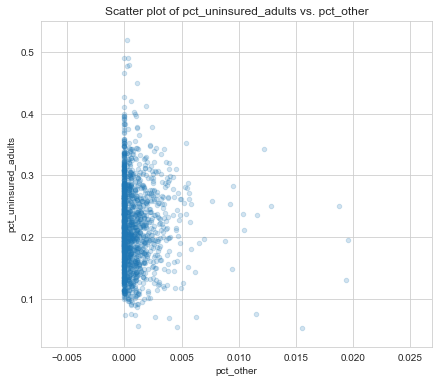

In [205]:
def plot_scatter(train_values_labels, cols, col_y = 'pct_uninsured_adults', alpha = 1.0):
    for col in cols:
        fig = plt.figure(figsize=(7,6)) # define plot area
        ax = fig.gca() # define axis   
        train_values_labels.plot.scatter(x = col, y = col_y, ax = ax, alpha = alpha)
        ax.set_title('Scatter plot of ' + col_y + ' vs. ' + col) # Give the plot a main title
        ax.set_xlabel(col) # Set text for the x axis
        ax.set_ylabel(col_y
                     )# Set text for y axis
        plt.show()


plot_scatter(train_values_labels, num_cols, alpha = 0.2)

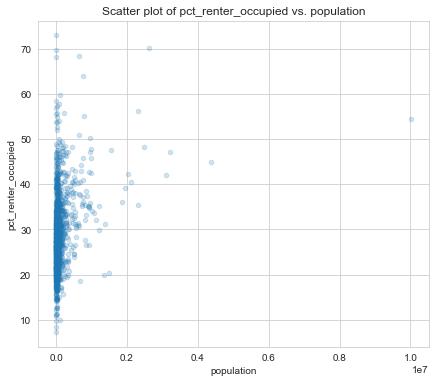

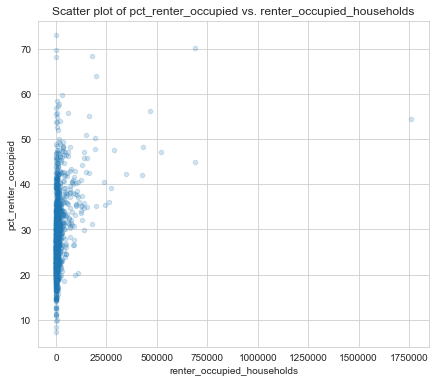

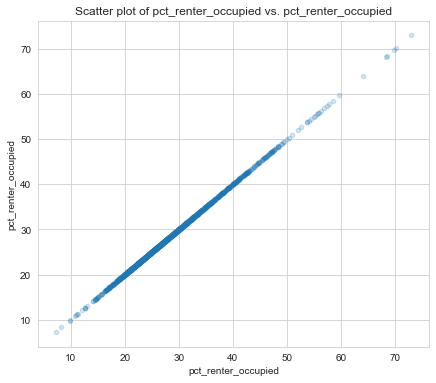

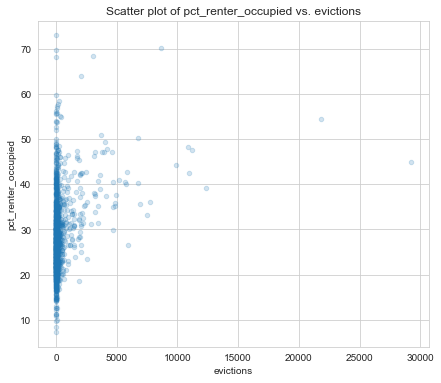

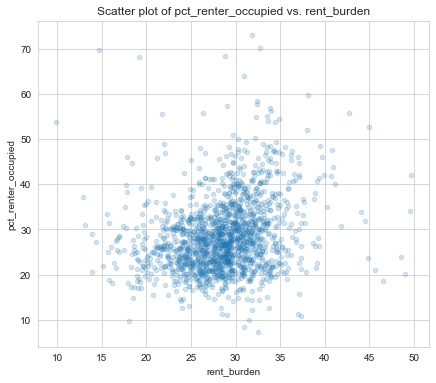

...

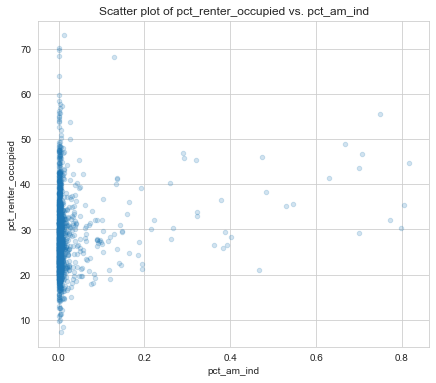

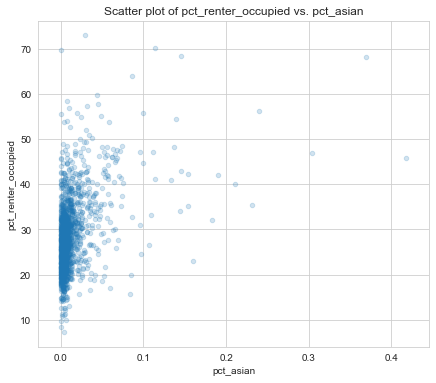

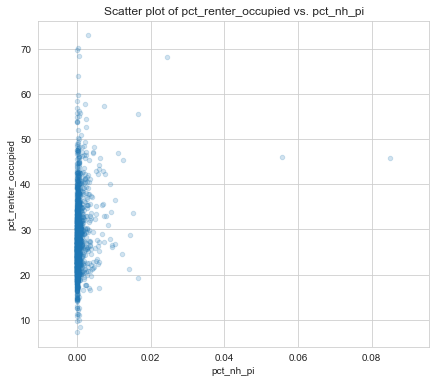

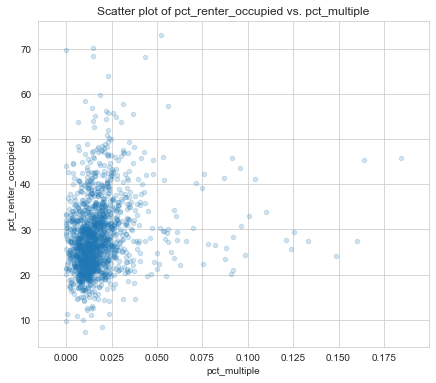

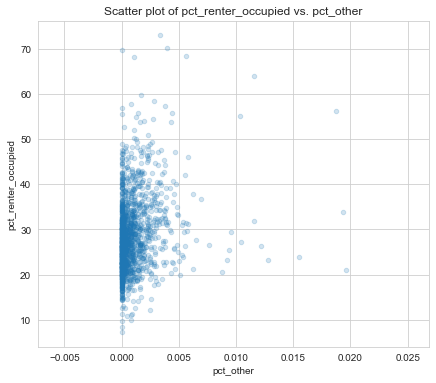

In [206]:
def plot_scatter(train_values_labels, cols, col_y = 'pct_renter_occupied', alpha = 1.0):
    for col in cols:
        fig = plt.figure(figsize=(7,6)) # define plot area
        ax = fig.gca() # define axis   
        train_values_labels.plot.scatter(x = col, y = col_y, ax = ax, alpha = alpha)
        ax.set_title('Scatter plot of ' + col_y + ' vs. ' + col) # Give the plot a main title
        ax.set_xlabel(col) # Set text for the x axis
        ax.set_ylabel(col_y
                     )# Set text for y axis
        plt.show()


plot_scatter(train_values_labels, num_cols, alpha = 0.2)

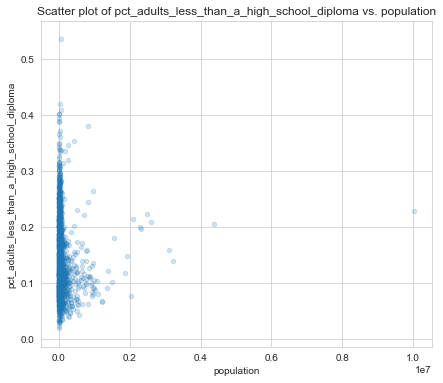

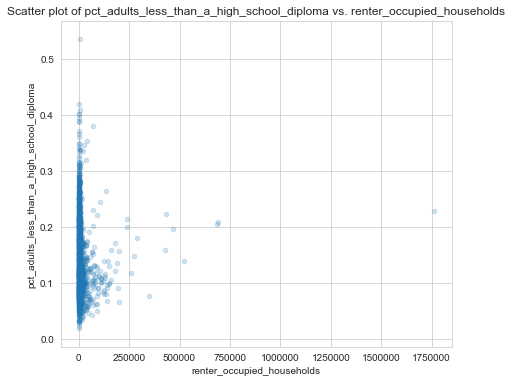

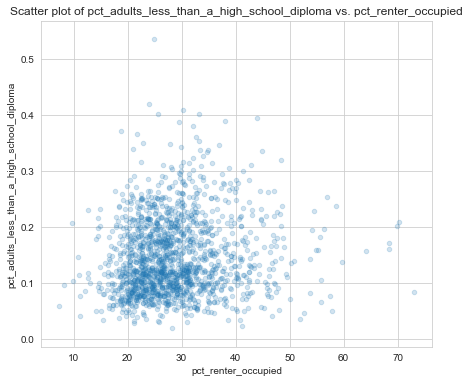

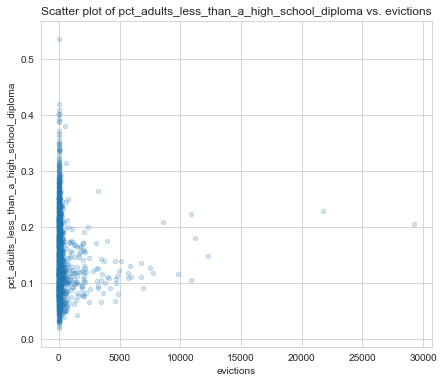

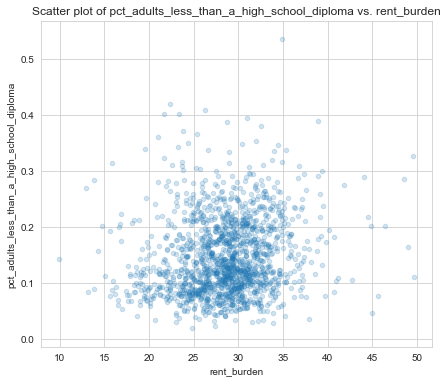

...

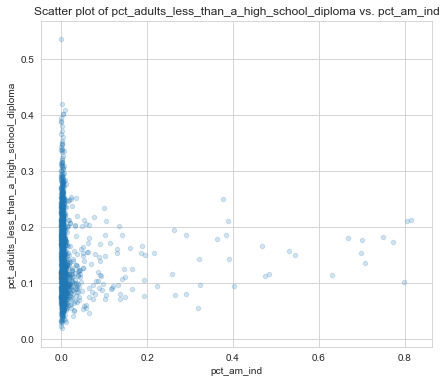

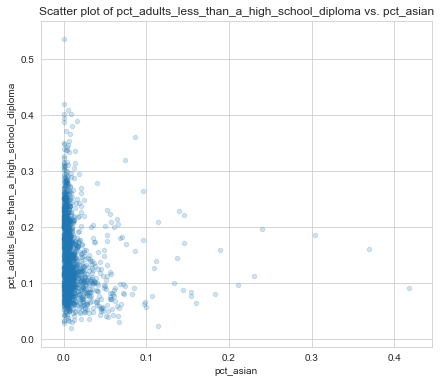

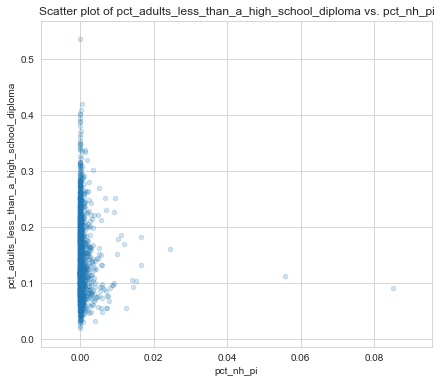

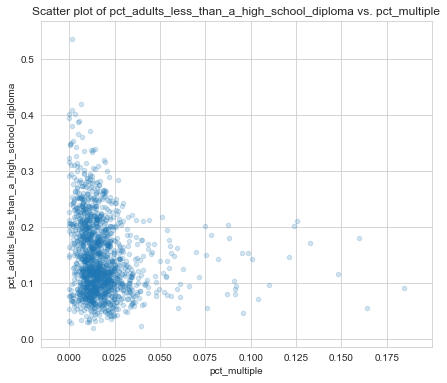

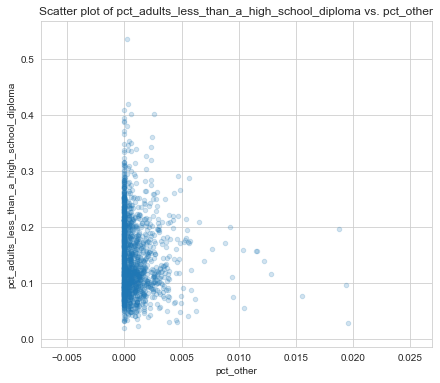

In [207]:
def plot_scatter(train_values_labels, cols, col_y = 'pct_adults_less_than_a_high_school_diploma', alpha = 1.0):
    for col in cols:
        fig = plt.figure(figsize=(7,6)) # define plot area
        ax = fig.gca() # define axis   
        train_values_labels.plot.scatter(x = col, y = col_y, ax = ax, alpha = alpha)
        ax.set_title('Scatter plot of ' + col_y + ' vs. ' + col) # Give the plot a main title
        ax.set_xlabel(col) # Set text for the x axis
        ax.set_ylabel(col_y
                     )# Set text for y axis
        plt.show()


plot_scatter(train_values_labels, num_cols, alpha = 0.2)

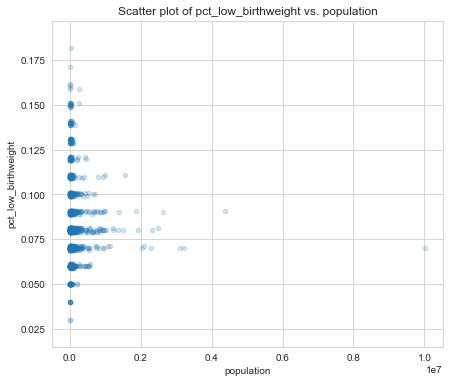

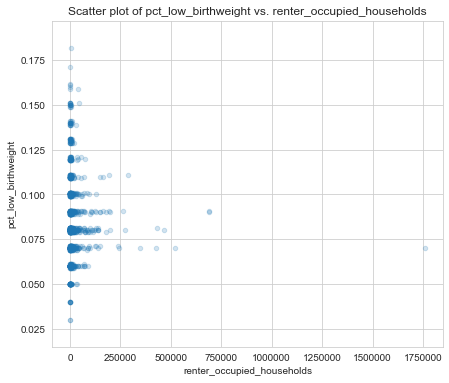

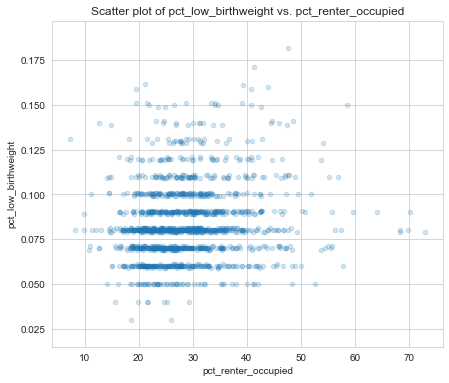

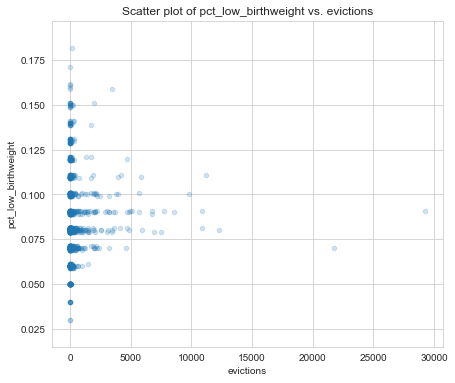

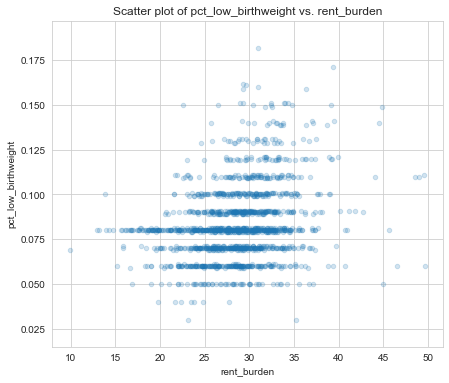

...

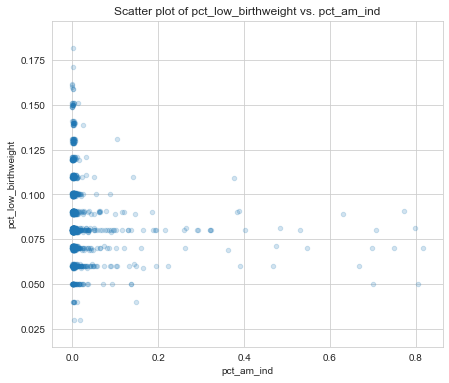

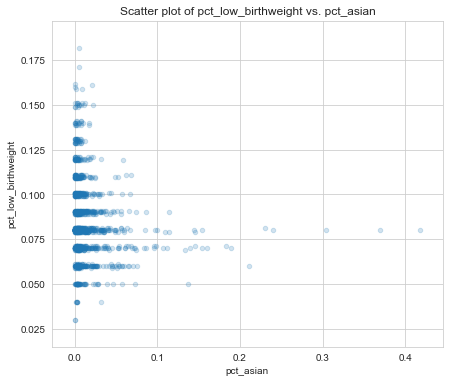

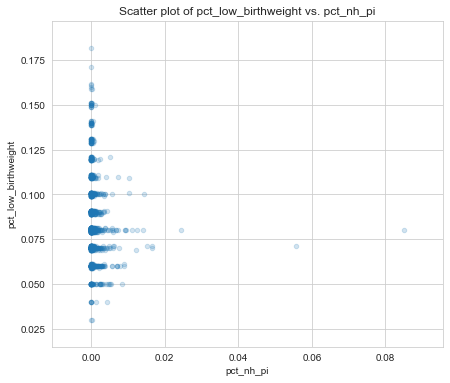

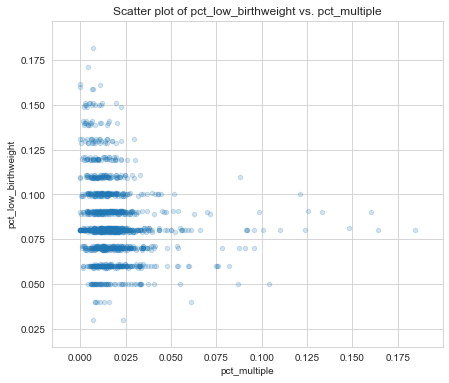

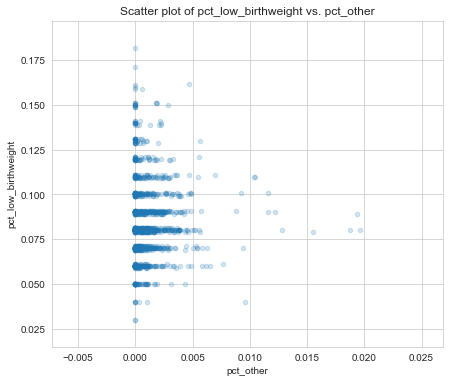

In [208]:
def plot_scatter(train_values_labels, cols, col_y = 'pct_low_birthweight', alpha = 1.0):
    for col in cols:
        fig = plt.figure(figsize=(7,6)) # define plot area
        ax = fig.gca() # define axis   
        train_values_labels.plot.scatter(x = col, y = col_y, ax = ax, alpha = alpha)
        ax.set_title('Scatter plot of ' + col_y + ' vs. ' + col) # Give the plot a main title
        ax.set_xlabel(col) # Set text for the x axis
        ax.set_ylabel(col_y
                     )# Set text for y axis
        plt.show()


plot_scatter(train_values_labels, num_cols, alpha = 0.2)

In [209]:
train_values_labels[['pct_adults_bachelors_or_higher','motor_vehicle_crash_deaths_per_100k']].corr()

,pct_adults_bachelors_or_higher,motor_vehicle_crash_deaths_per_100k
pct_adults_bachelors_or_higher,1.000000,-0.407155
motor_vehicle_crash_deaths_per_100k,-0.407155,1.000000


In [210]:
train_values_labels[['pct_adults_bachelors_or_higher','pct_adult_smoking']].corr()

,pct_adults_bachelors_or_higher,pct_adult_smoking
pct_adults_bachelors_or_higher,1.000000,-0.226848
pct_adult_smoking,-0.226848,1.000000


In [211]:
train_values_labels[['pct_adults_bachelors_or_higher','pct_excessive_drinking']].corr()

,pct_adults_bachelors_or_higher,pct_excessive_drinking
pct_adults_bachelors_or_higher,1.000000,0.367517
pct_excessive_drinking,0.367517,1.000000


In [212]:
train_values_labels[['pct_adults_bachelors_or_higher','evictions']].corr()

,pct_adults_bachelors_or_higher,evictions
pct_adults_bachelors_or_higher,1.000000,0.239207
evictions,0.239207,1.000000


In [213]:
train_values_labels[['renter_occupied_households','evictions']].corr()

,renter_occupied_households,evictions
renter_occupied_households,1.00000,0.76267
evictions,0.76267,1.00000


In [214]:
train_values_labels[['renter_occupied_households','pct_adults_bachelors_or_higher']].corr()

,renter_occupied_households,pct_adults_bachelors_or_higher
renter_occupied_households,1.000000,0.261647
pct_adults_bachelors_or_higher,0.261647,1.000000


In [215]:
train_values_labels[['renter_occupied_households','population']].corr()

,renter_occupied_households,population
renter_occupied_households,1.000000,0.979015
population,0.979015,1.000000


In [216]:
train_values_labels[['pct_adults_bachelors_or_higher','population']].corr()

,pct_adults_bachelors_or_higher,population
pct_adults_bachelors_or_higher,1.000000,0.295888
population,0.295888,1.000000


In [217]:
train_values_labels[['pct_adults_bachelors_or_higher','pct_adults_with_high_school_diploma']].corr()

,pct_adults_bachelors_or_higher,pct_adults_with_high_school_diploma
pct_adults_bachelors_or_higher,1.000000,-0.763686
pct_adults_with_high_school_diploma,-0.763686,1.000000


In [218]:
train_values_labels[['pct_physical_inactivity','pct_adults_with_high_school_diploma']].corr()

,pct_physical_inactivity,pct_adults_with_high_school_diploma
pct_physical_inactivity,1.000000,0.599897
pct_adults_with_high_school_diploma,0.599897,1.000000


In [219]:
train_values_labels[['pop_per_dentist','pop_per_primary_care_physician']].corr()

,pop_per_dentist,pop_per_primary_care_physician
pop_per_dentist,1.000000,0.408681
pop_per_primary_care_physician,0.408681,1.000000


In [220]:
train_values_labels.columns

Index(['row_id', 'county_code', 'state', 'population',
       'renter_occupied_households', 'pct_renter_occupied', 'evictions',
       'rent_burden', 'pct_white', 'pct_af_am', 'pct_hispanic', 'pct_am_ind',
       'pct_asian', 'pct_nh_pi', 'pct_multiple', 'pct_other', 'poverty_rate',
       'rucc', 'urban_influence', 'economic_typology', 'pct_civilian_labor',
       'pct_unemployment', 'pct_uninsured_adults', 'pct_uninsured_children',
       'pct_adult_obesity', 'pct_adult_smoking', 'pct_diabetes',
       'pct_low_birthweight', 'pct_excessive_drinking',
       'pct_physical_inactivity', 'air_pollution_particulate_matter_value',
       'homicides_per_100k', 'motor_vehicle_crash_deaths_per_100k',
       'heart_disease_mortality_per_100k', 'pop_per_dentist',
       'pop_per_primary_care_physician', 'pct_female',
       'pct_below_18_years_of_age', 'pct_aged_65_years_and_older',
       'pct_adults_less_than_a_high_school_diploma',
       'pct_adults_with_high_school_diploma', 'pct_adults_wi

In [221]:
train_values_labels[['pct_adults_less_than_a_high_school_diploma','pct_uninsured_adults']].corr()

,pct_adults_less_than_a_high_school_diploma,pct_uninsured_adults
pct_adults_less_than_a_high_school_diploma,1.000000,0.633243
pct_uninsured_adults,0.633243,1.000000


In [222]:
cat_cols

['rucc', 'urban_influence', 'economic_typology']

In [223]:
#train_values_labels.drop(pollution.index, inplace = True) 

In [224]:
smoke = train_values_labels[train_values_labels['pct_adult_smoking']>0.2]
smoke

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
2,2,19a463b,2b7da97,27023.0,2927.0,21.641,9.0,31.028,0.956621,0.005141,...,-2.659260,-1.354796,3.226328,3.227161,-0.948748,-1.364576,2.263880,-0.677274,-2.764621,3.224023
6,6,279f041,4522abc,22712.0,1901.0,24.602,19.0,29.242,0.929799,0.005564,...,-2.659260,-1.465338,3.230765,3.227558,-1.247790,-1.230578,2.393657,-0.755023,-2.796881,3.229143
8,8,f11285d,78e8330,2027.0,295.0,55.572,27.0,21.808,0.184899,0.001981,...,-2.659260,-0.957113,3.229776,3.235340,-0.837706,-1.233997,3.289006,-1.041287,-2.563950,3.231437
10,10,3cc65a1,e74aca3,963541.0,191320.0,50.311,6749.0,32.229,0.528537,0.263288,...,-2.396896,-1.390302,3.227399,3.228707,-1.264306,-1.226174,2.680629,-0.685179,-2.673649,3.225971
13,13,7516a19,485e9af,244240.0,21112.0,22.737,512.0,31.793,0.795076,0.116306,...,-2.525729,-1.402424,3.226844,3.228747,-1.311619,-1.170734,2.504933,-0.761426,-2.864704,3.227082
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1547,1547,e1f74dd,52acab4,5854.0,628.0,27.376,9.0,27.979,0.710822,0.003414,...,-2.407946,-1.084709,3.218876,3.228826,-0.848632,-1.382302,2.371520,-0.923819,-2.688248,3.231121
1548,1548,31d2cdb,1646cf6,146816.0,15574.0,25.178,472.0,26.750,0.923420,0.025812,...,-2.513306,-1.145704,3.226328,3.226606,-0.734884,-1.409493,2.230548,-0.740239,-2.645075,3.224818
1550,1550,6938a5d,09d8cd0,16946.0,1405.0,20.001,5.0,27.990,0.951139,0.020021,...,-2.659260,-1.148854,3.224778,3.227360,-0.908781,-1.156540,2.428148,-0.911303,-2.673649,3.228073
1554,1554,47d466b,528ea9f,31697.0,4603.0,37.487,105.0,31.634,0.962354,0.011350,...,-2.407946,-1.046969,3.218876,3.228470,-0.895144,-1.677295,2.556659,-1.142564,-2.312635,3.227598


In [225]:
smokecollege = smoke[smoke['pct_adults_bachelors_or_higher']>0.5]
smokecollege

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog


In [226]:
smokecollege['pct_adult_smoking']

Series([], Name: pct_adult_smoking, dtype: float64)

In [227]:
#train_values_labels.drop(smokecollege.index, inplace = True) 

In [228]:
crash = train_values_labels[train_values_labels['motor_vehicle_crash_deaths_per_100k'] == 0]
crash

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
0,0,8e686a7,fb8cab1,3876.0,408.0,24.583,27.0,18.380,0.945945,0.010761,...,-2.525729,-1.072945,3.229301,3.227558,-1.114791,-0.943745,2.303483,-0.597837,-3.772261,3.223147
4,4,1eb4681,b795815,3681.0,365.0,21.985,2.0,19.673,0.923886,0.000496,...,-2.525729,-1.078810,3.225971,3.227717,-1.015589,-1.060540,2.255838,-0.746548,-3.381395,3.225931
8,8,f11285d,78e8330,2027.0,295.0,55.572,27.0,21.808,0.184899,0.001981,...,-2.659260,-0.957113,3.229776,3.235340,-0.837706,-1.233997,3.289006,-1.041287,-2.563950,3.231437
11,11,170b0b3,fb8cab1,2352.0,277.0,25.940,27.0,21.172,0.965858,0.012411,...,-2.525729,-1.139434,3.226010,3.225931,-0.975207,-1.122783,2.055725,-0.655851,-3.729701,3.224261
14,14,5c62775,4cd9667,17882.0,1898.0,25.902,27.0,23.007,0.740954,0.004821,...,-2.302585,-1.870803,3.223425,3.228153,-2.227622,-1.516126,2.328044,-0.748660,-3.170086,3.221073
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1546,1546,151b7a5,2b7da97,7001.0,568.0,20.640,-1.0,33.245,0.936286,0.000000,...,-2.538307,-1.655482,3.226765,3.226487,-1.217775,-1.227997,2.064356,-0.546453,-3.101093,3.222948
1547,1547,e1f74dd,52acab4,5854.0,628.0,27.376,9.0,27.979,0.710822,0.003414,...,-2.407946,-1.084709,3.218876,3.228826,-0.848632,-1.382302,2.371520,-0.923819,-2.688248,3.231121
1551,1551,f592e2d,842bd12,4239.0,306.0,20.508,-1.0,27.847,0.944484,0.000000,...,-2.525729,-1.474033,3.218876,3.230053,-0.955313,-0.890290,2.362335,-0.693147,-3.270169,3.227558
1552,1552,103631f,0f8930b,2205.0,111.0,11.277,0.0,36.995,0.977926,0.005921,...,-2.525729,-1.406497,3.218876,3.225772,-1.125010,-0.997670,2.471231,-0.820981,-2.180367,3.226328


In [229]:
crash.describe()

,row_id,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,pct_hispanic,pct_am_ind,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
count,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,...,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000
mean,795.584211,4478.963158,513.373684,27.497789,10.026316,24.407779,0.796990,0.032960,0.096362,0.043104,...,-2.550354,-1.272711,3.222980,3.227635,-1.069463,-1.151811,2.329127,-0.703014,-3.114254,3.228158
std,472.721739,3522.988787,511.260371,10.137707,14.747050,6.052635,0.227426,0.107226,0.153153,0.131607,...,0.227520,0.159637,0.004218,0.001761,0.210745,0.194721,0.338383,0.193156,0.479519,0.003124
min,0.000000,269.000000,64.000000,7.279000,-1.000000,12.925000,0.113347,0.000000,0.000000,0.000000,...,-3.506558,-1.917323,3.218876,3.222948,-2.227622,-1.917124,1.295844,-1.682009,-4.017384,3.221073
25%,400.500000,2192.000000,222.500000,21.130000,0.000000,19.745500,0.712271,0.000528,0.014941,0.000729,...,-2.525729,-1.348048,3.218876,3.226695,-1.174222,-1.267677,2.134534,-0.789108,-3.442019,3.225871
50%,789.500000,3484.500000,369.000000,25.856000,1.000000,23.519000,0.915834,0.003363,0.029460,0.005153,...,-2.525729,-1.250018,3.223644,3.227479,-1.042287,-1.125429,2.361658,-0.687165,-3.194183,3.227459
75%,1249.750000,5868.250000,591.500000,30.848500,27.000000,27.775250,0.953105,0.010742,0.086801,0.016371,...,-2.525729,-1.172801,3.226626,3.228390,-0.935380,-1.011109,2.548936,-0.592850,-2.847312,3.230261
max,1560.000000,18433.000000,3755.000000,73.008000,92.000000,48.980000,0.995141,0.648357,0.824579,0.815817,...,-1.832581,-0.957113,3.234592,3.235340,-0.647263,-0.739523,3.289006,-0.170788,-1.671313,3.238286


In [230]:
#train_values_labels.drop(crash.index, inplace = True) 

In [231]:
nomurder = train_values_labels[train_values_labels['homicides_per_100k']==0]
nomurder

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
0,0,8e686a7,fb8cab1,3876.0,408.0,24.583,27.0,18.380,0.945945,0.010761,...,-2.525729,-1.072945,3.229301,3.227558,-1.114791,-0.943745,2.303483,-0.597837,-3.772261,3.223147
1,1,d1b5fc5,842bd12,10224.0,1166.0,28.346,3.0,26.694,0.808959,0.002284,...,-2.659260,-1.910543,3.226844,3.230409,-1.598487,-1.196328,2.672968,-0.606969,-3.218876,3.231753
2,2,19a463b,2b7da97,27023.0,2927.0,21.641,9.0,31.028,0.956621,0.005141,...,-2.659260,-1.354796,3.226328,3.227161,-0.948748,-1.364576,2.263880,-0.677274,-2.764621,3.224023
3,3,1711ab7,5029ed4,8735.0,1039.0,23.110,0.0,27.734,0.894835,0.000298,...,-2.513306,-1.294627,3.225613,3.226566,-1.175653,-0.919301,2.238923,-0.606969,-3.270169,3.227122
4,4,1eb4681,b795815,3681.0,365.0,21.985,2.0,19.673,0.923886,0.000496,...,-2.525729,-1.078810,3.225971,3.227717,-1.015589,-1.060540,2.255838,-0.746548,-3.381395,3.225931
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1555,1555,6e49271,9d0874a,14055.0,729.0,18.999,-1.0,33.118,0.713404,0.257126,...,-2.407946,-1.234432,3.218876,3.227122,-1.000672,-1.232001,2.113121,-1.180908,-2.430418,3.229460
1557,1557,8a15c79,a952566,18983.0,1480.0,22.621,41.0,26.905,0.847652,0.064786,...,-2.538307,-1.482805,3.218876,3.228549,-1.057308,-1.335403,2.430945,-0.659712,-3.123566,3.227479
1558,1558,ffaffbd,e2f94fa,18837.0,2144.0,28.649,7.0,26.515,0.925500,0.010666,...,-2.813411,-1.418818,3.225494,3.227042,-0.990859,-1.166750,2.233236,-0.581606,-3.146555,3.223346
1559,1559,4268c79,a952566,77224.0,4677.0,18.928,137.0,28.827,0.883936,0.070858,...,-2.525729,-1.210662,3.225573,3.227280,-1.167748,-1.197018,2.200473,-0.697155,-2.975930,3.225732


In [232]:
nomurderzero = nomurder[(nomurder['rent_burden']>27.5) & (nomurder['rent_burden']<31)]
nomurderzero

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
3,3,1711ab7,5029ed4,8735.0,1039.0,23.110,0.0,27.734,0.894835,0.000298,...,-2.513306,-1.294627,3.225613,3.226566,-1.175653,-0.919301,2.238923,-0.606969,-3.270169,3.227122
6,6,279f041,4522abc,22712.0,1901.0,24.602,19.0,29.242,0.929799,0.005564,...,-2.659260,-1.465338,3.230765,3.227558,-1.247790,-1.230578,2.393657,-0.755023,-2.796881,3.229143
7,7,83adc69,4c72956,27974.0,3873.0,38.012,49.0,29.966,0.537084,0.008489,...,-2.995732,-1.671313,3.225613,3.229934,-1.224772,-1.178406,2.675990,-0.772190,-2.244316,3.230686
9,9,e34c58f,9e0007d,17165.0,2223.0,29.769,27.0,28.664,0.961332,0.009077,...,-2.513306,-1.117795,3.218876,3.227756,-0.855017,-1.317502,2.458505,-0.891598,-2.617296,3.229578
12,12,0921795,1b0d913,7218.0,823.0,26.178,3.0,30.468,0.428118,0.058903,...,-2.525729,-1.234432,3.218876,3.228153,-1.015111,-1.074872,2.451768,-0.725670,-3.146555,3.229657
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1545,1545,e6e9351,3745933,11213.0,1219.0,29.393,7.0,29.246,0.883128,0.008388,...,-2.813411,-1.496109,3.226765,3.227280,-1.228999,-0.931944,2.219765,-0.823256,-2.501036,3.226526
1547,1547,e1f74dd,52acab4,5854.0,628.0,27.376,9.0,27.979,0.710822,0.003414,...,-2.407946,-1.084709,3.218876,3.228826,-0.848632,-1.382302,2.371520,-0.923819,-2.688248,3.231121
1550,1550,6938a5d,09d8cd0,16946.0,1405.0,20.001,5.0,27.990,0.951139,0.020021,...,-2.659260,-1.148854,3.224778,3.227360,-0.908781,-1.156540,2.428148,-0.911303,-2.673649,3.228073
1551,1551,f592e2d,842bd12,4239.0,306.0,20.508,-1.0,27.847,0.944484,0.000000,...,-2.525729,-1.474033,3.218876,3.230053,-0.955313,-0.890290,2.362335,-0.693147,-3.270169,3.227558


In [233]:
train_values_labels.columns

Index(['row_id', 'county_code', 'state', 'population',
       'renter_occupied_households', 'pct_renter_occupied', 'evictions',
       'rent_burden', 'pct_white', 'pct_af_am', 'pct_hispanic', 'pct_am_ind',
       'pct_asian', 'pct_nh_pi', 'pct_multiple', 'pct_other', 'poverty_rate',
       'rucc', 'urban_influence', 'economic_typology', 'pct_civilian_labor',
       'pct_unemployment', 'pct_uninsured_adults', 'pct_uninsured_children',
       'pct_adult_obesity', 'pct_adult_smoking', 'pct_diabetes',
       'pct_low_birthweight', 'pct_excessive_drinking',
       'pct_physical_inactivity', 'air_pollution_particulate_matter_value',
       'homicides_per_100k', 'motor_vehicle_crash_deaths_per_100k',
       'heart_disease_mortality_per_100k', 'pop_per_dentist',
       'pop_per_primary_care_physician', 'pct_female',
       'pct_below_18_years_of_age', 'pct_aged_65_years_and_older',
       'pct_adults_less_than_a_high_school_diploma',
       'pct_adults_with_high_school_diploma', 'pct_adults_wi

In [234]:
nosmoking = train_values_labels[train_values_labels['pct_adult_smoking']==0]
nosmoking

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
5,5,abf992b,4522abc,8540.0,751.0,22.543,0.0,34.937,0.560637,0.417547,...,-2.047943,-1.148854,3.218876,3.226804,-0.946750,-1.619488,2.347202,-1.018877,-2.207275,3.228668
12,12,0921795,1b0d913,7218.0,823.0,26.178,3.0,30.468,0.428118,0.058903,...,-2.525729,-1.234432,3.218876,3.228153,-1.015111,-1.074872,2.451768,-0.725670,-3.146555,3.229657
29,29,a0b1eb5,08f8fb4,9472.0,869.0,22.716,3.0,33.620,0.959306,0.001699,...,-2.659260,-1.136314,3.218876,3.226725,-0.821528,-1.327798,2.248728,-0.944176,-2.419119,3.229974
37,37,cef221b,e2f94fa,6179.0,593.0,21.550,1.0,21.684,0.917266,0.003980,...,-3.218876,-1.280134,3.218876,3.227836,-0.984175,-1.175653,2.506265,-0.579818,-3.411248,3.225216
38,38,9d68ed9,9e0007d,7940.0,1028.0,34.115,27.0,26.498,0.537051,0.408917,...,-1.897120,-1.018877,3.218876,3.228192,-0.687153,-1.632754,2.131884,-0.994252,-2.375156,3.229183
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1536,1536,718b409,1b0d913,3613.0,330.0,31.340,2.0,15.847,0.307728,0.016753,...,-2.659260,-1.269401,3.218876,3.230646,-0.992159,-1.561879,2.936097,-0.585190,-3.442019,3.232621
1541,1541,a1bf7f3,9d1e27d,13179.0,1331.0,20.516,0.0,27.429,0.919745,0.015714,...,-2.302585,-0.996959,3.218876,3.227598,-0.863379,-1.190439,2.341333,-0.931404,-2.385967,3.227161
1543,1543,558cad5,08f8fb4,12117.0,1403.0,26.491,9.0,28.708,0.932306,0.002717,...,-2.659260,-1.248273,3.218876,3.229064,-0.921303,-1.184170,2.495452,-0.778705,-2.796881,3.228390
1552,1552,103631f,0f8930b,2205.0,111.0,11.277,0.0,36.995,0.977926,0.005921,...,-2.525729,-1.406497,3.218876,3.225772,-1.125010,-0.997670,2.471231,-0.820981,-2.180367,3.226328


In [235]:
nodrinking = train_values_labels[train_values_labels['pct_excessive_drinking']==0]
nodrinking

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
5,5,abf992b,4522abc,8540.0,751.0,22.543,0.0,34.937,0.560637,0.417547,...,-2.047943,-1.148854,3.218876,3.226804,-0.946750,-1.619488,2.347202,-1.018877,-2.207275,3.228668
9,9,e34c58f,9e0007d,17165.0,2223.0,29.769,27.0,28.664,0.961332,0.009077,...,-2.513306,-1.117795,3.218876,3.227756,-0.855017,-1.317502,2.458505,-0.891598,-2.617296,3.229578
12,12,0921795,1b0d913,7218.0,823.0,26.178,3.0,30.468,0.428118,0.058903,...,-2.525729,-1.234432,3.218876,3.228153,-1.015111,-1.074872,2.451768,-0.725670,-3.146555,3.229657
24,24,0a4702d,e899d7f,13429.0,1034.0,18.362,10.0,32.843,0.557809,0.430677,...,-2.128632,-0.972861,3.218876,3.227598,-0.993252,-1.282737,2.364535,-1.084709,-2.407946,3.227637
29,29,a0b1eb5,08f8fb4,9472.0,869.0,22.716,3.0,33.620,0.959306,0.001699,...,-2.659260,-1.136314,3.218876,3.226725,-0.821528,-1.327798,2.248728,-0.944176,-2.419119,3.229974
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1551,1551,f592e2d,842bd12,4239.0,306.0,20.508,-1.0,27.847,0.944484,0.000000,...,-2.525729,-1.474033,3.218876,3.230053,-0.955313,-0.890290,2.362335,-0.693147,-3.270169,3.227558
1552,1552,103631f,0f8930b,2205.0,111.0,11.277,0.0,36.995,0.977926,0.005921,...,-2.525729,-1.406497,3.218876,3.225772,-1.125010,-0.997670,2.471231,-0.820981,-2.180367,3.226328
1554,1554,47d466b,528ea9f,31697.0,4603.0,37.487,105.0,31.634,0.962354,0.011350,...,-2.407946,-1.046969,3.218876,3.228470,-0.895144,-1.677295,2.556659,-1.142564,-2.312635,3.227598
1555,1555,6e49271,9d0874a,14055.0,729.0,18.999,-1.0,33.118,0.713404,0.257126,...,-2.407946,-1.234432,3.218876,3.227122,-1.000672,-1.232001,2.113121,-1.180908,-2.430418,3.229460


In [236]:
#train_values_labels.drop(nomurder.index, inplace = True)

In [237]:
#train_values_labels.drop(nosmoking.index, inplace = True)

In [238]:
#train_values_labels.drop(nodrinking.index, inplace = True)

In [239]:
murdercrashzero = train_values_labels[(train_values_labels['motor_vehicle_crash_deaths_per_100k'] == 0)&(train_values_labels['homicides_per_100k']==0)]
murdercrashzero

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
0,0,8e686a7,fb8cab1,3876.0,408.0,24.583,27.0,18.380,0.945945,0.010761,...,-2.525729,-1.072945,3.229301,3.227558,-1.114791,-0.943745,2.303483,-0.597837,-3.772261,3.223147
4,4,1eb4681,b795815,3681.0,365.0,21.985,2.0,19.673,0.923886,0.000496,...,-2.525729,-1.078810,3.225971,3.227717,-1.015589,-1.060540,2.255838,-0.746548,-3.381395,3.225931
8,8,f11285d,78e8330,2027.0,295.0,55.572,27.0,21.808,0.184899,0.001981,...,-2.659260,-0.957113,3.229776,3.235340,-0.837706,-1.233997,3.289006,-1.041287,-2.563950,3.231437
11,11,170b0b3,fb8cab1,2352.0,277.0,25.940,27.0,21.172,0.965858,0.012411,...,-2.525729,-1.139434,3.226010,3.225931,-0.975207,-1.122783,2.055725,-0.655851,-3.729701,3.224261
14,14,5c62775,4cd9667,17882.0,1898.0,25.902,27.0,23.007,0.740954,0.004821,...,-2.302585,-1.870803,3.223425,3.228153,-2.227622,-1.516126,2.328044,-0.748660,-3.170086,3.221073
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1546,1546,151b7a5,2b7da97,7001.0,568.0,20.640,-1.0,33.245,0.936286,0.000000,...,-2.538307,-1.655482,3.226765,3.226487,-1.217775,-1.227997,2.064356,-0.546453,-3.101093,3.222948
1547,1547,e1f74dd,52acab4,5854.0,628.0,27.376,9.0,27.979,0.710822,0.003414,...,-2.407946,-1.084709,3.218876,3.228826,-0.848632,-1.382302,2.371520,-0.923819,-2.688248,3.231121
1551,1551,f592e2d,842bd12,4239.0,306.0,20.508,-1.0,27.847,0.944484,0.000000,...,-2.525729,-1.474033,3.218876,3.230053,-0.955313,-0.890290,2.362335,-0.693147,-3.270169,3.227558
1552,1552,103631f,0f8930b,2205.0,111.0,11.277,0.0,36.995,0.977926,0.005921,...,-2.525729,-1.406497,3.218876,3.225772,-1.125010,-0.997670,2.471231,-0.820981,-2.180367,3.226328


In [240]:
annoyingrow = train_values_labels[train_values_labels['row_id']==368]
annoyingrow

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
368,368,827ea49,1b0d913,16604.0,1957.0,29.049,9.0,33.622,0.58366,0.20682,...,-2.525729,-1.280134,3.218876,3.228866,-0.986177,-1.339411,2.50992,-0.827822,-2.900422,3.231595


In [241]:
#train_values_labels.drop(annoyingrow.index, inplace = True) 

In [242]:
#train_values_labels.drop(murdercrashzero.index, inplace = True)

In [243]:
drinkingmedian = train_values_labels[(train_values_labels['pct_excessive_drinking']>.15)&(train_values_labels['pct_excessive_drinking']<.175)]
drinkingmedian

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
3,3,1711ab7,5029ed4,8735.0,1039.0,23.110,0.0,27.734,0.894835,0.000298,...,-2.513306,-1.294627,3.225613,3.226566,-1.175653,-0.919301,2.238923,-0.606969,-3.270169,3.227122
7,7,83adc69,4c72956,27974.0,3873.0,38.012,49.0,29.966,0.537084,0.008489,...,-2.995732,-1.671313,3.225613,3.229934,-1.224772,-1.178406,2.675990,-0.772190,-2.244316,3.230686
17,17,d5b0571,1646cf6,87762.0,11465.0,29.449,112.0,32.547,0.939076,0.023189,...,-2.659260,-1.335601,3.225136,3.226169,-0.821254,-1.507591,2.301100,-0.699165,-2.796881,3.224580
20,20,58d1c1f,a952566,33020.0,4079.0,29.231,114.0,27.552,0.609131,0.286307,...,-2.302585,-1.180908,3.224937,3.227320,-0.919286,-1.530853,2.443118,-0.709277,-2.703063,3.228390
28,28,f34b543,20d32fc,39788.0,5457.0,37.846,27.0,35.006,0.546908,0.370487,...,-2.292635,-1.217396,3.224937,3.227836,-1.201645,-1.065210,2.579335,-0.837018,-2.513306,3.227518
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1542,1542,24045b9,8036085,154197.0,21373.0,31.468,306.0,28.734,0.873540,0.005830,...,-2.659260,-1.406497,3.225255,3.228272,-1.167175,-1.113787,2.547177,-0.659712,-3.296837,3.228272
1544,1544,0081051,78e8330,3218.0,351.0,38.213,27.0,17.891,0.451239,0.001496,...,-2.513306,-1.136314,3.225772,3.231753,-1.131004,-1.014593,3.134841,-0.886732,-2.918771,3.230449
1553,1553,88faf13,09d8cd0,79274.0,9225.0,29.021,227.0,24.510,0.849798,0.019849,...,-2.525729,-1.301953,3.225136,3.228628,-1.065309,-1.328251,2.617615,-0.625489,-3.123566,3.226725
1558,1558,ffaffbd,e2f94fa,18837.0,2144.0,28.649,7.0,26.515,0.925500,0.010666,...,-2.813411,-1.418818,3.225494,3.227042,-0.990859,-1.166750,2.233236,-0.581606,-3.146555,3.223346


In [244]:
drinkingmediantwo = train_values_labels[(train_values_labels['pct_excessive_drinking']>.15)]
drinkingmediantwo

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
0,0,8e686a7,fb8cab1,3876.0,408.0,24.583,27.0,18.380,0.945945,0.010761,...,-2.525729,-1.072945,3.229301,3.227558,-1.114791,-0.943745,2.303483,-0.597837,-3.772261,3.223147
1,1,d1b5fc5,842bd12,10224.0,1166.0,28.346,3.0,26.694,0.808959,0.002284,...,-2.659260,-1.910543,3.226844,3.230409,-1.598487,-1.196328,2.672968,-0.606969,-3.218876,3.231753
2,2,19a463b,2b7da97,27023.0,2927.0,21.641,9.0,31.028,0.956621,0.005141,...,-2.659260,-1.354796,3.226328,3.227161,-0.948748,-1.364576,2.263880,-0.677274,-2.764621,3.224023
3,3,1711ab7,5029ed4,8735.0,1039.0,23.110,0.0,27.734,0.894835,0.000298,...,-2.513306,-1.294627,3.225613,3.226566,-1.175653,-0.919301,2.238923,-0.606969,-3.270169,3.227122
4,4,1eb4681,b795815,3681.0,365.0,21.985,2.0,19.673,0.923886,0.000496,...,-2.525729,-1.078810,3.225971,3.227717,-1.015589,-1.060540,2.255838,-0.746548,-3.381395,3.225931
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1548,1548,31d2cdb,1646cf6,146816.0,15574.0,25.178,472.0,26.750,0.923420,0.025812,...,-2.513306,-1.145704,3.226328,3.226606,-0.734884,-1.409493,2.230548,-0.740239,-2.645075,3.224818
1549,1549,3a3a857,e74aca3,86559.0,8481.0,23.459,46.0,25.631,0.925444,0.013611,...,-2.813411,-1.725972,3.229143,3.227796,-1.489653,-1.278132,2.192677,-0.594207,-3.170086,3.221792
1553,1553,88faf13,09d8cd0,79274.0,9225.0,29.021,227.0,24.510,0.849798,0.019849,...,-2.525729,-1.301953,3.225136,3.228628,-1.065309,-1.328251,2.617615,-0.625489,-3.123566,3.226725
1558,1558,ffaffbd,e2f94fa,18837.0,2144.0,28.649,7.0,26.515,0.925500,0.010666,...,-2.813411,-1.418818,3.225494,3.227042,-0.990859,-1.166750,2.233236,-0.581606,-3.146555,3.223346


In [245]:
eldronkodos = drinkingmedian[drinkingmedian['pop_per_dentist']>8000]
eldronkodos

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog


In [246]:
eldronkotres = drinkingmediantwo[drinkingmediantwo['pop_per_primary_care_physician']>10000]
eldronkotres

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog


In [247]:
#train_values_labels.drop(eldronkodos.index, inplace = True) 

In [248]:
#train_values_labels.drop(eldronkotres.index, inplace = True) 

In [249]:
train_values_labels['population'].describe()

count    1.562000e+03
mean     1.083407e+05
std      3.745229e+05
min      2.690000e+02
25%      1.045275e+04
50%      2.528200e+04
75%      6.836150e+04
max      1.002029e+07
Name: population, dtype: float64

In [250]:
train_values_labels['evictions'].describe()

count     1562.000000
mean       319.866197
std       1362.305841
min         -1.000000
25%          6.000000
50%         27.000000
75%         99.000000
max      29251.000000
Name: evictions, dtype: float64

In [251]:
train_values_labels[train_values_labels['renter_occupied_households']>1750000]

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
953,953,454aabf,4c72956,10020287.0,1760277.0,54.552,21783.0,34.916,0.269376,0.079637,...,-2.65926,-1.709258,3.224977,3.228351,-1.575036,-1.343235,2.556484,-0.703198,-2.501036,3.231042


In [252]:
outliers = train_values_labels[train_values_labels['evictions']>20000]
outliers

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
70,70,6c5ae9d,1b0d913,4371311.0,688268.0,44.981,29251.0,29.758,0.317401,0.183371,...,-2.396896,-1.496109,3.225494,3.229816,-1.463016,-1.311331,2.771515,-0.685179,-2.995732,3.232660
953,953,454aabf,4c72956,10020287.0,1760277.0,54.552,21783.0,34.916,0.269376,0.079637,...,-2.659260,-1.709258,3.224977,3.228351,-1.575036,-1.343235,2.556484,-0.703198,-2.501036,3.231042


In [253]:
outliers.describe()

,row_id,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,pct_hispanic,pct_am_ind,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
count,2.000000,2.000000e+00,2.000000e+00,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,...,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000
mean,511.500000,7.195799e+06,1.224272e+06,49.766500,25517.000000,32.337000,0.293388,0.131504,0.449136,0.001862,...,-2.528078,-1.602684,3.225236,3.229083,-1.519026,-1.327283,2.663999,-0.694188,-2.748384,3.231851
std,624.375288,3.994429e+06,7.580248e+05,6.767719,5280.673442,3.647257,0.033959,0.073351,0.046704,0.000099,...,0.185520,0.150719,0.000365,0.001036,0.079211,0.022559,0.152049,0.012741,0.349803,0.001145
min,70.000000,4.371311e+06,6.882680e+05,44.981000,21783.000000,29.758000,0.269376,0.079637,0.416112,0.001792,...,-2.659260,-1.709258,3.224977,3.228351,-1.575036,-1.343235,2.556484,-0.703198,-2.995732,3.231042
25%,290.750000,5.783555e+06,9.562702e+05,47.373750,23650.000000,31.047500,0.281382,0.105571,0.432624,0.001827,...,-2.593669,-1.655971,3.225106,3.228717,-1.547031,-1.335259,2.610242,-0.698693,-2.872058,3.231446
50%,511.500000,7.195799e+06,1.224272e+06,49.766500,25517.000000,32.337000,0.293388,0.131504,0.449136,0.001862,...,-2.528078,-1.602684,3.225236,3.229083,-1.519026,-1.327283,2.663999,-0.694188,-2.748384,3.231851
75%,732.250000,8.608043e+06,1.492275e+06,52.159250,27384.000000,33.626500,0.305395,0.157437,0.465649,0.001897,...,-2.462487,-1.549396,3.225365,3.229450,-1.491021,-1.319307,2.717757,-0.689684,-2.624710,3.232256
max,953.000000,1.002029e+07,1.760277e+06,54.552000,29251.000000,34.916000,0.317401,0.183371,0.482161,0.001932,...,-2.396896,-1.496109,3.225494,3.229816,-1.463016,-1.311331,2.771515,-0.685179,-2.501036,3.232660


In [254]:
#train_values_labels.drop(outliers.index, inplace = True) 

In [255]:
#train_values_labels.replace(outliers,(train_values_labels.mean()+2*np.std(train_values_labels)),inplace=True)

In [256]:
def count_unique(train_values_labels, cols):
    for col in cols:
        print('\n' + 'For column ' + col)
        print(train_values_labels[col].value_counts())

count_unique(train_values_labels, cat_cols)


For column rucc
Nonmetro - Urban population of 2,500 to 19,999, adjacent to a metro area                         301
Metro - Counties in metro areas of 1 million population or more                                  219
Nonmetro - Completely rural or less than 2,500 urban population, not adjacent to a metro area    215
Nonmetro - Urban population of 2,500 to 19,999, not adjacent to a metro area                     206
Metro - Counties in metro areas of 250,000 to 1 million population                               193
Metro - Counties in metro areas of fewer than 250,000 population                                 165
Nonmetro - Completely rural or less than 2,500 urban population, adjacent to a metro area        120
Nonmetro - Urban population of 20,000 or more, adjacent to a metro area                          101
Nonmetro - Urban population of 20,000 or more, not adjacent to a metro area                       42
Name: rucc, dtype: int64

For column urban_influence
Small-in a metro area

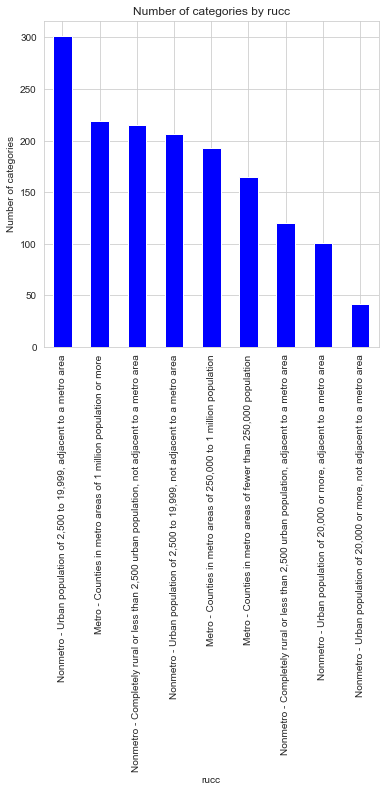

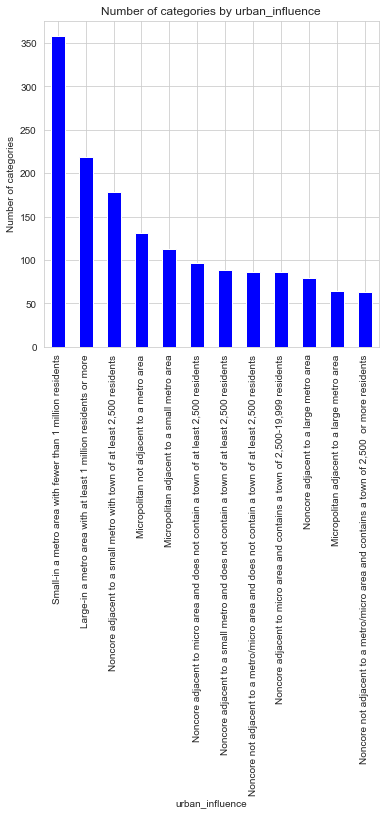

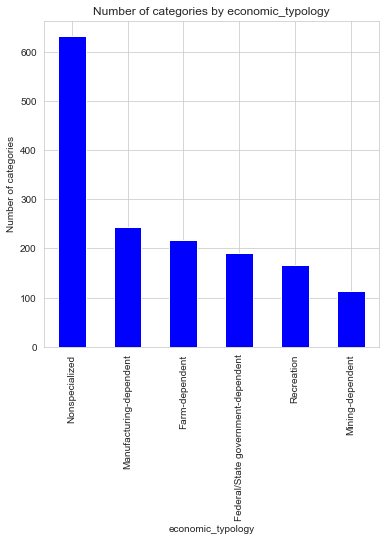

In [257]:
def plot_bars(dataset, cols):
    for col in cols:
        fig = plt.figure(figsize=(6,6)) # define plot area
        ax = fig.gca() # define axis    
        counts = dataset[col].value_counts() # find the counts for each unique category
        counts.plot.bar(ax = ax, color = 'blue') # Use the plot.bar method on the counts data frame
        ax.set_title('Number of categories by ' + col) # Give the plot a main title
        ax.set_xlabel(col) # Set text for the x axis
        ax.set_ylabel('Number of categories')# Set text for y axis
        plt.show()


plot_bars(train_values_labels, cat_cols)  

In [258]:
def factorize_col(cols, df):
    for col in df[cols]:
        if(df[col].dtype == 'object'):
            df[col]= df[col].astype('category')
            df[col] = df[col].cat.codes
cols = ['state','county_code']
factorize_col(cols,train_values_labels)
train_values_labels

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
0,0,869,49,3876.0,408.0,24.583,27.0,18.380,0.945945,0.010761,...,-2.525729,-1.072945,3.229301,3.227558,-1.114791,-0.943745,2.303483,-0.597837,-3.772261,3.223147
1,1,1271,29,10224.0,1166.0,28.346,3.0,26.694,0.808959,0.002284,...,-2.659260,-1.910543,3.226844,3.230409,-1.598487,-1.196328,2.672968,-0.606969,-3.218876,3.231753
2,2,158,10,27023.0,2927.0,21.641,9.0,31.028,0.956621,0.005141,...,-2.659260,-1.354796,3.226328,3.227161,-0.948748,-1.364576,2.263880,-0.677274,-2.764621,3.224023
3,3,144,18,8735.0,1039.0,23.110,0.0,27.734,0.894835,0.000298,...,-2.513306,-1.294627,3.225613,3.226566,-1.175653,-0.919301,2.238923,-0.606969,-3.270169,3.227122
4,4,183,38,3681.0,365.0,21.985,2.0,19.673,0.923886,0.000496,...,-2.525729,-1.078810,3.225971,3.227717,-1.015589,-1.060540,2.255838,-0.746548,-3.381395,3.225931
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1557,1557,840,36,18983.0,1480.0,22.621,41.0,26.905,0.847652,0.064786,...,-2.538307,-1.482805,3.218876,3.228549,-1.057308,-1.335403,2.430945,-0.659712,-3.123566,3.227479
1558,1558,1560,45,18837.0,2144.0,28.649,7.0,26.515,0.925500,0.010666,...,-2.813411,-1.418818,3.225494,3.227042,-0.990859,-1.166750,2.233236,-0.581606,-3.146555,3.223346
1559,1559,401,36,77224.0,4677.0,18.928,137.0,28.827,0.883936,0.070858,...,-2.525729,-1.210662,3.225573,3.227280,-1.167748,-1.197018,2.200473,-0.697155,-2.975930,3.225732
1560,1560,1557,17,4698.0,402.0,20.107,1.0,48.980,0.173909,0.000911,...,-2.207275,-1.402424,3.224102,3.226646,-1.038458,-1.072945,2.133600,-0.707246,-2.189256,3.229737


In [259]:
def factorize_col(cols, df):
    for col in df[cols]:
        if(df[col].dtype == 'object'):
            df[col]= df[col].astype('category')
            df[col] = df[col].cat.codes
cols = ['state','county_code']
factorize_col(cols,test_values)
test_values

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
0,0,873,32,52842.0,5403.0,26.840,27.0,27.960,0.924234,0.025049,...,-2.525729,-1.102620,3.220794,-1.537117,-0.928339,-1.292982,2.285265,-0.830113,-2.590267,3.227558
1,1,675,37,212287.0,53502.0,57.534,6032.0,33.072,0.398318,0.484635,...,-2.120264,-1.378326,3.225414,-1.650260,-1.469330,-1.422810,2.586677,-0.646264,-2.780621,3.227836
2,2,1100,9,81263.0,13368.0,39.994,1012.0,32.044,0.483789,0.381916,...,-2.312635,-1.177655,3.218876,-1.427116,-1.108754,-1.246225,2.448574,-0.767871,-2.364460,3.228826
3,3,1562,7,122870.0,19359.0,41.865,27.0,30.724,0.468043,0.088393,...,-2.312635,-1.139434,3.224858,-1.265848,-1.282526,-1.096626,2.844436,-0.759287,-3.218876,3.233489
4,4,379,23,146153.0,15766.0,30.681,644.0,30.860,0.651511,0.251317,...,-2.407946,-1.402424,3.224977,-1.350927,-1.240328,-1.020651,2.522835,-0.755023,-2.847312,3.227280
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1571,1571,1347,21,44414.0,6275.0,35.026,254.0,30.569,0.726121,0.019125,...,-2.525729,-1.214023,3.222509,-1.456717,-1.101611,-1.219394,2.615613,-0.913794,-3.036554,3.230804
1572,1572,1130,15,16160.0,1871.0,31.922,27.0,33.899,0.663196,0.303469,...,-2.302585,-1.099613,3.218876,-1.482805,-0.869114,-1.426950,2.330798,-0.798508,-2.830218,3.228985
1573,1573,1496,8,28688.0,4478.0,33.897,27.0,28.644,0.809853,0.011596,...,-2.207275,-2.145581,3.232029,-1.771957,-1.752692,-1.241866,2.222404,-0.362406,-3.381395,3.228073
1574,1574,1217,21,29234.0,4528.0,40.479,57.0,24.803,0.707838,0.030869,...,-2.525729,-1.093625,3.223147,-1.439695,-1.049679,-1.411689,2.815109,-0.631112,-3.473768,3.230251


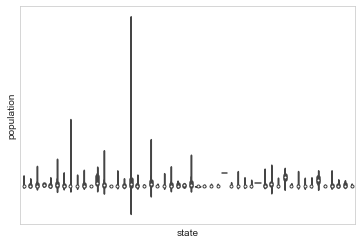

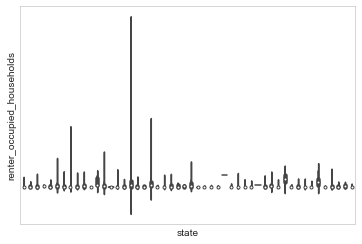

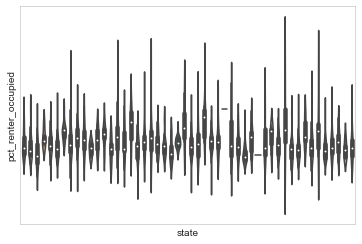

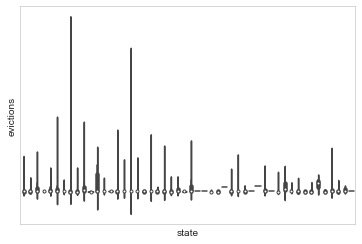

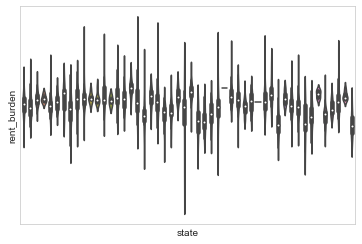

...

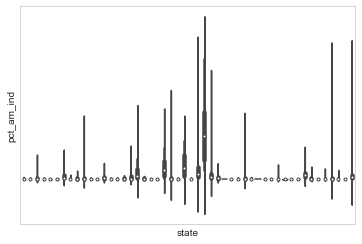

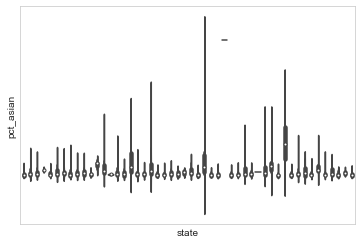

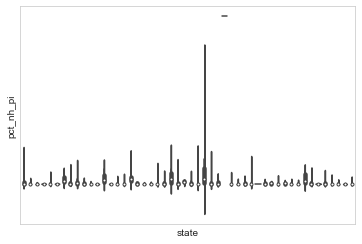

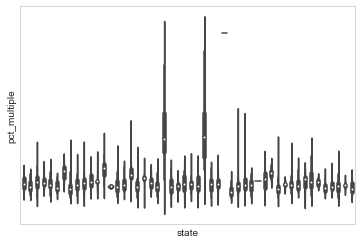

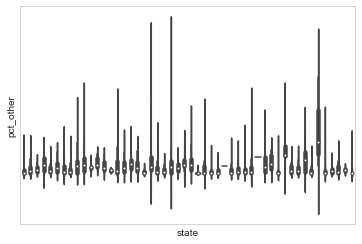

In [260]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'state'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.xticks([])
        plt.yticks([])
        plt.show()

plot_violin(train_values_labels, num_cols)

In [261]:
#import seaborn as sns
#import matplotlib.pyplot as plt
#%matplotlib inline
#def plot_violin(train_values_labels, cols, col_x = 'county_code'):
#    for col in cols:
#        sns.set_style("whitegrid")
#        sns.violinplot(col_x, col, data=train_values_labels)
#        plt.xlabel(col_x) # Set text for the x axis
#        plt.ylabel(col)# Set text for y axis
#        plt.show()
#
#plot_violin(train_values_labels, num_cols)

In [262]:
#import seaborn as sns
#import matplotlib.pyplot as plt
#%matplotlib inline
#def plot_violin(train_values_labels, cols, col_x = 'gross_rent'):
#    for col in cols:
#        sns.set_style("whitegrid")
#        sns.violinplot(col_x, col, data=train_values_labels)
#        plt.xlabel(col_x) # Set text for the x axis
#        plt.ylabel(col)# Set text for y axis
#        plt.show()
#
#plot_violin(train_values_labels, num_cols)

In [263]:
statethirty=train_values_labels[train_values_labels['state']==30]
statethirty

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
1443,1443,909,30,974468.0,140785.0,45.773,735.0,33.905,0.193638,0.024592,...,-2.525729,-1.645065,3.226288,3.22736,-1.328802,-1.142699,2.619966,-0.765718,-3.194183,3.22235


In [264]:
statethirty['gross_rent']

1443    1569
Name: gross_rent, dtype: int64

In [265]:
statethirty['homicides_per_100k'].describe()

count    1.0
mean     1.0
std      NaN
min      1.0
25%      1.0
50%      1.0
75%      1.0
max      1.0
Name: homicides_per_100k, dtype: float64

In [266]:
train_values_labels.drop(statethirty.index, inplace = True) 

In [267]:
statethirtyfive=train_values_labels[train_values_labels['state']==35]
statethirtyfive

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
483,483,27,35,207627.0,18978.0,22.449,953.0,29.387,0.748492,0.123237,...,-2.525729,-1.347074,3.22601,3.226884,-1.041287,-1.313044,2.378399,-0.794073,-2.847312,3.225573


In [268]:
statethirtyfive['homicides_per_100k'].describe()

count    1.00
mean     2.99
std       NaN
min      2.99
25%      2.99
50%      2.99
75%      2.99
max      2.99
Name: homicides_per_100k, dtype: float64

In [269]:
train_values_labels.drop(statethirtyfive.index, inplace = True) 

In [270]:
statetwentysix=train_values_labels[train_values_labels['state']==26]
statetwentysix

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
8,8,1466,26,2027.0,295.0,55.572,27.0,21.808,0.184899,0.001981,...,-2.659260,-0.957113,3.229776,3.235340,-0.837706,-1.233997,3.289006,-1.041287,-2.563950,3.231437
108,108,768,26,4262.0,510.0,31.050,27.0,28.175,0.884318,0.000000,...,-2.525729,-1.207312,3.228311,3.227677,-0.954512,-1.171183,2.509042,-0.707246,-3.381395,3.227875
221,221,567,26,10246.0,1203.0,25.236,27.0,29.159,0.917340,0.000700,...,-2.995732,-1.158362,3.222509,3.228589,-1.039285,-1.039285,2.615258,-0.705220,-3.381395,3.227518
304,304,1061,26,5585.0,607.0,27.046,27.0,29.263,0.869725,0.000000,...,-2.995732,-1.207312,3.218876,3.227399,-0.944035,-1.110624,2.249849,-0.650088,-2.937463,3.227360
305,305,1375,26,6841.0,1020.0,28.936,27.0,27.266,0.856343,0.011422,...,-2.659260,-1.382302,3.225375,3.225653,-1.174651,-0.956716,2.065173,-0.814186,-3.057608,3.226288
330,330,1024,26,1403.0,152.0,18.238,27.0,16.153,0.876144,0.000000,...,-2.525729,-1.078810,3.218876,3.227796,-0.743337,-1.266848,2.559989,-0.671386,-3.575551,3.226209
375,375,483,26,24467.0,4017.0,32.892,27.0,26.385,0.913017,0.004556,...,-2.513306,-1.398367,3.226526,3.226328,-1.088672,-1.156182,2.303710,-0.661649,-3.352407,3.226328
424,424,1472,26,2725.0,269.0,21.617,27.0,20.837,0.900433,0.004003,...,-2.419119,-1.105637,3.224937,3.229420,-0.988175,-1.116740,2.660726,-0.524249,-3.649659,3.226606
561,561,735,26,22460.0,2839.0,32.791,27.0,25.646,0.902089,0.020485,...,-2.813411,-1.500584,3.227558,3.227320,-1.045814,-1.210015,2.505939,-0.687165,-3.506558,3.225732
562,562,604,26,7010.0,567.0,21.648,27.0,24.865,0.880201,0.009918,...,-2.813411,-1.177655,3.225216,3.226487,-0.982169,-1.138556,2.079013,-0.843970,-3.575551,3.225335


In [271]:
statetwentysix['gross_rent'].describe()

count     33.000000
mean     536.333333
std       87.719962
min      391.000000
25%      476.000000
50%      536.000000
75%      589.000000
max      796.000000
Name: gross_rent, dtype: float64

In [272]:
statetwentysix['homicides_per_100k'].describe()

count    33.0
mean      0.0
std       0.0
min       0.0
25%       0.0
50%       0.0
75%       0.0
max       0.0
Name: homicides_per_100k, dtype: float64

In [273]:
statetwentysix.describe()

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
count,33.000000,33.000000,33.0,33.000000,33.000000,33.000000,33.0,33.000000,33.000000,33.000000,...,33.000000,33.000000,33.000000,33.000000,33.000000,33.000000,33.000000,33.000000,33.000000,33.000000
mean,849.272727,879.333333,26.0,6673.969697,859.878788,28.901788,27.0,23.406455,0.823229,0.005250,...,-2.639692,-1.205514,3.224897,3.228478,-1.027252,-1.147885,2.545332,-0.683023,-3.305288,3.226729
std,461.710764,481.070010,0.0,7479.165296,1243.055805,9.280357,0.0,4.457049,0.224895,0.007646,...,0.210170,0.136347,0.003291,0.002256,0.130230,0.096078,0.314130,0.161369,0.281357,0.001874
min,8.000000,3.000000,26.0,788.000000,115.000000,16.545000,27.0,13.128000,0.184899,0.000000,...,-3.218876,-1.570217,3.218876,3.225653,-1.347923,-1.344234,1.888638,-1.041287,-3.649659,3.224739
25%,561.000000,506.000000,26.0,2327.000000,232.000000,21.648000,27.0,19.964000,0.869725,0.000000,...,-2.813411,-1.258781,3.224142,3.227082,-1.088701,-1.230424,2.346189,-0.748660,-3.506558,3.225335
50%,820.000000,906.000000,26.0,4180.000000,425.000000,27.747000,27.0,23.479000,0.912488,0.002229,...,-2.525729,-1.184170,3.225693,3.227836,-1.039285,-1.138556,2.526743,-0.655851,-3.381395,3.226209
75%,1315.000000,1325.000000,26.0,6841.000000,669.000000,32.791000,27.0,26.385000,0.947020,0.006281,...,-2.525729,-1.114742,3.227399,3.229024,-0.945323,-1.096608,2.660726,-0.594207,-3.194183,3.227518
max,1544.000000,1514.000000,26.0,33217.000000,5571.000000,55.572000,27.0,30.406000,0.976257,0.035164,...,-2.302585,-0.957113,3.229776,3.235340,-0.743337,-0.956716,3.289006,-0.460449,-2.563950,3.231437


In [274]:


for col in num_cols:
    print(col, '\n', statetwentysix[col].describe(),'\n' )

population 
 count       33.000000
mean      6673.969697
std       7479.165296
min        788.000000
25%       2327.000000
50%       4180.000000
75%       6841.000000
max      33217.000000
Name: population, dtype: float64 

renter_occupied_households 
 count      33.000000
mean      859.878788
std      1243.055805
min       115.000000
25%       232.000000
50%       425.000000
75%       669.000000
max      5571.000000
Name: renter_occupied_households, dtype: float64 

pct_renter_occupied 
 count    33.000000
mean     28.901788
std       9.280357
min      16.545000
25%      21.648000
50%      27.747000
75%      32.791000
max      55.572000
Name: pct_renter_occupied, dtype: float64 

evictions 
 count    33.0
mean     27.0
std       0.0
min      27.0
25%      27.0
50%      27.0
75%      27.0
max      27.0
Name: evictions, dtype: float64 

rent_burden 
 count    33.000000
mean     23.406455
std       4.457049
min      13.128000
25%      19.964000
50%      23.479000
75%      26.385000
max  

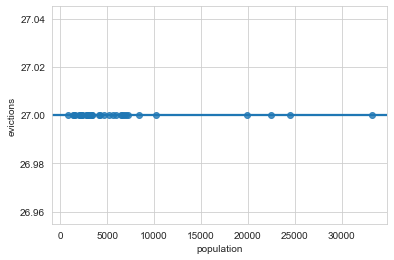

In [275]:
import seaborn as sns

ax = sns.regplot(x='population', y='evictions', data=statetwentysix)

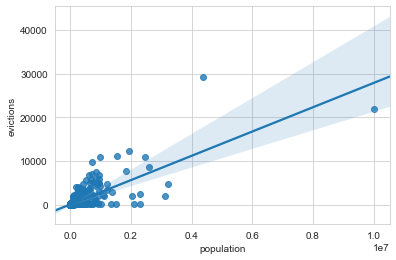

In [276]:
import seaborn as sns

ax = sns.regplot(x='population', y='evictions', data=train_values_labels)

In [277]:
train_values_labels.drop(statetwentysix.index, inplace = True) 

In [278]:
train_values_labels[['evictions', 'population']].corr()

,evictions,population
evictions,1.000000,0.763799
population,0.763799,1.000000


In [279]:
statetwentyseven=train_values_labels[train_values_labels['state']==27]
statetwentyseven

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
35,35,1143,27,3302.0,276.0,46.884,27.0,22.064,0.149208,0.091357,...,-2.525729,-1.164752,3.234592,3.222948,-0.939048,-1.258781,1.696752,-0.388608,-3.101093,3.238286
182,182,1354,27,14005.0,2104.0,40.190,27.0,29.683,0.516275,0.004407,...,-2.813411,-1.619488,3.229539,3.229618,-1.304266,-0.952732,2.836728,-0.759287,-2.847312,3.232700
190,190,47,27,5694.0,840.0,68.336,27.0,19.237,0.278452,0.045660,...,-2.525729,-1.448170,3.229499,3.224301,-0.999672,-1.130103,1.888821,-0.262664,-3.036554,3.233843
231,231,315,27,6360.0,693.0,28.388,27.0,23.090,0.460225,0.001898,...,-2.525729,-1.269401,3.218876,3.227915,-0.892038,-1.079753,2.393213,-0.807436,-2.017406,3.227479
243,243,1410,27,961.0,207.0,45.837,27.0,21.259,0.532234,0.005138,...,-2.525729,-1.474033,3.230409,3.228034,-1.173647,-0.890032,1.662839,-0.650088,-2.513306,3.229103
331,331,788,27,100623.0,16090.0,42.227,27.0,30.838,0.719742,0.041379,...,-2.813411,-1.500584,3.226844,3.228787,-1.448170,-0.936493,2.831755,-0.757153,-2.864704,3.228826
372,372,1003,27,13709.0,2327.0,41.394,27.0,28.484,0.649735,0.004165,...,-2.995732,-1.518684,3.227320,3.228073,-1.109662,-1.039458,2.557623,-0.653926,-2.551046,3.230923
481,481,1478,27,2566.0,336.0,30.712,27.0,23.033,0.793519,0.000402,...,-2.525729,-1.487220,3.225295,3.226447,-1.282737,-1.129102,1.956634,-0.830113,-2.234926,3.231516
825,825,272,27,9689.0,1372.0,29.342,27.0,19.720,0.701697,0.000000,...,-3.218876,-1.439695,3.227518,3.228509,-1.307026,-1.001840,2.516475,-0.659712,-2.343407,3.230093
849,849,636,27,9811.0,1338.0,43.685,27.0,25.904,0.164267,0.007323,...,-2.659260,-1.358679,3.226447,3.232542,-0.879657,-1.235989,3.038832,-0.867501,-2.111965,3.233804


In [280]:
statetwentyseven['gross_rent'].describe()

count      18.000000
mean     1015.111111
std       174.028358
min       638.000000
25%       933.750000
50%      1045.000000
75%      1162.000000
max      1270.000000
Name: gross_rent, dtype: float64

In [281]:
statetwentyseven['homicides_per_100k'].describe()

count    18.000000
mean      0.927222
std       3.096145
min       0.000000
25%       0.000000
50%       0.000000
75%       0.000000
max      12.770000
Name: homicides_per_100k, dtype: float64

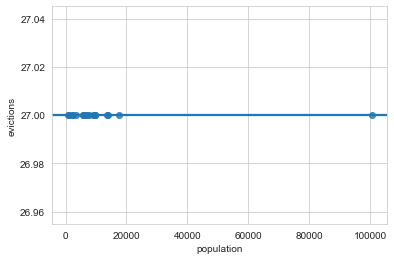

In [282]:
import seaborn as sns

ax = sns.regplot(x='population', y='evictions', data=statetwentyseven)

In [283]:
train_values_labels.drop(statetwentyseven.index, inplace = True) 

In [284]:
statethirtyfour=train_values_labels[train_values_labels['state']==34]
statethirtyfour

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
9,9,1383,34,17165.0,2223.0,29.769,27.0,28.664,0.961332,0.009077,...,-2.513306,-1.117795,3.218876,3.227756,-0.855017,-1.317502,2.458505,-0.891598,-2.617296,3.229578
38,38,966,34,7940.0,1028.0,34.115,27.0,26.498,0.537051,0.408917,...,-1.897120,-1.018877,3.218876,3.228192,-0.687153,-1.632754,2.131884,-0.994252,-2.375156,3.229183
50,50,942,34,11143.0,1188.0,24.243,27.0,26.851,0.877104,0.031369,...,-2.538307,-1.269401,3.218876,3.228470,-1.034450,-1.160744,2.240694,-0.980829,-2.590267,3.231160
78,78,1338,34,16927.0,1699.0,22.231,27.0,33.343,0.940959,0.003458,...,-2.525729,-1.174414,3.221712,3.227280,-0.785262,-1.283738,2.236044,-1.052683,-2.465104,3.230211
155,155,1517,34,27345.0,4149.0,44.735,27.0,29.671,0.410982,0.518278,...,-2.128632,-1.016111,3.222150,3.228232,-0.918781,-1.299615,2.568276,-1.105637,-2.441847,3.229064
174,174,1170,34,22015.0,2305.0,26.207,27.0,27.697,0.915777,0.018560,...,-2.407946,-1.024433,3.223306,3.228311,-0.834013,-1.344069,2.327903,-0.884308,-2.813411,3.229143
199,199,1036,34,70385.0,7290.0,29.398,27.0,26.372,0.871526,0.060052,...,-2.513306,-1.237874,3.224778,3.229657,-1.075940,-1.070109,2.603732,-0.796288,-2.956512,3.227518
236,236,250,34,18173.0,1670.0,22.874,27.0,23.359,0.930232,0.038360,...,-2.396896,-1.155183,3.226526,3.228351,-0.845959,-1.246751,2.219008,-0.800732,-2.900422,3.227320
249,249,892,34,9126.0,824.0,20.305,27.0,28.605,0.919109,0.006152,...,-2.525729,-1.262308,3.218876,3.226844,-0.978487,-1.192316,2.284472,-1.018877,-2.525729,3.230686
351,351,1552,34,24328.0,3372.0,31.905,27.0,31.827,0.592844,0.353478,...,-2.292635,-1.184170,3.218876,3.227717,-0.961105,-1.347227,2.534538,-0.939048,-2.645075,3.228232


In [285]:
statethirtyfour['gross_rent'].describe()

count     33.000000
mean     605.151515
std       77.309492
min      468.000000
25%      549.000000
50%      596.000000
75%      641.000000
max      796.000000
Name: gross_rent, dtype: float64

In [286]:
statethirtyfour['homicides_per_100k'].describe()

count    33.000000
mean      5.585758
std       7.162072
min       0.000000
25%       0.000000
50%       2.680000
75%       9.010000
max      26.160000
Name: homicides_per_100k, dtype: float64

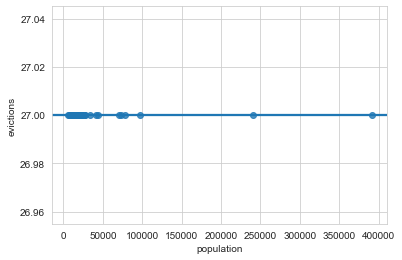

In [287]:
import seaborn as sns

ax = sns.regplot(x='population', y='evictions', data=statethirtyfour)

In [288]:
train_values_labels.drop(statethirtyfour.index, inplace = True) 

In [289]:
statethirtyseven=train_values_labels[train_values_labels['state']==37]
statethirtyseven

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
82,82,1390,37,1014148.0,125464.0,34.065,27.0,30.436,0.465959,0.171466,...,-2.525729,-1.754464,3.224500,3.228153,-1.969273,-1.641057,2.554440,-0.634878,-3.123566,3.225136
163,163,534,37,153229.0,12298.0,22.138,27.0,34.077,0.452282,0.419129,...,-2.302585,-1.427116,3.224540,3.228945,-1.131102,-1.121857,2.465013,-0.661649,-2.847312,3.223187
357,357,102,37,101870.0,14661.0,37.538,27.0,32.796,0.650666,0.239877,...,-2.407946,-1.248273,3.224222,3.227637,-1.143841,-1.289615,2.481698,-0.709277,-2.563950,3.225812
728,728,685,37,243215.0,22615.0,25.935,27.0,30.400,0.759955,0.087290,...,-2.525729,-1.461018,3.225573,3.228628,-1.372419,-1.264306,2.441160,-0.636767,-2.975930,3.223704
1171,1171,677,37,26158.0,3317.0,34.911,27.0,40.195,0.517783,0.412295,...,-2.396896,-1.152013,3.223027,3.225494,-0.836401,-1.500101,2.312171,-1.016111,-2.364460,3.225732
1201,1201,346,37,149184.0,20376.0,35.483,27.0,27.799,0.814674,0.097339,...,-2.538307,-1.301953,3.224937,3.227756,-0.966954,-1.243327,2.473868,-0.663588,-2.733368,3.224739


In [290]:
statethirtyseven['gross_rent'].describe()

count       6.000000
mean     1159.000000
std       365.580634
min       703.000000
25%       892.000000
50%      1139.500000
75%      1436.500000
max      1627.000000
Name: gross_rent, dtype: float64

In [291]:
statethirtyseven['homicides_per_100k'].describe()

count    6.000000
mean     2.756667
std      2.288333
min      0.000000
25%      1.517500
50%      2.080000
75%      4.165000
max      6.190000
Name: homicides_per_100k, dtype: float64

In [292]:
train_values_labels.drop(statethirtyseven.index, inplace = True) 

In [293]:
statefortynine=train_values_labels[train_values_labels['state']==49]
statefortynine

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
0,0,869,49,3876.0,408.0,24.583,27.0,18.380,0.945945,0.010761,...,-2.525729,-1.072945,3.229301,3.227558,-1.114791,-0.943745,2.303483,-0.597837,-3.772261,3.223147
11,11,143,49,2352.0,277.0,25.940,27.0,21.172,0.965858,0.012411,...,-2.525729,-1.139434,3.226010,3.225931,-0.975207,-1.122783,2.055725,-0.655851,-3.729701,3.224261
65,65,411,49,3213.0,403.0,26.003,27.0,16.022,0.935264,0.001202,...,-2.525729,-1.187444,3.227042,3.227518,-1.205649,-0.975817,2.517017,-0.534435,-4.017384,3.224222
94,94,504,49,3050.0,321.0,22.585,27.0,16.355,0.945344,0.013865,...,-2.525729,-1.171183,3.228153,3.226169,-1.174414,-0.903868,2.490544,-0.693147,-3.270169,3.225017
98,98,104,49,2744.0,286.0,17.787,27.0,22.095,0.958078,0.003313,...,-2.525729,-0.970219,3.226923,3.226249,-1.154527,-1.220558,2.163548,-0.785262,-3.506558,3.226249
153,153,365,49,2337.0,322.0,26.382,27.0,18.675,0.923389,0.011163,...,-2.525729,-1.272966,3.225534,3.226209,-1.048263,-1.017577,2.227731,-0.750776,-3.611918,3.224937
277,277,1016,49,5218.0,652.0,28.030,27.0,22.014,0.940592,0.014691,...,-2.995732,-1.258781,3.229420,3.228034,-1.247311,-1.157995,2.602147,-0.687165,-3.912023,3.224460
291,291,1389,49,2191.0,217.0,32.524,27.0,22.289,0.930284,0.000502,...,-2.525729,-1.167962,3.228351,3.227558,-1.175414,-0.997958,2.847533,-0.539568,-3.649659,3.223386
364,364,1084,49,29713.0,4426.0,36.334,27.0,20.142,0.868544,0.018039,...,-2.813411,-1.136314,3.229697,3.228192,-1.256266,-0.890162,2.956916,-0.004008,-4.422849,3.223903
399,399,1104,49,3359.0,410.0,26.090,27.0,21.787,0.965013,0.001211,...,-2.525729,-1.161552,3.229380,3.227320,-1.151013,-0.985176,2.427283,-0.709277,-3.473768,3.223425


In [294]:
statefortynine['gross_rent'].describe()

count     30.000000
mean     577.900000
std      125.367969
min      351.000000
25%      488.750000
50%      562.500000
75%      663.500000
max      898.000000
Name: gross_rent, dtype: float64

In [295]:
statefortynine['homicides_per_100k'].describe()

count    30.0
mean      0.0
std       0.0
min       0.0
25%       0.0
50%       0.0
75%       0.0
max       0.0
Name: homicides_per_100k, dtype: float64

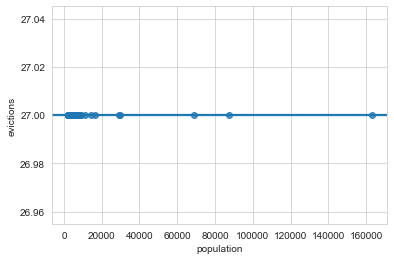

In [296]:
import seaborn as sns

ax = sns.regplot(x='population', y='evictions', data=statefortynine)

In [297]:
train_values_labels.drop(statefortynine.index, inplace = True) 

In [298]:
train_values_labels['evictions'].median()

27.0

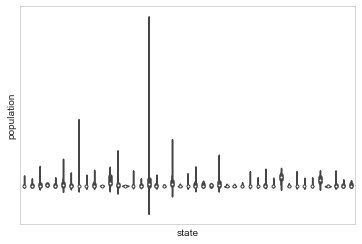

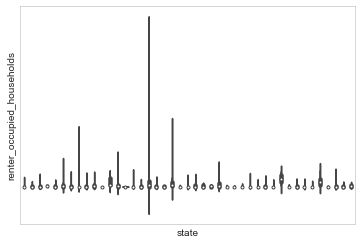

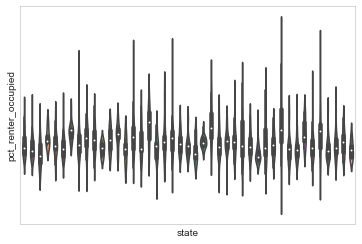

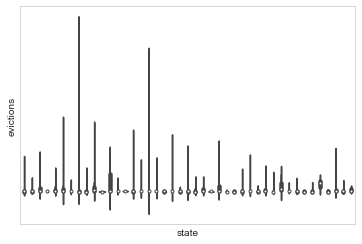

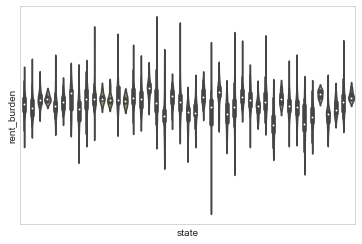

...

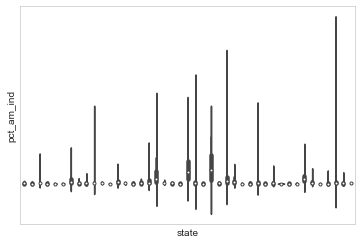

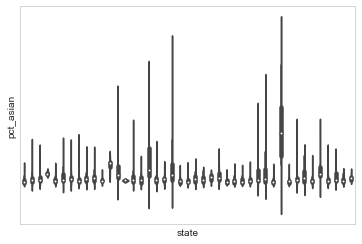

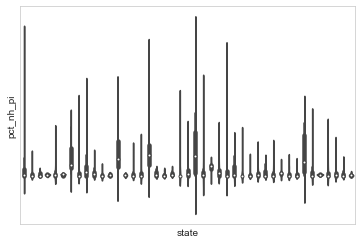

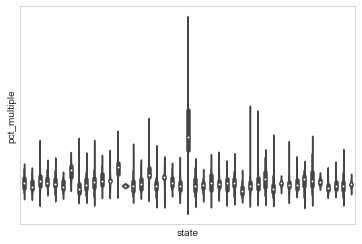

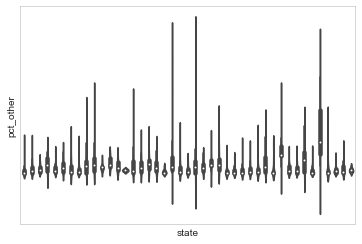

In [299]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'state'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.xticks([])
        plt.yticks([])
        plt.show()

plot_violin(train_values_labels, num_cols)

In [300]:
statethirteen = train_values_labels[train_values_labels['state']==13]
statethirteen

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
1256,1256,170,13,32129.0,4345.0,30.152,99.0,28.712,0.944723,0.016984,...,-2.525729,-1.262308,3.22609,3.226050,-0.941171,-1.187723,2.086995,-0.776529,-2.847312,3.227042
1322,1322,265,13,47370.0,4783.0,20.300,83.0,30.916,0.961649,0.003648,...,-2.813411,-1.589635,3.22609,3.225891,-1.166540,-1.212299,1.978138,-0.675307,-3.170086,3.227122


In [301]:
statethirteen['pct_excessive_drinking']

1256    0.181
1322    0.181
Name: pct_excessive_drinking, dtype: float64

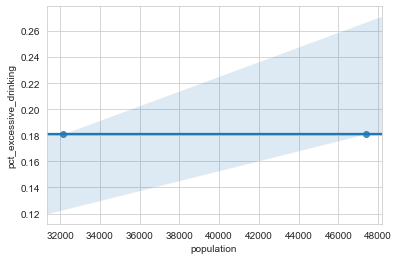

In [302]:
import seaborn as sns

ax = sns.regplot(x='population', y='pct_excessive_drinking', data=statethirteen)

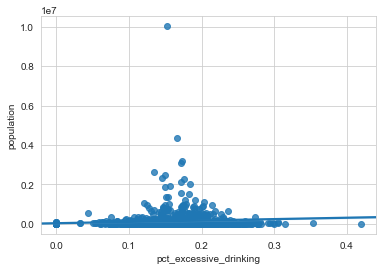

In [303]:
import seaborn as sns

ax = sns.regplot(x="pct_excessive_drinking", y="population", data=train_values_labels)

In [304]:
eldronko = train_values_labels[train_values_labels['population']>1*10**7]
eldronko

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
953,953,419,16,10020287.0,1760277.0,54.552,21783.0,34.916,0.269376,0.079637,...,-2.65926,-1.709258,3.224977,3.228351,-1.575036,-1.343235,2.556484,-0.703198,-2.501036,3.231042


In [305]:
eldronko.describe()

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
count,1.0,1.0,1.0,1.0,1.0,1.000,1.0,1.000,1.000000,1.000000,...,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
mean,953.0,419.0,16.0,10020287.0,1760277.0,54.552,21783.0,34.916,0.269376,0.079637,...,-2.65926,-1.709258,3.224977,3.228351,-1.575036,-1.343235,2.556484,-0.703198,-2.501036,3.231042
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,953.0,419.0,16.0,10020287.0,1760277.0,54.552,21783.0,34.916,0.269376,0.079637,...,-2.65926,-1.709258,3.224977,3.228351,-1.575036,-1.343235,2.556484,-0.703198,-2.501036,3.231042
25%,953.0,419.0,16.0,10020287.0,1760277.0,54.552,21783.0,34.916,0.269376,0.079637,...,-2.65926,-1.709258,3.224977,3.228351,-1.575036,-1.343235,2.556484,-0.703198,-2.501036,3.231042
50%,953.0,419.0,16.0,10020287.0,1760277.0,54.552,21783.0,34.916,0.269376,0.079637,...,-2.65926,-1.709258,3.224977,3.228351,-1.575036,-1.343235,2.556484,-0.703198,-2.501036,3.231042
75%,953.0,419.0,16.0,10020287.0,1760277.0,54.552,21783.0,34.916,0.269376,0.079637,...,-2.65926,-1.709258,3.224977,3.228351,-1.575036,-1.343235,2.556484,-0.703198,-2.501036,3.231042
max,953.0,419.0,16.0,10020287.0,1760277.0,54.552,21783.0,34.916,0.269376,0.079637,...,-2.65926,-1.709258,3.224977,3.228351,-1.575036,-1.343235,2.556484,-0.703198,-2.501036,3.231042


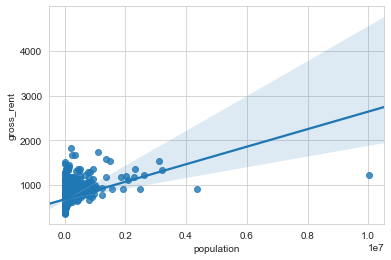

In [306]:
import seaborn as sns

ax = sns.regplot(x='population', y='gross_rent', data=train_values_labels)

In [307]:
highpop = train_values_labels[train_values_labels['population']>400000]
highpop

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
10,10,372,46,963541.0,191320.0,50.311,6749.0,32.229,0.528537,0.263288,...,-2.396896,-1.390302,3.227399,3.228707,-1.264306,-1.226174,2.680629,-0.685179,-2.673649,3.225971
15,15,1049,14,991145.0,195220.0,47.798,4190.0,30.317,0.403998,0.435365,...,-2.198225,-1.624552,3.226010,3.228192,-1.712254,-1.446919,2.536251,-0.659712,-2.645075,3.229657
16,16,777,5,1218942.0,198288.0,35.131,3434.0,28.559,0.795641,0.129331,...,-2.525729,-1.390302,3.226487,3.226606,-1.209011,-1.349783,2.382320,-0.653926,-2.937463,3.223863
23,23,1451,19,2318272.0,465328.0,56.318,27.0,33.998,0.263296,0.174250,...,-2.525729,-1.283738,3.224699,3.227122,-1.299283,-1.479409,2.575523,-0.705220,-2.748872,3.228826
25,25,317,4,537958.0,76931.0,33.949,3192.0,29.999,0.787563,0.140932,...,-2.407946,-1.394327,3.226129,3.227637,-1.133310,-1.259304,2.435890,-0.699165,-2.830218,3.225613
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463,1463,67,36,1117611.0,127238.0,31.998,1917.0,27.856,0.523858,0.091173,...,-2.645075,-1.783791,3.226963,3.228311,-2.042219,-1.652258,2.593467,-0.603306,-3.170086,3.224858
1500,1500,335,19,463808.0,69065.0,34.859,215.0,30.391,0.779398,0.105670,...,-2.525729,-1.439695,3.226288,3.227756,-1.333804,-1.212660,2.398596,-0.725670,-2.900422,3.224142
1527,1527,710,7,2481822.0,432841.0,48.287,10865.0,29.232,0.313163,0.216559,...,-2.513306,-1.390302,3.224818,3.229737,-1.475033,-1.363577,2.755575,-0.705220,-2.918771,3.233410
1556,1556,1048,17,667796.0,103780.0,37.620,4928.0,31.909,0.407850,0.025597,...,-2.396896,-1.771957,3.224062,3.228192,-1.433483,-1.159550,2.483332,-0.755023,-2.764621,3.228905


In [308]:
lowrent = highpop[highpop['gross_rent']<1000]
lowrent

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
10,10,372,46,963541.0,191320.0,50.311,6749.0,32.229,0.528537,0.263288,...,-2.396896,-1.390302,3.227399,3.228707,-1.264306,-1.226174,2.680629,-0.685179,-2.673649,3.225971
16,16,777,5,1218942.0,198288.0,35.131,3434.0,28.559,0.795641,0.129331,...,-2.525729,-1.390302,3.226487,3.226606,-1.209011,-1.349783,2.382320,-0.653926,-2.937463,3.223863
25,25,317,4,537958.0,76931.0,33.949,3192.0,29.999,0.787563,0.140932,...,-2.407946,-1.394327,3.226129,3.227637,-1.133310,-1.259304,2.435890,-0.699165,-2.830218,3.225613
41,41,1355,7,725489.0,97063.0,35.276,2268.0,28.412,0.619152,0.087421,...,-2.659260,-1.541779,3.224222,3.229697,-1.638040,-1.164158,2.575780,-0.599657,-3.123566,3.227122
70,70,647,7,4371311.0,688268.0,44.981,29251.0,29.758,0.317401,0.183371,...,-2.396896,-1.496109,3.225494,3.229816,-1.463016,-1.311331,2.771515,-0.685179,-2.995732,3.232660
120,120,669,44,466320.0,71053.0,38.401,1621.0,32.890,0.653465,0.078689,...,-2.396896,-1.320507,3.226566,3.228113,-1.178406,-1.259258,2.432195,-0.752897,-2.551046,3.221712
137,137,836,12,448216.0,57613.0,35.707,656.0,29.894,0.803549,0.017736,...,-2.813411,-1.660731,3.225255,3.229064,-1.360576,-0.949916,2.483023,-0.772190,-2.645075,3.226447
161,161,260,19,915659.0,139688.0,34.828,27.0,29.740,0.763446,0.131424,...,-2.525729,-1.394327,3.226407,3.227241,-1.268844,-1.187166,2.384889,-0.727739,-2.796881,3.223545
189,189,1242,25,480738.0,50142.0,26.215,1496.0,32.647,0.778386,0.046833,...,-2.538307,-1.231001,3.226725,3.227042,-1.081805,-1.114693,2.308057,-0.823256,-2.703063,3.228826
203,203,291,2,1221929.0,138466.0,29.774,4667.0,28.196,0.736175,0.136415,...,-2.513306,-1.594549,3.225931,3.227875,-1.596547,-1.239872,2.391201,-0.685179,-2.733368,3.224500


In [309]:
lowrent.describe()

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
count,55.000000,55.000000,55.000000,5.500000e+01,55.000000,55.000000,55.000000,55.000000,55.000000,55.000000,...,55.000000,55.000000,55.000000,55.000000,55.000000,55.000000,55.000000,55.000000,55.000000,55.000000
mean,769.563636,728.254545,17.581818,8.090740e+05,120236.927273,37.330927,3786.218182,30.930673,0.602847,0.142538,...,-2.493816,-1.505970,3.225538,3.228599,-1.375440,-1.215525,2.581931,-0.710649,-2.816990,3.227706
std,481.212310,403.977778,13.566968,6.182705e+05,103011.303374,6.056323,4708.278736,1.799487,0.195445,0.128400,...,0.170892,0.195389,0.001189,0.001371,0.211487,0.131723,0.176105,0.083224,0.275666,0.003472
min,10.000000,4.000000,0.000000,4.081950e+05,37740.000000,25.450000,27.000000,26.297000,0.072819,0.004094,...,-2.813411,-1.937942,3.220634,3.225732,-1.886467,-1.553895,2.228467,-0.916291,-3.352407,3.221712
25%,401.000000,360.500000,7.000000,5.102475e+05,69821.000000,33.127000,804.000000,29.739500,0.511051,0.048642,...,-2.538307,-1.619539,3.224818,3.227796,-1.495900,-1.273326,2.480005,-0.771109,-2.995732,3.225673
50%,703.000000,710.000000,15.000000,6.508130e+05,88363.000000,37.193000,2244.000000,30.687000,0.641392,0.105670,...,-2.525729,-1.478410,3.225653,3.228430,-1.367491,-1.210307,2.589254,-0.705220,-2.813411,3.227637
75%,1219.500000,1041.000000,25.000000,9.022420e+05,137543.000000,41.023500,4891.000000,32.404000,0.758916,0.184596,...,-2.396896,-1.388298,3.226348,3.229123,-1.215997,-1.151701,2.686415,-0.652007,-2.638082,3.229420
max,1561.000000,1528.000000,47.000000,4.371311e+06,688268.000000,50.872000,29251.000000,34.577000,0.856704,0.530984,...,-2.111965,-1.187444,3.227915,3.232700,-0.960333,-0.941046,3.055834,-0.519194,-2.162823,3.239462


In [310]:
#train_values_labels.drop(lowrent.index, inplace = True) 

In [311]:
#train_values_labels.drop(eldronko.index, inplace = True) 

In [312]:
#train_values_labels.drop(nodrinking.index, inplace = True) 

In [313]:
statethirteen['gross_rent']

1256    691
1322    899
Name: gross_rent, dtype: int64

In [314]:
statethirteen['homicides_per_100k'].describe()

count    2.0
mean     0.0
std      0.0
min      0.0
25%      0.0
50%      0.0
75%      0.0
max      0.0
Name: homicides_per_100k, dtype: float64

In [315]:
#train_values_labels.drop(statethirteen.index, inplace = True) 

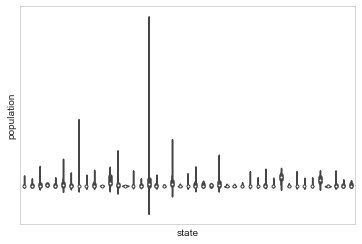

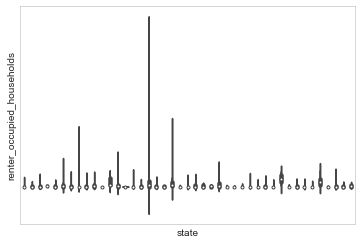

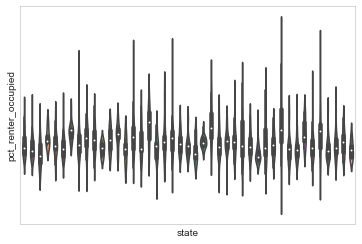

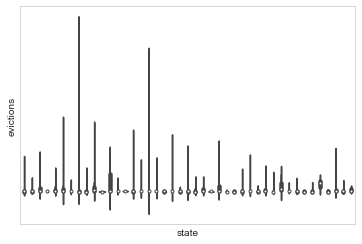

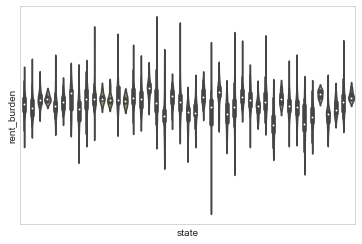

...

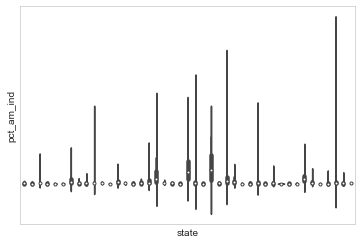

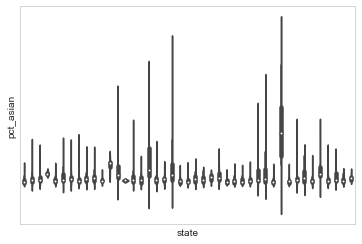

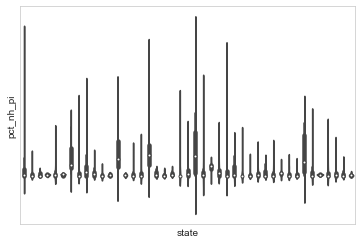

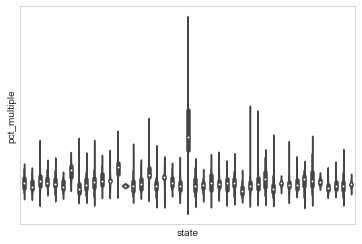

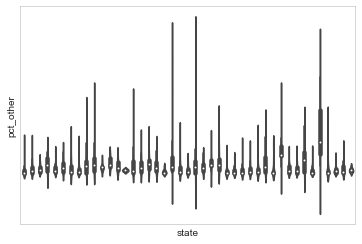

In [316]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'state'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.xticks([])
        plt.yticks([])
        plt.show()

plot_violin(train_values_labels, num_cols)

In [317]:
#pollution = train_values_labels[train_values_labels['air_pollution_particulate_matter_value']==0]
#pollution

In [318]:
#train_values_labels.drop(pollution.index, inplace = True)

In [319]:
train_values_labels.columns

Index(['row_id', 'county_code', 'state', 'population',
       'renter_occupied_households', 'pct_renter_occupied', 'evictions',
       'rent_burden', 'pct_white', 'pct_af_am', 'pct_hispanic', 'pct_am_ind',
       'pct_asian', 'pct_nh_pi', 'pct_multiple', 'pct_other', 'poverty_rate',
       'rucc', 'urban_influence', 'economic_typology', 'pct_civilian_labor',
       'pct_unemployment', 'pct_uninsured_adults', 'pct_uninsured_children',
       'pct_adult_obesity', 'pct_adult_smoking', 'pct_diabetes',
       'pct_low_birthweight', 'pct_excessive_drinking',
       'pct_physical_inactivity', 'air_pollution_particulate_matter_value',
       'homicides_per_100k', 'motor_vehicle_crash_deaths_per_100k',
       'heart_disease_mortality_per_100k', 'pop_per_dentist',
       'pop_per_primary_care_physician', 'pct_female',
       'pct_below_18_years_of_age', 'pct_aged_65_years_and_older',
       'pct_adults_less_than_a_high_school_diploma',
       'pct_adults_with_high_school_diploma', 'pct_adults_wi

In [320]:
Correlations = train_values_labels[['gross_rent', 'pct_adults_bachelors_or_higher', 'pct_adults_with_high_school_diploma', 'pct_adult_obesity','pct_diabetes','pct_physical_inactivity']]
corr = Correlations.corr()
corr.style.background_gradient(cmap='coolwarm')

,gross_rent,pct_adults_bachelors_or_higher,pct_adults_with_high_school_diploma,pct_adult_obesity,pct_diabetes,pct_physical_inactivity
gross_rent,1,0.710152,-0.634984,-0.482307,-0.438652,-0.577041
pct_adults_bachelors_or_higher,0.710152,1,-0.761688,-0.594428,-0.559656,-0.63927
pct_adults_with_high_school_diploma,-0.634984,-0.761688,1,0.49217,0.480347,0.602733
pct_adult_obesity,-0.482307,-0.594428,0.49217,1,0.731772,0.705268
pct_diabetes,-0.438652,-0.559656,0.480347,0.731772,1,0.724041
pct_physical_inactivity,-0.577041,-0.63927,0.602733,0.705268,0.724041,1


In [321]:
Correlations=train_values_labels[['pct_excessive_drinking', 'pct_adult_smoking','motor_vehicle_crash_deaths_per_100k', 'pct_adult_obesity','pct_diabetes','pct_physical_inactivity']]
corr = Correlations.corr()
corr.style.background_gradient(cmap='coolwarm')

,pct_excessive_drinking,pct_adult_smoking,motor_vehicle_crash_deaths_per_100k,pct_adult_obesity,pct_diabetes,pct_physical_inactivity
pct_excessive_drinking,1,0.191254,-0.246779,-0.250937,-0.390954,-0.385806
pct_adult_smoking,0.191254,1,0.258843,0.256894,0.251431,0.289787
motor_vehicle_crash_deaths_per_100k,-0.246779,0.258843,1,0.343313,0.393515,0.405683
pct_adult_obesity,-0.250937,0.256894,0.343313,1,0.731772,0.705268
pct_diabetes,-0.390954,0.251431,0.393515,0.731772,1,0.724041
pct_physical_inactivity,-0.385806,0.289787,0.405683,0.705268,0.724041,1


In [322]:
Correlations= ['pct_adults_bachelors_or_higher', 'pct_adults_with_high_school_diploma', 'pct_adult_obesity','pct_diabetes','pct_physical_inactivity']

In [323]:
Correlations2 = ['pct_adult_obesity','pct_diabetes','pct_physical_inactivity']

C:\Users\Jorge\Anaconda3\lib\site-packages\seaborn\axisgrid.py:848: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  self.fig.tight_layout()


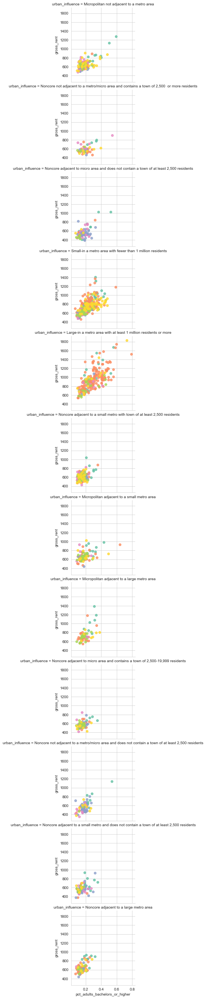

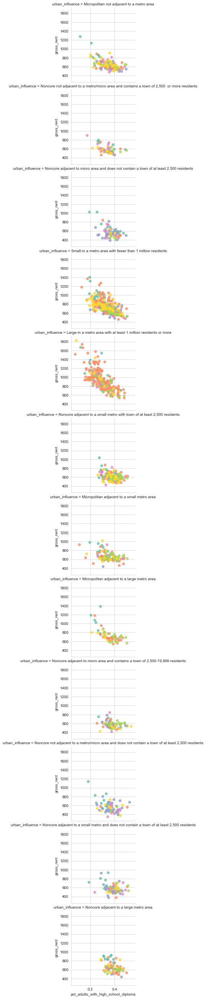

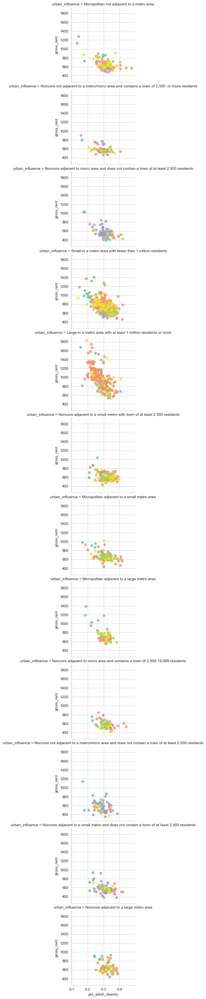

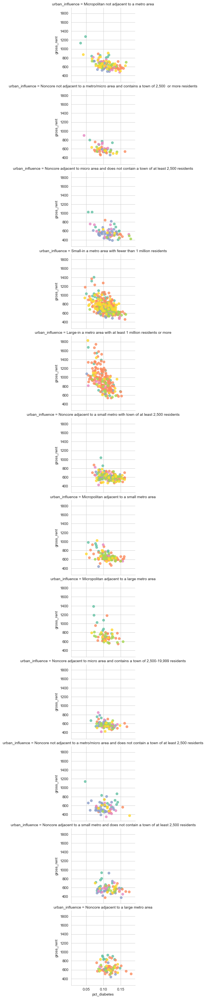

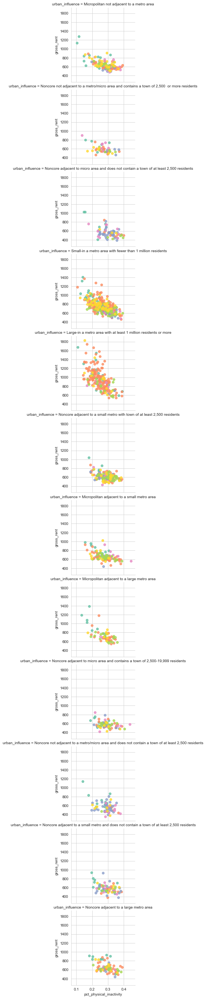

In [324]:
def cond_plot(cols):
    import ipywidgets
    import seaborn as sns
    for col in cols:
        g = sns.FacetGrid(train_values_labels, col="urban_influence",
                      hue="economic_typology", palette="Set2", margin_titles=True, col_wrap=1)
        g.map(sns.regplot, col, "gross_rent", fit_reg = False)
        

cond_plot(Correlations)    

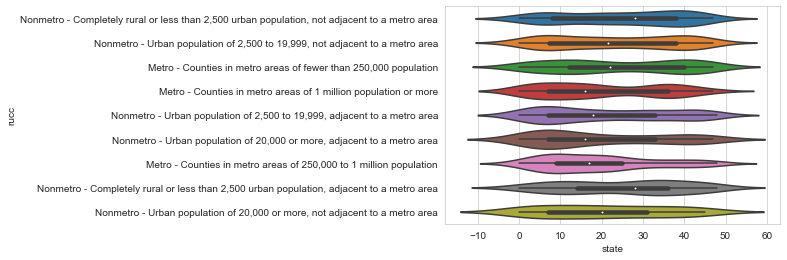

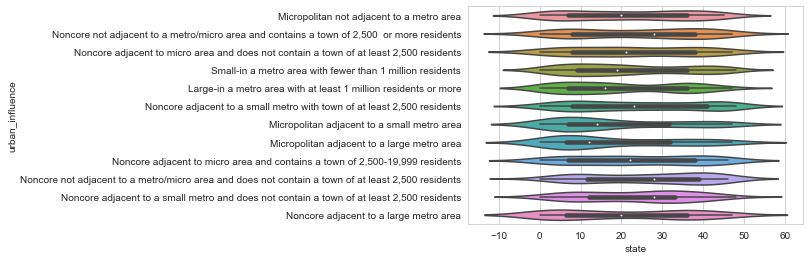

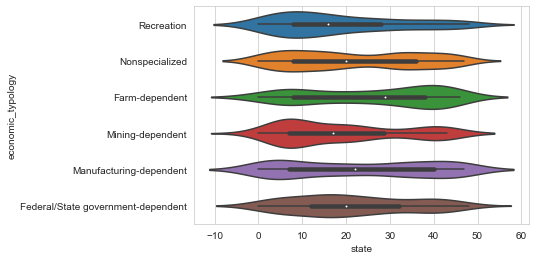

In [325]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'state'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

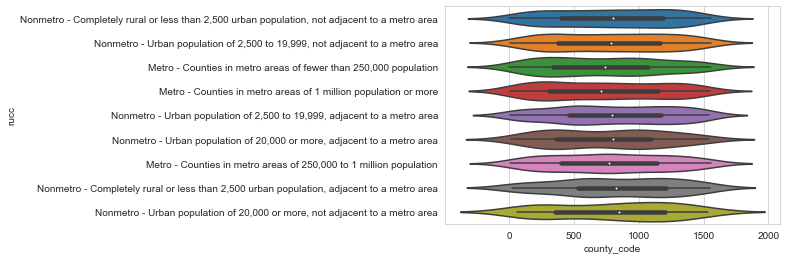

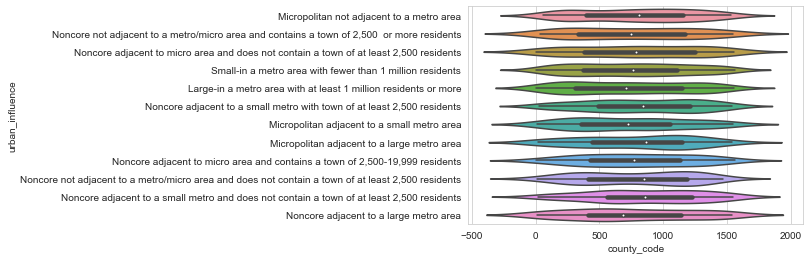

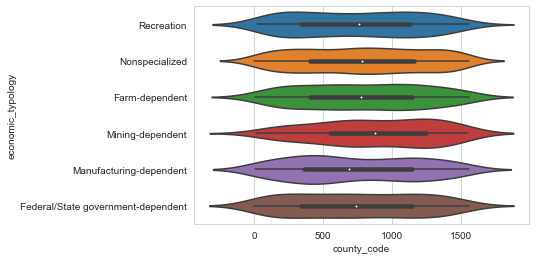

In [326]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'county_code'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [327]:
cat_cols

['rucc', 'urban_influence', 'economic_typology']

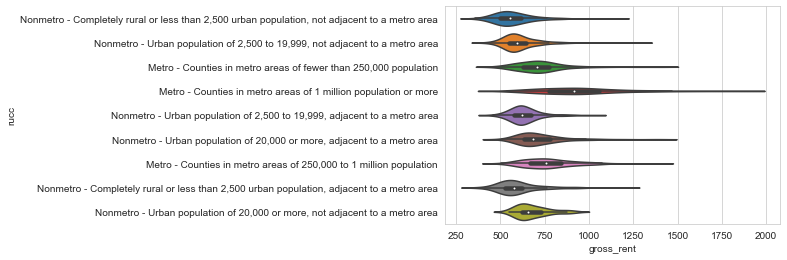

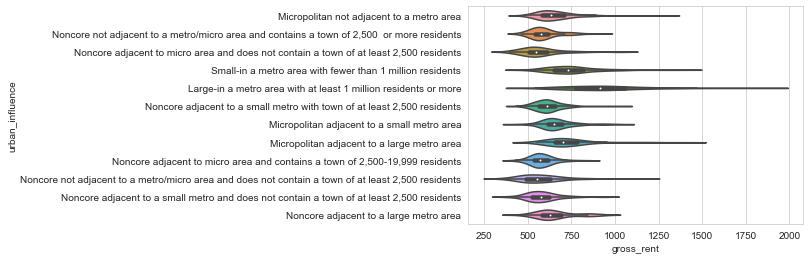

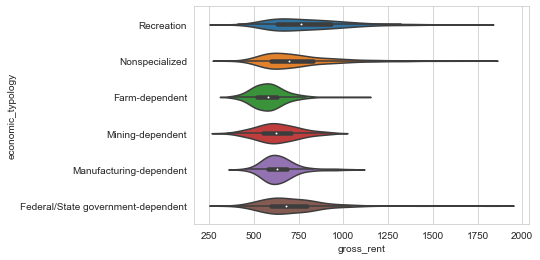

In [328]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'gross_rent'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [329]:
num_cols

['population',
 'renter_occupied_households',
 'pct_renter_occupied',
 'evictions',
 'rent_burden',
 'poverty_rate',
 'pct_civilian_labor',
 'pct_unemployment',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smoking',
 'pct_diabetes',
 'pct_low_birthweight',
 'pct_excessive_drinking',
 'pct_physical_inactivity',
 'air_pollution_particulate_matter_value',
 'homicides_per_100k',
 'motor_vehicle_crash_deaths_per_100k',
 'heart_disease_mortality_per_100k',
 'pop_per_dentist',
 'pop_per_primary_care_physician',
 'pct_below_18_years_of_age',
 'pct_aged_65_years_and_older',
 'pct_adults_less_than_a_high_school_diploma',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 'gross_rent',
 'pct_white',
 'pct_af_am',
 'pct_hispanic',
 'pct_am_ind',
 'pct_asian',
 'pct_nh_pi',
 'pct_multiple',
 'pct_other']

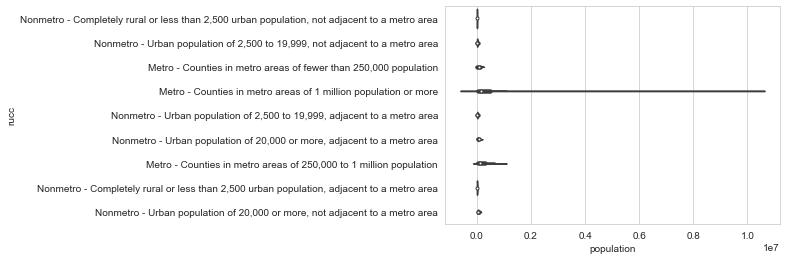

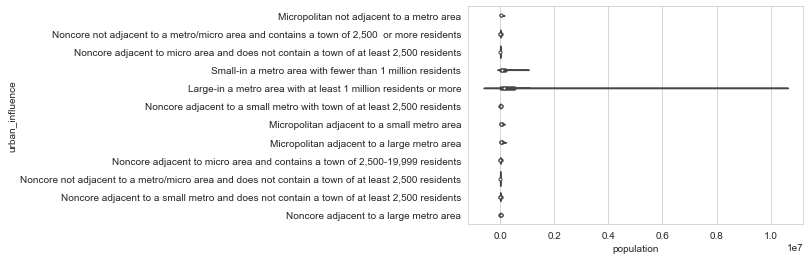

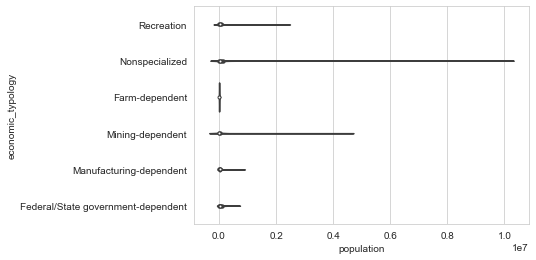

In [330]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'population'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

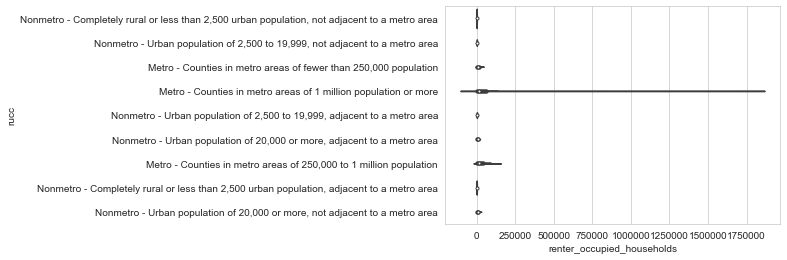

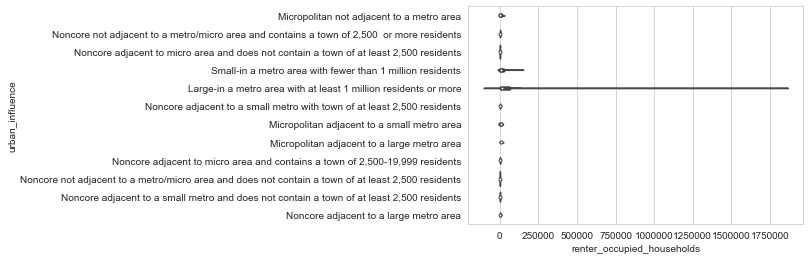

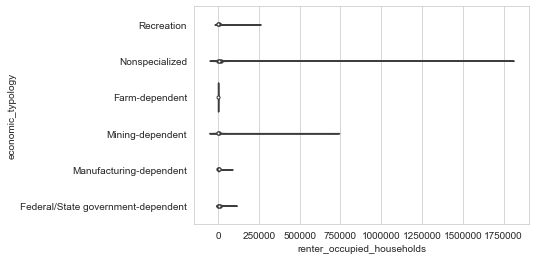

In [331]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'renter_occupied_households'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [332]:
num_cols

['population',
 'renter_occupied_households',
 'pct_renter_occupied',
 'evictions',
 'rent_burden',
 'poverty_rate',
 'pct_civilian_labor',
 'pct_unemployment',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smoking',
 'pct_diabetes',
 'pct_low_birthweight',
 'pct_excessive_drinking',
 'pct_physical_inactivity',
 'air_pollution_particulate_matter_value',
 'homicides_per_100k',
 'motor_vehicle_crash_deaths_per_100k',
 'heart_disease_mortality_per_100k',
 'pop_per_dentist',
 'pop_per_primary_care_physician',
 'pct_below_18_years_of_age',
 'pct_aged_65_years_and_older',
 'pct_adults_less_than_a_high_school_diploma',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 'gross_rent',
 'pct_white',
 'pct_af_am',
 'pct_hispanic',
 'pct_am_ind',
 'pct_asian',
 'pct_nh_pi',
 'pct_multiple',
 'pct_other']

In [333]:
train_values_labels['rucc'].value_counts()

Nonmetro - Urban population of 2,500 to 19,999, adjacent to a metro area                         287
Metro - Counties in metro areas of 1 million population or more                                  216
Nonmetro - Urban population of 2,500 to 19,999, not adjacent to a metro area                     186
Metro - Counties in metro areas of 250,000 to 1 million population                               182
Nonmetro - Completely rural or less than 2,500 urban population, not adjacent to a metro area    165
Metro - Counties in metro areas of fewer than 250,000 population                                 157
Nonmetro - Completely rural or less than 2,500 urban population, adjacent to a metro area        107
Nonmetro - Urban population of 20,000 or more, adjacent to a metro area                           99
Nonmetro - Urban population of 20,000 or more, not adjacent to a metro area                       41
Name: rucc, dtype: int64

In [334]:
train_values_labels.columns

Index(['row_id', 'county_code', 'state', 'population',
       'renter_occupied_households', 'pct_renter_occupied', 'evictions',
       'rent_burden', 'pct_white', 'pct_af_am', 'pct_hispanic', 'pct_am_ind',
       'pct_asian', 'pct_nh_pi', 'pct_multiple', 'pct_other', 'poverty_rate',
       'rucc', 'urban_influence', 'economic_typology', 'pct_civilian_labor',
       'pct_unemployment', 'pct_uninsured_adults', 'pct_uninsured_children',
       'pct_adult_obesity', 'pct_adult_smoking', 'pct_diabetes',
       'pct_low_birthweight', 'pct_excessive_drinking',
       'pct_physical_inactivity', 'air_pollution_particulate_matter_value',
       'homicides_per_100k', 'motor_vehicle_crash_deaths_per_100k',
       'heart_disease_mortality_per_100k', 'pop_per_dentist',
       'pop_per_primary_care_physician', 'pct_female',
       'pct_below_18_years_of_age', 'pct_aged_65_years_and_older',
       'pct_adults_less_than_a_high_school_diploma',
       'pct_adults_with_high_school_diploma', 'pct_adults_wi

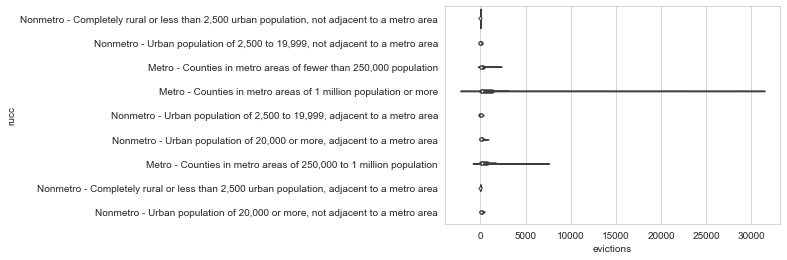

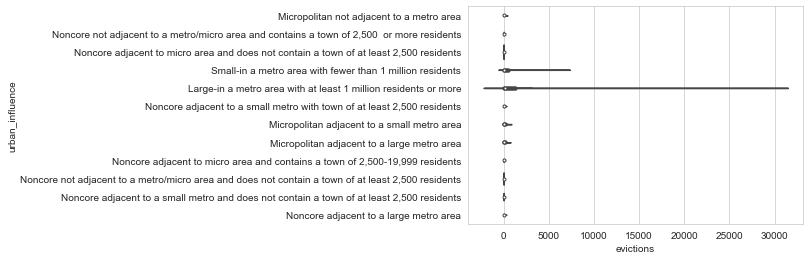

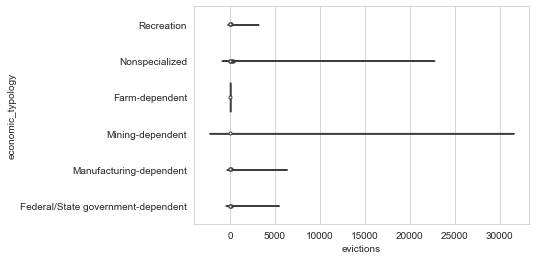

In [335]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'evictions'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

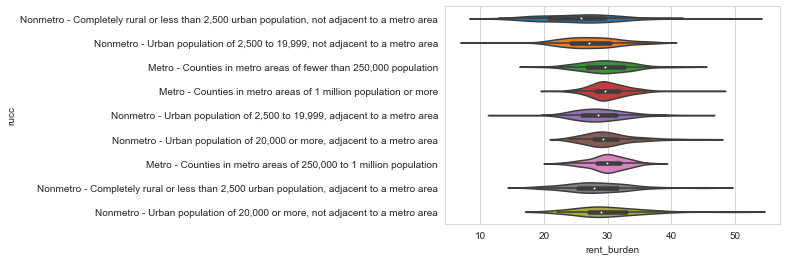

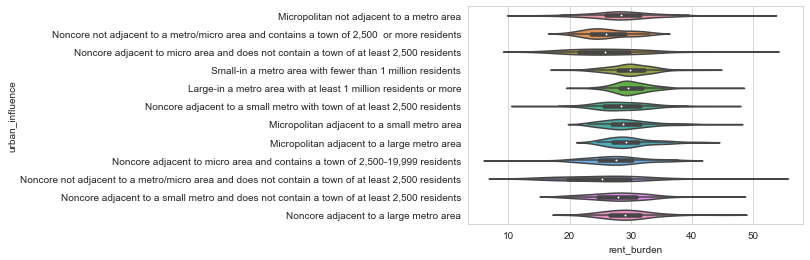

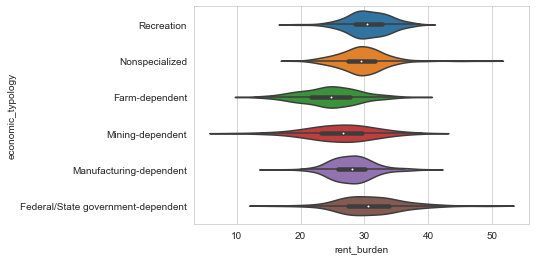

In [336]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'rent_burden'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

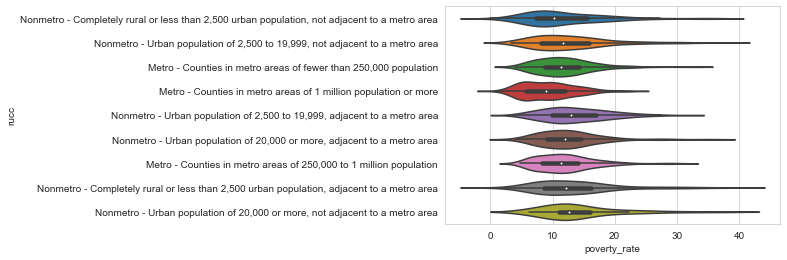

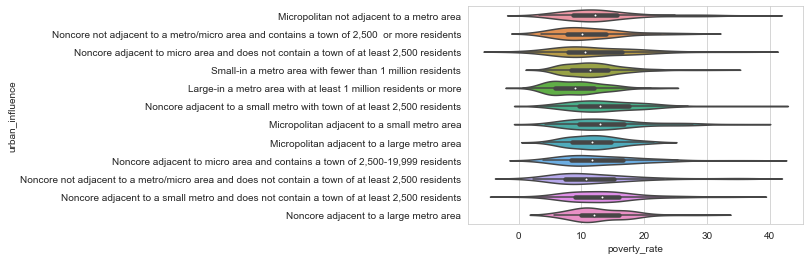

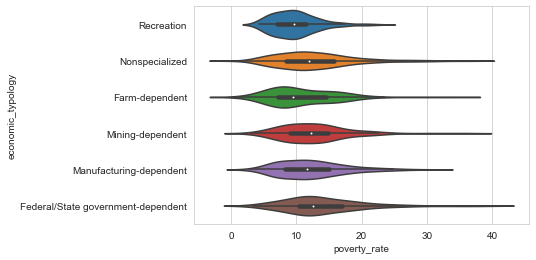

In [337]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'poverty_rate'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [338]:
num_cols

['population',
 'renter_occupied_households',
 'pct_renter_occupied',
 'evictions',
 'rent_burden',
 'poverty_rate',
 'pct_civilian_labor',
 'pct_unemployment',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smoking',
 'pct_diabetes',
 'pct_low_birthweight',
 'pct_excessive_drinking',
 'pct_physical_inactivity',
 'air_pollution_particulate_matter_value',
 'homicides_per_100k',
 'motor_vehicle_crash_deaths_per_100k',
 'heart_disease_mortality_per_100k',
 'pop_per_dentist',
 'pop_per_primary_care_physician',
 'pct_below_18_years_of_age',
 'pct_aged_65_years_and_older',
 'pct_adults_less_than_a_high_school_diploma',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 'gross_rent',
 'pct_white',
 'pct_af_am',
 'pct_hispanic',
 'pct_am_ind',
 'pct_asian',
 'pct_nh_pi',
 'pct_multiple',
 'pct_other']

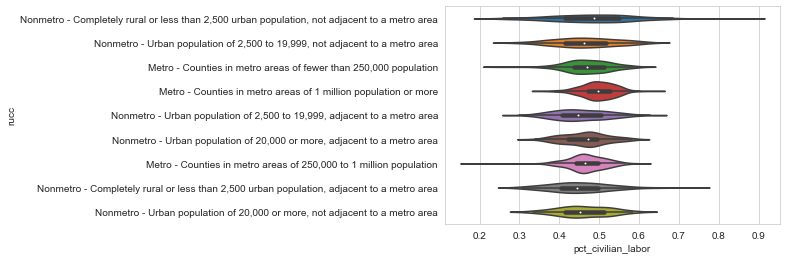

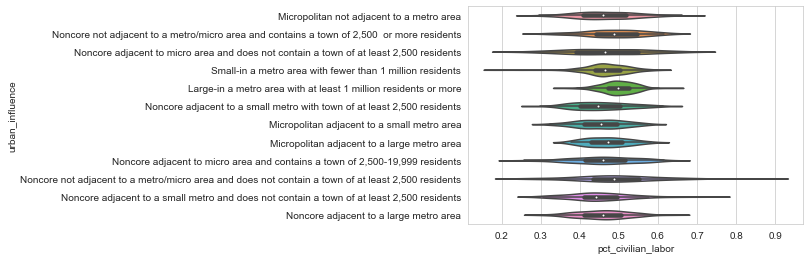

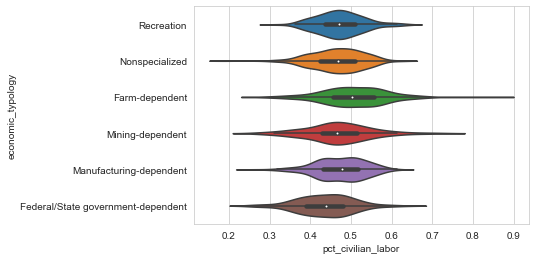

In [339]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pct_civilian_labor'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [340]:
num_cols

['population',
 'renter_occupied_households',
 'pct_renter_occupied',
 'evictions',
 'rent_burden',
 'poverty_rate',
 'pct_civilian_labor',
 'pct_unemployment',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smoking',
 'pct_diabetes',
 'pct_low_birthweight',
 'pct_excessive_drinking',
 'pct_physical_inactivity',
 'air_pollution_particulate_matter_value',
 'homicides_per_100k',
 'motor_vehicle_crash_deaths_per_100k',
 'heart_disease_mortality_per_100k',
 'pop_per_dentist',
 'pop_per_primary_care_physician',
 'pct_below_18_years_of_age',
 'pct_aged_65_years_and_older',
 'pct_adults_less_than_a_high_school_diploma',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 'gross_rent',
 'pct_white',
 'pct_af_am',
 'pct_hispanic',
 'pct_am_ind',
 'pct_asian',
 'pct_nh_pi',
 'pct_multiple',
 'pct_other']

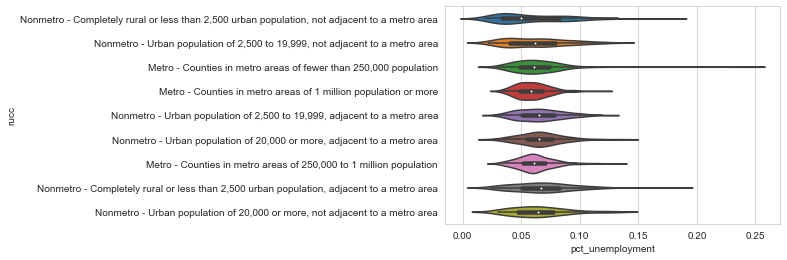

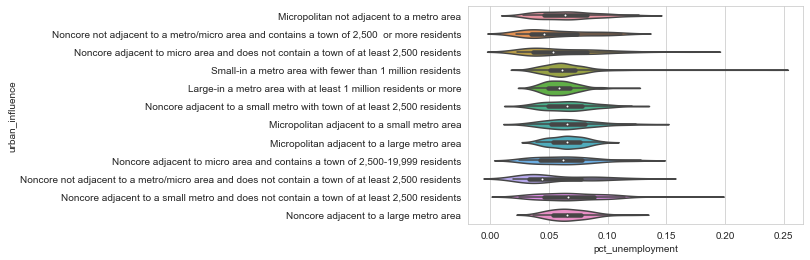

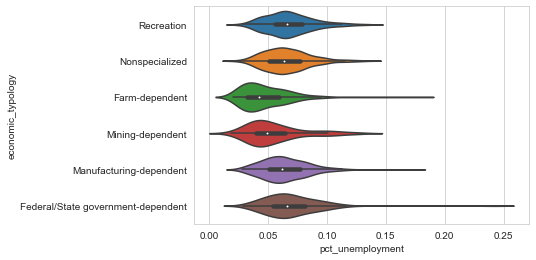

In [341]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pct_unemployment'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

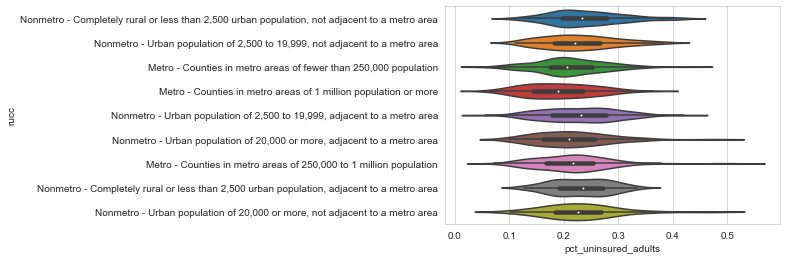

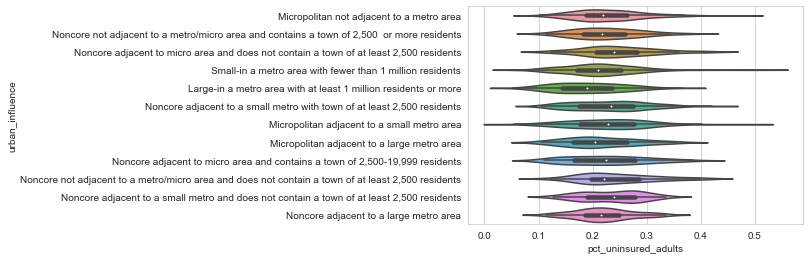

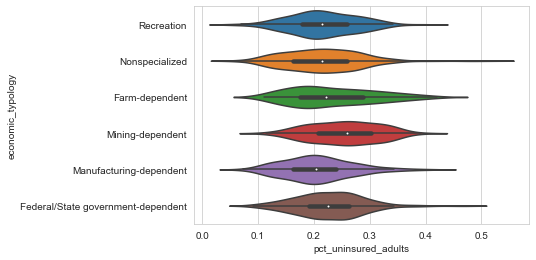

In [342]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pct_uninsured_adults'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [343]:
num_cols

['population',
 'renter_occupied_households',
 'pct_renter_occupied',
 'evictions',
 'rent_burden',
 'poverty_rate',
 'pct_civilian_labor',
 'pct_unemployment',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smoking',
 'pct_diabetes',
 'pct_low_birthweight',
 'pct_excessive_drinking',
 'pct_physical_inactivity',
 'air_pollution_particulate_matter_value',
 'homicides_per_100k',
 'motor_vehicle_crash_deaths_per_100k',
 'heart_disease_mortality_per_100k',
 'pop_per_dentist',
 'pop_per_primary_care_physician',
 'pct_below_18_years_of_age',
 'pct_aged_65_years_and_older',
 'pct_adults_less_than_a_high_school_diploma',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 'gross_rent',
 'pct_white',
 'pct_af_am',
 'pct_hispanic',
 'pct_am_ind',
 'pct_asian',
 'pct_nh_pi',
 'pct_multiple',
 'pct_other']

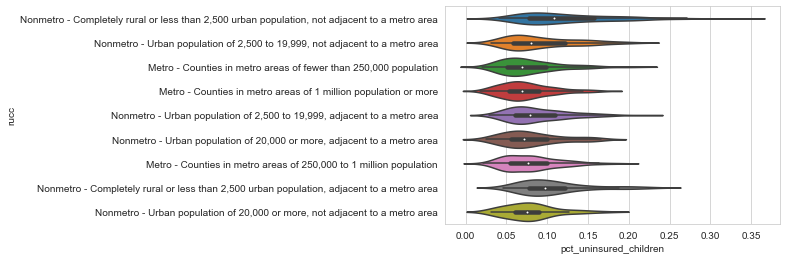

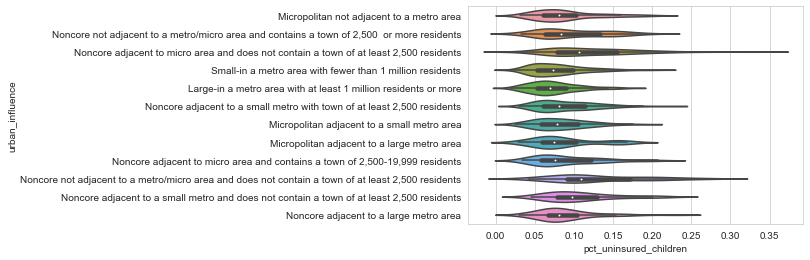

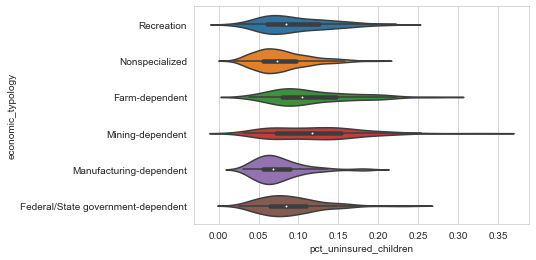

In [344]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pct_uninsured_children'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

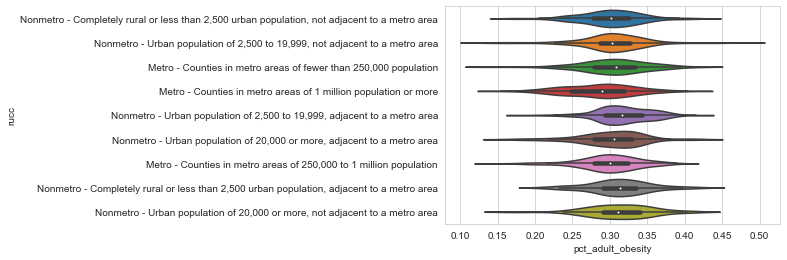

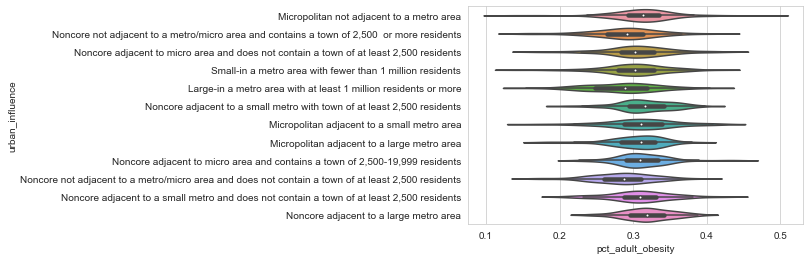

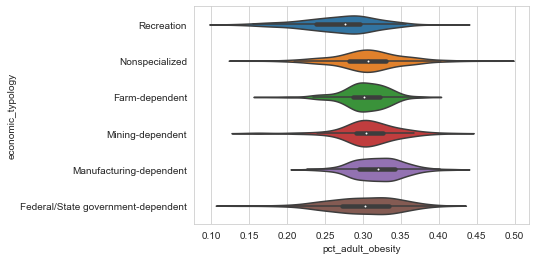

In [345]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pct_adult_obesity'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

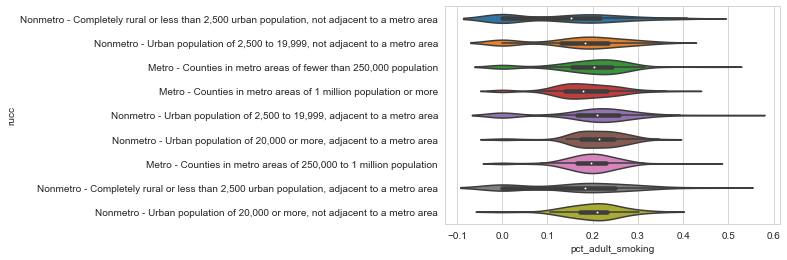

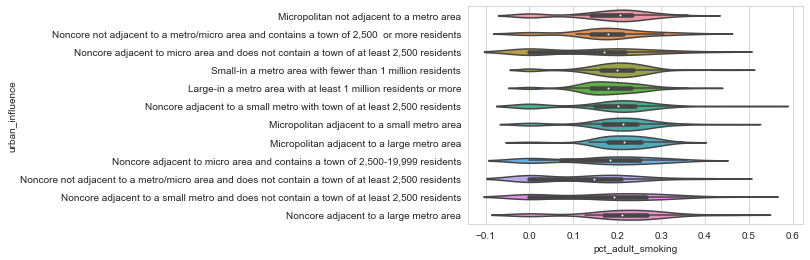

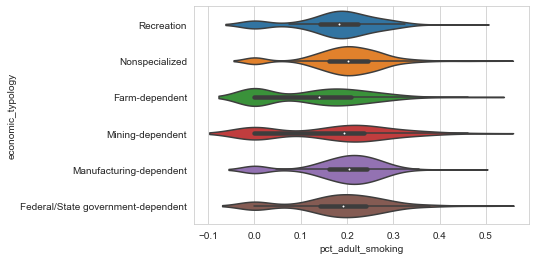

In [346]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pct_adult_smoking'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

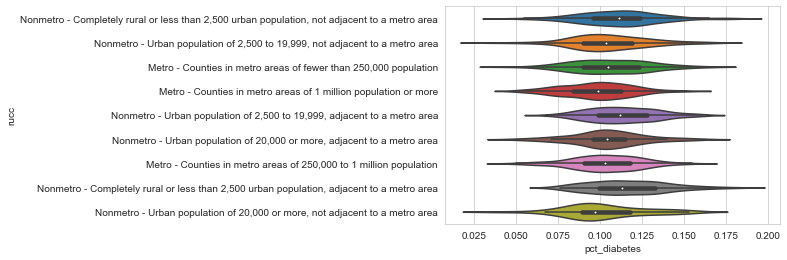

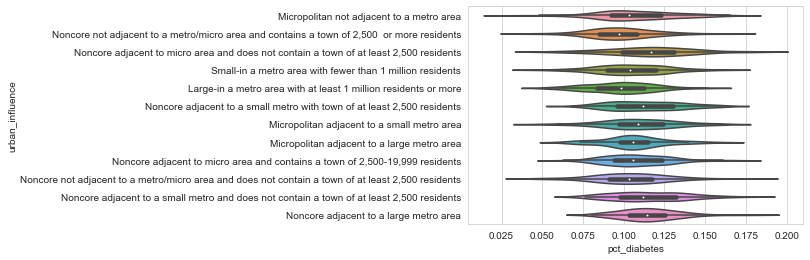

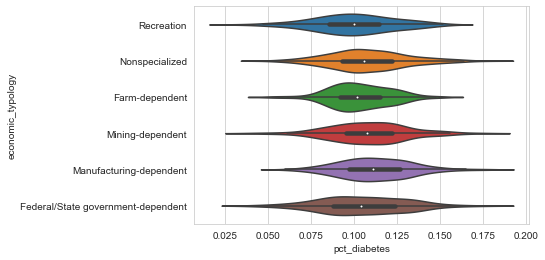

In [347]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pct_diabetes'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

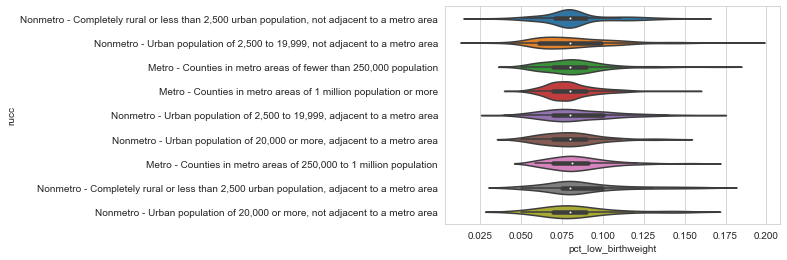

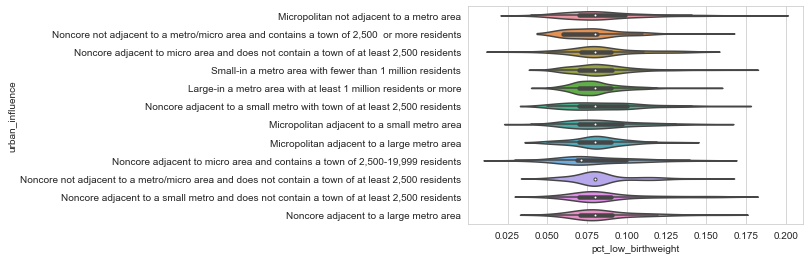

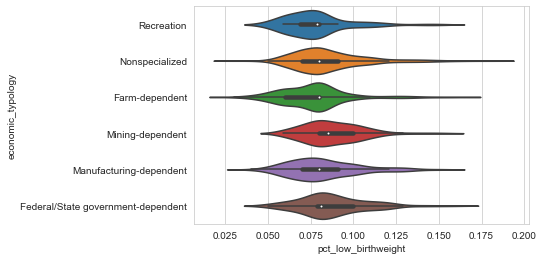

In [348]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pct_low_birthweight'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [349]:
num_cols

['population',
 'renter_occupied_households',
 'pct_renter_occupied',
 'evictions',
 'rent_burden',
 'poverty_rate',
 'pct_civilian_labor',
 'pct_unemployment',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smoking',
 'pct_diabetes',
 'pct_low_birthweight',
 'pct_excessive_drinking',
 'pct_physical_inactivity',
 'air_pollution_particulate_matter_value',
 'homicides_per_100k',
 'motor_vehicle_crash_deaths_per_100k',
 'heart_disease_mortality_per_100k',
 'pop_per_dentist',
 'pop_per_primary_care_physician',
 'pct_below_18_years_of_age',
 'pct_aged_65_years_and_older',
 'pct_adults_less_than_a_high_school_diploma',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 'gross_rent',
 'pct_white',
 'pct_af_am',
 'pct_hispanic',
 'pct_am_ind',
 'pct_asian',
 'pct_nh_pi',
 'pct_multiple',
 'pct_other']

In [350]:
num_cols

['population',
 'renter_occupied_households',
 'pct_renter_occupied',
 'evictions',
 'rent_burden',
 'poverty_rate',
 'pct_civilian_labor',
 'pct_unemployment',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smoking',
 'pct_diabetes',
 'pct_low_birthweight',
 'pct_excessive_drinking',
 'pct_physical_inactivity',
 'air_pollution_particulate_matter_value',
 'homicides_per_100k',
 'motor_vehicle_crash_deaths_per_100k',
 'heart_disease_mortality_per_100k',
 'pop_per_dentist',
 'pop_per_primary_care_physician',
 'pct_below_18_years_of_age',
 'pct_aged_65_years_and_older',
 'pct_adults_less_than_a_high_school_diploma',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 'gross_rent',
 'pct_white',
 'pct_af_am',
 'pct_hispanic',
 'pct_am_ind',
 'pct_asian',
 'pct_nh_pi',
 'pct_multiple',
 'pct_other']

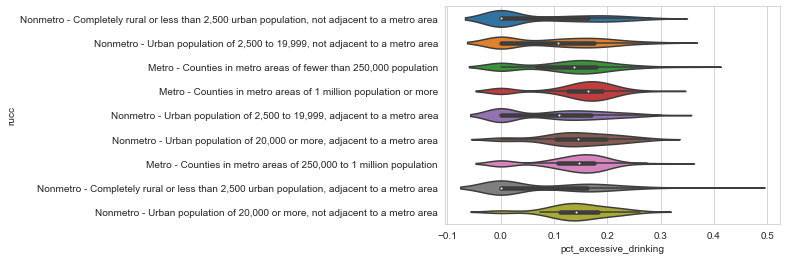

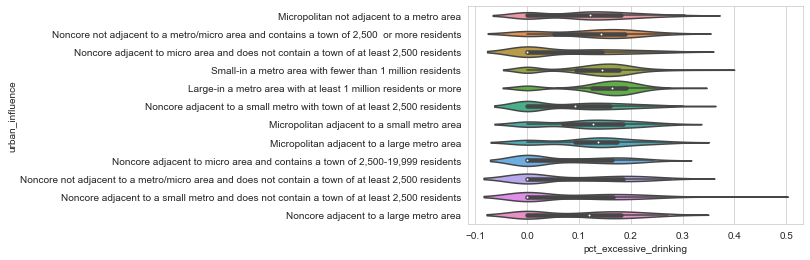

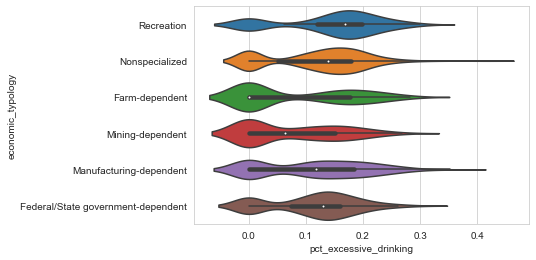

In [351]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pct_excessive_drinking'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [352]:
train_values_labels['urban_influence'].value_counts()

Small-in a metro area with fewer than 1 million residents                                             339
Large-in a metro area with at least 1 million residents or more                                       216
Noncore adjacent to a small metro with town of at least 2,500 residents                               168
Micropolitan not adjacent to a metro area                                                             119
Micropolitan adjacent to a small metro area                                                           106
Noncore adjacent to micro area and contains a town of 2,500-19,999 residents                           80
Noncore adjacent to a large metro area                                                                 79
Noncore adjacent to a small metro and does not contain a town of at least 2,500 residents              77
Noncore adjacent to micro area and does not contain a town of at least 2,500 residents                 73
Noncore not adjacent to a metro/micro area and

In [353]:
small = train_values_labels[train_values_labels['urban_influence'] == 'Noncore adjacent to micro area and contains a town of 2,500-19,999 residents']
small

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
19,19,125,5,17479.0,1801.0,22.804,12.0,30.329,0.968958,0.005248,...,-2.525729,-1.298283,3.226090,3.227399,-0.734137,-1.427284,2.312347,-0.816445,-2.603690,3.225176
22,22,899,33,10111.0,920.0,21.095,3.0,28.268,0.908087,0.004633,...,-2.995732,-1.555897,3.228628,3.228034,-1.002845,-0.981164,2.342713,-0.608806,-3.170086,3.223465
31,31,1057,38,10591.0,999.0,26.133,1.0,21.008,0.539935,0.016090,...,-2.995732,-1.227583,3.226090,3.230765,-1.101629,-1.374318,2.864466,-0.634878,-3.506558,3.229341
37,37,1254,45,6179.0,593.0,21.550,1.0,21.684,0.917266,0.003980,...,-3.218876,-1.280134,3.218876,3.227836,-0.984175,-1.175653,2.506265,-0.579818,-3.411248,3.225216
40,40,751,14,20981.0,2437.0,29.936,63.0,32.960,0.436677,0.526178,...,-2.128632,-1.287354,3.218876,3.228034,-0.883887,-1.445921,2.521942,-0.994252,-2.513306,3.229222
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1433,1433,1326,45,8003.0,768.0,25.455,5.0,22.697,0.946675,0.001394,...,-2.659260,-1.130103,3.226804,3.228311,-0.799507,-1.317768,2.390412,-0.671386,-2.975930,3.224818
1477,1477,1199,14,18394.0,2023.0,30.032,1.0,23.085,0.696391,0.189847,...,-2.198225,-1.133204,3.218876,3.228945,-0.844643,-1.592631,2.616888,-0.755023,-2.441847,3.230923
1487,1487,373,45,9637.0,1055.0,27.954,7.0,25.519,0.945073,0.001316,...,-2.813411,-1.309333,3.226923,3.227994,-0.993551,-0.982827,2.368600,-0.597837,-3.270169,3.224301
1521,1521,467,4,22505.0,2593.0,28.002,43.0,25.894,0.968066,0.001893,...,-2.645075,-1.224176,3.218876,3.228272,-0.728738,-1.281134,2.366488,-0.585190,-3.123566,3.225534


In [354]:
for col in small:
    small[col].describe()
    print(col,small[col].describe(),'\n')

row_id count      80.000000
mean      737.737500
std       426.222612
min        19.000000
25%       405.750000
50%       738.500000
75%      1080.500000
max      1558.000000
Name: row_id, dtype: float64 

county_code count      80.000000
mean      792.550000
std       434.690837
min         5.000000
25%       423.250000
50%       768.500000
75%      1128.750000
max      1560.000000
Name: county_code, dtype: float64 

state count    80.00000
mean     23.90000
std      14.93666
min       0.00000
25%       7.00000
50%      22.00000
75%      38.00000
max      46.00000
Name: state, dtype: float64 

population count       80.000000
mean     15949.262500
std       9331.433082
min       4495.000000
25%       9151.500000
50%      13625.500000
75%      20570.000000
max      48354.000000
Name: population, dtype: float64 

renter_occupied_households count      80.000000
mean     1718.062500
std       979.551361
min       465.000000
25%       993.250000
50%      1391.500000
75%      2454.750000
ma

pct_af_amlog count    80.000000
mean      0.180030
std       0.195007
min       0.000000
25%       0.068342
50%       0.096397
75%       0.188269
max       0.850069
Name: pct_af_amlog, dtype: float64 

pct_hispaniclog count    80.000000
mean      0.255012
std       0.206804
min       0.063459
25%       0.117649
50%       0.185134
75%       0.281731
max       0.963827
Name: pct_hispaniclog, dtype: float64 

pct_am_indlog count    80.000000
mean      0.067147
std       0.095380
min       0.000000
25%       0.026562
50%       0.042293
75%       0.072691
max       0.683774
Name: pct_am_indlog, dtype: float64 

pct_asianlog count    80.000000
mean      0.056031
std       0.035244
min       0.000000
25%       0.034578
50%       0.056486
75%       0.072659
max       0.165305
Name: pct_asianlog, dtype: float64 

pct_nh_pilog count    80.000000
mean      0.010864
std       0.020569
min       0.000000
25%       0.000000
50%       0.000000
75%       0.017956
max       0.119685
Name: pct_nh_pilog,

In [355]:
train_values_labels[train_values_labels['evictions'] == -1]

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
32,32,435,28,1043.0,125.0,25.425,-1.0,17.492,0.971436,0.000000,...,-2.525729,-1.231001,3.218876,3.228390,-0.810432,-1.114693,1.691656,-0.548181,-3.611918,3.233015
39,39,1502,41,21758.0,2017.0,23.901,-1.0,29.654,0.863019,0.087378,...,-2.407946,-1.301953,3.218876,3.226884,-0.959499,-1.072101,2.349945,-0.886732,-2.465104,3.225534
61,61,1319,7,18240.0,1793.0,29.867,-1.0,23.228,0.169795,0.039252,...,-2.396896,-1.301953,3.218876,3.228589,-1.083797,-1.432104,2.648102,-0.586987,-3.324236,3.231397
100,100,1193,7,1426.0,149.0,19.095,-1.0,31.547,0.755442,0.037368,...,-2.525729,-1.187444,3.218876,3.227756,-0.988861,-1.294627,2.486437,-0.697155,-3.244194,3.230804
101,101,1374,15,10332.0,923.0,25.519,-1.0,24.556,0.660098,0.319392,...,-2.047943,-1.049822,3.222748,3.227796,-0.859658,-1.598541,2.526461,-0.967584,-2.501036,3.230923
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1480,1480,1305,7,3460.0,370.0,28.363,-1.0,16.899,0.666335,0.002874,...,-2.525729,-1.255266,3.218876,3.230172,-0.996959,-1.309333,2.591829,-0.709277,-3.381395,3.232147
1513,1513,834,7,7233.0,625.0,29.491,-1.0,28.766,0.155347,0.009183,...,-2.292635,-1.335601,3.218876,3.227796,-1.119793,-1.989772,2.626649,-0.499226,-3.473768,3.232897
1546,1546,128,10,7001.0,568.0,20.640,-1.0,33.245,0.936286,0.000000,...,-2.538307,-1.655482,3.226765,3.226487,-1.217775,-1.227997,2.064356,-0.546453,-3.101093,3.222948
1551,1551,1501,29,4239.0,306.0,20.508,-1.0,27.847,0.944484,0.000000,...,-2.525729,-1.474033,3.218876,3.230053,-0.955313,-0.890290,2.362335,-0.693147,-3.270169,3.227558


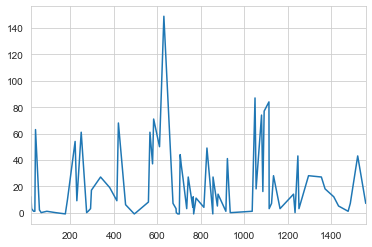

In [356]:
small['evictions'].plot()

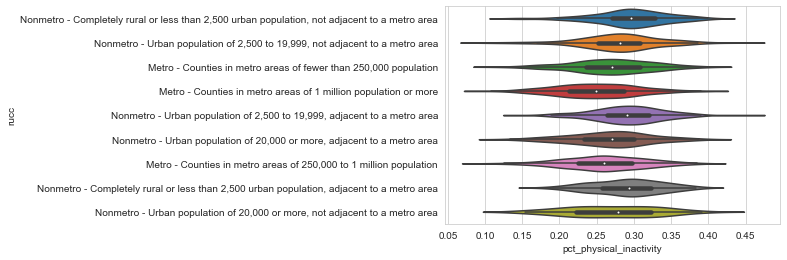

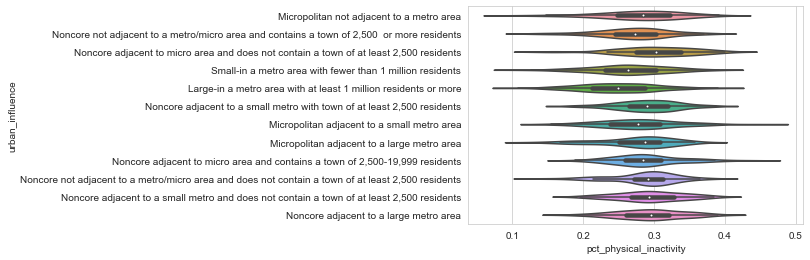

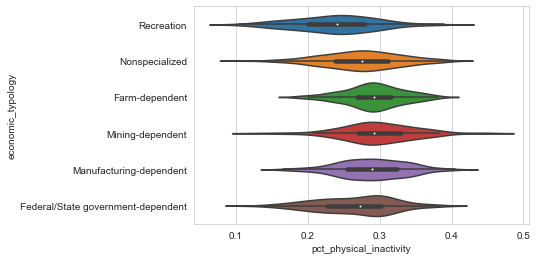

In [357]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pct_physical_inactivity'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [358]:
num_cols

['population',
 'renter_occupied_households',
 'pct_renter_occupied',
 'evictions',
 'rent_burden',
 'poverty_rate',
 'pct_civilian_labor',
 'pct_unemployment',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smoking',
 'pct_diabetes',
 'pct_low_birthweight',
 'pct_excessive_drinking',
 'pct_physical_inactivity',
 'air_pollution_particulate_matter_value',
 'homicides_per_100k',
 'motor_vehicle_crash_deaths_per_100k',
 'heart_disease_mortality_per_100k',
 'pop_per_dentist',
 'pop_per_primary_care_physician',
 'pct_below_18_years_of_age',
 'pct_aged_65_years_and_older',
 'pct_adults_less_than_a_high_school_diploma',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 'gross_rent',
 'pct_white',
 'pct_af_am',
 'pct_hispanic',
 'pct_am_ind',
 'pct_asian',
 'pct_nh_pi',
 'pct_multiple',
 'pct_other']

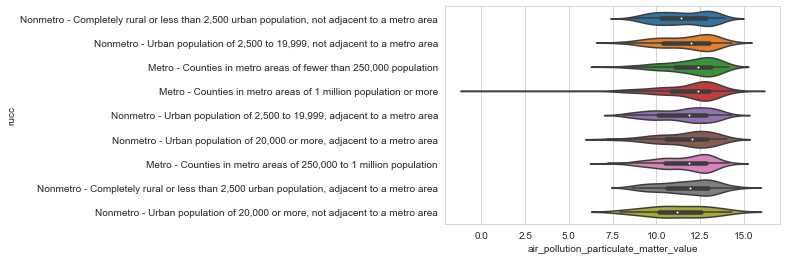

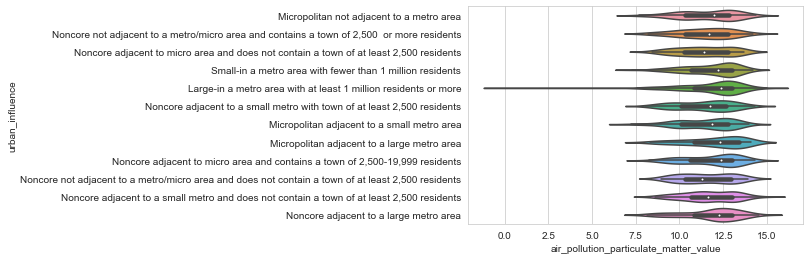

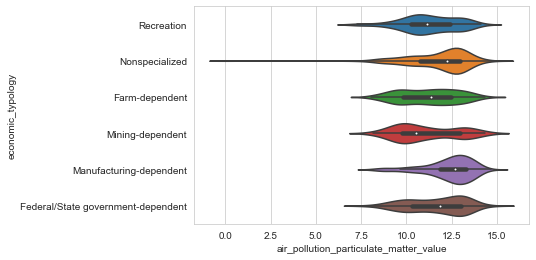

In [359]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'air_pollution_particulate_matter_value'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [360]:
num_cols

['population',
 'renter_occupied_households',
 'pct_renter_occupied',
 'evictions',
 'rent_burden',
 'poverty_rate',
 'pct_civilian_labor',
 'pct_unemployment',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smoking',
 'pct_diabetes',
 'pct_low_birthweight',
 'pct_excessive_drinking',
 'pct_physical_inactivity',
 'air_pollution_particulate_matter_value',
 'homicides_per_100k',
 'motor_vehicle_crash_deaths_per_100k',
 'heart_disease_mortality_per_100k',
 'pop_per_dentist',
 'pop_per_primary_care_physician',
 'pct_below_18_years_of_age',
 'pct_aged_65_years_and_older',
 'pct_adults_less_than_a_high_school_diploma',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 'gross_rent',
 'pct_white',
 'pct_af_am',
 'pct_hispanic',
 'pct_am_ind',
 'pct_asian',
 'pct_nh_pi',
 'pct_multiple',
 'pct_other']

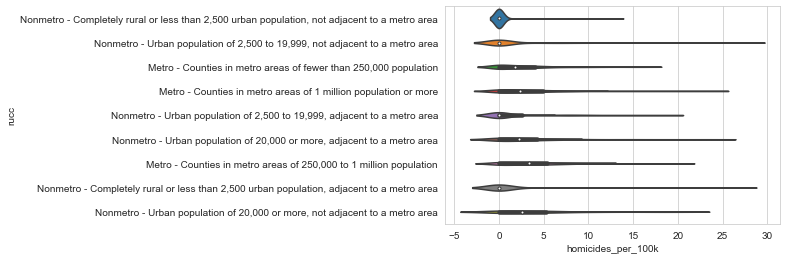

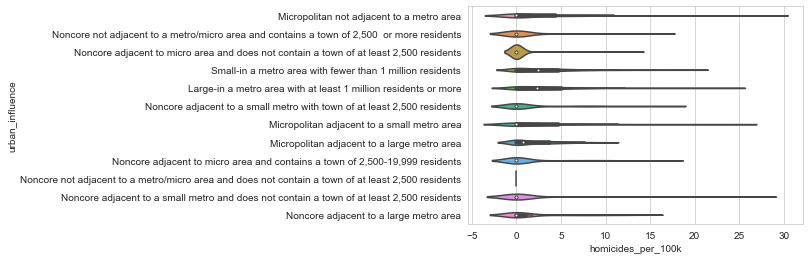

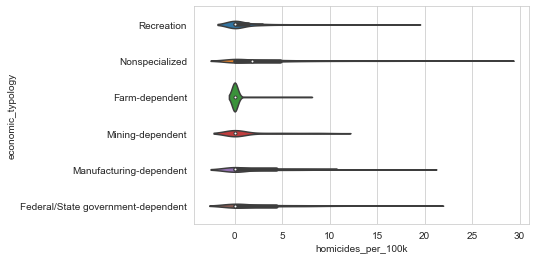

In [361]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'homicides_per_100k'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [362]:
train_values_labels['urban_influence'].value_counts()

Small-in a metro area with fewer than 1 million residents                                             339
Large-in a metro area with at least 1 million residents or more                                       216
Noncore adjacent to a small metro with town of at least 2,500 residents                               168
Micropolitan not adjacent to a metro area                                                             119
Micropolitan adjacent to a small metro area                                                           106
Noncore adjacent to micro area and contains a town of 2,500-19,999 residents                           80
Noncore adjacent to a large metro area                                                                 79
Noncore adjacent to a small metro and does not contain a town of at least 2,500 residents              77
Noncore adjacent to micro area and does not contain a town of at least 2,500 residents                 73
Noncore not adjacent to a metro/micro area and

In [363]:
flatzone =train_values_labels[train_values_labels['urban_influence']=='Noncore not adjacent to a metro/micro area and does not contain a town of at least 2,500 residents']
flatzone

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
27,27,974,28,4203.0,504.0,27.531,0.0,24.138,0.855246,0.000000,...,-2.525729,-1.136314,3.226209,3.227399,-0.982499,-1.063210,2.715219,-0.733969,-2.918771,3.231634
32,32,435,28,1043.0,125.0,25.425,-1.0,17.492,0.971436,0.000000,...,-2.525729,-1.231001,3.218876,3.228390,-0.810432,-1.114693,1.691656,-0.548181,-3.611918,3.233015
75,75,1349,16,18895.0,2824.0,27.891,35.0,30.305,0.843737,0.006485,...,-2.796881,-1.737271,3.226249,3.225772,-1.440472,-0.801275,2.146196,-0.830113,-2.171557,3.227122
84,84,244,43,4763.0,518.0,21.716,0.0,22.497,0.967279,0.001498,...,-2.813411,-1.217396,3.226566,3.226606,-1.043124,-0.977166,2.404806,-0.610646,-3.473768,3.226010
100,100,1193,7,1426.0,149.0,19.095,-1.0,31.547,0.755442,0.037368,...,-2.525729,-1.187444,3.218876,3.227756,-0.988861,-1.294627,2.486437,-0.697155,-3.244194,3.230804
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1412,1412,198,14,21531.0,2137.0,21.248,18.0,29.606,0.943763,0.004594,...,-2.538307,-1.272966,3.218876,3.225653,-1.093625,-1.130103,1.957086,-0.834711,-2.703063,3.229578
1468,1468,1095,20,12676.0,1133.0,28.765,1.0,34.340,0.931585,0.047148,...,-1.890475,-0.972861,3.224381,3.227280,-0.928870,-1.350927,2.339558,-1.301953,-2.396896,3.226725
1480,1480,1305,7,3460.0,370.0,28.363,-1.0,16.899,0.666335,0.002874,...,-2.525729,-1.255266,3.218876,3.230172,-0.996959,-1.309333,2.591829,-0.709277,-3.381395,3.232147
1515,1515,1181,22,2742.0,270.0,17.127,0.0,19.399,0.925314,0.006596,...,-2.525729,-1.537117,3.218876,3.230093,-1.371479,-0.896586,2.552880,-0.671386,-2.353878,3.229341


In [364]:
train_values_labels.columns

Index(['row_id', 'county_code', 'state', 'population',
       'renter_occupied_households', 'pct_renter_occupied', 'evictions',
       'rent_burden', 'pct_white', 'pct_af_am', 'pct_hispanic', 'pct_am_ind',
       'pct_asian', 'pct_nh_pi', 'pct_multiple', 'pct_other', 'poverty_rate',
       'rucc', 'urban_influence', 'economic_typology', 'pct_civilian_labor',
       'pct_unemployment', 'pct_uninsured_adults', 'pct_uninsured_children',
       'pct_adult_obesity', 'pct_adult_smoking', 'pct_diabetes',
       'pct_low_birthweight', 'pct_excessive_drinking',
       'pct_physical_inactivity', 'air_pollution_particulate_matter_value',
       'homicides_per_100k', 'motor_vehicle_crash_deaths_per_100k',
       'heart_disease_mortality_per_100k', 'pop_per_dentist',
       'pop_per_primary_care_physician', 'pct_female',
       'pct_below_18_years_of_age', 'pct_aged_65_years_and_older',
       'pct_adults_less_than_a_high_school_diploma',
       'pct_adults_with_high_school_diploma', 'pct_adults_wi

In [365]:
flatzone['homicides_per_100k'].describe()

count    67.0
mean      0.0
std       0.0
min       0.0
25%       0.0
50%       0.0
75%       0.0
max       0.0
Name: homicides_per_100k, dtype: float64

In [366]:
flatzone['motor_vehicle_crash_deaths_per_100k'].describe()

count    67.000000
mean     12.793582
std      17.338330
min       0.000000
25%       0.000000
50%       0.000000
75%      24.485000
max      52.170000
Name: motor_vehicle_crash_deaths_per_100k, dtype: float64

In [367]:
flatzone['gross_rent']

27      490
32      497
75      836
84      474
100     439
       ... 
1412    625
1468    420
1480    662
1515    544
1523    607
Name: gross_rent, Length: 67, dtype: int64

In [368]:
flatzone.isnull().any()

row_id                             False
county_code                        False
state                              False
population                         False
renter_occupied_households         False
                                   ...  
pct_adults_with_some_collegelog    False
birth_rate_per_1klog               False
pct_civilian_laborlog              False
pct_unemploymentlog                False
pct_uninsured_adultslog            False
Length: 85, dtype: bool

In [369]:
#train_values_labels.drop(flatzone.index, inplace = True) 

In [370]:
num_cols

['population',
 'renter_occupied_households',
 'pct_renter_occupied',
 'evictions',
 'rent_burden',
 'poverty_rate',
 'pct_civilian_labor',
 'pct_unemployment',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smoking',
 'pct_diabetes',
 'pct_low_birthweight',
 'pct_excessive_drinking',
 'pct_physical_inactivity',
 'air_pollution_particulate_matter_value',
 'homicides_per_100k',
 'motor_vehicle_crash_deaths_per_100k',
 'heart_disease_mortality_per_100k',
 'pop_per_dentist',
 'pop_per_primary_care_physician',
 'pct_below_18_years_of_age',
 'pct_aged_65_years_and_older',
 'pct_adults_less_than_a_high_school_diploma',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 'gross_rent',
 'pct_white',
 'pct_af_am',
 'pct_hispanic',
 'pct_am_ind',
 'pct_asian',
 'pct_nh_pi',
 'pct_multiple',
 'pct_other']

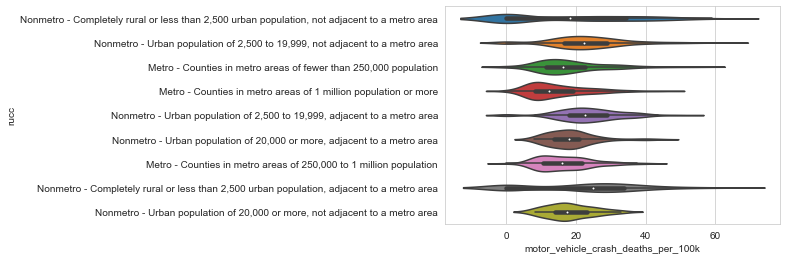

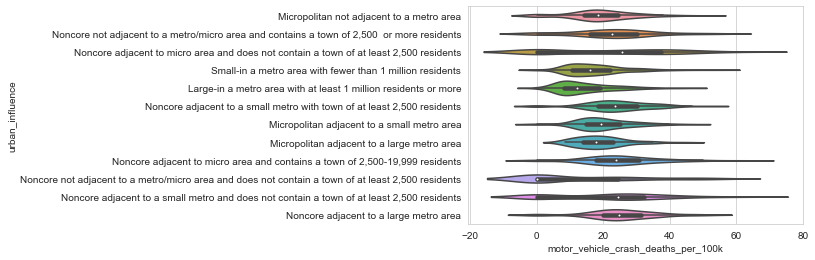

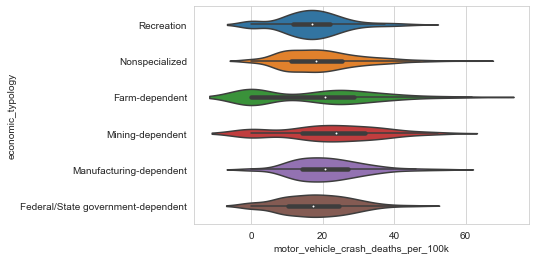

In [371]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'motor_vehicle_crash_deaths_per_100k'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [372]:
num_cols

['population',
 'renter_occupied_households',
 'pct_renter_occupied',
 'evictions',
 'rent_burden',
 'poverty_rate',
 'pct_civilian_labor',
 'pct_unemployment',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smoking',
 'pct_diabetes',
 'pct_low_birthweight',
 'pct_excessive_drinking',
 'pct_physical_inactivity',
 'air_pollution_particulate_matter_value',
 'homicides_per_100k',
 'motor_vehicle_crash_deaths_per_100k',
 'heart_disease_mortality_per_100k',
 'pop_per_dentist',
 'pop_per_primary_care_physician',
 'pct_below_18_years_of_age',
 'pct_aged_65_years_and_older',
 'pct_adults_less_than_a_high_school_diploma',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 'gross_rent',
 'pct_white',
 'pct_af_am',
 'pct_hispanic',
 'pct_am_ind',
 'pct_asian',
 'pct_nh_pi',
 'pct_multiple',
 'pct_other']

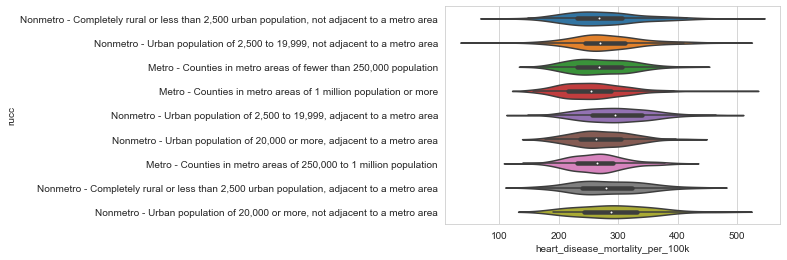

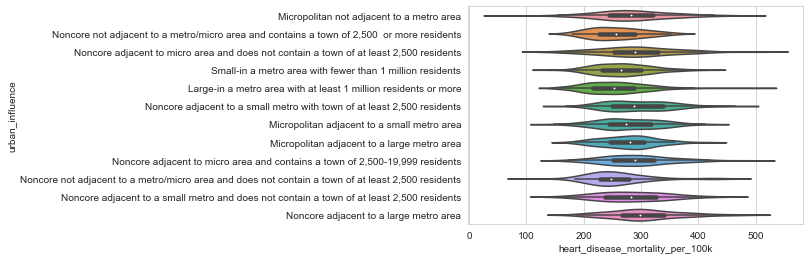

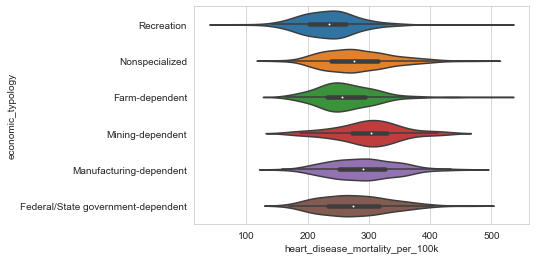

In [373]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'heart_disease_mortality_per_100k'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [374]:
num_cols

['population',
 'renter_occupied_households',
 'pct_renter_occupied',
 'evictions',
 'rent_burden',
 'poverty_rate',
 'pct_civilian_labor',
 'pct_unemployment',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smoking',
 'pct_diabetes',
 'pct_low_birthweight',
 'pct_excessive_drinking',
 'pct_physical_inactivity',
 'air_pollution_particulate_matter_value',
 'homicides_per_100k',
 'motor_vehicle_crash_deaths_per_100k',
 'heart_disease_mortality_per_100k',
 'pop_per_dentist',
 'pop_per_primary_care_physician',
 'pct_below_18_years_of_age',
 'pct_aged_65_years_and_older',
 'pct_adults_less_than_a_high_school_diploma',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 'gross_rent',
 'pct_white',
 'pct_af_am',
 'pct_hispanic',
 'pct_am_ind',
 'pct_asian',
 'pct_nh_pi',
 'pct_multiple',
 'pct_other']

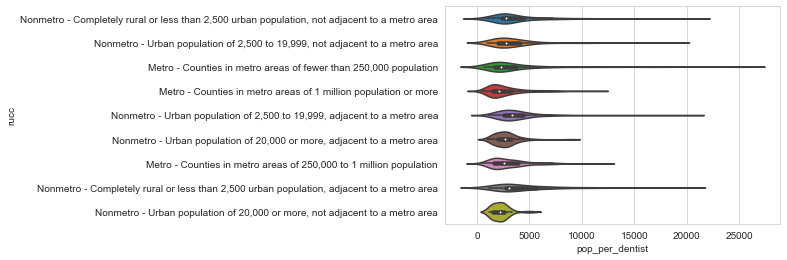

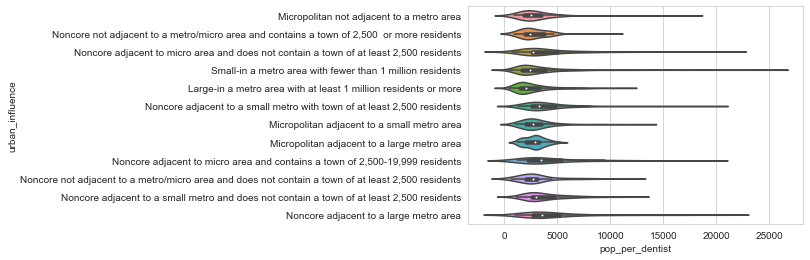

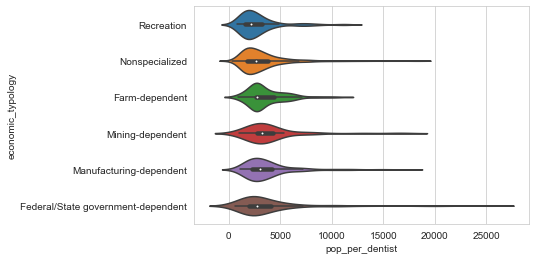

In [375]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pop_per_dentist'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [376]:
Farmers = train_values_labels[train_values_labels['economic_typology']=='Farm-dependent']
Farmers

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
4,4,183,38,3681.0,365.0,21.985,2.0,19.673,0.923886,0.000496,...,-2.525729,-1.078810,3.225971,3.227717,-1.015589,-1.060540,2.255838,-0.746548,-3.381395,3.225931
7,7,794,16,27974.0,3873.0,38.012,49.0,29.966,0.537084,0.008489,...,-2.995732,-1.671313,3.225613,3.229934,-1.224772,-1.178406,2.675990,-0.772190,-2.244316,3.230686
22,22,899,33,10111.0,920.0,21.095,3.0,28.268,0.908087,0.004633,...,-2.995732,-1.555897,3.228628,3.228034,-1.002845,-0.981164,2.342713,-0.608806,-3.170086,3.223465
27,27,974,28,4203.0,504.0,27.531,0.0,24.138,0.855246,0.000000,...,-2.525729,-1.136314,3.226209,3.227399,-0.982499,-1.063210,2.715219,-0.733969,-2.918771,3.231634
32,32,435,28,1043.0,125.0,25.425,-1.0,17.492,0.971436,0.000000,...,-2.525729,-1.231001,3.218876,3.228390,-0.810432,-1.114693,1.691656,-0.548181,-3.611918,3.233015
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1457,1457,1487,38,6352.0,665.0,21.695,3.0,25.864,0.960195,0.001104,...,-2.995732,-1.139434,3.225057,3.228390,-0.875469,-1.163954,2.495114,-0.632993,-3.296837,3.225216
1495,1495,1398,7,2989.0,274.0,21.083,0.0,19.503,0.383372,0.037104,...,-2.513306,-1.241329,3.218876,3.230449,-1.212021,-1.429290,2.764114,-0.748660,-2.975930,3.234592
1523,1523,1262,38,1954.0,202.0,24.789,0.0,18.753,0.888687,0.000000,...,-2.525729,-1.231001,3.226249,3.227082,-1.015111,-0.998672,2.231816,-0.572701,-3.575551,3.226249
1547,1547,1368,21,5854.0,628.0,27.376,9.0,27.979,0.710822,0.003414,...,-2.407946,-1.084709,3.218876,3.228826,-0.848632,-1.382302,2.371520,-0.923819,-2.688248,3.231121


In [377]:
Farmers['evictions'].describe()

count    172.000000
mean       4.052326
std        8.215849
min       -1.000000
25%        0.000000
50%        1.000000
75%        4.250000
max       55.000000
Name: evictions, dtype: float64

In [378]:
sixteen = Farmers[Farmers['evictions']>30]
sixteen

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_low_birthweightlog,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog
7,7,794,16,27974.0,3873.0,38.012,49.0,29.966,0.537084,0.008489,...,-2.995732,-1.671313,3.225613,3.229934,-1.224772,-1.178406,2.675990,-0.772190,-2.244316,3.230686
1018,1018,614,7,16739.0,1495.0,25.238,34.0,27.527,0.642629,0.113852,...,-2.538307,-1.187444,3.218876,3.228826,-0.940168,-1.312760,2.441095,-0.576253,-3.218876,3.231002
1408,1408,524,20,20192.0,2123.0,27.348,55.0,25.674,0.955261,0.013568,...,-2.407946,-1.248273,3.218876,3.228232,-1.024218,-1.277130,2.559491,-0.853316,-2.830218,3.228509


In [379]:
sixteen['pop_per_dentist']

7       1410.0
1018    3419.0
1408    5099.0
Name: pop_per_dentist, dtype: float64

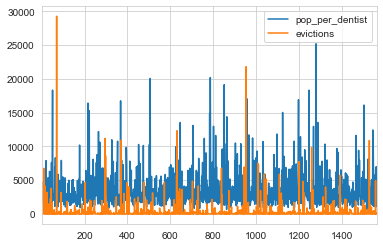

In [380]:
train_values_labels[['pop_per_dentist','evictions']].plot()

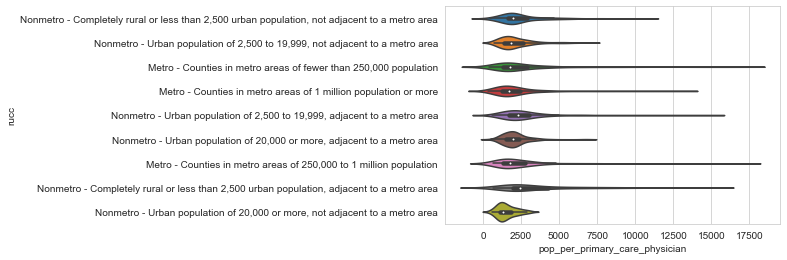

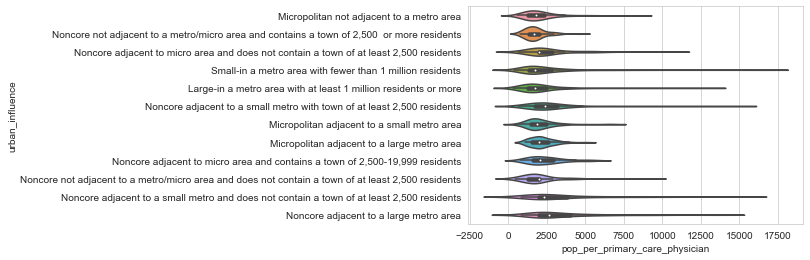

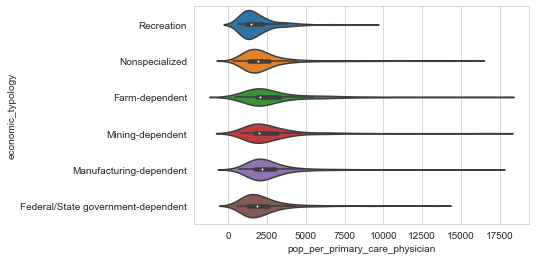

In [381]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pop_per_primary_care_physician'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [382]:
num_cols

['population',
 'renter_occupied_households',
 'pct_renter_occupied',
 'evictions',
 'rent_burden',
 'poverty_rate',
 'pct_civilian_labor',
 'pct_unemployment',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smoking',
 'pct_diabetes',
 'pct_low_birthweight',
 'pct_excessive_drinking',
 'pct_physical_inactivity',
 'air_pollution_particulate_matter_value',
 'homicides_per_100k',
 'motor_vehicle_crash_deaths_per_100k',
 'heart_disease_mortality_per_100k',
 'pop_per_dentist',
 'pop_per_primary_care_physician',
 'pct_below_18_years_of_age',
 'pct_aged_65_years_and_older',
 'pct_adults_less_than_a_high_school_diploma',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 'gross_rent',
 'pct_white',
 'pct_af_am',
 'pct_hispanic',
 'pct_am_ind',
 'pct_asian',
 'pct_nh_pi',
 'pct_multiple',
 'pct_other']

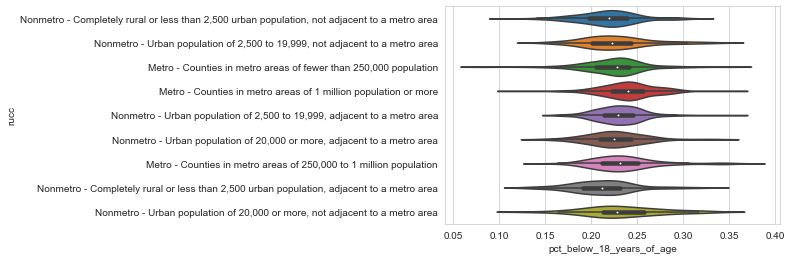

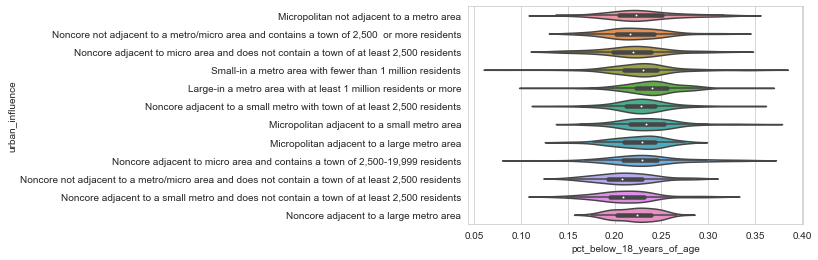

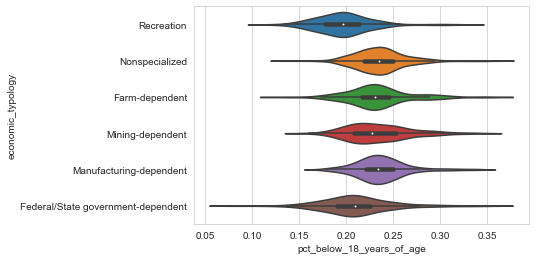

In [383]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pct_below_18_years_of_age'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [384]:
num_cols

['population',
 'renter_occupied_households',
 'pct_renter_occupied',
 'evictions',
 'rent_burden',
 'poverty_rate',
 'pct_civilian_labor',
 'pct_unemployment',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smoking',
 'pct_diabetes',
 'pct_low_birthweight',
 'pct_excessive_drinking',
 'pct_physical_inactivity',
 'air_pollution_particulate_matter_value',
 'homicides_per_100k',
 'motor_vehicle_crash_deaths_per_100k',
 'heart_disease_mortality_per_100k',
 'pop_per_dentist',
 'pop_per_primary_care_physician',
 'pct_below_18_years_of_age',
 'pct_aged_65_years_and_older',
 'pct_adults_less_than_a_high_school_diploma',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 'gross_rent',
 'pct_white',
 'pct_af_am',
 'pct_hispanic',
 'pct_am_ind',
 'pct_asian',
 'pct_nh_pi',
 'pct_multiple',
 'pct_other']

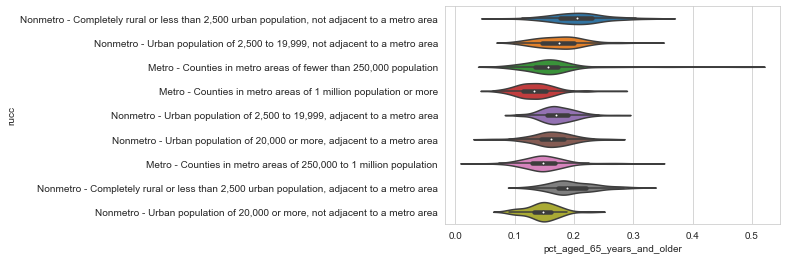

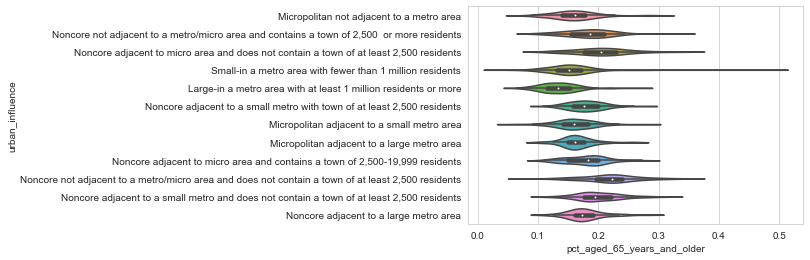

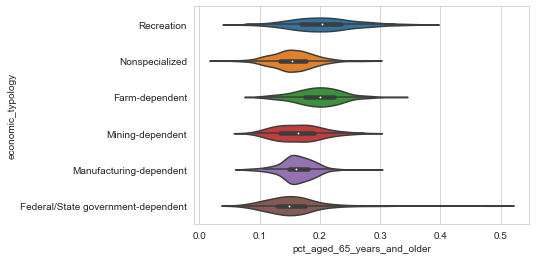

In [385]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pct_aged_65_years_and_older'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [386]:
num_cols

['population',
 'renter_occupied_households',
 'pct_renter_occupied',
 'evictions',
 'rent_burden',
 'poverty_rate',
 'pct_civilian_labor',
 'pct_unemployment',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smoking',
 'pct_diabetes',
 'pct_low_birthweight',
 'pct_excessive_drinking',
 'pct_physical_inactivity',
 'air_pollution_particulate_matter_value',
 'homicides_per_100k',
 'motor_vehicle_crash_deaths_per_100k',
 'heart_disease_mortality_per_100k',
 'pop_per_dentist',
 'pop_per_primary_care_physician',
 'pct_below_18_years_of_age',
 'pct_aged_65_years_and_older',
 'pct_adults_less_than_a_high_school_diploma',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 'gross_rent',
 'pct_white',
 'pct_af_am',
 'pct_hispanic',
 'pct_am_ind',
 'pct_asian',
 'pct_nh_pi',
 'pct_multiple',
 'pct_other']

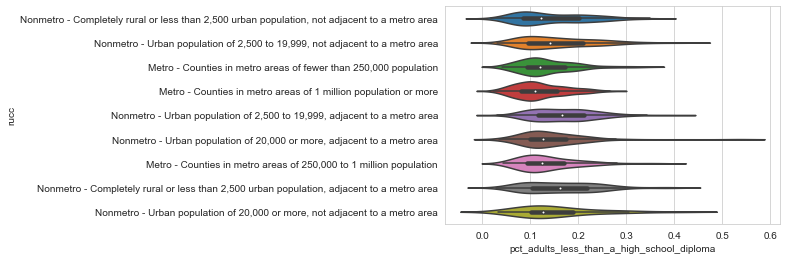

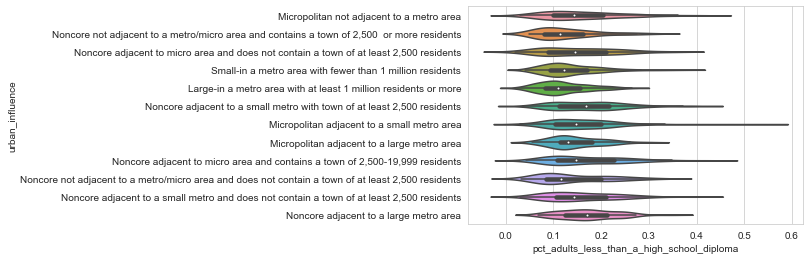

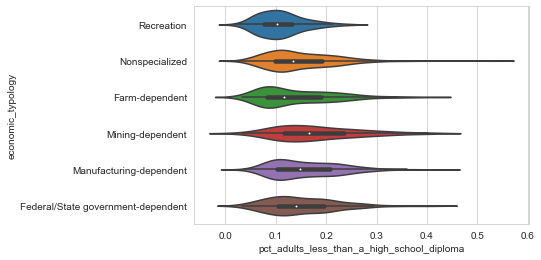

In [387]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pct_adults_less_than_a_high_school_diploma'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

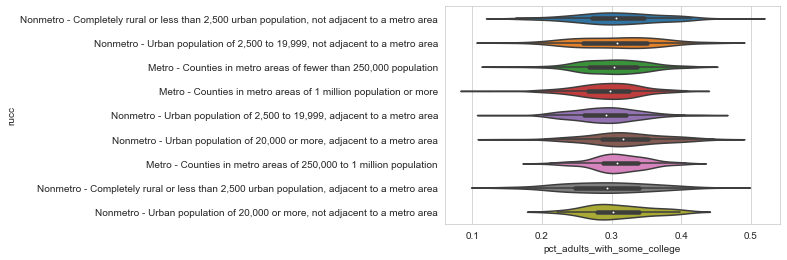

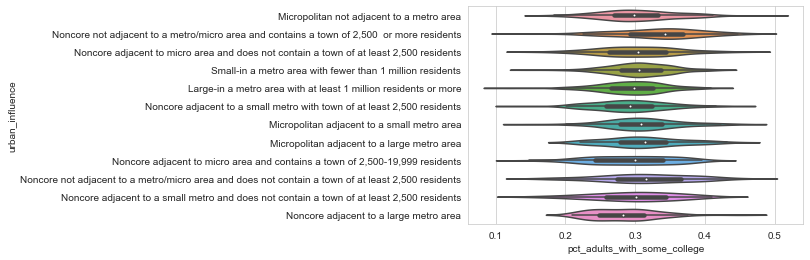

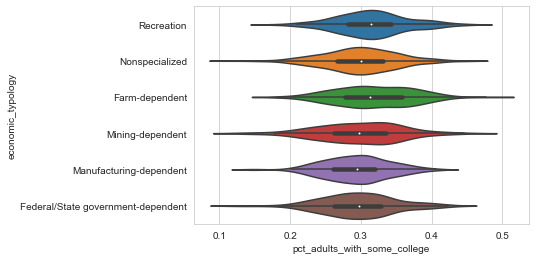

In [388]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pct_adults_with_some_college'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

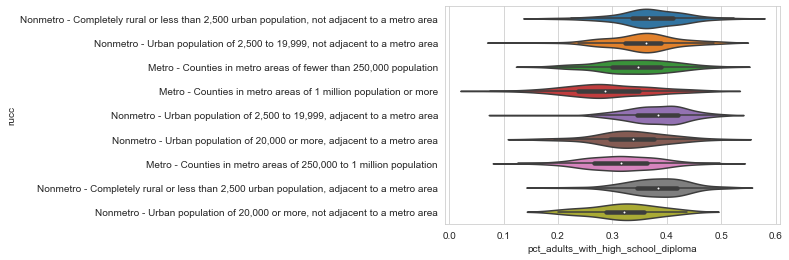

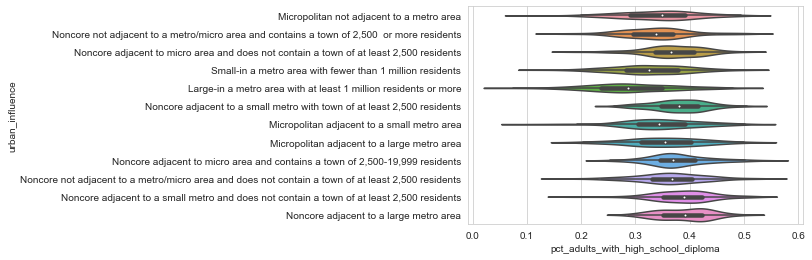

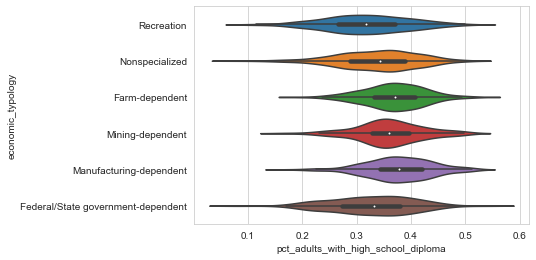

In [389]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pct_adults_with_high_school_diploma'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

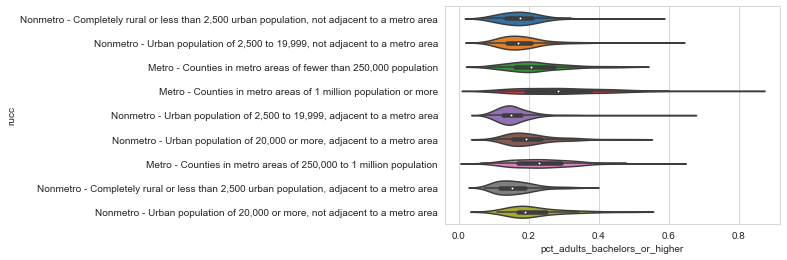

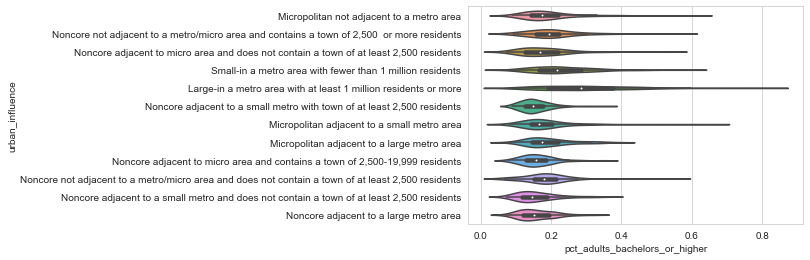

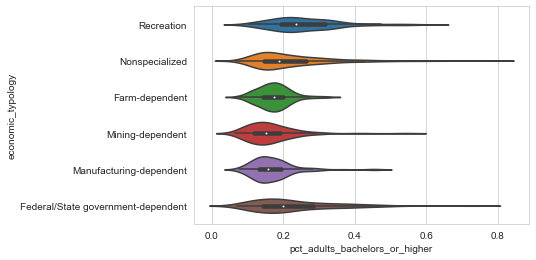

In [390]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'pct_adults_bachelors_or_higher'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [391]:
num_cols

['population',
 'renter_occupied_households',
 'pct_renter_occupied',
 'evictions',
 'rent_burden',
 'poverty_rate',
 'pct_civilian_labor',
 'pct_unemployment',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smoking',
 'pct_diabetes',
 'pct_low_birthweight',
 'pct_excessive_drinking',
 'pct_physical_inactivity',
 'air_pollution_particulate_matter_value',
 'homicides_per_100k',
 'motor_vehicle_crash_deaths_per_100k',
 'heart_disease_mortality_per_100k',
 'pop_per_dentist',
 'pop_per_primary_care_physician',
 'pct_below_18_years_of_age',
 'pct_aged_65_years_and_older',
 'pct_adults_less_than_a_high_school_diploma',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 'gross_rent',
 'pct_white',
 'pct_af_am',
 'pct_hispanic',
 'pct_am_ind',
 'pct_asian',
 'pct_nh_pi',
 'pct_multiple',
 'pct_other']

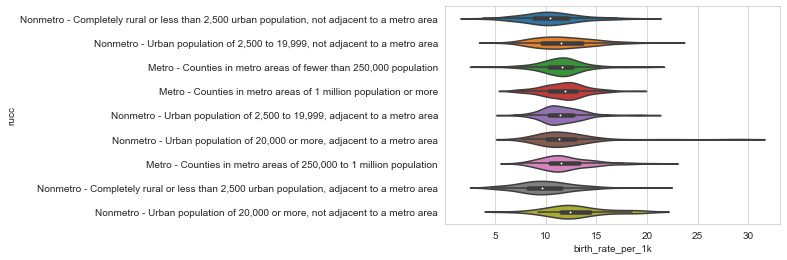

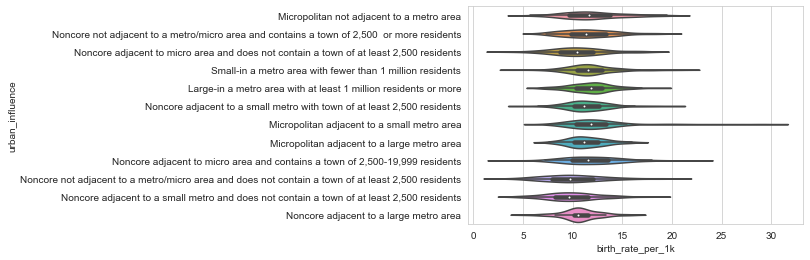

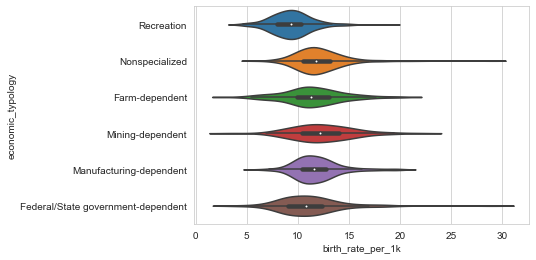

In [392]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'birth_rate_per_1k'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

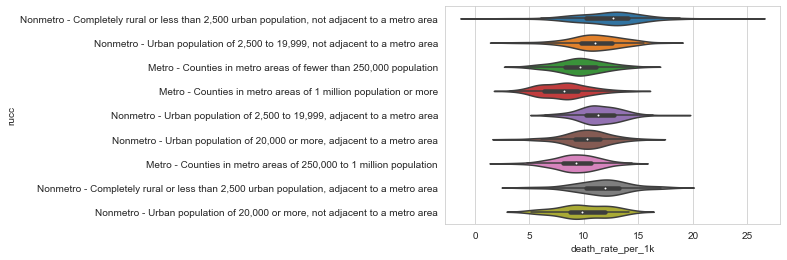

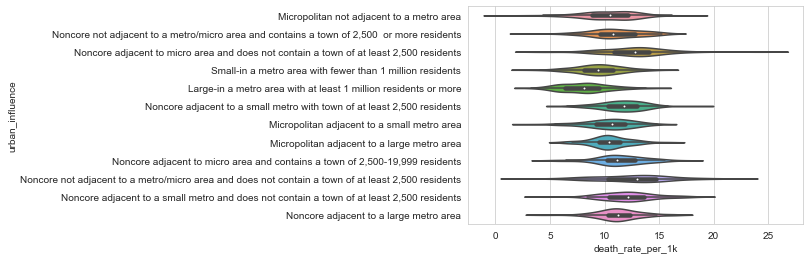

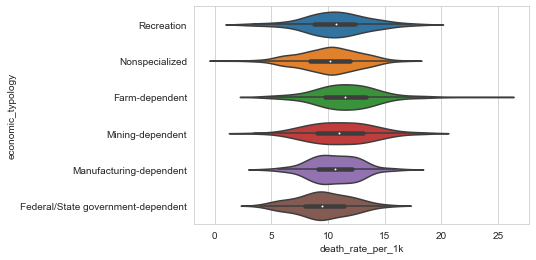

In [393]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
def plot_violin(train_values_labels, cols, col_x = 'death_rate_per_1k'):
    for col in cols:
        sns.set_style("whitegrid")
        sns.violinplot(col_x, col, data=train_values_labels)
        plt.xlabel(col_x) # Set text for the x axis
        plt.ylabel(col)# Set text for y axis
        plt.show()

plot_violin(train_values_labels, cat_cols)

In [394]:
labels = np.array(np.log(train_values_labels['gross_rent']))

In [395]:
cat_cols

['rucc', 'urban_influence', 'economic_typology']

In [396]:
def encode_string(cat_features):
    ## First encode the strings to numeric categories
    enc = preprocessing.LabelEncoder()
    enc.fit(cat_features)
    enc_cat_features = enc.transform(cat_features)
    ## Now, apply one hot encoding
    ohe = preprocessing.OneHotEncoder()
    encoded = ohe.fit(enc_cat_features.reshape(-1,1))
    return encoded.transform(enc_cat_features.reshape(-1,1)).toarray()

categorical_columns = ['urban_influence','economic_typology']

TestFeatures = encode_string(test_values['rucc'])
for col in categorical_columns:
    temp = encode_string(test_values[col])
    TestFeatures = np.concatenate([TestFeatures, temp], axis = 1)

print(TestFeatures.shape)
print(TestFeatures[:2, :]) 

(1576, 27)
[[0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.
  0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.
  0. 0. 0.]]


C:\Users\Jorge\Anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
C:\Users\Jorge\Anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you us

In [397]:
cat_cols

['rucc', 'urban_influence', 'economic_typology']

In [398]:
def encode_string(cat_features):
    ## First encode the strings to numeric categories
    enc = preprocessing.LabelEncoder()
    enc.fit(cat_features)
    enc_cat_features = enc.transform(cat_features)
    ## Now, apply one hot encoding
    ohe = preprocessing.OneHotEncoder()
    encoded = ohe.fit(enc_cat_features.reshape(-1,1))
    return encoded.transform(enc_cat_features.reshape(-1,1)).toarray()

categorical_columns = ['urban_influence','economic_typology']

Features = encode_string(train_values_labels['rucc'])
for col in categorical_columns:
    temp = encode_string(train_values_labels[col])
    Features = np.concatenate([Features, temp], axis = 1)

print(Features.shape)
print(Features[:2, :]) 

C:\Users\Jorge\Anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)


(1440, 27)
[[0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 1.]
 [0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.
  0. 0. 1.]]


C:\Users\Jorge\Anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
C:\Users\Jorge\Anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you us

In [399]:
updated_num_cols

['populationlog',
 'homicides_per_100klog',
 'motor_vehicle_crash_deaths_per_100klog',
 'evictionslog',
 'renter_occupied_householdslog',
 'pct_renter_occupied',
 'rent_burden',
 'poverty_ratelog',
 'pct_civilian_laborlog',
 'pct_unemploymentlog',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smokinglog',
 'pct_diabeteslog',
 'pct_low_birthweightlog',
 'pct_excessive_drinkinglog',
 'pct_physical_inactivitylog',
 'air_pollution_particulate_matter_value',
 'heart_disease_mortality_per_100klog',
 'pop_per_dentistlog',
 'pop_per_primary_care_physicianlog',
 'pct_below_18_years_of_agelog',
 'pct_aged_65_years_and_olderlog',
 'pct_adults_less_than_a_high_school_diplomalog',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k']

In [400]:
TestFeatures = np.concatenate([TestFeatures, np.array(test_values[['populationlog','homicides_per_100klog',
 'motor_vehicle_crash_deaths_per_100klog',  'evictionslog',
 'renter_occupied_householdslog',
 'pct_renter_occupied',
 'rent_burden',
 'poverty_ratelog',
 'pct_civilian_laborlog',
 'pct_unemploymentlog',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smokinglog',
 'pct_diabeteslog',
 'pct_low_birthweightlog',
 'pct_physical_inactivitylog',
 'pct_excessive_drinkinglog',
 'air_pollution_particulate_matter_value',
 'heart_disease_mortality_per_100klog',
 'pop_per_dentistlog',
 'pop_per_primary_care_physicianlog',
 'pct_below_18_years_of_agelog',
 'pct_aged_65_years_and_olderlog',
 'pct_adults_less_than_a_high_school_diplomalog',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k', 
 ]])], axis = 1)
print(TestFeatures.shape)
print(TestFeatures[:2, :])

(1576, 57)
[[ 0.00000000e+00  0.00000000e+00  1.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   1.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  1.00000000e+00  0.00000000e+00  1.08750616e+01
   3.50585765e+00  7.61076863e+00  3.95124372e+00  8.59470963e+00
   2.68400000e+01  2.79600000e+01  3.38659121e+00 -8.30113036e-01
  -2.59026717e+00  2.18000000e-01  5.70000000e-02  2.84000000e-01
   3.22910335e+00 -2.17155683e+00 -2.52572864e+00 -1.10262031e+00
   3.22079398e+00  1.31940276e+01  5.68017261e+00  8.49290050e+00
   7.90470391e+00 -1.53711725e+00 -1.73160555e+00 -1.74496731e+00
   3.95209581e-01  2.74451098e-01  1.55688623e-01  9.82829062e+00
   1.06282678e+01]
 [ 1.00000000e+00  0.00000000e+00  0.00000000e

In [401]:

scaler = preprocessing.StandardScaler().fit(TestFeatures[:,27:])
TestFeatures[:,27:] = scaler.transform(TestFeatures[:,27:])
print(TestFeatures.shape)
TestFeatures[:5,:]

(1576, 57)


array([[ 0.        ,  0.        ,  1.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         1.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         1.        ,  0.        ,  0.41335036,  0.3222024 ,  0.07587219,
        -0.36352645,  0.32900981, -0.22028465, -0.11902964, -0.02118923,
        -0.44063107,  0.68204434,  0.04605988, -0.73581445, -0.55004182,
         0.77815552,  0.3699882 , -0.06677921,  0.93857876, -0.79800864,
         0.90528602,  0.34477884,  0.91951599,  0.43568858, -0.37411997,
         0.34726014,  0.61392532,  0.66171513, -0.5434046 , -0.53981712,
        -0.75070766,  0.08507029],
       [ 1.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  1.        ,
         0.     

In [402]:
#from sklearn.preprocessing import QuantileTransformer
#transformer = QuantileTransformer().fit(X_train)
#transformer.transform(X_train)

In [403]:
train_values_labels.columns

Index(['row_id', 'county_code', 'state', 'population',
       'renter_occupied_households', 'pct_renter_occupied', 'evictions',
       'rent_burden', 'pct_white', 'pct_af_am', 'pct_hispanic', 'pct_am_ind',
       'pct_asian', 'pct_nh_pi', 'pct_multiple', 'pct_other', 'poverty_rate',
       'rucc', 'urban_influence', 'economic_typology', 'pct_civilian_labor',
       'pct_unemployment', 'pct_uninsured_adults', 'pct_uninsured_children',
       'pct_adult_obesity', 'pct_adult_smoking', 'pct_diabetes',
       'pct_low_birthweight', 'pct_excessive_drinking',
       'pct_physical_inactivity', 'air_pollution_particulate_matter_value',
       'homicides_per_100k', 'motor_vehicle_crash_deaths_per_100k',
       'heart_disease_mortality_per_100k', 'pop_per_dentist',
       'pop_per_primary_care_physician', 'pct_female',
       'pct_below_18_years_of_age', 'pct_aged_65_years_and_older',
       'pct_adults_less_than_a_high_school_diploma',
       'pct_adults_with_high_school_diploma', 'pct_adults_wi

In [404]:
Features = np.concatenate([Features, np.array(train_values_labels[['populationlog','homicides_per_100klog',
 'motor_vehicle_crash_deaths_per_100klog',  'evictionslog',
 'renter_occupied_householdslog',
 'pct_renter_occupied',
 'rent_burden',
 'poverty_ratelog',
 'pct_civilian_laborlog',
 'pct_unemploymentlog',
 'pct_uninsured_adults',
 'pct_uninsured_children',
 'pct_adult_obesity',
 'pct_adult_smokinglog',
 'pct_diabeteslog',
 'pct_low_birthweightlog',
 'pct_physical_inactivitylog',
 'pct_excessive_drinkinglog',
 'air_pollution_particulate_matter_value',
 'heart_disease_mortality_per_100klog',
 'pop_per_dentistlog',
 'pop_per_primary_care_physicianlog',
 'pct_below_18_years_of_agelog',
 'pct_aged_65_years_and_olderlog',
 'pct_adults_less_than_a_high_school_diplomalog',
 'pct_adults_with_high_school_diploma',
 'pct_adults_with_some_college',
 'pct_adults_bachelors_or_higher',
 'birth_rate_per_1k',
 'death_rate_per_1k',
 ]])], axis = 1)
print(Features.shape)
print(Features[:2, :])

(1440, 57)
[[ 0.          0.          0.          0.          1.          0.
   0.          0.          0.          0.          0.          0.
   1.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          1.          9.23249318  3.40119738  7.60999103
   3.33220451  7.06133437 28.346      26.694       2.77740886 -0.60696948
  -3.21887582  0.324       0.201       0.253       3.22294752 -2.71810054
  -2.65926004 -1.91054301  3.22684399  9.90409859  5.19849703  7.60539236
   7.43248381  3.23040906 -2.56394986 -2.31163493  0.2022022   0.3023023
   0.3963964  14.48289269  3.01321928]
 [ 0.          0.          0.          0.          0.          0.
   1.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   1.          0.          0.          0.          0.          0.
   0.          0.          1.         10.20444363  3.

In [405]:
#scaler = preprocessing.StandardScaler().fit(Features[:,27:])
#Features[:,27:] = scaler.transform(Features[:,27:])
#print(Features.shape)
#Features[:5,:]

In [406]:
scaler = preprocessing.StandardScaler().fit(Features[:,27:])
Features[:,27:] = scaler.transform(Features[:,27:])
print(Features.shape)
Features[:5,:]

(1440, 57)


array([[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  1.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         1.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  1.00000000e+00,
        -7.58497601e-01, -6.32501427e-01, -9.08478744e-02,
        -8.08246103e-01, -7.00967707e-01, -8.88885489e-04,
        -4.66108561e-01, -8.12827288e-01,  1.07326146e+00,
        -1.15483813e+00,  1.56499057e+00,  2.69375944e+00,
        -1.15012527e+00, -8.37388331e-01, -2.08300243e+00,
        -6.22781543e-01, -2.87038803e+00,  1.01595762e+00,
        -1.11210848e+00, -1.93339279e+00, -6.13685354e-01,
        -3.57977556e-01,  1.83041928e+00, -2.86612222e+0

In [407]:
import pandas as pd
from sklearn import preprocessing
import sklearn.model_selection as ms
from sklearn import linear_model
import sklearn.metrics as sklm
from sklearn import feature_selection as fs
from sklearn.model_selection import cross_validate
import numpy as np
import numpy.random as nr
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as ss
import math

%matplotlib inline

In [408]:
## Define the variance threhold and fit the threshold to the feature array. 
sel = fs.VarianceThreshold(threshold=(.8 * (1 - .8)))
Features = sel.fit_transform(Features)

In [409]:
TestFeatures = sel.fit_transform(TestFeatures)

In [410]:
## Print the support and shape for the transformed features
print(sel.get_support())
print(Features.shape)

[False False False False False False False False False False False False
 False False False False False False False False  True False False False
 False  True False  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True]
(1440, 32)


In [411]:
## Print the support and shape for the transformed features
print(sel.get_support())
print(TestFeatures.shape)

[False False False False False False False False False False False False
 False False False False False False False False  True False False False
 False  True False  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True]
(1576, 32)


In [412]:
## Randomly sample cases to create independent training and test data
nr.seed(9988)
indx = range(Features.shape[0])
indx = ms.train_test_split(indx, test_size = 469)
X_train = Features[indx[0],:]
y_train = np.ravel(labels[indx[0]])
X_test = Features[indx[1],:]
y_test = np.ravel(labels[indx[1]])

In [413]:
import pandas as pd
import sklearn.model_selection as ms
from sklearn import linear_model
import sklearn.metrics as sklm
import sklearn.decomposition as skde
import numpy as np
import numpy.random as nr
import matplotlib.pyplot as plt
import math

%matplotlib inline

Mean Square Error      = 0.014236399579523135
Root Mean Square Error = 0.11931638437164921
Mean Absolute Error    = 0.09130573283864644
Median Absolute Error  = 0.06955492997663004
R^2                    = 0.7376117678489192


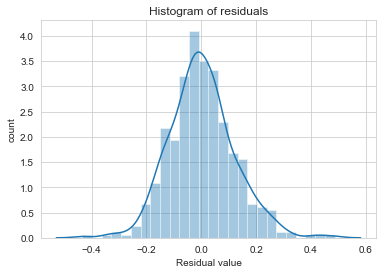

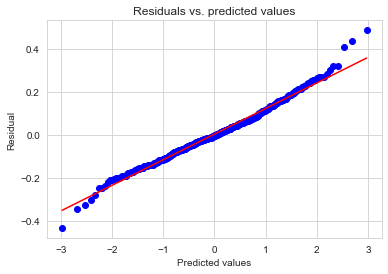

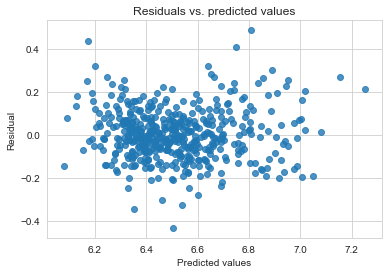

In [414]:
## define and fit the linear regression model
lin_mod = linear_model.LinearRegression()
lin_mod.fit(X_train, y_train)

def print_metrics(y_true, y_predicted):
    ## First compute R^2 and the adjusted R^2
    r2 = sklm.r2_score(y_true, y_predicted)
    
    ## Print the usual metrics and the R^2 values
    print('Mean Square Error      = ' + str(sklm.mean_squared_error(y_true, y_predicted)))
    print('Root Mean Square Error = ' + str(math.sqrt(sklm.mean_squared_error(y_true, y_predicted))))
    print('Mean Absolute Error    = ' + str(sklm.mean_absolute_error(y_true, y_predicted)))
    print('Median Absolute Error  = ' + str(sklm.median_absolute_error(y_true, y_predicted)))
    print('R^2                    = ' + str(r2))

def resid_plot(y_test, y_score):
    ## first compute vector of residuals. 
    resids = np.subtract(y_test.reshape(-1,1), y_score.reshape(-1,1))
    ## now make the residual plots
    sns.regplot(y_score, resids, fit_reg=False)
    plt.title('Residuals vs. predicted values')
    plt.xlabel('Predicted values')
    plt.ylabel('Residual')
    plt.show()

def hist_resids(y_test, y_score):
    ## first compute vector of residuals. 
    resids = np.subtract(y_test.reshape(-1,1), y_score.reshape(-1,1))
    ## now make the residual plots
    sns.distplot(resids)
    plt.title('Histogram of residuals')
    plt.xlabel('Residual value')
    plt.ylabel('count')
    plt.show()
    
def resid_qq(y_test, y_score):
    ## first compute vector of residuals. 
    resids = np.subtract(y_test, y_score)
    ## now make the residual plots
    ss.probplot(resids.flatten(), plot = plt)
    plt.title('Residuals vs. predicted values')
    plt.xlabel('Predicted values')
    plt.ylabel('Residual')
    plt.show()
  

y_score = lin_mod.predict(X_test) 
print_metrics(y_test, y_score) 
hist_resids(y_test, y_score)  
resid_qq(y_test, y_score) 
resid_plot(y_test, y_score) 

In [415]:
yhat = lin_mod.predict(TestFeatures)
yhat

array([6.52047821, 6.81112063, 6.59988789, ..., 6.98892003, 6.53822911,
       6.38788306])

In [416]:
#test_values['gross_rent'] = np.exp(yhat).astype(int)

In [417]:
#test_values.head(5)

In [418]:
#Prediction = test_values[['row_id','gross_rent']]

In [419]:
#Prediction.to_csv(r'C:\Users\Jorge\OneDrive\DAT102x.2\Prediction.csv', index = None, header=True)

In [420]:
def DistributionPlot(RedFunction, BlueFunction, RedName, BlueName, Title):
    width = 12
    height = 10
    plt.figure(figsize=(width, height))

    ax1 = sns.distplot(RedFunction, hist=False, color="r", label=RedName)
    ax2 = sns.distplot(BlueFunction, hist=False, color="b", label=BlueName, ax=ax1)

    plt.title(Title)
    plt.xlabel('Features')
    plt.ylabel('Gross Rent')

    plt.show()
    plt.close()

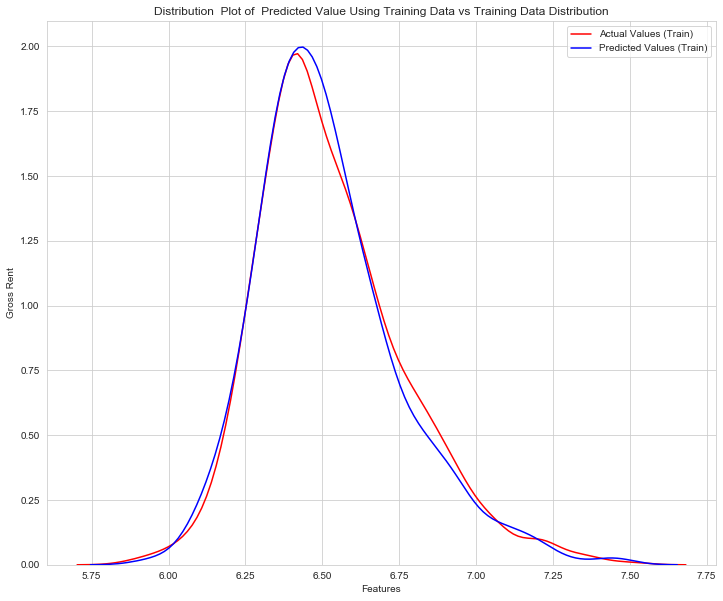

In [421]:
Title = 'Distribution  Plot of  Predicted Value Using Training Data vs Training Data Distribution'
DistributionPlot(y_train, y_test, "Actual Values (Train)", "Predicted Values (Train)", Title)

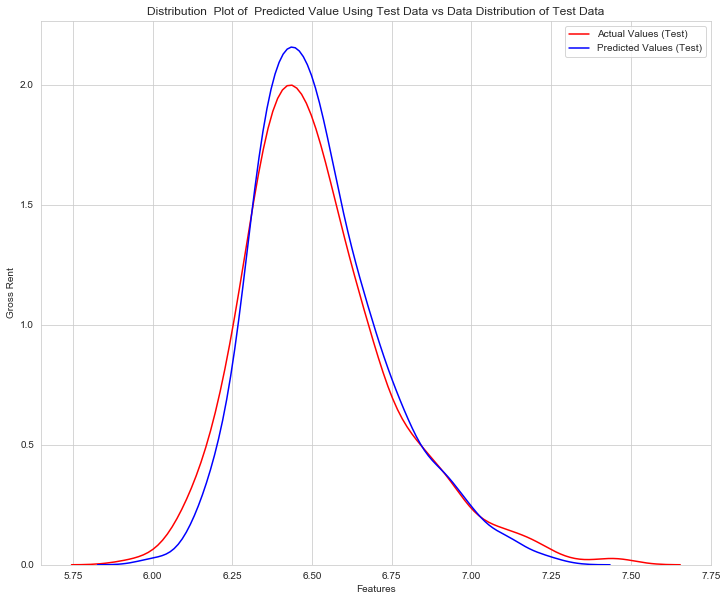

In [422]:
Title='Distribution  Plot of  Predicted Value Using Test Data vs Data Distribution of Test Data'
DistributionPlot(y_test,yhat,"Actual Values (Test)","Predicted Values (Test)",Title)

In [423]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression

In [424]:
pr = PolynomialFeatures(degree=1)
X_train_pr = pr.fit_transform(X_train)
X_test_pr = pr.fit_transform(X_test)
pr

PolynomialFeatures(degree=1, include_bias=True, interaction_only=False,
                   order='C')

In [425]:
poly = LinearRegression()
poly.fit(X_train_pr, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [426]:
yhat5 = poly.predict(X_test_pr)
yhat5[0:5]

array([6.56376644, 6.55658476, 6.26272404, 6.95347763, 6.84551315])

In [427]:
TrueTestpr = pr.fit_transform(TestFeatures)

In [428]:
yhat6 = poly.predict(TrueTestpr)
yhat6

array([6.52047821, 6.81112063, 6.59988789, ..., 6.98892003, 6.53822911,
       6.38788306])

In [429]:
poly.score(X_train_pr, y_train)

0.7751981001715167

In [430]:
poly.score(X_test_pr, y_test)

0.7376117678489187

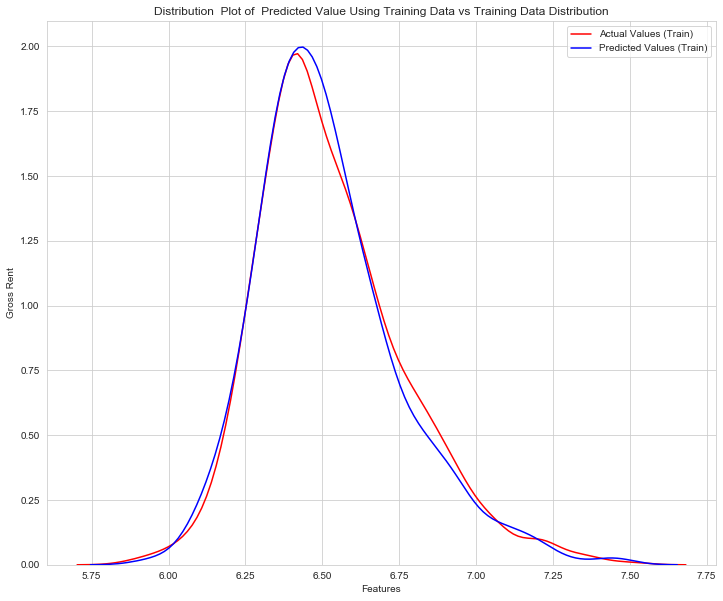

In [431]:
Title = 'Distribution  Plot of  Predicted Value Using Training Data vs Training Data Distribution'
DistributionPlot(y_train, y_test, "Actual Values (Train)", "Predicted Values (Train)", Title)

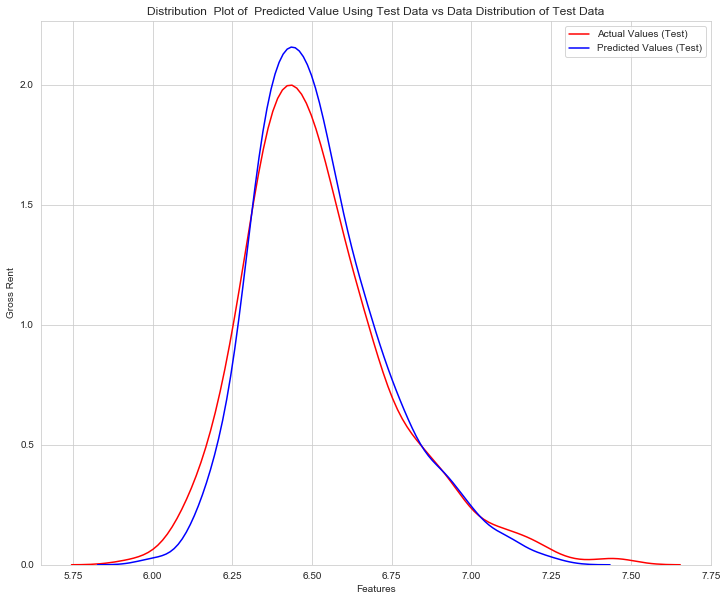

In [432]:
Title='Distribution  Plot of  Predicted Value Using Test Data vs Data Distribution of Test Data'
DistributionPlot(y_test,yhat6,"Actual Values (Test)","Predicted Values (Test)",Title)

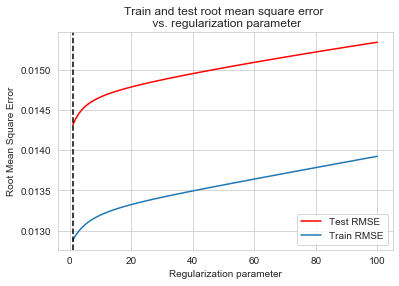

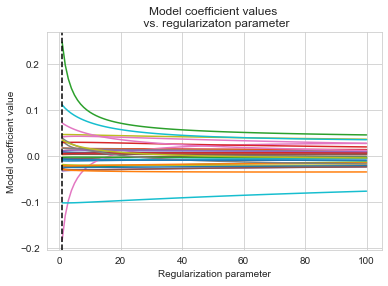

(1, 0.014319236227959923)


In [433]:
def plot_regularization(l, train_RMSE, test_RMSE, coefs, min_idx, title):   
    plt.plot(l, test_RMSE, color = 'red', label = 'Test RMSE')
    plt.plot(l, train_RMSE, label = 'Train RMSE')    
    plt.axvline(min_idx, color = 'black', linestyle = '--')
    plt.legend()
    plt.xlabel('Regularization parameter')
    plt.ylabel('Root Mean Square Error')
    plt.title(title)
    plt.show()
    
    plt.plot(l, coefs)
    plt.axvline(min_idx, color = 'black', linestyle = '--')
    plt.title('Model coefficient values \n vs. regularizaton parameter')
    plt.xlabel('Regularization parameter')
    plt.ylabel('Model coefficient value')
    plt.show()

def test_regularization_l2(x_train, y_train, x_test, y_test, l2):
    train_RMSE = []
    test_RMSE = []
    coefs = []
    for reg in l2:
        lin_mod = linear_model.Ridge(alpha = reg)
        lin_mod.fit(x_train, y_train)
        coefs.append(lin_mod.coef_)
        y_score_train = lin_mod.predict(x_train)
        train_RMSE.append(sklm.mean_squared_error(y_train, y_score_train))
        y_score = lin_mod.predict(x_test)
        test_RMSE.append(sklm.mean_squared_error(y_test, y_score))
    min_idx = np.argmin(test_RMSE)
    min_l2 = l2[min_idx]
    min_RMSE = test_RMSE[min_idx]
    
    title = 'Train and test root mean square error \n vs. regularization parameter'
    plot_regularization(l2, train_RMSE, test_RMSE, coefs, min_l2, title)
    return min_l2, min_RMSE
     
l2 = [x for x in range(1,101)]
out_l2 = test_regularization_l2(X_train, y_train, X_test, y_test, l2)
print(out_l2)

Mean Square Error      = 0.014319236227959923
Root Mean Square Error = 0.1196630111102003
Mean Absolute Error    = 0.09155710001076296
Median Absolute Error  = 0.07266996323015373
R^2                    = 0.7360850221560046


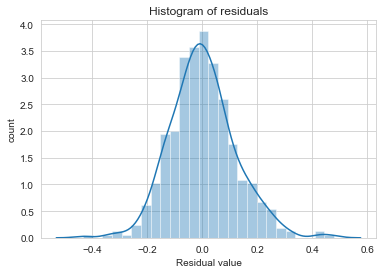

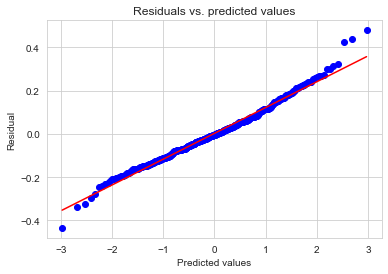

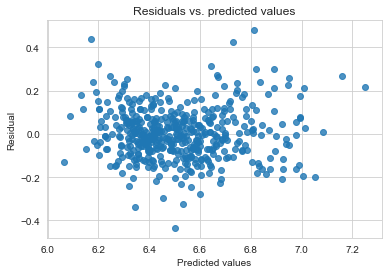

In [434]:
lin_mod_l2 = linear_model.Ridge(alpha = out_l2[0])
lin_mod_l2.fit(X_train, y_train)
y_score_l2 = lin_mod_l2.predict(X_test)

print_metrics(y_test, y_score_l2)
hist_resids(y_test, y_score_l2)  
resid_qq(y_test, y_score_l2) 
resid_plot(y_test, y_score_l2) 

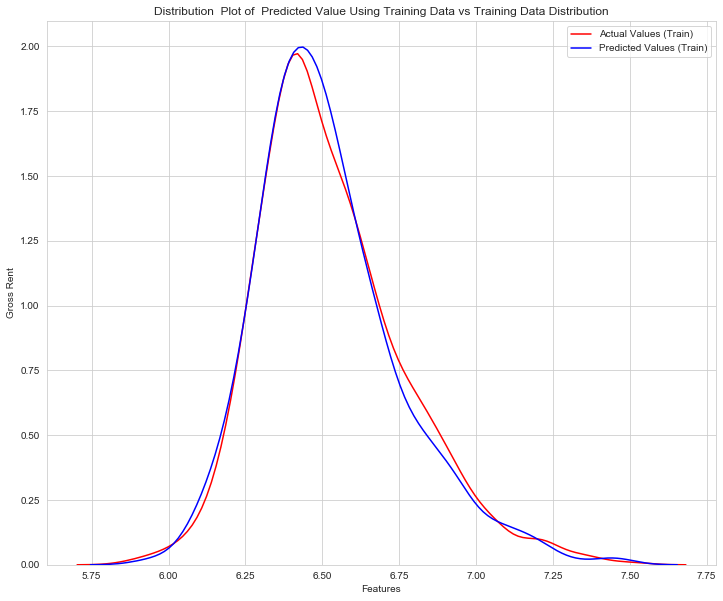

In [435]:
Title = 'Distribution  Plot of  Predicted Value Using Training Data vs Training Data Distribution'
DistributionPlot(y_train, y_test, "Actual Values (Train)", "Predicted Values (Train)", Title)

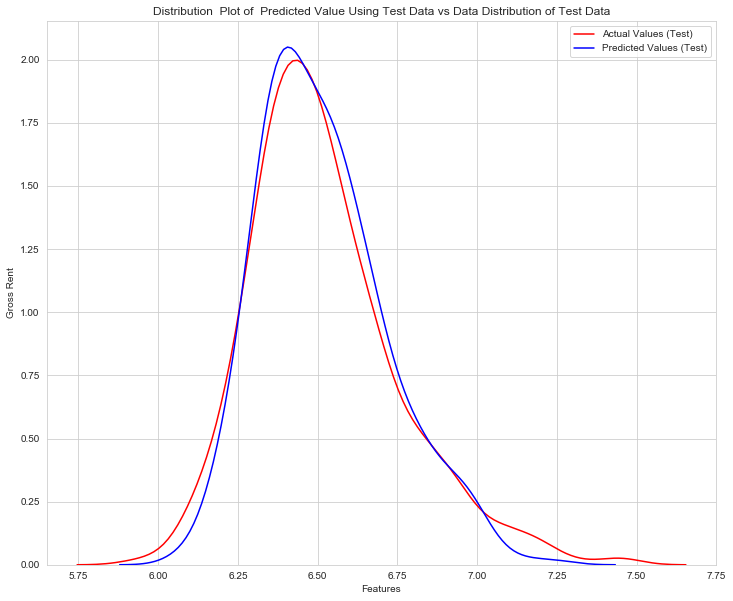

In [436]:
Title='Distribution  Plot of  Predicted Value Using Test Data vs Data Distribution of Test Data'
DistributionPlot(y_test,y_score_l2,"Actual Values (Test)","Predicted Values (Test)",Title)

In [437]:
#yhat9 = lin_mod_l2.predict(TestFeatures)

In [438]:
#test_values['gross_rent'] = np.exp(yhat9).astype(int)

In [439]:
#test_values.head(5)

In [440]:
#Prediction = test_values[['row_id','gross_rent']]

In [441]:
#Prediction.to_csv(r'C:\Users\Jorge\OneDrive\DAT102x.2\Prediction.csv', index = None, header=True)

In [442]:
import math
import pandas
#from sklearn.preprocessing import MinMaxScaler
from sklearn.svm import SVR
from sklearn.model_selection import GridSearchCV, cross_validate
from sklearn.utils import shuffle

In [443]:
#def svr_model(X, y):
#    gsc = GridSearchCV(
#    estimator=SVR(kernel='rbf'),
#     param_grid={
#            'C': [0.1, 1, 100, 1000],
#            'epsilon': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1, 5, 10],
#            'gamma': [0.0001, 0.001, 0.005, 0.1, 1, 3, 5]
#        },
#    cv=5, scoring='neg_mean_squared_error', verbose=0, n_jobs=-1)
#
#    grid_result = gsc.fit(X, y)
#    best_params = grid_result.best_params_
#    best_svr = SVR(kernel='rbf', C=best_params["C"], epsilon=best_params["epsilon"], gamma=best_params["gamma"],
#                   coef0=0.1, shrinking=True,
#                   tol=0.001, cache_size=200, verbose=False, max_iter=-1)
#
#    scoring = {
#               'abs_error': 'neg_mean_absolute_error',
#               'squared_error': 'neg_mean_squared_error'}
#
#    scores = cross_validate(best_svr, X, y, cv=10, scoring=scoring, return_train_score=True)
#    return "MAE :", abs(scores['test_abs_error'].mean()), "| RMSE :", math.sqrt(abs(scores['test_squared_error'].mean())),"model :", best_svr
## Run 
#print(svr_model(X_train,y_train))

In [444]:
best_svr = SVR(C=3301, cache_size=200, coef0=0.1, degree=3, epsilon=0.0005, gamma=0.0001,
    kernel='rbf', max_iter=-1, shrinking=False, tol=0.001, verbose=False)

In [445]:
#best_svr = SVR(C=1000, cache_size=200, coef0=0.1, degree=3, epsilon=0.0005, gamma=0.0001,
#    kernel='linear', max_iter=-1, shrinking=True, tol=0.001, verbose=False)

In [446]:
#def svr_model(X, y):
#    gsc = GridSearchCV(
#    estimator=SVR(kernel='linear'),
#    param_grid={
#            'C': [0.1, 1, 100, 1000],
#            'epsilon': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1, 5, 10],
#        },
#    cv=5, scoring='neg_mean_squared_error', verbose=0, n_jobs=-1)
#
#    grid_result = gsc.fit(X, y)
#    best_params = grid_result.best_params_
#    best_svr = SVR(kernel='linear', C=best_params["C"], epsilon=best_params["epsilon"], coef0=0.1, shrinking=True,
#                   tol=0.001, cache_size=200, verbose=False, max_iter=-1)
#
#    scoring = {
#               'abs_error': 'neg_mean_absolute_error',
#               'squared_error': 'neg_mean_squared_error'}
#
#    scores = cross_validate(best_svr, X, y, cv=10, scoring=scoring, return_train_score=True)
#    return "MAE :", abs(scores['test_abs_error'].mean()), "| RMSE :", math.sqrt(abs(scores['test_squared_error'].mean())),"model :", best_svr
# Run 
#print(svr_model(X_train,y_train))

In [447]:
#best_svr = SVR(C=1000, cache_size=200, coef0=0.1, degree=3, epsilon=0.0005, gamma=0.0001,
#    kernel='linear', max_iter=-1, shrinking=True, tol=0.001, verbose=False)

In [448]:
#from sklearn.preprocessing import QuantileTransformer
#transformer = QuantileTransformer().fit(X_train)
#transformer.transform(X_train)

In [449]:
best_svr.fit(X_train, y_train)

SVR(C=3301, cache_size=200, coef0=0.1, degree=3, epsilon=0.0005, gamma=0.0001,
    kernel='rbf', max_iter=-1, shrinking=False, tol=0.001, verbose=False)

In [450]:
best_svr.score(X_train, y_train)

0.845568218919428

In [451]:
best_svr.score(X_test, y_test)

0.7844550069048879

In [452]:
yhat10 = best_svr.predict(TestFeatures)

In [453]:
#test_values['gross_rent'] = np.exp(yhat10).astype(int)

In [454]:
#test_values.head(5)

In [455]:
#Prediction = test_values[['row_id','gross_rent']]

In [456]:
#Prediction.to_csv(r'C:\Users\Jorge\OneDrive\DAT102x.2\Prediction.csv', index = None, header=True)

In [457]:

#from sklearn.ensemble import GradientBoostingRegressor

In [458]:

#model_GradR2_GS= GradientBoostingRegressor(learning_rate=.1, n_estimators=230, max_depth=3, min_samples_leaf=3, min_samples_split=2,alpha=.9,subsample=0.8)
#model_GradR2_GS.fit(X_train,y_train)

In [459]:
#from sklearn.preprocessing import QuantileTransformer
#transformer = QuantileTransformer().fit(X_train)
#transformer.transform(X_train)

In [460]:
#model_GradR2_GS.score(X_train, y_train)

In [461]:
#model_GradR2_GS.score(X_test, y_test)

In [462]:
#yhat11 = model_GradR2_GS.predict(TestFeatures)

In [463]:
test_values['gross_rent'] = np.exp(yhat10).astype(int)

In [464]:
test_values['gross_rent'] = np.exp(yhat10).astype(int)

In [465]:
Prediction = test_values[['row_id','gross_rent']]

In [466]:
Prediction.to_csv(r'C:\Users\Jorge\OneDrive\DAT102x.2\Prediction.csv', index = None, header=True)

In [467]:
test_values.head(5)

,row_id,county_code,state,population,renter_occupied_households,pct_renter_occupied,evictions,rent_burden,pct_white,pct_af_am,...,pct_physical_inactivitylog,pct_excessive_drinkinglog,pct_below_18_years_of_agelog,pct_adults_with_high_school_diplomalog,pct_adults_with_some_collegelog,birth_rate_per_1klog,pct_civilian_laborlog,pct_unemploymentlog,pct_uninsured_adultslog,gross_rent
0,0,873,32,52842.0,5403.0,26.840,27.0,27.960,0.924234,0.025049,...,-1.102620,3.220794,-1.537117,-0.928339,-1.292982,2.285265,-0.830113,-2.590267,3.227558,648
1,1,675,37,212287.0,53502.0,57.534,6032.0,33.072,0.398318,0.484635,...,-1.378326,3.225414,-1.650260,-1.469330,-1.422810,2.586677,-0.646264,-2.780621,3.227836,933
2,2,1100,9,81263.0,13368.0,39.994,1012.0,32.044,0.483789,0.381916,...,-1.177655,3.218876,-1.427116,-1.108754,-1.246225,2.448574,-0.767871,-2.364460,3.228826,728
3,3,1562,7,122870.0,19359.0,41.865,27.0,30.724,0.468043,0.088393,...,-1.139434,3.224858,-1.265848,-1.282526,-1.096626,2.844436,-0.759287,-3.218876,3.233489,688
4,4,379,23,146153.0,15766.0,30.681,644.0,30.860,0.651511,0.251317,...,-1.402424,3.224977,-1.350927,-1.240328,-1.020651,2.522835,-0.755023,-2.847312,3.227280,898


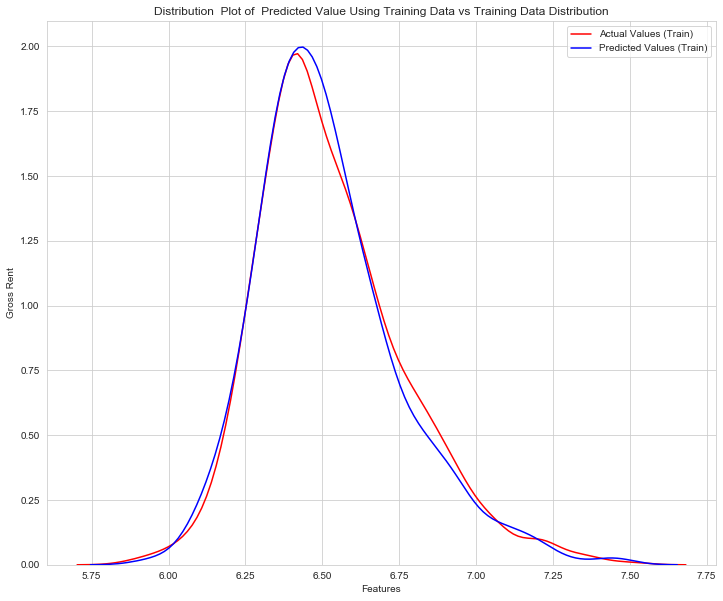

In [468]:
Title = 'Distribution  Plot of  Predicted Value Using Training Data vs Training Data Distribution'
DistributionPlot(y_train, y_test, "Actual Values (Train)", "Predicted Values (Train)", Title)

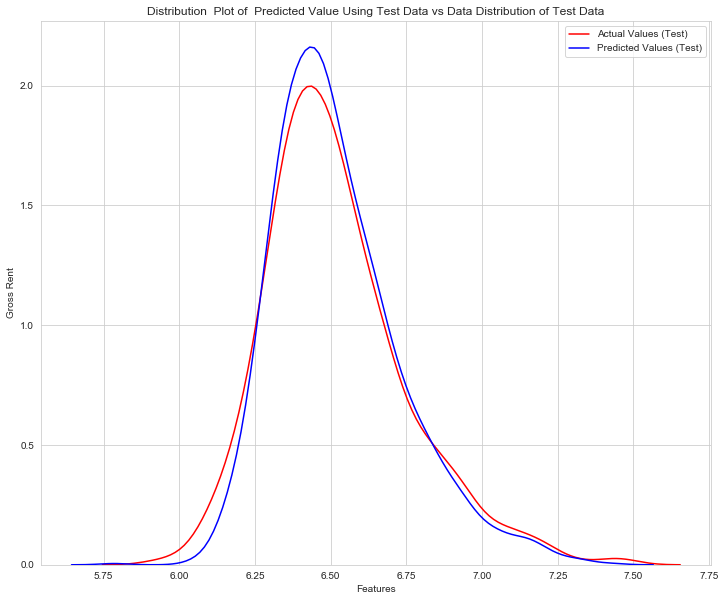

In [469]:
Title='Distribution  Plot of  Predicted Value Using Test Data vs Data Distribution of Test Data'
DistributionPlot(y_test, yhat10,"Actual Values (Test)","Predicted Values (Test)",Title)

In [470]:
#def test_regularization_l1(x_train, y_train, x_test, y_test, l1):
#    train_RMSE = []
#    test_RMSE = []
#    coefs = []
#    for reg in l1:
#        lin_mod = linear_model.Lasso(alpha = reg, max_iter=1e7) #tol=0.01
#        lin_mod.fit(x_train, y_train)
#        coefs.append(lin_mod.coef_)
#        y_score_train = lin_mod.predict(x_train)
#        train_RMSE.append(sklm.mean_squared_error(y_train, y_score_train))
#        y_score = lin_mod.predict(x_test)
#        test_RMSE.append(sklm.mean_squared_error(y_test, y_score))
#    min_idx = np.argmin(test_RMSE)
#    min_l1 = l1[min_idx]
#    min_RMSE = test_RMSE[min_idx]
#    
#    title = 'Train and test root mean square error \n vs. regularization parameter'
#    plot_regularization(l1, train_RMSE, test_RMSE, coefs, min_l1, title)
#    return min_l1, min_RMSE
#    
#l1 = [x/5000 for x in range(1,101)]
#out_l1 = test_regularization_l1(X_train, y_train, X_test, y_test, l1)
#print(out_l1)

In [471]:
#lin_mod_l1 = linear_model.Lasso(alpha = out_l1[0], max_iter=1e7)
#lin_mod_l1.fit(X_train, y_train)
#y_score_l1 = lin_mod_l1.predict(X_test)
#
#print_metrics(y_test, y_score_l1) 
#hist_resids(y_test, y_score_l1)  
#resid_qq(y_test, y_score_l1) 
#resid_plot(y_test, y_score_l1) 

In [472]:
#yhat12 = lin_mod_l1.predict(TestFeatures)

In [473]:
#test_values['gross_rent'] = np.exp(yhat11).astype(int)

In [474]:
#test_values.head(5)

In [475]:
#Title = 'Distribution  Plot of  Predicted Value Using Training Data vs Training Data Distribution'
#DistributionPlot(y_train, y_test, "Actual Values (Train)", "Predicted Values (Train)", Title)

In [476]:
#Title='Distribution  Plot of  Predicted Value Using Test Data vs Data Distribution of Test Data'
#DistributionPlot(y_test, yhat12,"Actual Values (Test)","Predicted Values (Test)",Title)

In [477]:
#MLPRegressor(activation='tanh', alpha=0.0001, batch_size='auto', beta_1=0.9,
#             beta_2=0.999, early_stopping=False, epsilon=1e-08,
#             hidden_layer_sizes=3, learning_rate='constant',
#             learning_rate_init=0.001, max_iter=200, momentum=0.9,
#             n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
#             random_state=None, shuffle=True, solver='lbfgs', tol=0.0001,
#             validation_fraction=0.1, verbose=False, warm_start=False)

In [478]:
def print_metrics(y_true, y_predicted, n_parameters):
    ## First compute R^2 and the adjusted R^2
    r2 = sklm.r2_score(y_true, y_predicted)
    r2_adj = r2 - (n_parameters - 1)/(y_true.shape[0] - n_parameters) * (1 - r2)
    
    ## Print the usual metrics and the R^2 values
    print('Mean Square Error      = ' + str(sklm.mean_squared_error(y_true, y_predicted)))
    print('Root Mean Square Error = ' + str(math.sqrt(sklm.mean_squared_error(y_true, y_predicted))))
    print('Mean Absolute Error    = ' + str(sklm.mean_absolute_error(y_true, y_predicted)))
    print('Median Absolute Error  = ' + str(sklm.median_absolute_error(y_true, y_predicted)))
    print('R^2                    = ' + str(r2))
    print('Adjusted R^2           = ' + str(r2_adj))
   
y_score = best_svr.predict(X_test) 
print_metrics(y_test, y_score, 28)  

Mean Square Error      = 0.011694825731745122
Root Mean Square Error = 0.1081426175554537
Mean Absolute Error    = 0.08335513894390041
Median Absolute Error  = 0.06924876656249168
R^2                    = 0.7844550069048879
Adjusted R^2           = 0.7712583746745749
